# Import library

In [1]:
import numpy as np

import os
import torch
torch.manual_seed(0)

from torch import nn, optim
from torch.utils.data import DataLoader
from torchvision.models.resnet import resnet18,resnet50,resnet101
from tqdm import tqdm
from typing import Dict
from torch import functional as F

from l5kit.configs import load_config_data
from l5kit.data import LocalDataManager, ChunkedDataset
from l5kit.dataset import AgentDataset, EgoDataset
from l5kit.rasterization import build_rasterizer
from l5kit.evaluation import write_pred_csv, compute_metrics_csv, read_gt_csv, create_chopped_dataset
from l5kit.evaluation.chop_dataset import MIN_FUTURE_STEPS
from l5kit.evaluation.metrics import neg_multi_log_likelihood, time_displace
from l5kit.geometry import transform_points
from l5kit.visualization import PREDICTED_POINTS_COLOR, TARGET_POINTS_COLOR, draw_trajectory
from prettytable import PrettyTable
from pathlib import Path

# Set environment

In [2]:
DIR_INPUT = "../../../lyft/data/lyft-motion-prediction-autonomous-vehicles"
# set env variable for data
os.environ["L5KIT_DATA_FOLDER"] = DIR_INPUT
dm = LocalDataManager(None)
VALIDATION = False
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set Configuration

In [3]:
cfg = {
    'format_version': 4,
    'model_params': {
        'model_architecture': 'resnet18',
        
        'history_num_frames': 10,
        'history_step_size': 1,
        'history_delta_time': 0.1,
        
        'future_num_frames': 50,
        'future_step_size': 1,
        'future_delta_time': 0.1
    },
    
    'raster_params': {
        'raster_size': [1, 1],
        'pixel_size': [0.5, 0.5],
        'ego_center': [0.25, 0.5],
        'map_type': 'py_semantic',
        'satellite_map_key': 'aerial_map/aerial_map.png',
        'semantic_map_key': 'semantic_map/semantic_map.pb',
        'dataset_meta_key': 'meta.json',
        'filter_agents_threshold': 0.5,
        'disable_traffic_light_faces': True
    },
    
    'train_data_loader': {
        'key': 'scenes/train.zarr',
        'batch_size': 32,
        'shuffle': True,
        'num_workers': 4
    },
    
    'val_data_loader': {
        'key': 'scenes/validate.zarr',
        'batch_size': 32,
        'shuffle': False,
        'num_workers': 4
    },
    
    'test_data_loader': {
        'key': 'scenes/test.zarr',
        'batch_size': 32,
        'shuffle': False,
        'num_workers': 3
    },
    
    'train_params': {
        'checkpoint_every_n_steps': 5000,
        'max_num_steps': 10000,
        'eval_every_n_steps': 500

        
    }
}

# Read validation set

In [4]:
import gc

val_cfg = cfg["val_data_loader"]

# Rasterizer
rasterizer = build_rasterizer(cfg, dm)

# Train dataset/dataloader
val_zarr = ChunkedDataset(dm.require(val_cfg["key"])).open()
val_dataset = AgentDataset(cfg, val_zarr, rasterizer)
val_dataloader = DataLoader(val_dataset,
                              shuffle=val_cfg["shuffle"],
                              batch_size=val_cfg["batch_size"], 
                              num_workers=val_cfg["num_workers"])


    

# Read train set

In [5]:
import gc

train_cfg = cfg["train_data_loader"]

# Rasterizer
rasterizer = build_rasterizer(cfg, dm)

# Train dataset/dataloader
train_zarr = ChunkedDataset(dm.require(train_cfg["key"])).open()
train_dataset = AgentDataset(cfg, train_zarr, rasterizer)
train_dataloader = DataLoader(train_dataset,
                              shuffle=train_cfg["shuffle"],
                              batch_size=train_cfg["batch_size"], 
                              num_workers=train_cfg["num_workers"])

print(train_dataset)
gc.collect()



+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16265    |  4039527   | 320124624  |    38735988   |      112.19     |        248.36        |        79.25         |        24.83         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


13

# Read test set

In [13]:
import gc

test_cfg = cfg["test_data_loader"]

# Rasterizer
rasterizer = build_rasterizer(cfg, dm)

# Train dataset/dataloader
test_zarr = ChunkedDataset(dm.require(test_cfg["key"])).open()
test_dataset = AgentDataset(cfg, test_zarr, rasterizer)
test_dataloader = DataLoader(test_dataset,
                              shuffle=test_cfg["shuffle"],
                              batch_size=test_cfg["batch_size"], 
                              num_workers=test_cfg["num_workers"])

gc.collect()




13

# Define Seq-to-Seq model

In [6]:
class EncoderLSTM_LyftModel(nn.Module):
    
    def __init__(self, cfg):
        super(EncoderLSTM_LyftModel, self).__init__()

        # input: x, y coordinate                
        self.input_sz  = 2
        
        # hidden layer size
        self.hidden_sz = 128
        
        # num layer
        self.num_layer = 1
        
        # sequence length
        self.sequence_length = 11        
        
        self.Encoder_lstm = nn.LSTM(self.input_sz,self.hidden_sz,self.num_layer,batch_first=True)
       
    def forward(self,inputs):
        '''
        Implemented Encoder with LSTM to extract 
        temporal information on history trajectories
        '''
        
        output,hidden_state = self.Encoder_lstm(inputs)
        
        return output,hidden_state
    
class DecoderLSTM_LyftModel(nn.Module):
    def __init__(self, cfg):
        super(DecoderLSTM_LyftModel, self).__init__()
        
        self.input_sz  = 128 
        self.hidden_sz = 128
        self.num_layer = 1
        self.sequence_len_de = 1
        self.batch_sz = 32
        
        self.encoderLSTM = EncoderLSTM_LyftModel(cfg)

        
        self.Decoder_lstm = nn.LSTM( self.input_sz,self.hidden_sz,self.num_layer,batch_first=True)


    def forward(self,inputs):
        '''
        With last hidden state, cell state trained on encoder, 
        predict 50 future trajectories with LSTM.
        Input to the decoder is zero vector of shape (batch_sz, 50, 128) 
        since most of the current position is at 0
        '''
        
        # Last hidden state and cell state on encoder        
        _,hidden_state = self.encoderLSTM(inputs)
        
        # Dummy future trajectories        
        result = torch.zeros((self.batch_sz, 50, 128))
        
        # Input to decoder        
        inout_to_dec = torch.zeros(inputs.shape[0],self.sequence_len_de,self.input_sz).to(device)
        
        # Predict 50 future trajectories consecutively        
        for i in range(50):
            inout_to_dec,hidden_state = self.Decoder_lstm(inout_to_dec,(hidden_state[0],hidden_state[1]) )          
            result[:,i,:] = inout_to_dec[:,0,:]
        return result

# Generator Implementation

In [7]:
class Generator(nn.Module):
    def __init__(self, starting_shape):
        super(Generator, self).__init__()
        self.input_sz  = 128
        self.hidden_sz = 256 
        self.num_layer = 1
        self.sequence_len_de = 1
        self.interlayer = 512
        self.DecoderLSTM_LyftModel = DecoderLSTM_LyftModel(cfg)
        
        num_targets = 2
        
        self.fcn_en_state_dec_state = nn.Sequential(nn.Linear(in_features=self.hidden_sz, out_features=self.hidden_sz),
                                                    nn.ReLU(inplace=True),
                                                    nn.Linear(in_features = self.hidden_sz, out_features = self.interlayer),
                                                    nn.ReLU(inplace=True),
                                                    nn.Linear(in_features = self.interlayer, out_features = self.hidden_sz),
                                                    nn.ReLU(inplace=True),
                                                    nn.Linear(in_features=self.hidden_sz, out_features=num_targets))


    def forward(self,inputs):
        '''
        With latent temporal vector from decoder, 
        add noise to the generator and generate
        50 future trajectories of each agents
        '''
        
        # Temporal vector from decoder        
        decoderLSTM = self.DecoderLSTM_LyftModel(inputs)
        
        # Noise from Gaussian Distribution        
        noise_gen = torch.randn(decoderLSTM.shape, device=device) 

        # Add noise to the latent vector
        combine = torch.cat([decoderLSTM, noise_gen], dim = 2)
        
        # Generate Trajectories
        fc_out = self.fcn_en_state_dec_state(combine.squeeze(dim=0))
        
        return fc_out

    

# Discriminator Implementation

In [ ]:
# Discriminator with Relu activation function

class Discriminator_0(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.lstm_hidden = 128
        self.input_sz = 2
        self.num_layer = 1
        self.batch_sz = 32
        
        self.hidden_sz_1 = 6400
        self.hidden_sz_2 = 3200
        self.hidden_sz_3 = 1600
        self.hidden_sz_4 = 800

            
        self.fc= nn.Sequential(
            nn.Linear(in_features=self.hidden_sz_1, out_features=self.hidden_sz_2),
            nn.ReLU(inplace=True),
            nn.Linear(in_features=self.hidden_sz_2, out_features=self.hidden_sz_3),
            nn.ReLU(inplace=True),
            nn.Linear(in_features=self.hidden_sz_3, out_features=self.hidden_sz_4),
            nn.ReLU(inplace=True),
            nn.Linear(in_features=self.hidden_sz_4, out_features=1)
        )
        self.lstm = nn.LSTM(self.input_sz,self.lstm_hidden,self.num_layer,batch_first=True)


        
    def forward(self, input):
        '''
        Input to the discriminator is either real trajectory or
        generated fake trajectory. Discriminator would differentiate
        if trajectories are real/fake with LSTM and FC
        '''        
        output, _ = self.lstm(input)
        output = output.reshape((self.batch_sz, -1))
        fc = self.fc(output)
        return fc

In [8]:
# Discriminator with WeakyRelu activation function, Dropout, and Batch norm

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.lstm_hidden = 128
        self.input_sz = 2
        self.num_layer = 1
        self.batch_sz = 32

        self.hidden_sz_1 = 6400
        self.hidden_sz_2 = 3200
        self.hidden_sz_3 = 1600
        self.hidden_sz_4 = 800

        # Fully Connected layer with Batch Norm, Dropout, LeakyReLU
        
        self.fc= nn.Sequential(
            nn.Linear(in_features=self.hidden_sz_1, out_features=self.hidden_sz_2),
            nn.BatchNorm1d(self.hidden_sz_2),            
            nn.LeakyReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(in_features=self.hidden_sz_2, out_features=self.hidden_sz_3),            
            nn.BatchNorm1d(self.hidden_sz_3),                        
            nn.LeakyReLU(inplace=True),
            nn.Dropout(0.5),            
            nn.Linear(in_features=self.hidden_sz_3, out_features=self.hidden_sz_4),
            nn.BatchNorm1d(self.hidden_sz_4),                                    
            nn.LeakyReLU(inplace=True),
            nn.Dropout(0.5),            
            nn.Linear(in_features=self.hidden_sz_4, out_features=1)
        )
        self.lstm = nn.LSTM(self.input_sz,self.lstm_hidden,self.num_layer,batch_first=True)


        
    def forward(self, input):
        '''
        Input to the discriminator is either real trajectory or
        generated fake trajectory. Discriminator would differentiate
        if trajectories are real/fake with LSTM and FC
        '''                
        output, _ = self.lstm(input)
        output = output.reshape((self.batch_sz, -1))
        fc = self.fc(output)
        return fc

In [9]:
import matplotlib.pyplot as plt

# Save to this directory

In [10]:
save_path = "./v2_dbl_lre4_1130/"

# GAN Implementation

In [11]:
# Use this to put tensors on GPU/CPU automatically when defining tensors
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') 

class GAN(nn.Module):

    def __init__(self):
        super(GAN, self).__init__()
        self.num_epoch = 1
        self.batch_size = 32
        self.log_step = 1000 
        self.visualize_step = 1
        self.code_size = 64
        self.learning_rate_gen =1e-3
        self.learning_rate_dis =5e-3
        self.val = 100

        
        # Define L2 Loss for the generator
        self._l2_loss = nn.MSELoss()

        
        # Define the generator and both discriminator 
        self._discriminator = Discriminator().to(device)
        self._generator = Generator(self.code_size).to(device)
        
        # Loss function for the discriminator
        self._classification_loss = nn.BCEWithLogitsLoss()

        # Apply weight initialization here
        self._discriminator.apply(self._weight_initialization)
        self._generator.apply(self._weight_initialization)

        # Hyper parameter for the Adam Optimizer
        betas = (0.5, 0.999)
        
        # Optimizer for Generator and Discriminator
        self._generator_optimizer = torch.optim.Adam(self._generator.parameters(), lr = self.learning_rate_gen, betas = betas)
        self._discriminator_optimizer = torch.optim.Adam(self._discriminator.parameters(), lr = self.learning_rate_dis, betas = betas)

    # custom weights initialization for both networks
    # apply the custom weight initialization
        
    def _weight_initialization(self, m):
        classname = m.__class__.__name__
        if classname.find('Conv') != -1:
            nn.init.normal_(m.weight.data, 0.0, 0.02)
        elif classname.find('BatchNorm') != -1:
            nn.init.normal_(m.weight.data, 1.0, 0.02)
            nn.init.constant_(m.bias.data, 0)
            
    # Discriminator Loss
    def _loss(self, logits, labels):
        return self._classification_loss(logits, labels)

    # Generator Loss    
    def _reconstruction_loss(self, generated, target):
        return self._l2_loss(generated, target)


    # Training function
    def forward(self, train_dataloader):
        for epoch in range(self.num_epoch):
            
            # Save train loss for discriminator and generator            
            dis_losses = []
            gen_losses = []
            
            # Save validation loss for discriminator and generator            
            val_dis_losses = []
            val_gen_losses = []

            step = 0

            # smooth the loss curve so that it does not fluctuate too much
            smooth_factor = 0.95
            plot_dis_s = 0
            plot_gen_s = 0
            plot_ws = 0

            max_steps = int(len(iter(train_dataloader)))
            
            # Fake label for discriminator            
            fake_label = torch.zeros([self.batch_size, 1], device=device)
            
            # Real label for discriminator                        
            real_label = torch.ones([self.batch_size, 1], device=device)
            
            # Train generator and discriminator            
            self._generator.train()
            self._discriminator.train()
            
            print('Start training ...')

            progress_bar = tqdm(range(cfg["train_params"]["max_num_steps"]))

            tr_it = iter(train_dataloader)


            for itr in progress_bar:
                try:
                    data = next(tr_it)
                except StopIteration:
                    tr_it = iter(train_dataloader)
                    data = next(tr_it)
                step += 1

                ################################################################################
                # Train the discriminator                                                      #
                ################################################################################
                # History position is in reverse order
                # Need to flip it
                history_positions = torch.flip(data['history_positions'], [1]).to(device)
                target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)
                targets_position = data["target_positions"].to(device) 

                # Eliminate discriminator gradients                
                self._discriminator_optimizer.zero_grad()

                # Calculate BCE loss on discriminator
                real_dis_out = self._discriminator(targets_position)
                real_dis_loss = self._loss(real_dis_out, real_label)

                # Calculate real discriminator loss gradients
                real_dis_loss.backward()

                ################################################################################
                # Train the discriminator with an all fake batch                               #
                ################################################################################
                # Detach the fake samples from the gradient calculation 
                # when feeding to the discriminator, we don't want the discriminator to 
                # receive gradient info from the Generator

                fake_samples = self._generator(history_positions).detach()
                fake_dis_out = self._discriminator(fake_samples)
                
                numGenerated = fake_dis_out.shape[0]

                fake_dis_label = fake_label[:numGenerated] 
                fake_dis_loss = self._loss(fake_dis_out, fake_dis_label).requires_grad_()


                # Calculate fake discriminator loss gradients
                fake_dis_loss.backward()
                
                # Update the discriminator weights                                
                self._discriminator_optimizer.step()
                
                ################################################################################
                # Train the generator                                                          #
                ################################################################################                
                # Get new samples from updated discriminator. No need to detach
                # from gradient calculation here, we want the Generator to receive
                # gradient info from the discriminator so it can learn better.

                # Eliminate all generator gradients first
                self._generator_optimizer.zero_grad()
                
                # Generate future trajectories with history positions
                fake_samples_gen = self._generator(history_positions)
                
                # Update Generator MSE Loss
                gen_loss = self._l2_loss(fake_samples_gen*target_availabilities, targets_position)


                # Update the generator weights
                gen_loss.backward()
                self._generator_optimizer.step()

                # Add up discriminator loss
                dis_loss = real_dis_loss + fake_dis_loss

                # Apply smoothing factors for the plot
                plot_dis_s = plot_dis_s * smooth_factor + dis_loss * (1 - smooth_factor)
                plot_gen_s = plot_gen_s * smooth_factor + gen_loss * (1 - smooth_factor)
                plot_ws = plot_ws * smooth_factor + (1 - smooth_factor)
                dis_losses.append(plot_dis_s / plot_ws)
                gen_losses.append(plot_gen_s / plot_ws)

                # Validation
                with torch.no_grad():
                    try:
                        val_data = next(vl_it)
                    except:
                        vl_it = iter(val_dataloader)
                        val_data = next(vl_it)
                    gan.eval()
                    self._generator.eval()
                    self._discriminator.eval()

                    # Fetch Validation data
                    # Flip history position
                    val_history_positions = torch.flip(val_data['history_positions'], [1]).to(device)
                    val_target_availabilities = val_data["target_availabilities"].unsqueeze(-1).to(device)
                    val_targets_position = val_data["target_positions"].to(device)

                    val_real_dis_out = self._discriminator(val_targets_position)
                    val_real_dis_loss = self._loss(val_real_dis_out, real_label)


                    val_fake_samples_gen = self._generator(val_history_positions)
                    val_gen_loss = self._l2_loss(val_fake_samples_gen * val_target_availabilities, val_targets_position)

                    # Calculate Validation loss of discriminator
                    val_fake_dis_out = self._discriminator(val_fake_samples_gen)
                    val_fake_dis_label = fake_label[:numGenerated] 
                    
                    # Calculate Validation loss of generator                                
                    val_fake_dis_loss = self._loss(val_fake_dis_out, val_fake_dis_label)
                    val_dis_loss = val_real_dis_loss + val_fake_dis_loss

                    # Plot Validation loss
                    val_plot_dis_s = plot_dis_s * smooth_factor + val_dis_loss * (1 - smooth_factor)
                    val_plot_gen_s = plot_gen_s * smooth_factor + val_gen_loss * (1 - smooth_factor)
                    val_plot_ws = plot_ws * smooth_factor + (1 - smooth_factor)
                    val_dis_losses.append(val_plot_dis_s / val_plot_ws)
                    val_gen_losses.append(val_plot_gen_s / val_plot_ws)

                if step % self.log_step == 0:
                    print('Iteration {0}/{1}: dis loss = {2:.4f}, gen loss = {3:.4f}'.format(step, max_steps, dis_loss, gen_loss))
                    
                # Save our loss graph                    
                if step % self.val == 0:
                    fig = plt.figure(figsize = (8, 8))   

                    plt.plot(dis_losses)
                    plt.plot(val_dis_losses)
                    
                    plt.title('discriminator loss')
                    plt.xlabel('iterations')
                    plt.ylabel('loss')
                    plt.show()

                    plt.plot(gen_losses)
                    plt.plot(val_gen_losses)                    
                    plt.title('generator loss')
                    plt.xlabel('iterations')
                    plt.ylabel('loss')
                    plt.show()
                    
            # Save model weights
            torch.save(gan.state_dict(), save_path + "gan_v2_" + str(epoch)+ ".pt")
            fig = plt.figure(figsize = (8, 8))   
            
            # Save our loss graph
            plt.plot(dis_losses)
            plt.plot(val_dis_losses)

            plt.title('discriminator loss')
            plt.xlabel('iterations')
            plt.ylabel('loss')
            plt.savefig(save_path + "discriminator_v2_epoch_" + str(epoch) + '.png')

            # Save our loss graph
            plt.plot(gen_losses)
            plt.plot(val_gen_losses)                    
            plt.title('generator loss')
            plt.xlabel('iterations')
            plt.ylabel('loss')
            plt.savefig(save_path+ "generator_v2_epoch_" + str(epoch) + '.png')

        print('... Done!')

In [12]:
import pdb
%pdb

Automatic pdb calling has been turned ON


# training with different discriminator - dropout, leakyRelu, batch norm, lr=5e-3


  0%|          | 0/10000 [00:00<?, ?it/s]

Start training ...


  1%|          | 99/10000 [01:09<1:48:22,  1.52it/s]

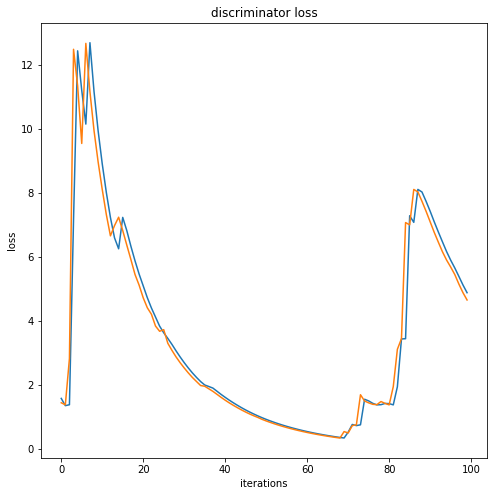

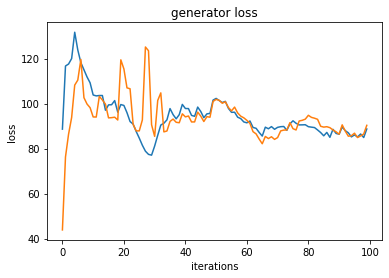

  2%|▏         | 199/10000 [02:16<1:50:41,  1.48it/s]

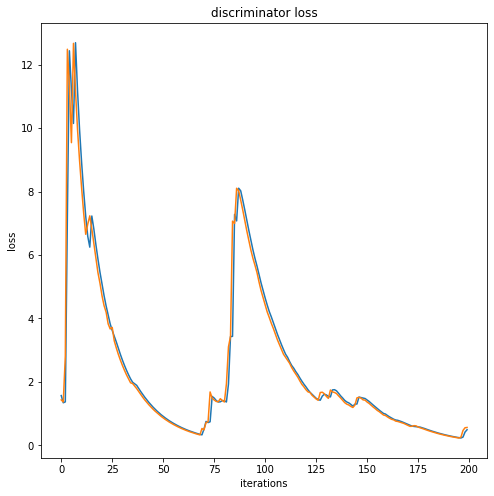

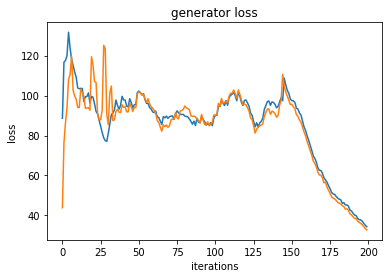

  3%|▎         | 299/10000 [03:22<1:46:17,  1.52it/s]

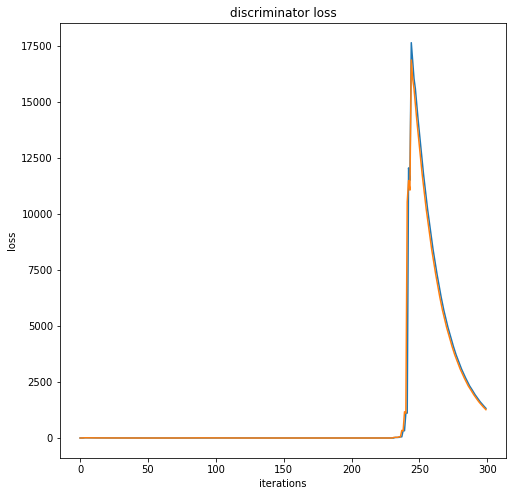

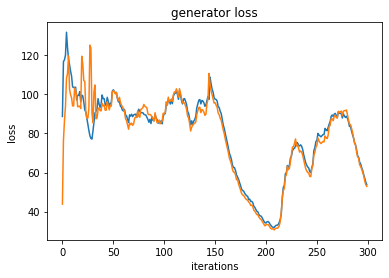

  4%|▍         | 399/10000 [04:31<1:56:19,  1.38it/s]

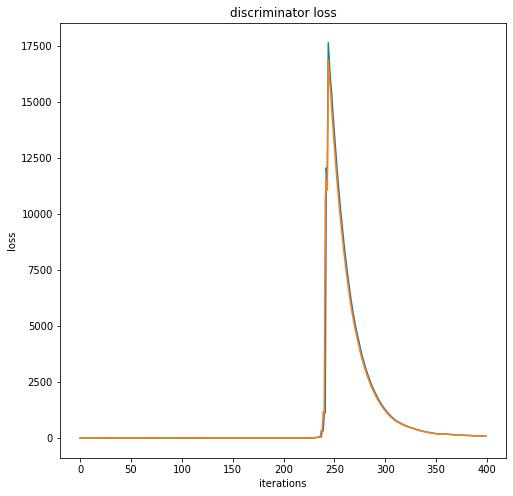

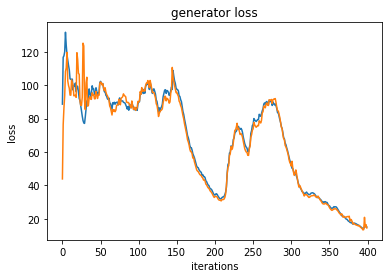

  5%|▍         | 499/10000 [05:43<1:41:48,  1.56it/s]

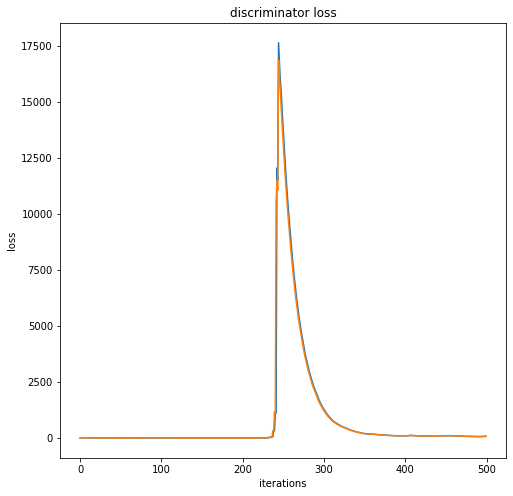

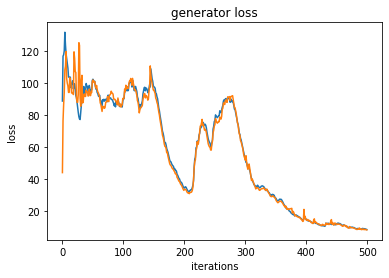

  6%|▌         | 599/10000 [06:59<1:42:46,  1.52it/s]

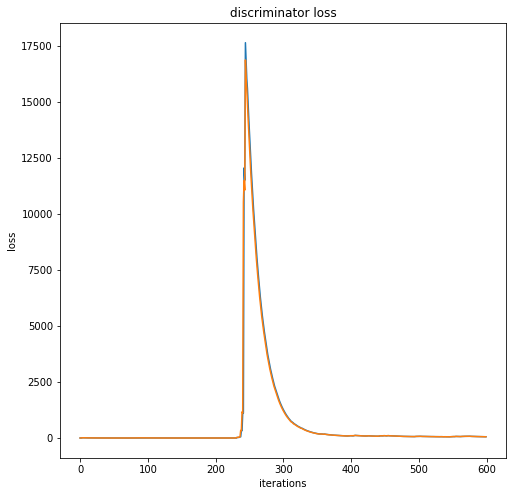

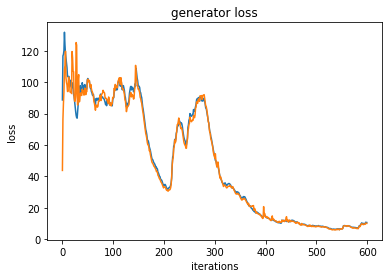

  7%|▋         | 699/10000 [08:09<2:04:23,  1.25it/s]

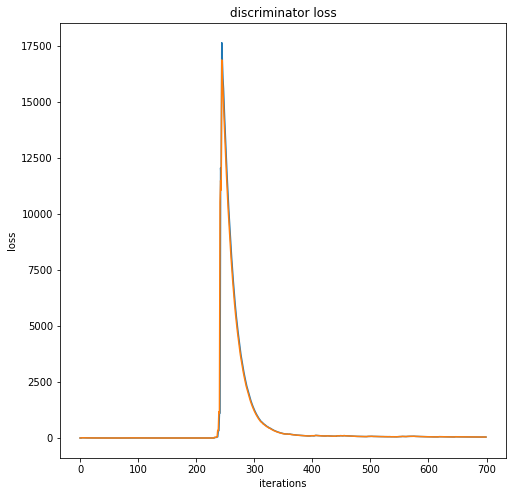

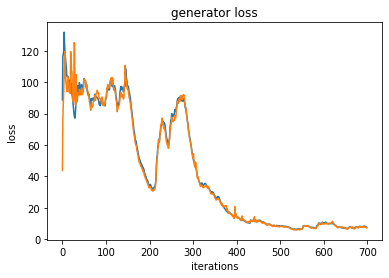

  8%|▊         | 799/10000 [09:17<1:42:38,  1.49it/s]

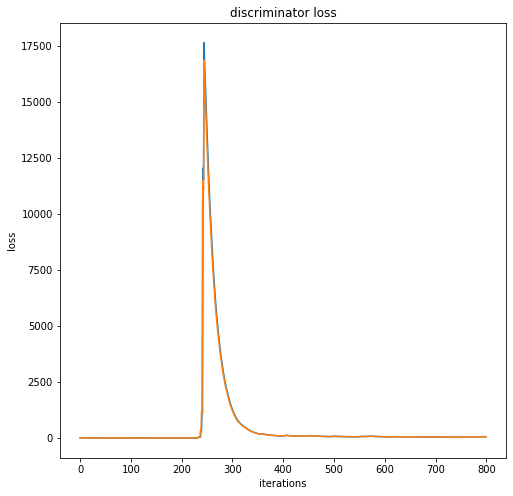

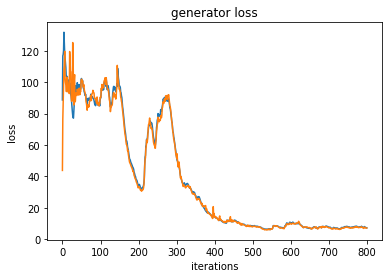

  9%|▉         | 899/10000 [10:23<1:40:19,  1.51it/s]

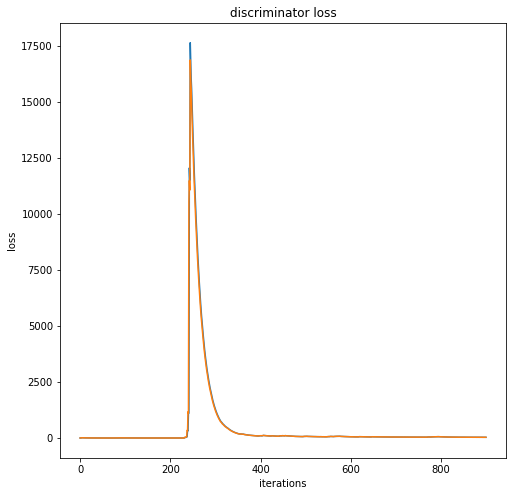

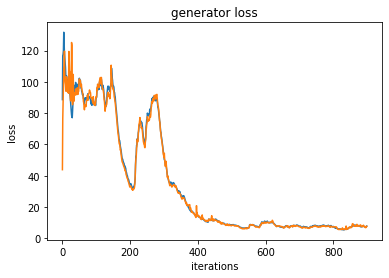

 10%|▉         | 999/10000 [11:34<1:47:17,  1.40it/s]

Iteration 1000/703023: dis loss = 49.6694, gen loss = 4.4405


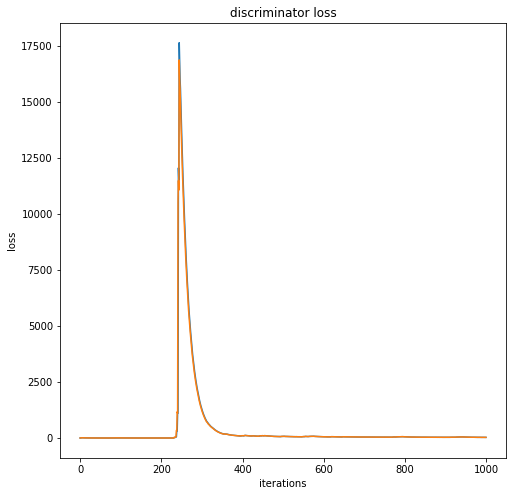

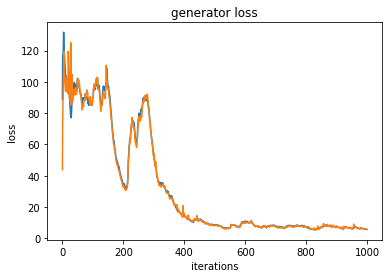

 11%|█         | 1099/10000 [12:39<1:33:43,  1.58it/s]

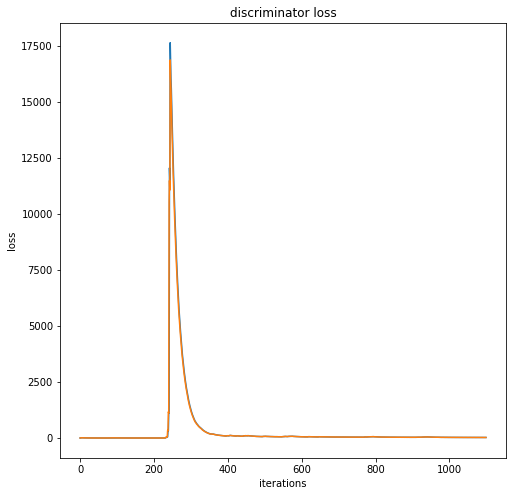

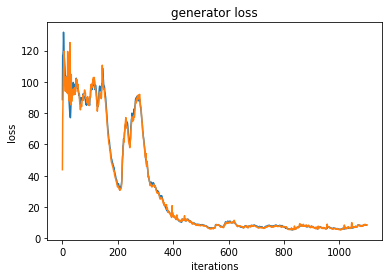

 12%|█▏        | 1199/10000 [13:43<1:32:44,  1.58it/s]

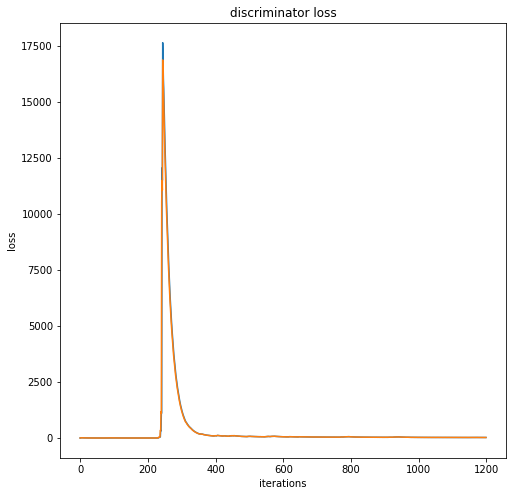

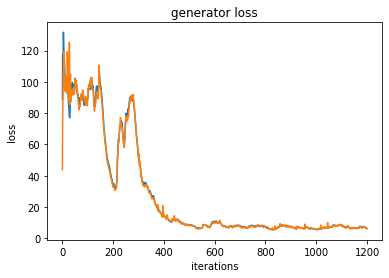

 13%|█▎        | 1299/10000 [14:54<1:35:09,  1.52it/s]

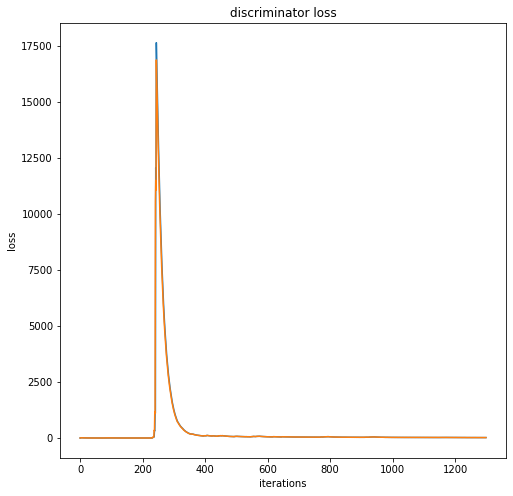

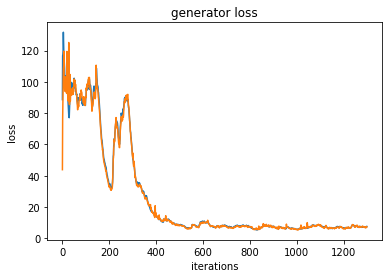

 14%|█▍        | 1399/10000 [16:00<1:32:50,  1.54it/s]

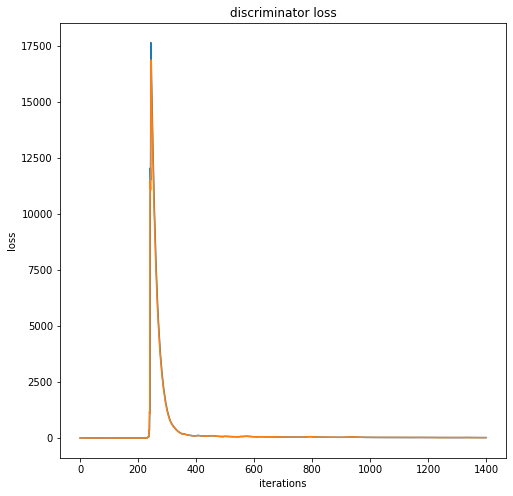

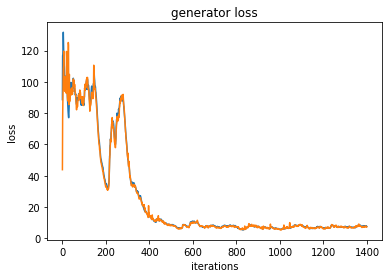

 15%|█▍        | 1499/10000 [17:06<1:34:19,  1.50it/s]

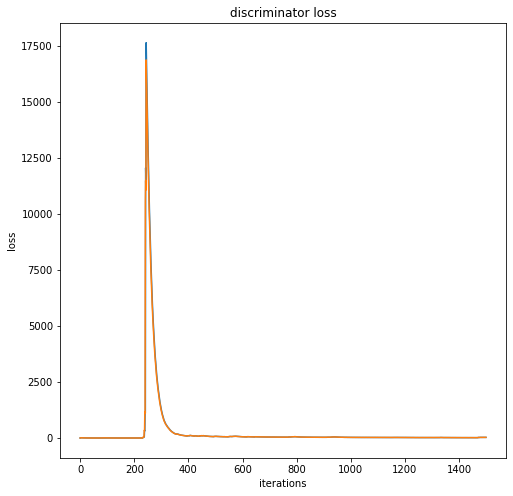

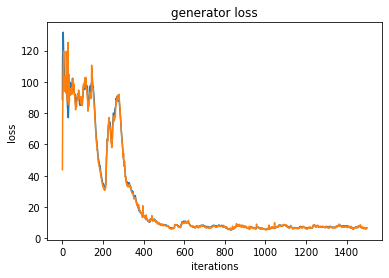

 16%|█▌        | 1599/10000 [18:12<1:32:11,  1.52it/s]

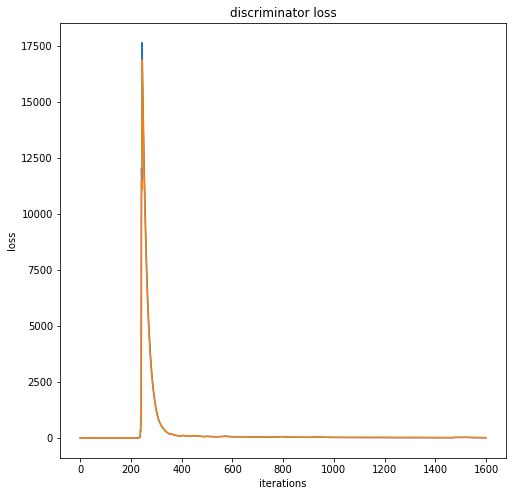

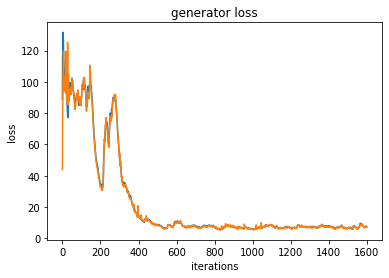

 17%|█▋        | 1699/10000 [19:19<1:32:32,  1.50it/s]

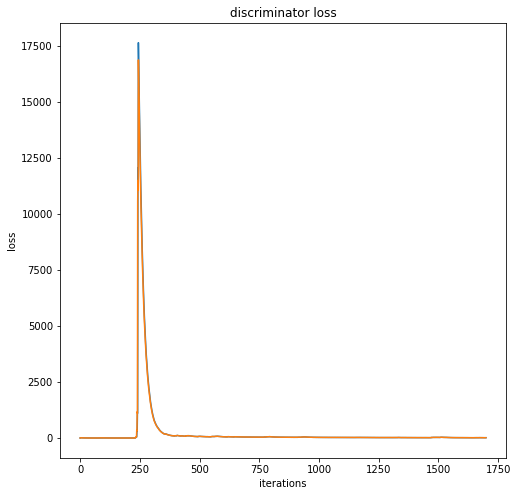

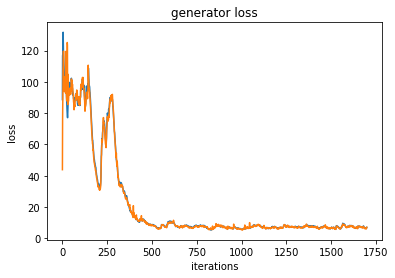

 18%|█▊        | 1799/10000 [20:26<1:28:58,  1.54it/s]

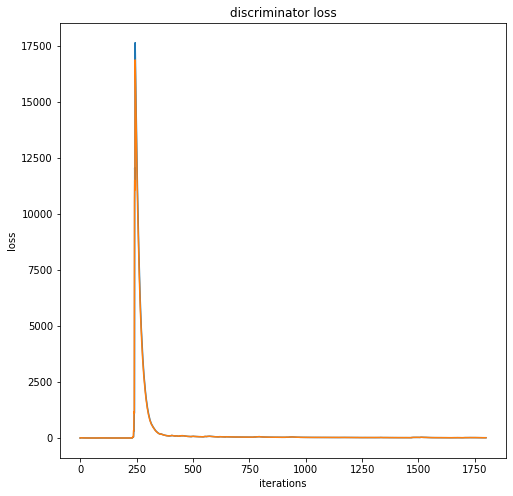

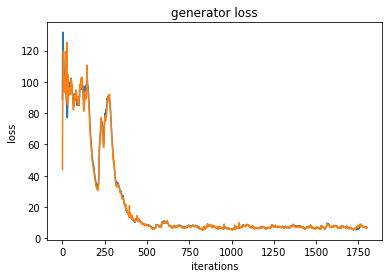

 19%|█▉        | 1899/10000 [21:32<1:41:41,  1.33it/s]

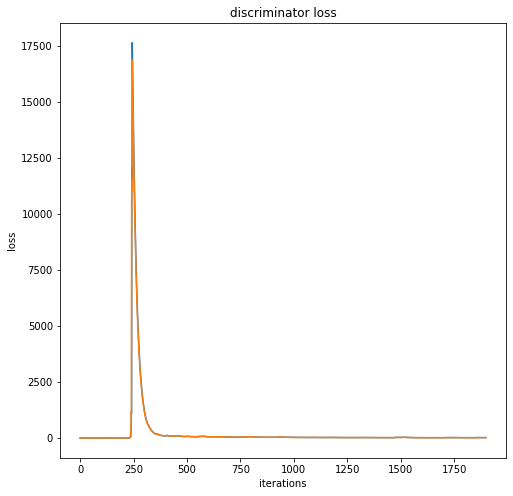

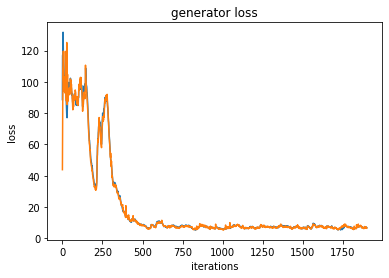

 20%|█▉        | 1999/10000 [22:40<1:26:08,  1.55it/s]

Iteration 2000/703023: dis loss = 8.0806, gen loss = 11.3395


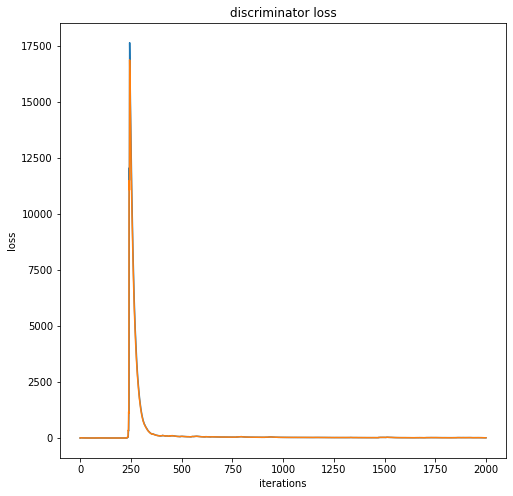

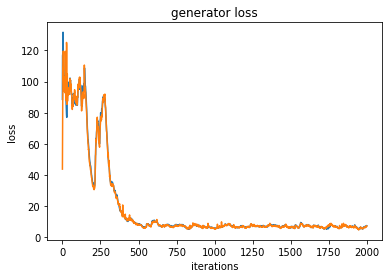

 21%|██        | 2099/10000 [23:45<1:25:01,  1.55it/s]

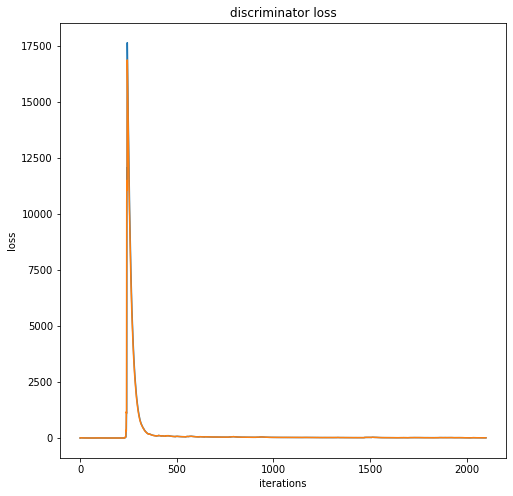

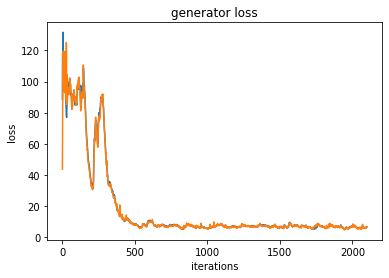

 22%|██▏       | 2199/10000 [24:51<1:25:39,  1.52it/s]

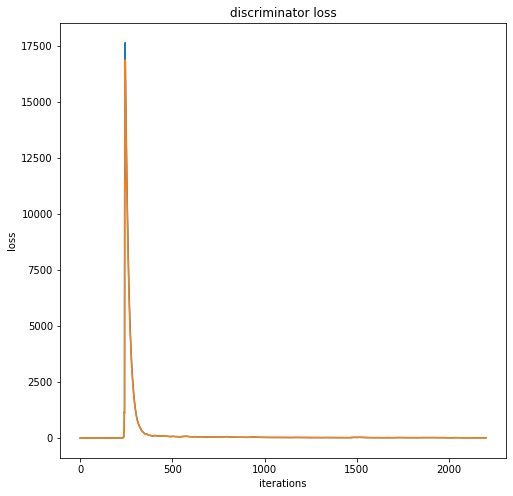

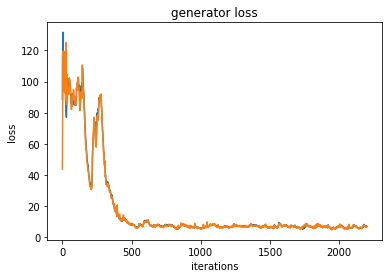

 23%|██▎       | 2299/10000 [25:58<1:24:23,  1.52it/s]

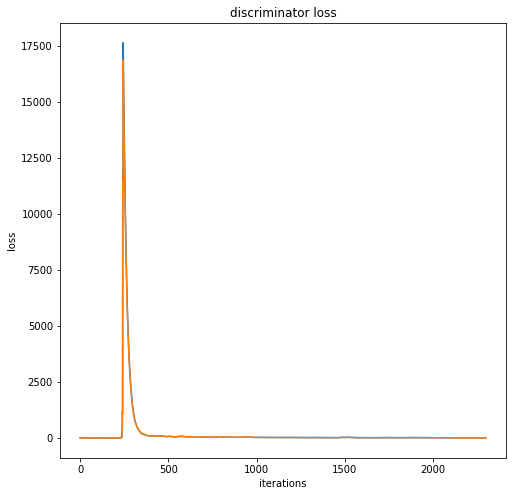

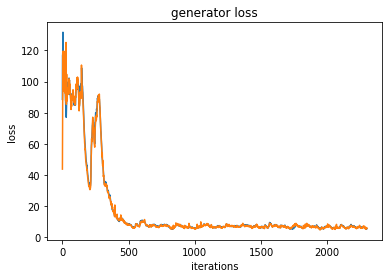

 24%|██▍       | 2399/10000 [27:04<1:23:48,  1.51it/s]

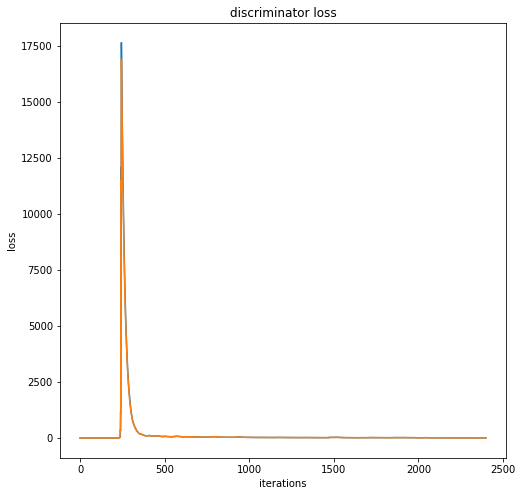

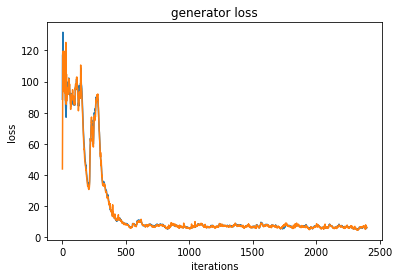

 25%|██▍       | 2499/10000 [28:11<1:21:45,  1.53it/s]

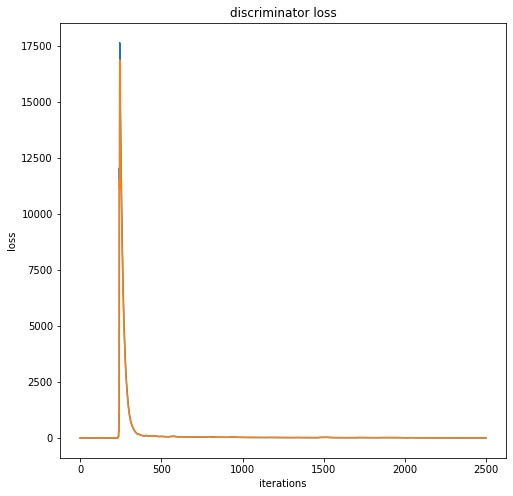

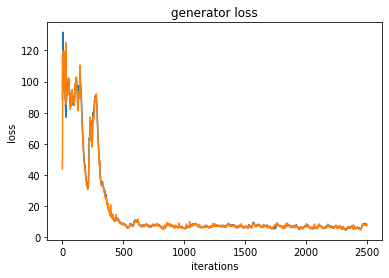

 26%|██▌       | 2599/10000 [29:19<1:28:11,  1.40it/s]

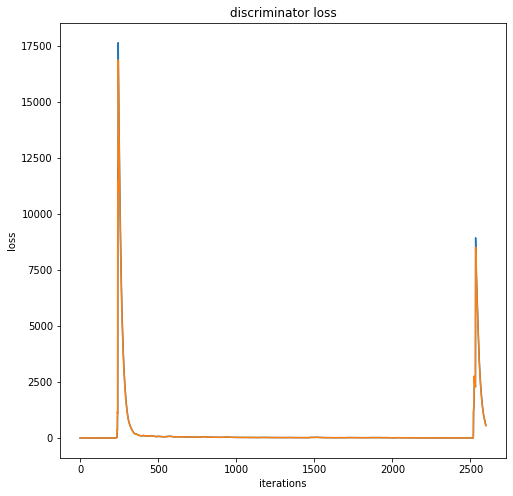

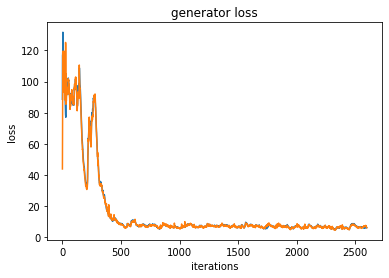

 27%|██▋       | 2699/10000 [30:29<1:20:39,  1.51it/s]

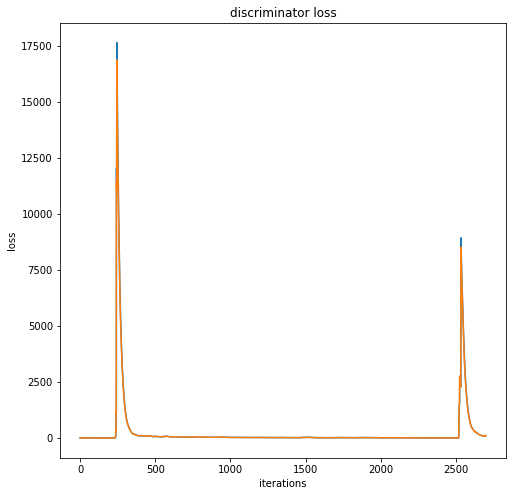

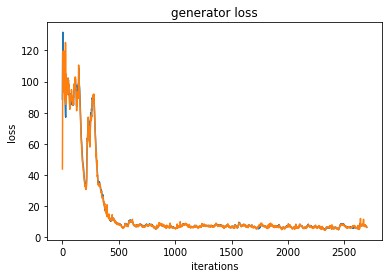

 28%|██▊       | 2799/10000 [31:44<1:28:21,  1.36it/s]

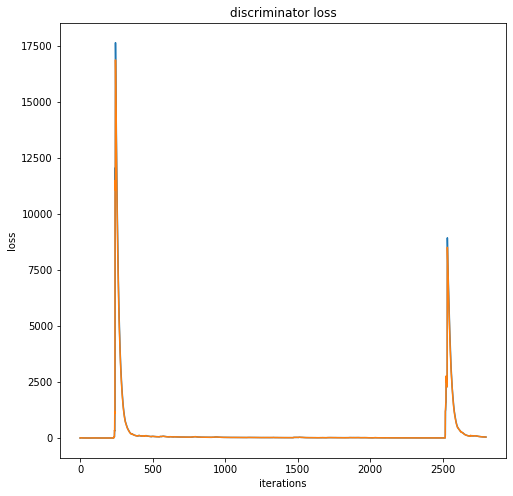

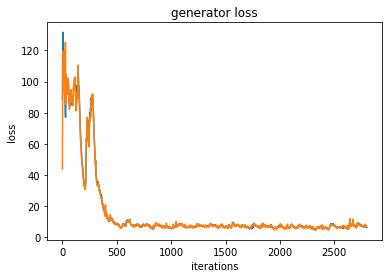

 29%|██▉       | 2899/10000 [32:56<1:20:19,  1.47it/s]

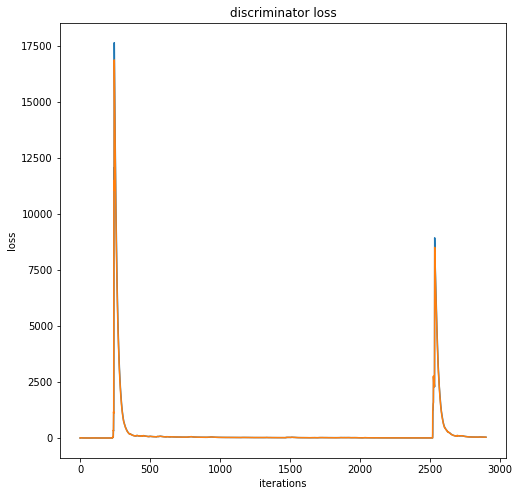

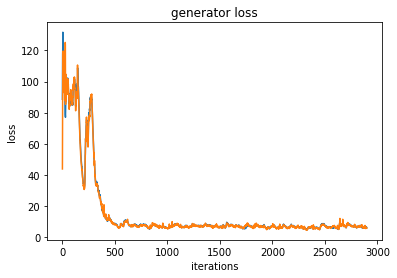

 30%|██▉       | 2999/10000 [34:07<1:18:43,  1.48it/s]

Iteration 3000/703023: dis loss = 23.4195, gen loss = 4.0910


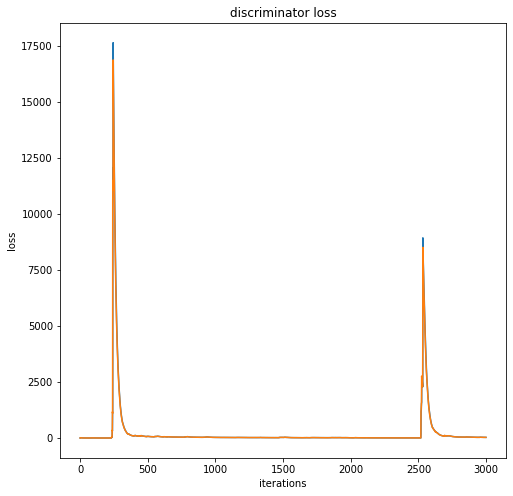

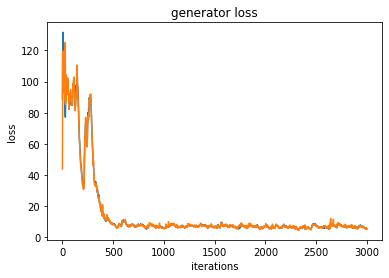

 31%|███       | 3099/10000 [35:17<1:15:57,  1.51it/s]

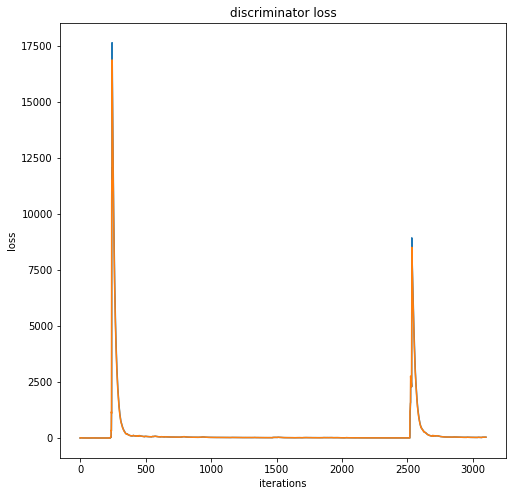

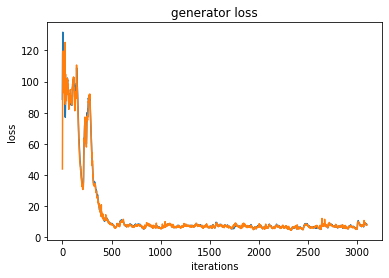

 32%|███▏      | 3199/10000 [36:26<1:14:40,  1.52it/s]

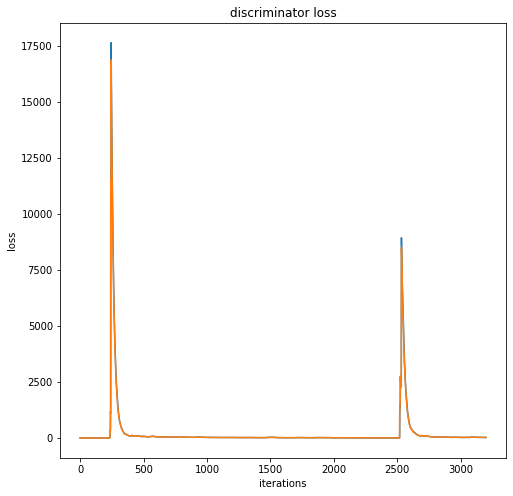

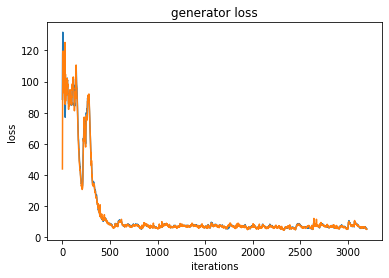

 33%|███▎      | 3299/10000 [37:32<1:20:47,  1.38it/s]

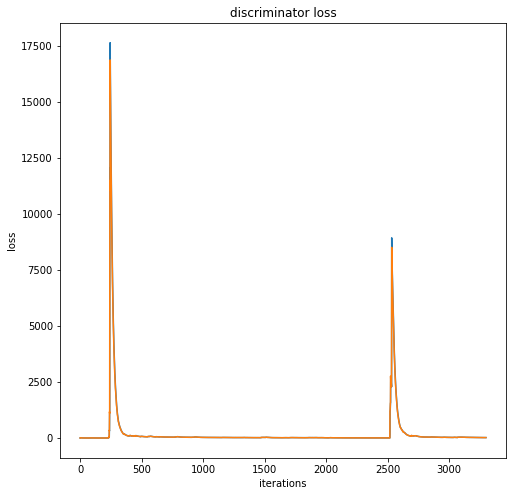

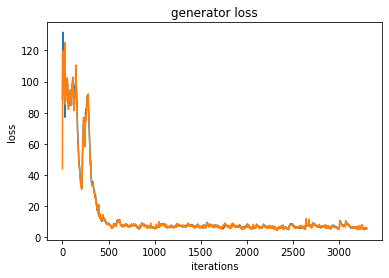

 34%|███▍      | 3399/10000 [38:41<1:13:51,  1.49it/s]

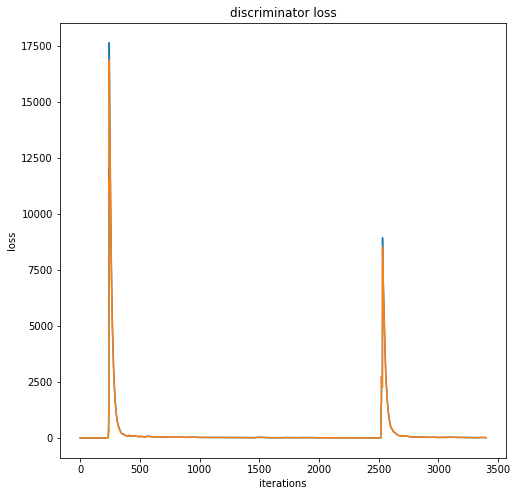

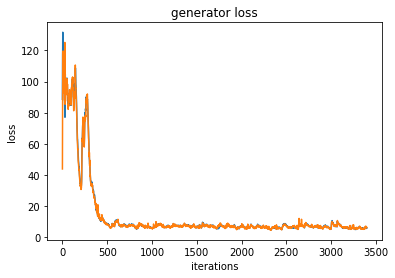

 35%|███▍      | 3499/10000 [39:49<1:11:48,  1.51it/s]

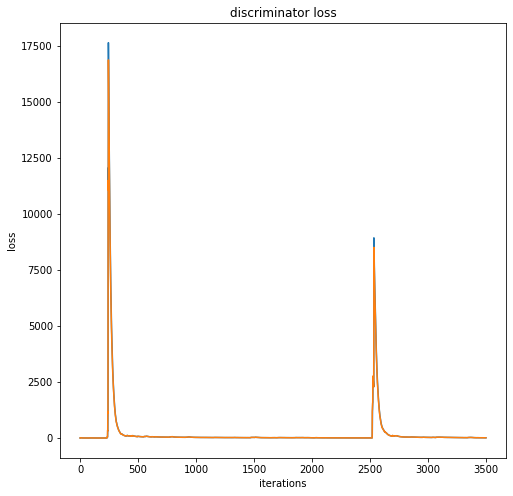

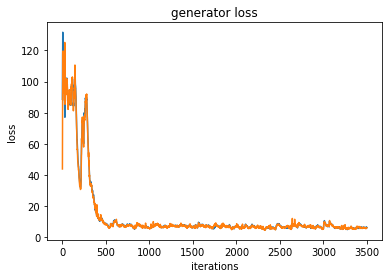

 36%|███▌      | 3599/10000 [41:03<1:16:35,  1.39it/s]

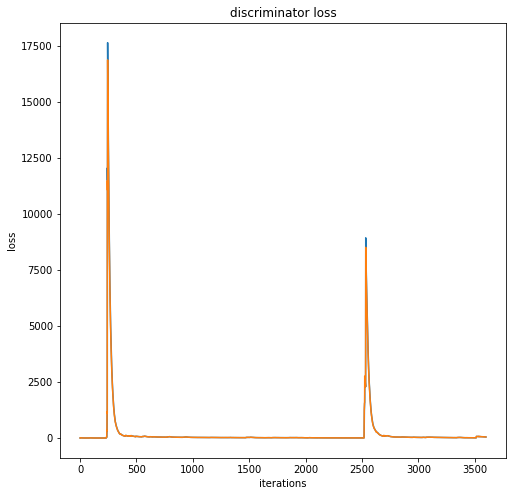

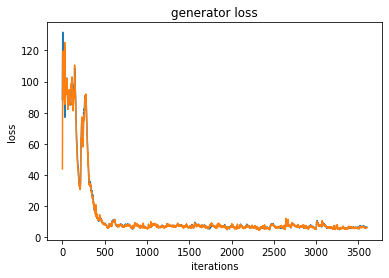

 37%|███▋      | 3699/10000 [42:19<1:12:26,  1.45it/s]

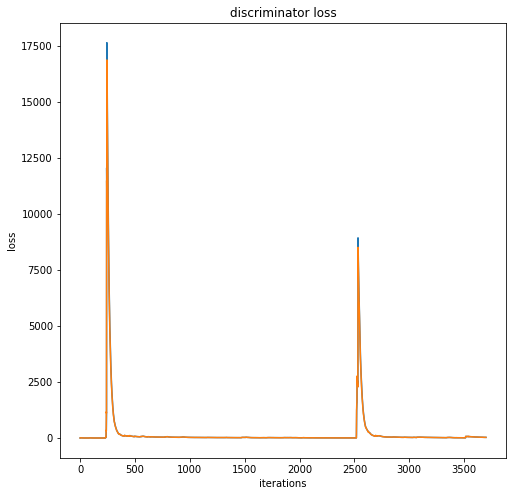

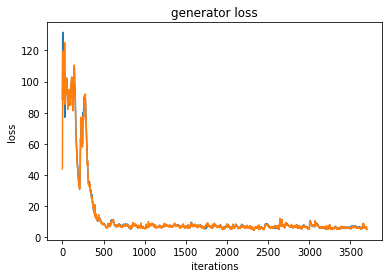

 38%|███▊      | 3799/10000 [43:28<1:08:57,  1.50it/s]

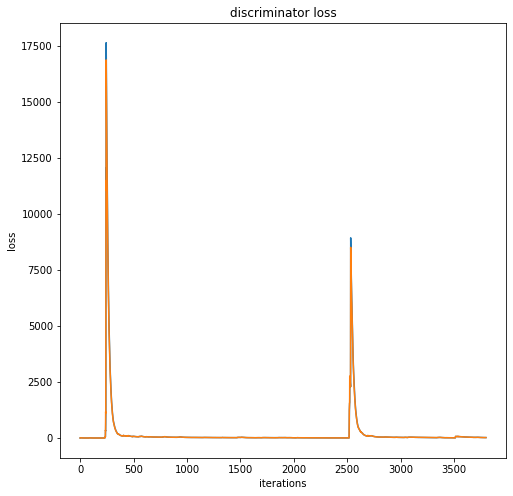

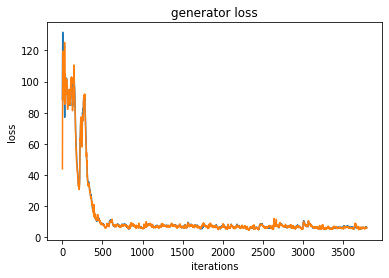

 39%|███▉      | 3899/10000 [44:39<1:28:28,  1.15it/s]

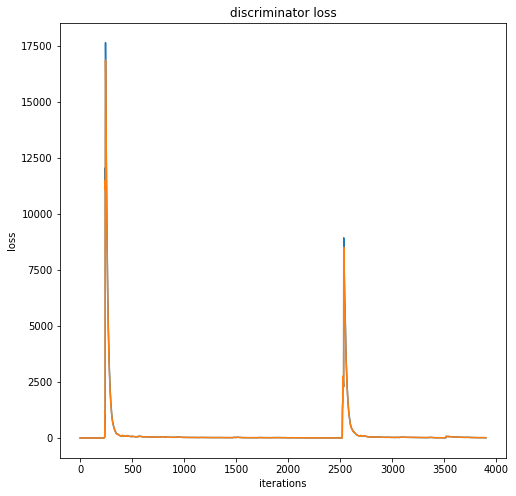

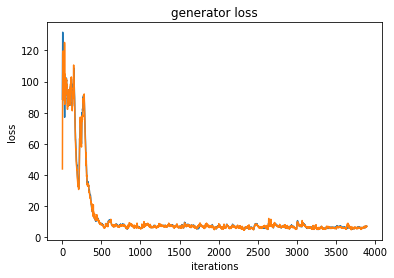

 40%|███▉      | 3999/10000 [1:02:50<18:52:38, 11.32s/it]  

Iteration 4000/703023: dis loss = 10.0923, gen loss = 3.0258


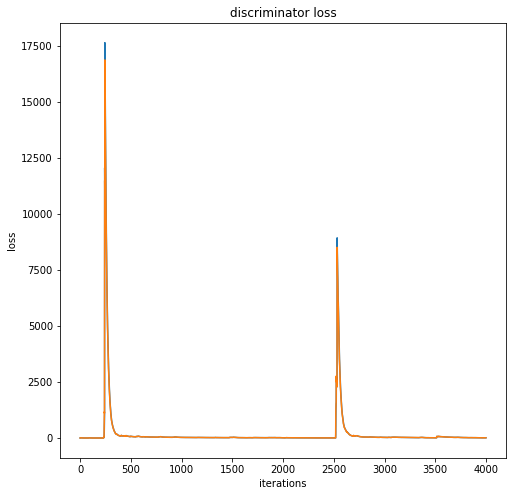

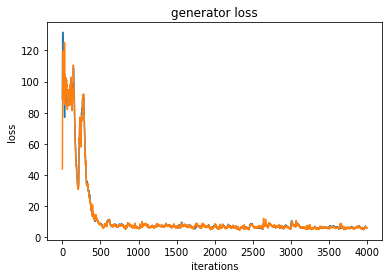

 41%|████      | 4099/10000 [1:59:46<1:14:55,  1.31it/s]    

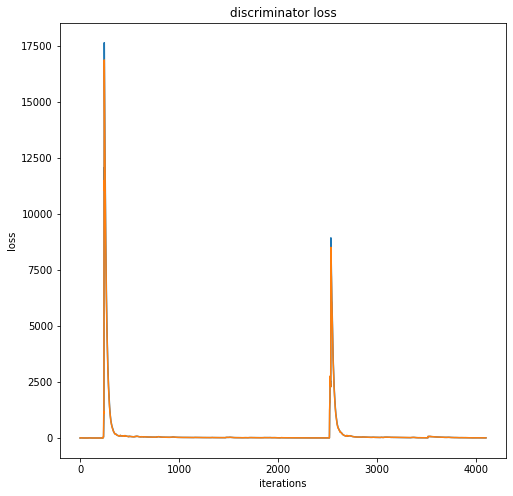

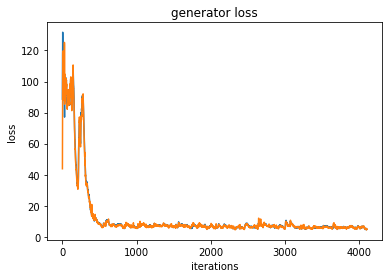

 42%|████▏     | 4199/10000 [2:01:01<1:04:29,  1.50it/s]

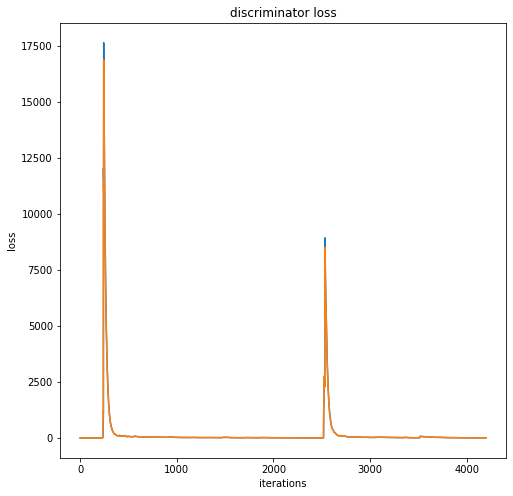

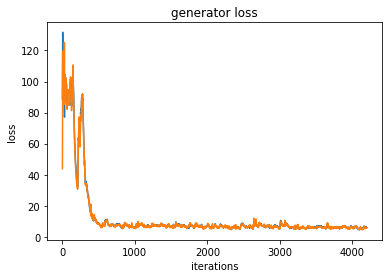

 43%|████▎     | 4299/10000 [2:02:08<1:02:55,  1.51it/s]

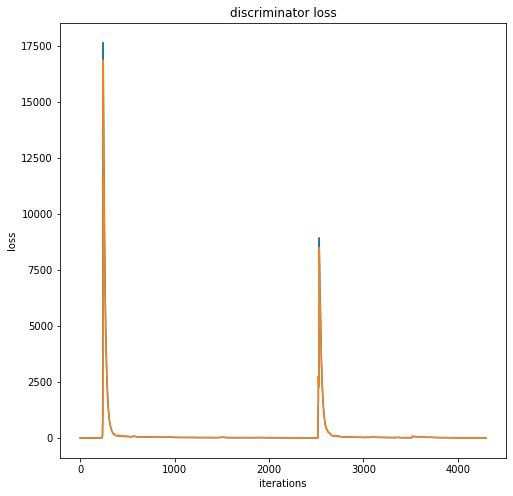

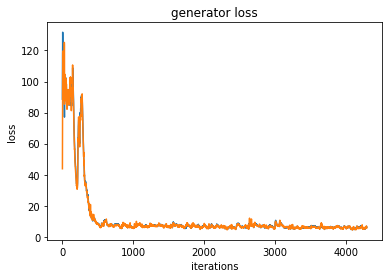

 44%|████▍     | 4399/10000 [2:03:15<1:01:17,  1.52it/s]

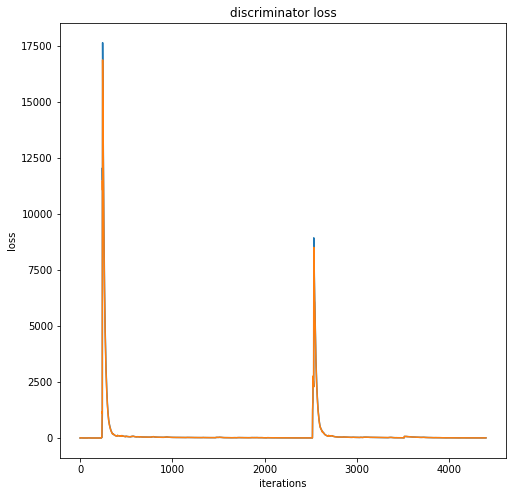

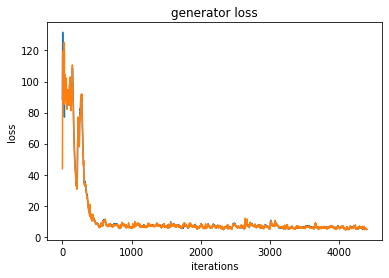

 45%|████▍     | 4499/10000 [2:04:22<1:00:28,  1.52it/s]

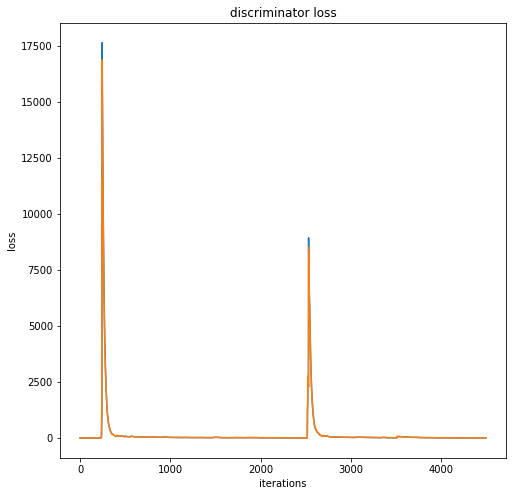

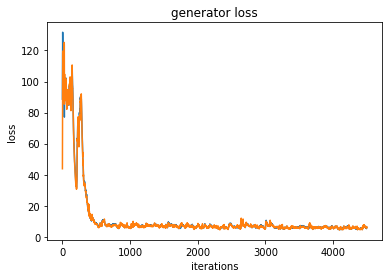

 46%|████▌     | 4599/10000 [2:05:29<59:51,  1.50it/s]  

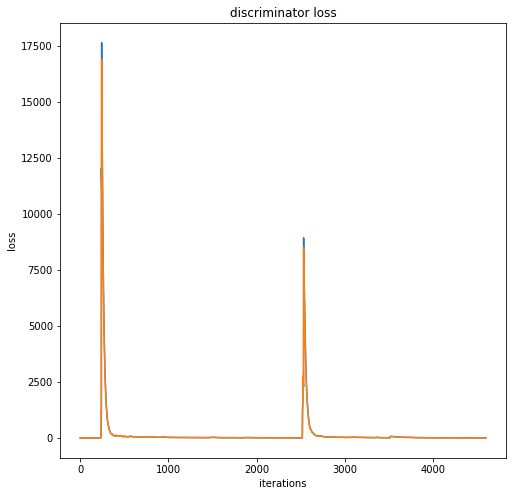

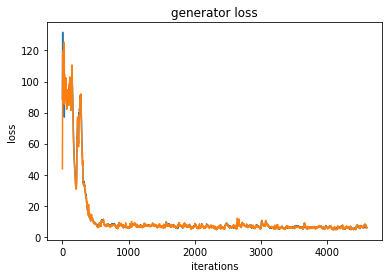

 47%|████▋     | 4699/10000 [2:06:36<59:30,  1.48it/s]  

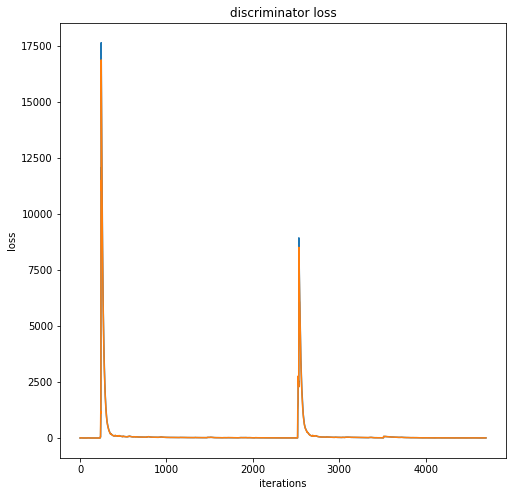

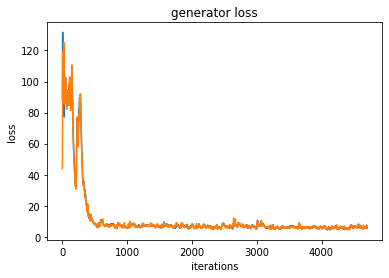

 48%|████▊     | 4799/10000 [2:07:43<56:45,  1.53it/s]  

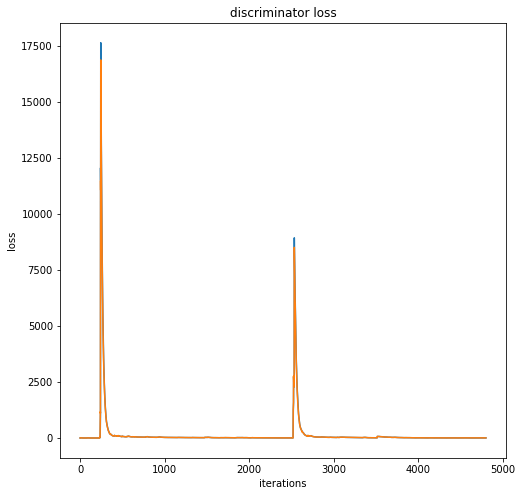

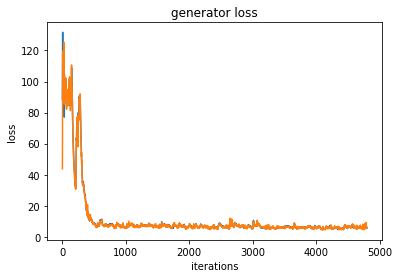

 49%|████▉     | 4899/10000 [2:08:49<56:49,  1.50it/s]  

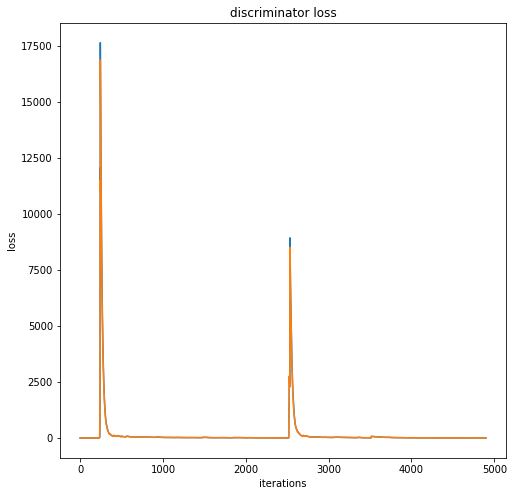

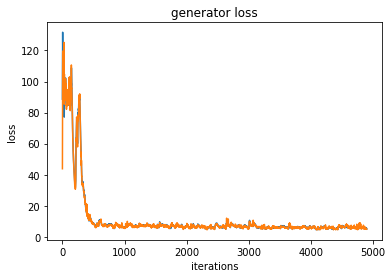

 50%|████▉     | 4999/10000 [2:09:58<59:13,  1.41it/s]  

Iteration 5000/703023: dis loss = 3.6654, gen loss = 1.3912


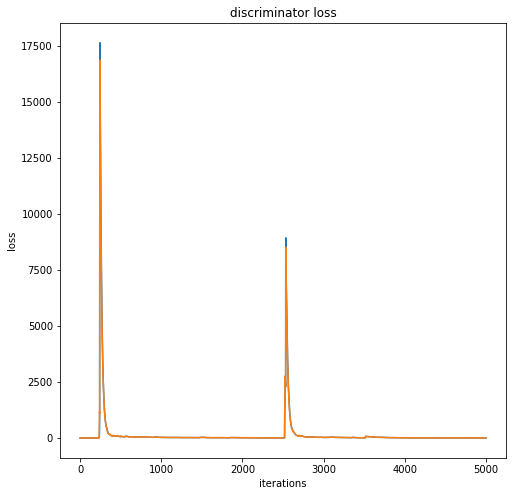

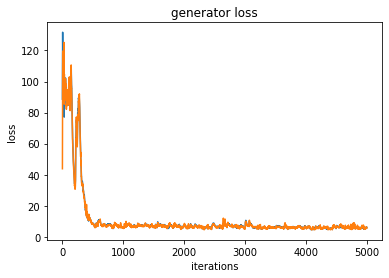

 51%|█████     | 5099/10000 [2:11:07<55:12,  1.48it/s]  

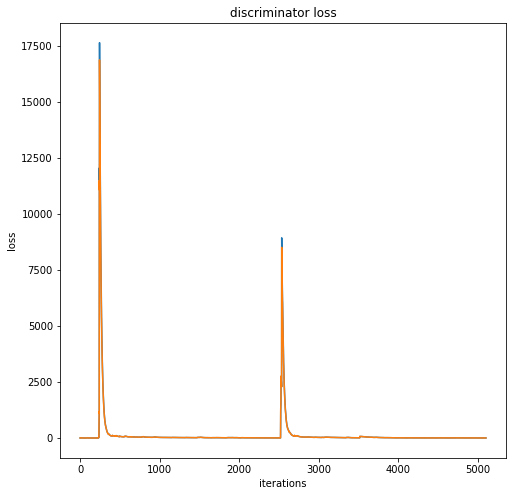

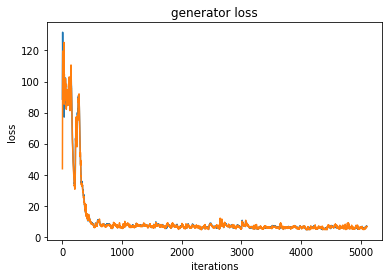

 52%|█████▏    | 5199/10000 [2:12:16<54:25,  1.47it/s]  

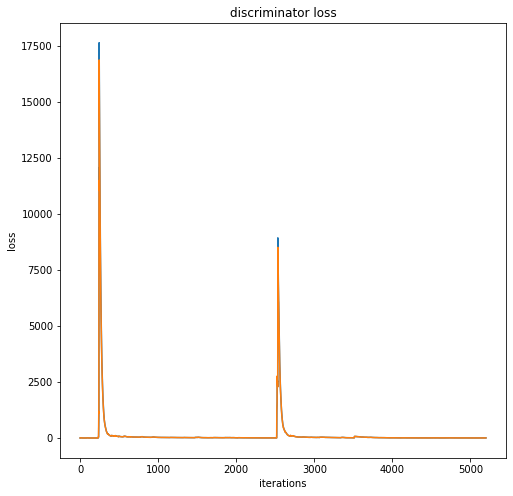

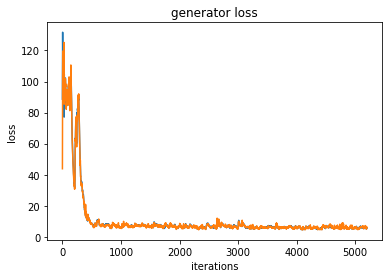

 53%|█████▎    | 5299/10000 [2:13:24<53:29,  1.46it/s]  

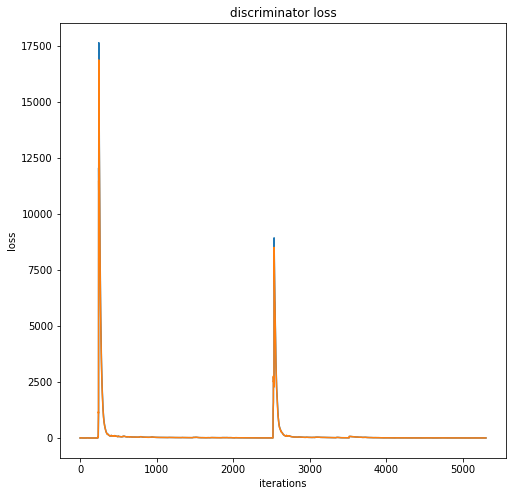

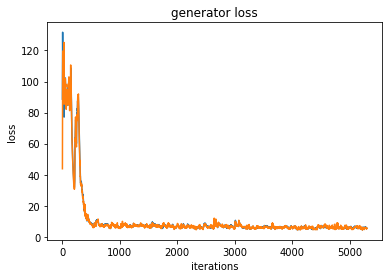

 54%|█████▍    | 5399/10000 [2:14:33<52:46,  1.45it/s]  

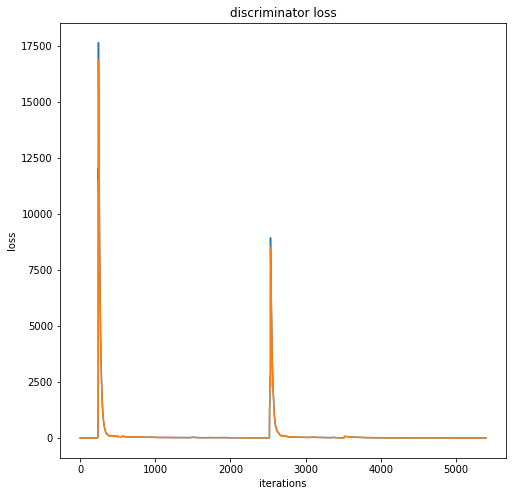

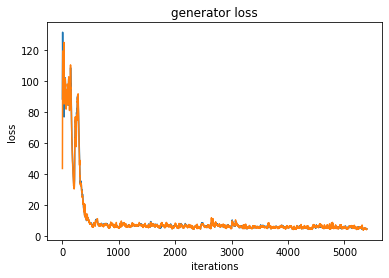

 55%|█████▍    | 5499/10000 [2:15:42<52:01,  1.44it/s]  

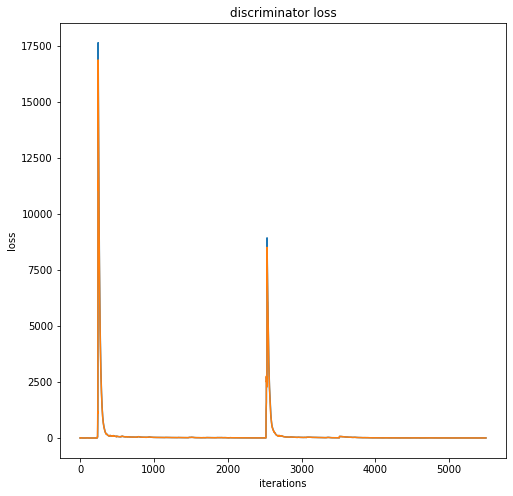

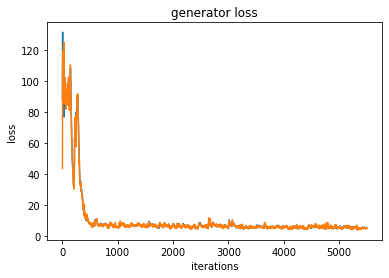

 56%|█████▌    | 5599/10000 [2:16:52<48:49,  1.50it/s]  

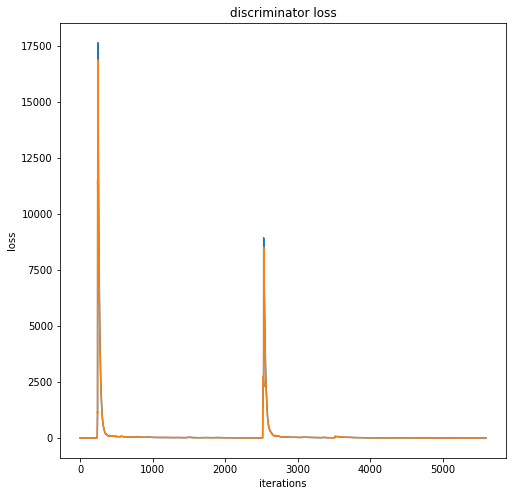

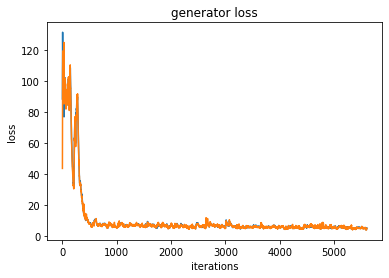

 57%|█████▋    | 5699/10000 [2:17:59<48:22,  1.48it/s]

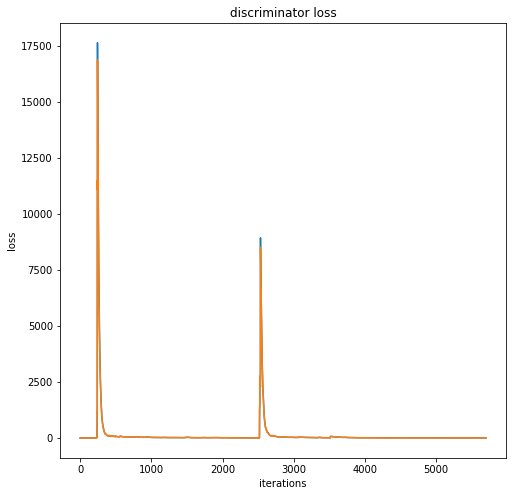

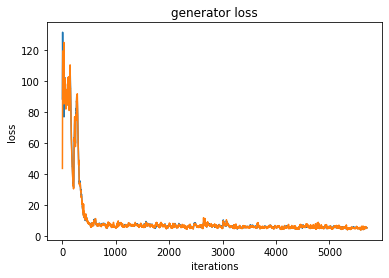

 58%|█████▊    | 5799/10000 [2:19:06<47:52,  1.46it/s]

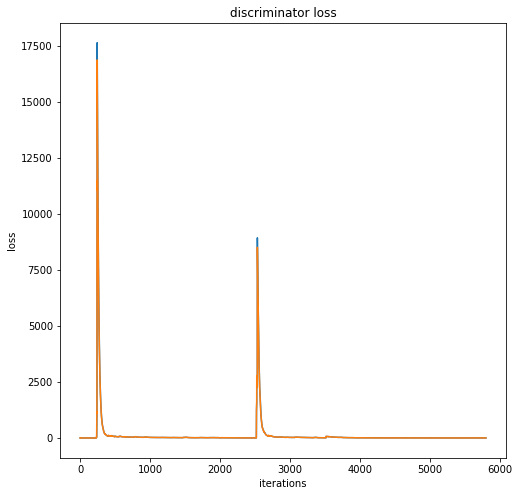

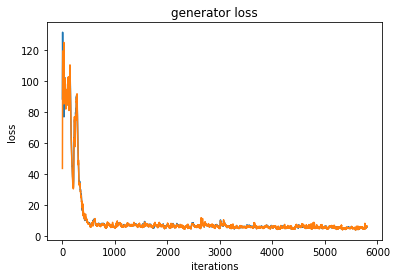

 59%|█████▉    | 5899/10000 [2:20:14<46:50,  1.46it/s]

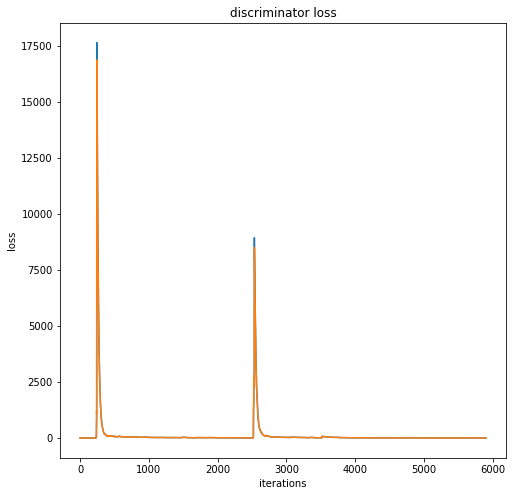

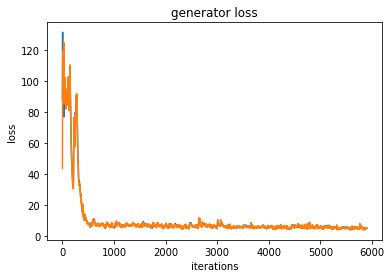

 60%|█████▉    | 5999/10000 [2:21:23<44:47,  1.49it/s]

Iteration 6000/703023: dis loss = 0.4602, gen loss = 10.7022


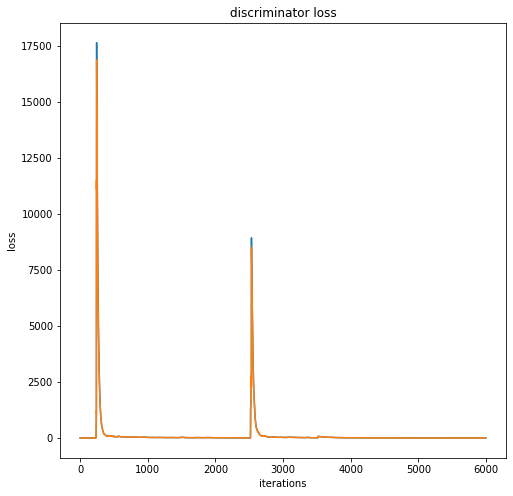

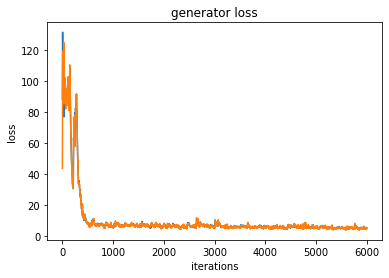

 61%|██████    | 6099/10000 [2:22:33<47:20,  1.37it/s]  

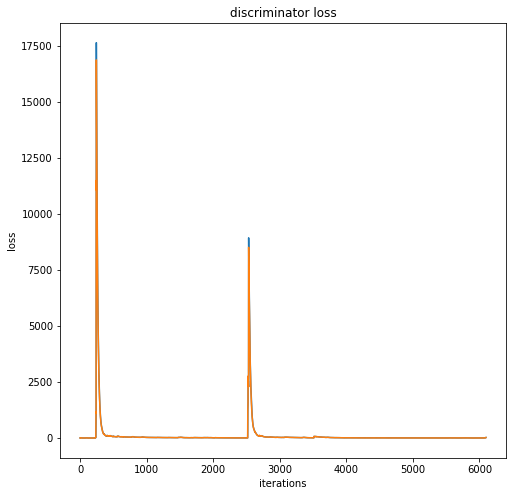

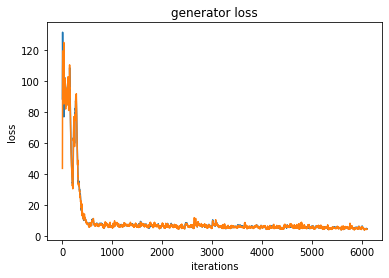

 62%|██████▏   | 6199/10000 [2:23:42<43:41,  1.45it/s]

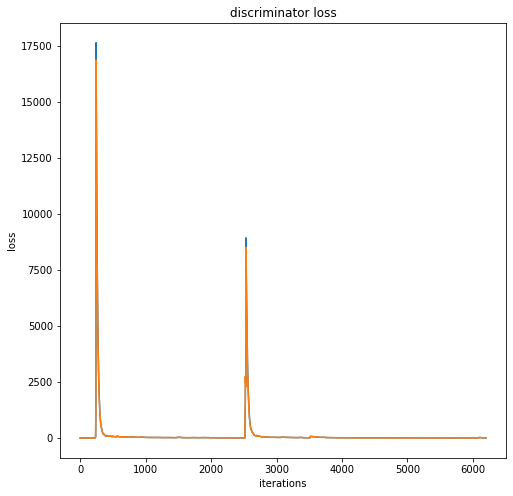

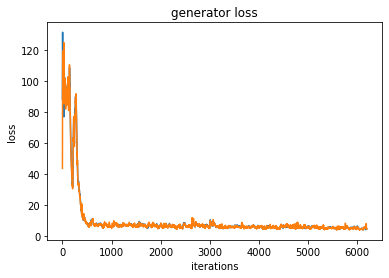

 63%|██████▎   | 6299/10000 [2:24:50<42:08,  1.46it/s]

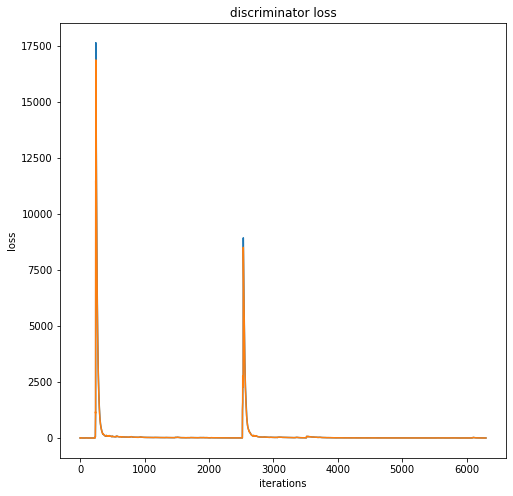

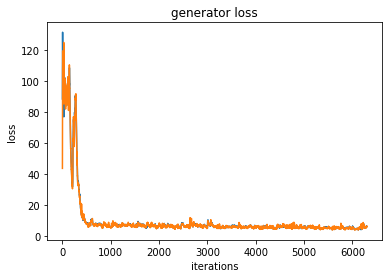

 64%|██████▍   | 6399/10000 [2:25:58<39:48,  1.51it/s]

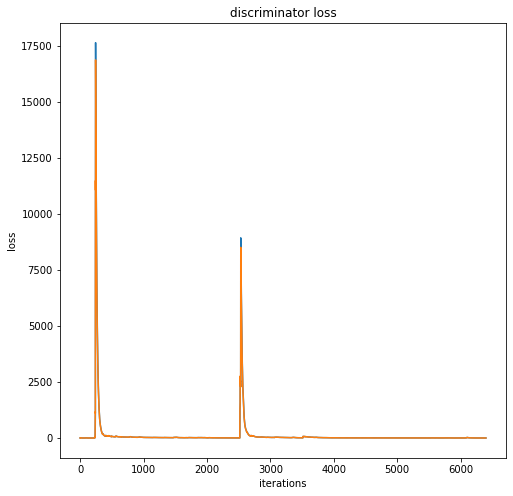

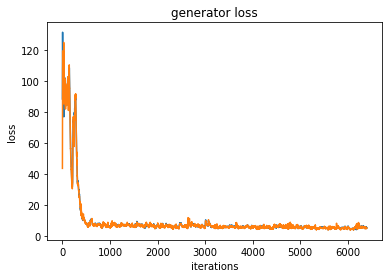

 65%|██████▍   | 6499/10000 [2:27:04<39:04,  1.49it/s]

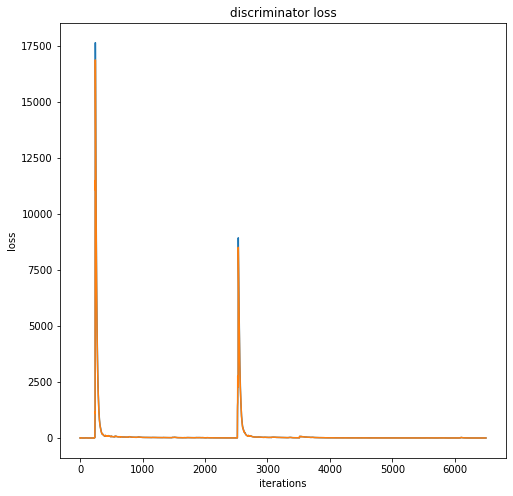

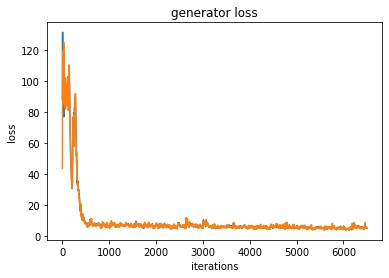

 66%|██████▌   | 6599/10000 [2:28:11<37:33,  1.51it/s]

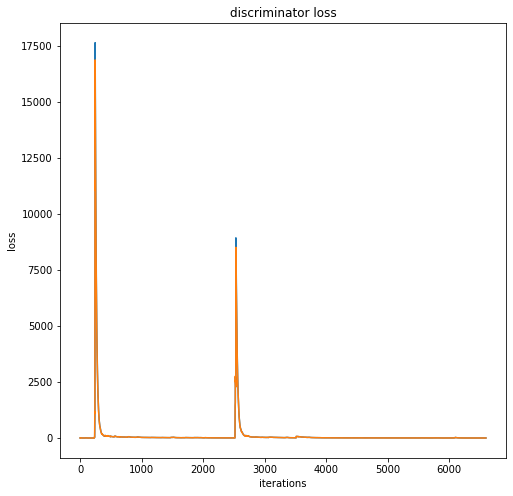

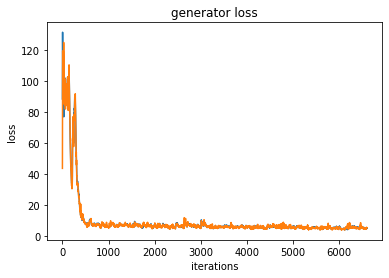

 67%|██████▋   | 6699/10000 [2:29:19<36:27,  1.51it/s]

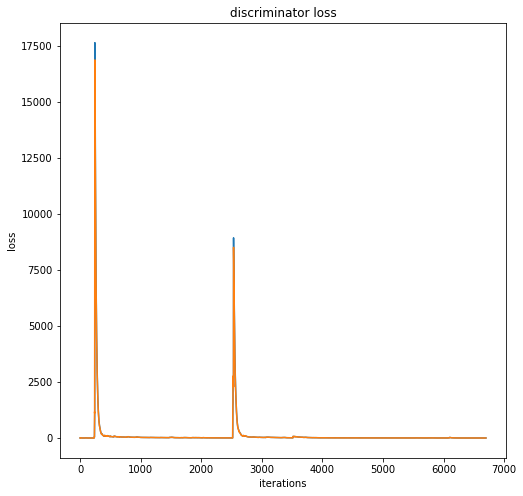

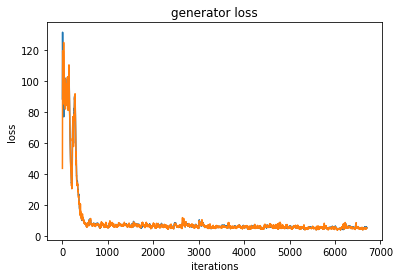

 68%|██████▊   | 6799/10000 [2:30:26<35:44,  1.49it/s]

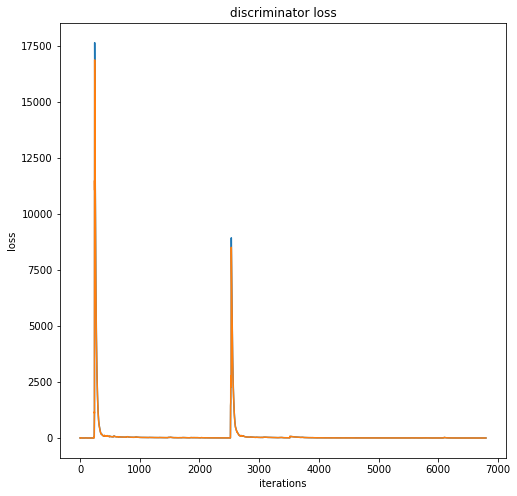

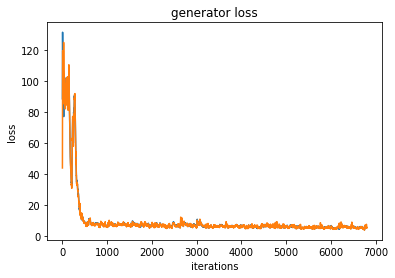

 69%|██████▉   | 6899/10000 [2:31:32<34:20,  1.50it/s]

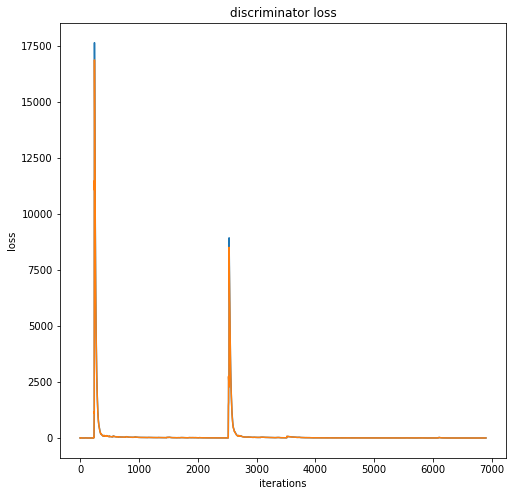

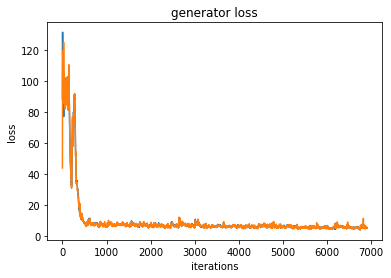

 70%|██████▉   | 6999/10000 [2:32:39<33:35,  1.49it/s]

Iteration 7000/703023: dis loss = 1.4797, gen loss = 5.9994


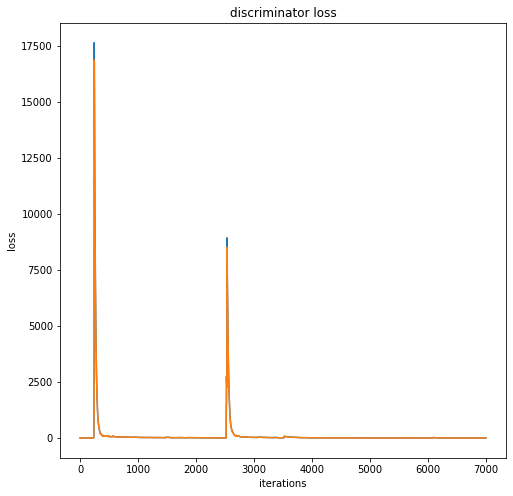

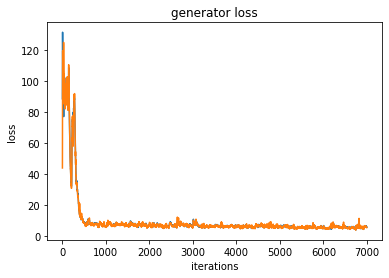

 71%|███████   | 7099/10000 [2:33:47<32:02,  1.51it/s]

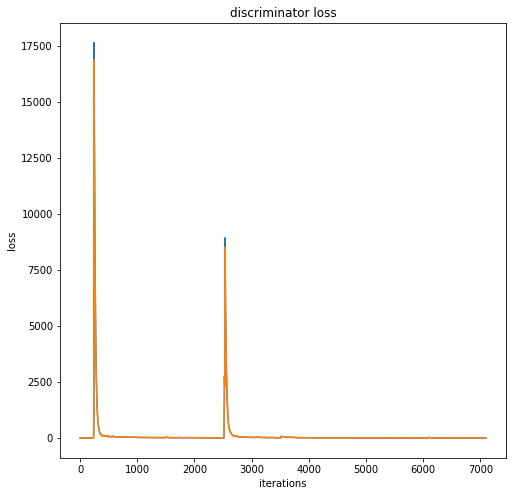

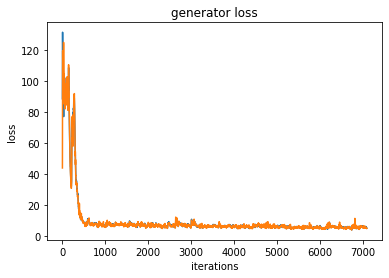

 72%|███████▏  | 7199/10000 [2:34:56<32:06,  1.45it/s]

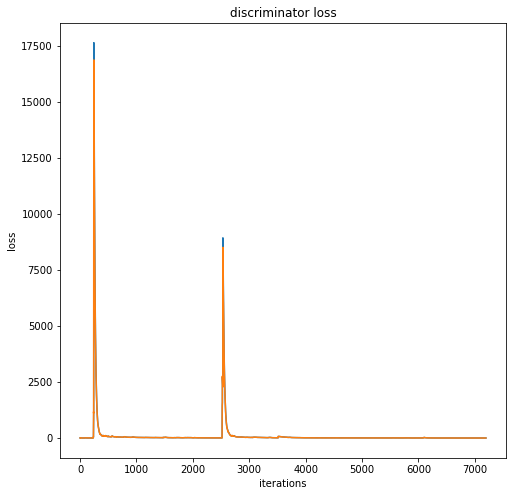

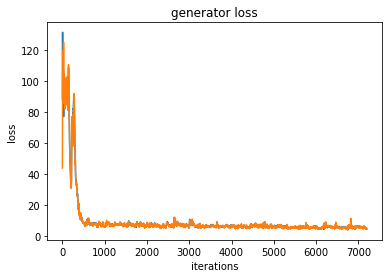

 73%|███████▎  | 7299/10000 [2:36:04<29:53,  1.51it/s]

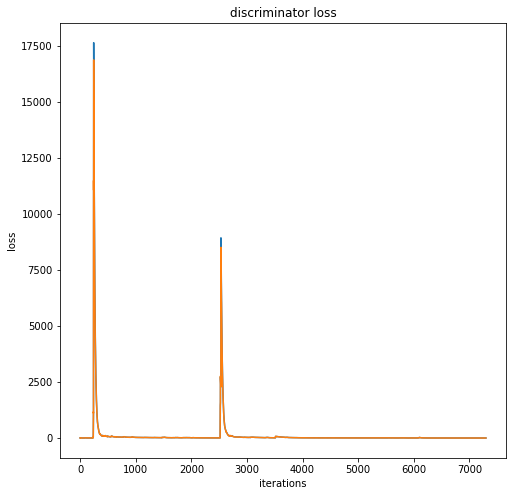

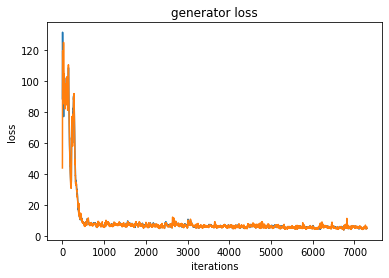

 74%|███████▍  | 7399/10000 [2:37:12<29:23,  1.48it/s]

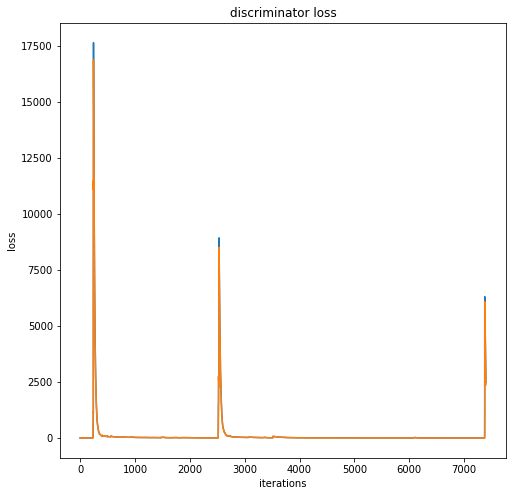

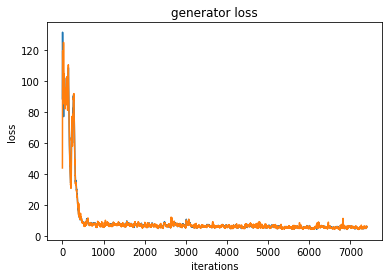

 75%|███████▍  | 7499/10000 [2:38:29<30:26,  1.37it/s]  

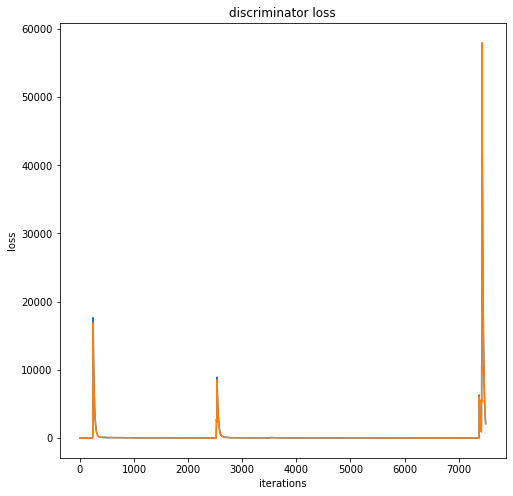

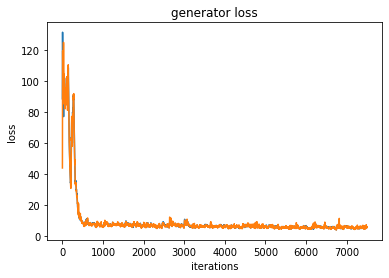

 76%|███████▌  | 7599/10000 [2:39:47<28:20,  1.41it/s]

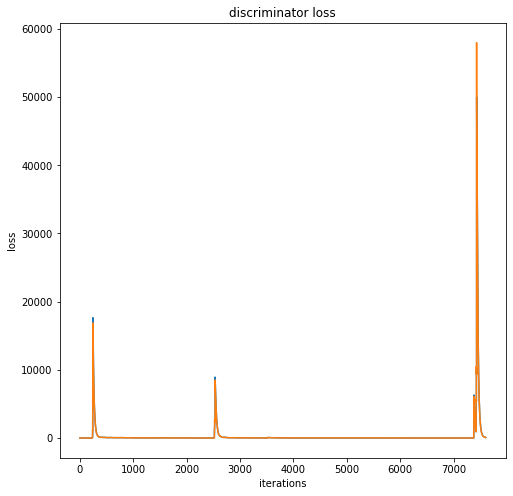

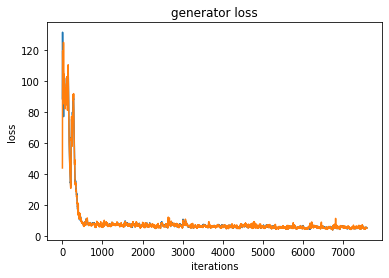

 77%|███████▋  | 7699/10000 [2:40:57<25:35,  1.50it/s]

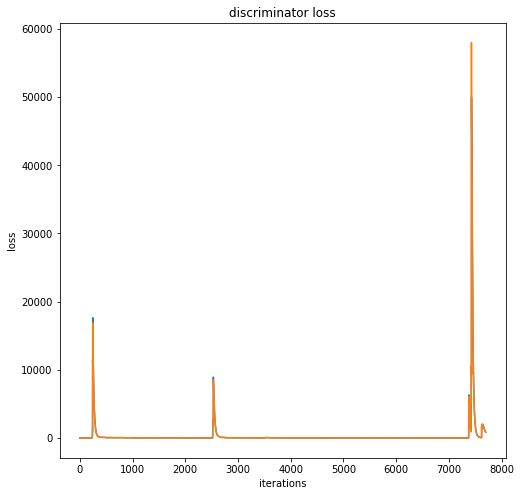

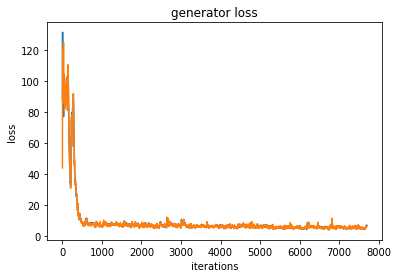

 78%|███████▊  | 7799/10000 [2:42:11<25:15,  1.45it/s]

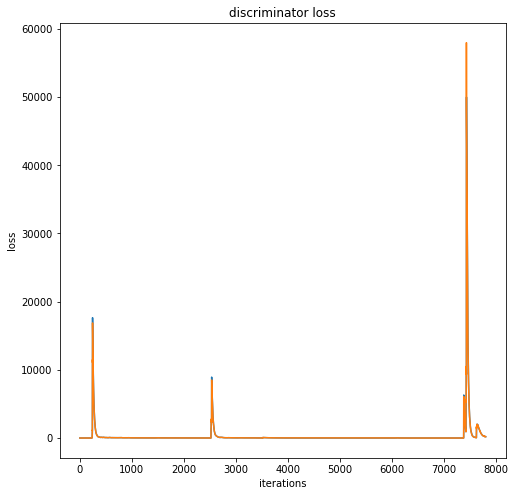

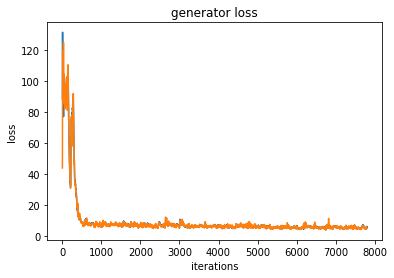

 79%|███████▉  | 7899/10000 [2:43:22<24:23,  1.44it/s]

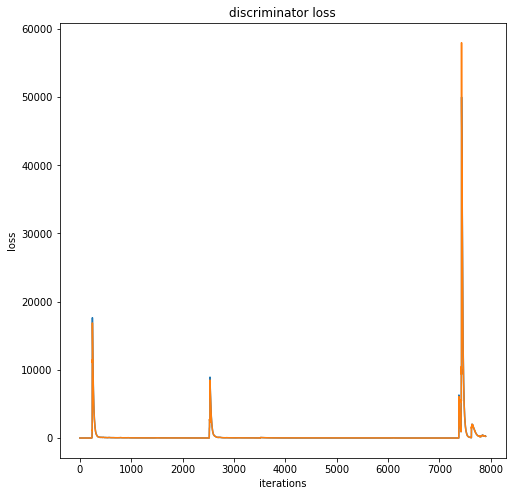

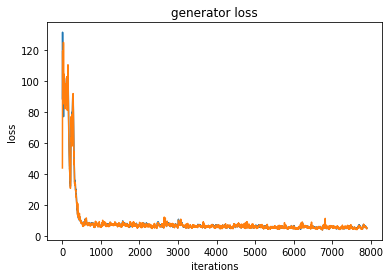

 80%|███████▉  | 7999/10000 [2:44:41<24:54,  1.34it/s]

Iteration 8000/703023: dis loss = 125.7687, gen loss = 11.3569


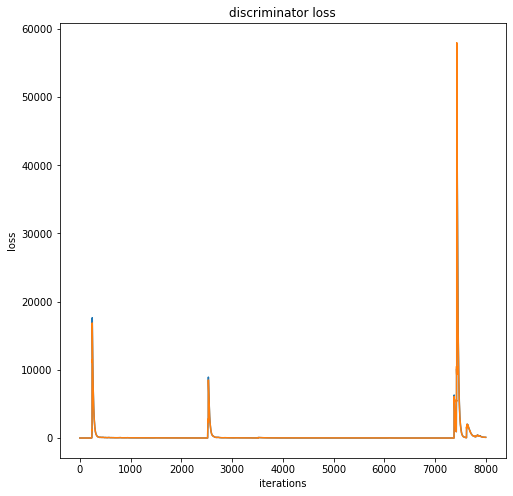

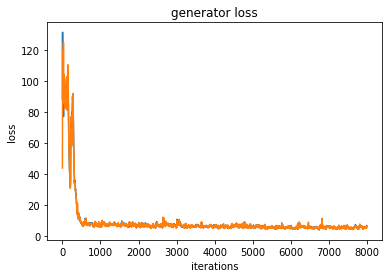

 81%|████████  | 8099/10000 [2:46:09<26:47,  1.18it/s]

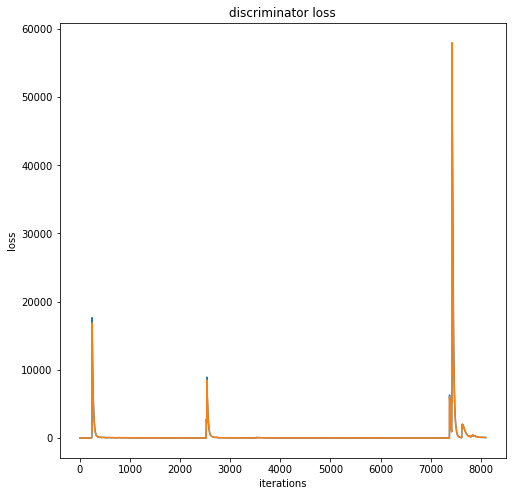

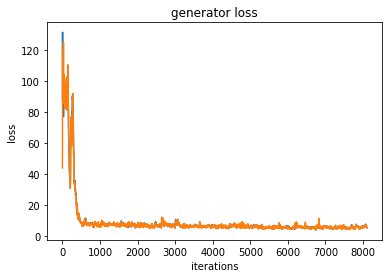

 82%|████████▏ | 8199/10000 [2:47:35<29:47,  1.01it/s]

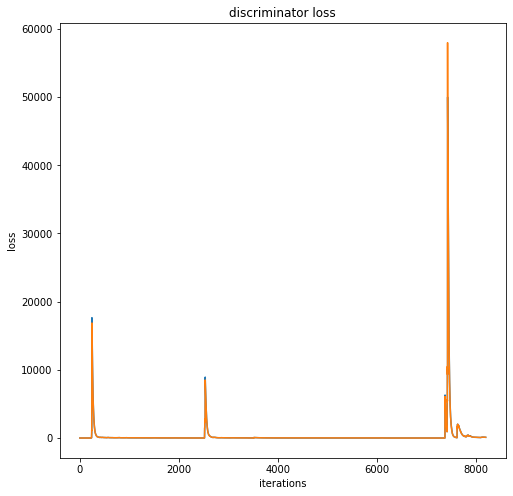

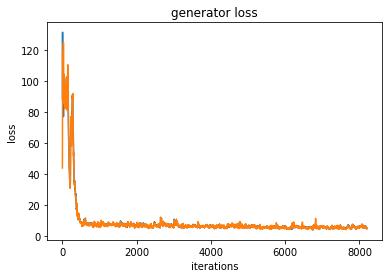

 83%|████████▎ | 8299/10000 [2:48:57<21:11,  1.34it/s]

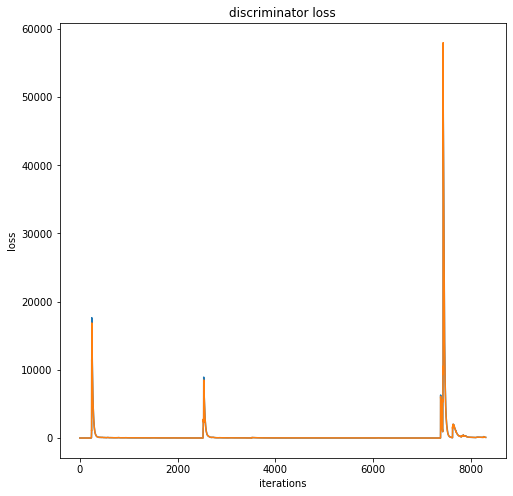

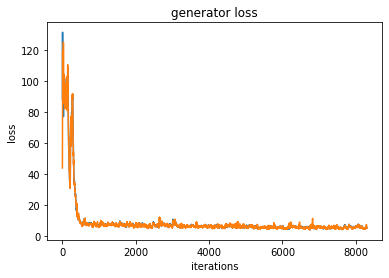

 84%|████████▍ | 8399/10000 [2:50:14<20:06,  1.33it/s]

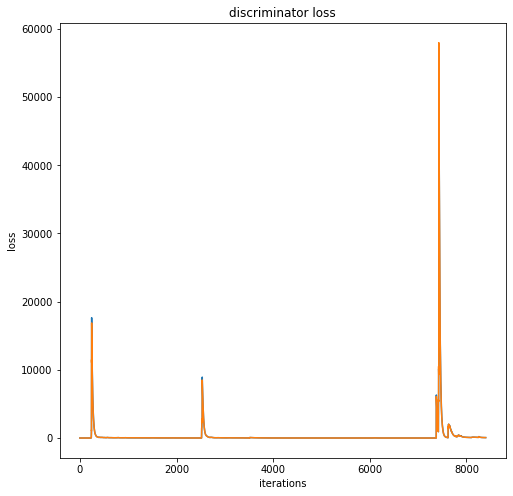

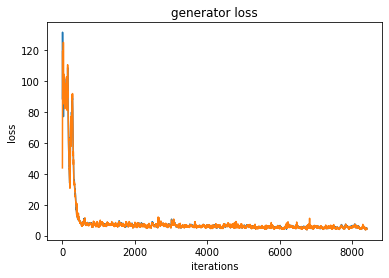

 85%|████████▍ | 8499/10000 [2:51:32<18:34,  1.35it/s]

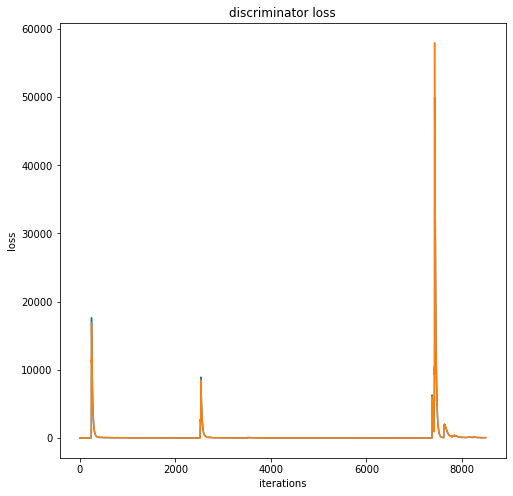

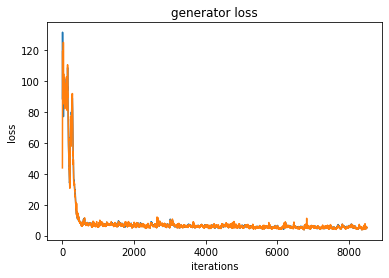

 86%|████████▌ | 8599/10000 [2:52:57<17:43,  1.32it/s]

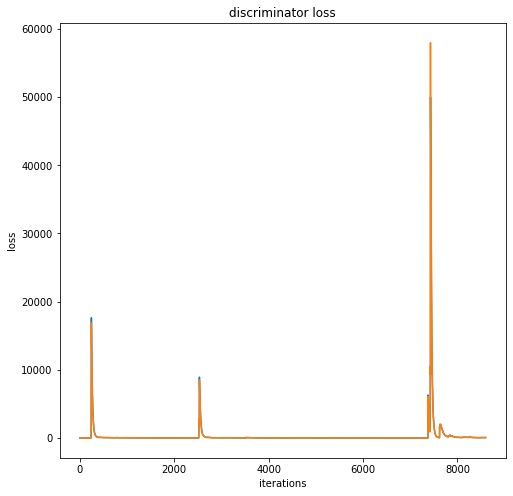

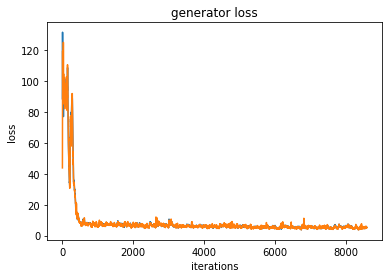

 87%|████████▋ | 8699/10000 [2:54:24<17:18,  1.25it/s]

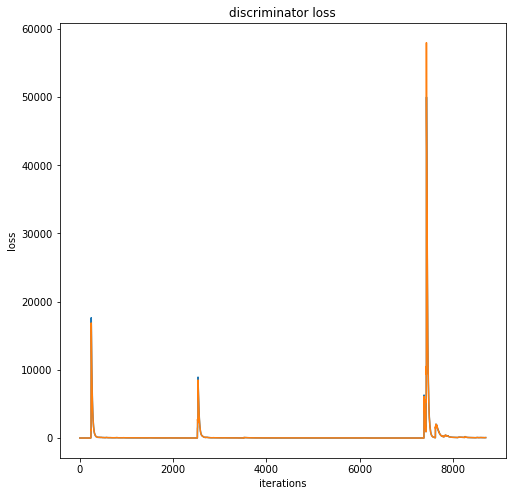

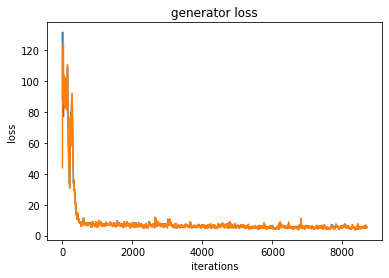

 88%|████████▊ | 8799/10000 [2:55:45<16:05,  1.24it/s]

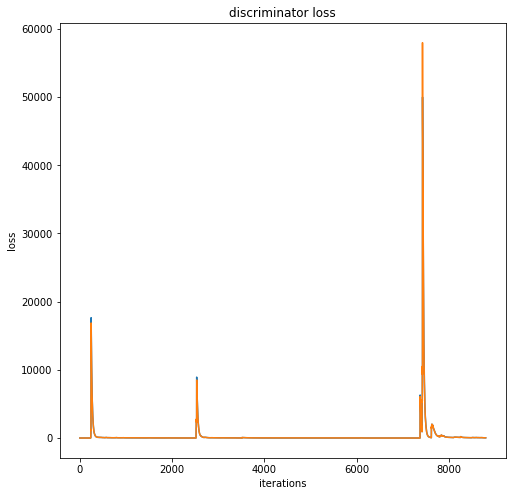

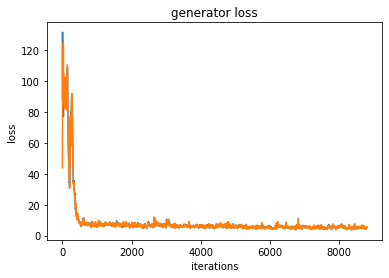

 89%|████████▉ | 8899/10000 [2:57:19<18:15,  1.00it/s]

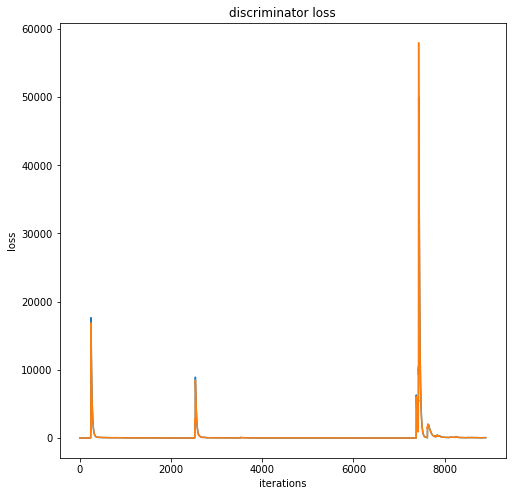

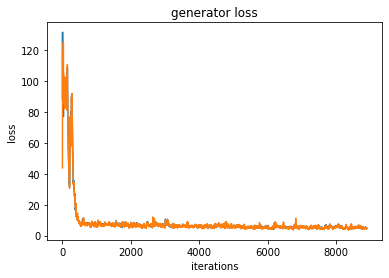

 90%|████████▉ | 8999/10000 [2:58:51<14:18,  1.17it/s]

Iteration 9000/703023: dis loss = 43.1538, gen loss = 1.8028


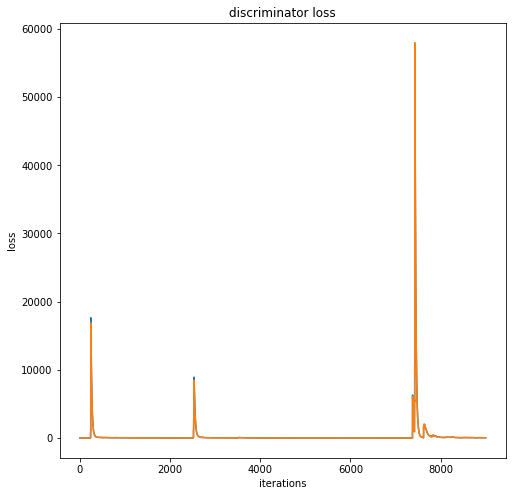

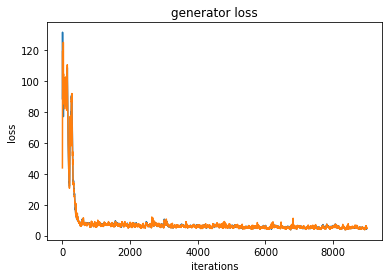

 91%|█████████ | 9099/10000 [3:00:06<11:24,  1.32it/s]

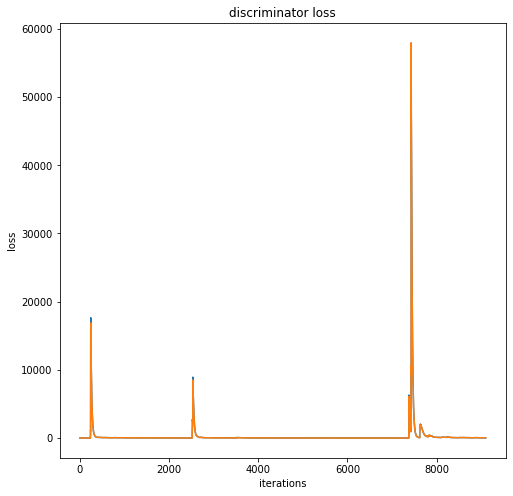

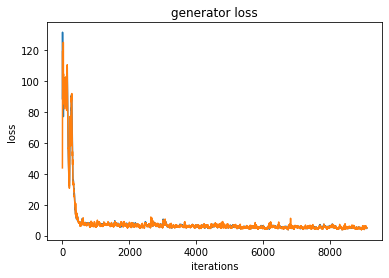

 92%|█████████▏| 9199/10000 [3:01:21<09:54,  1.35it/s]

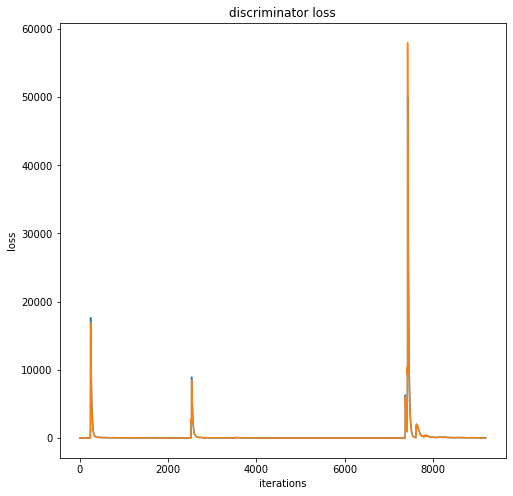

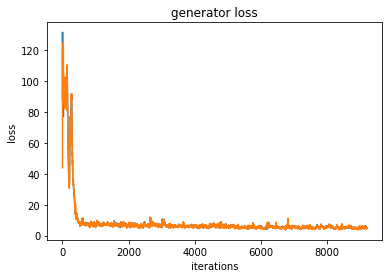

 93%|█████████▎| 9299/10000 [3:02:40<10:19,  1.13it/s]

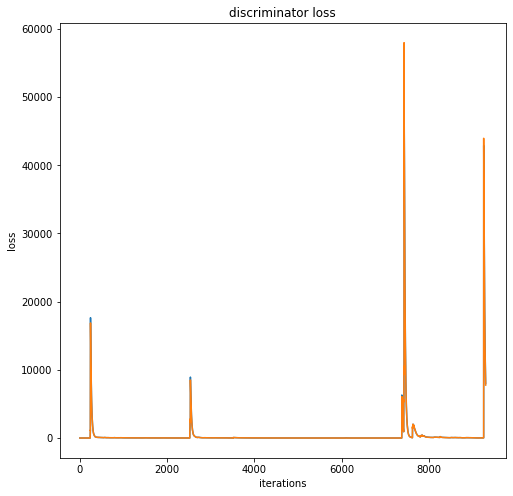

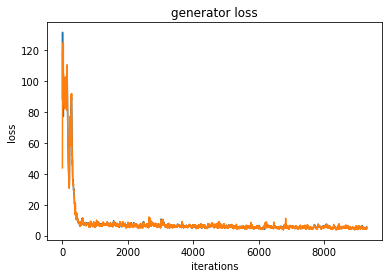

 94%|█████████▍| 9399/10000 [3:03:57<08:32,  1.17it/s]

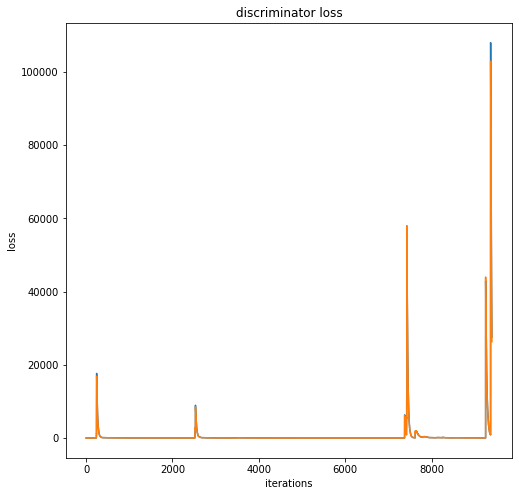

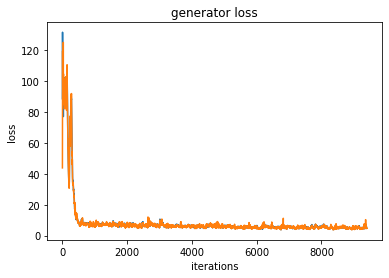

 95%|█████████▍| 9499/10000 [3:05:17<06:19,  1.32it/s]

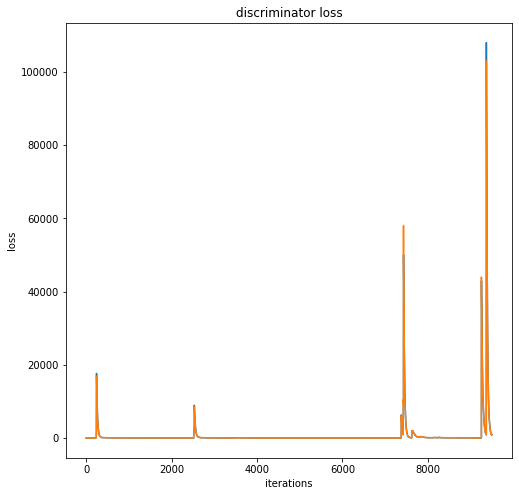

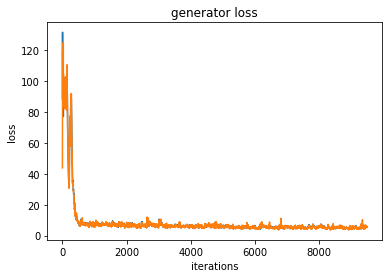

 96%|█████████▌| 9599/10000 [3:06:34<05:25,  1.23it/s]

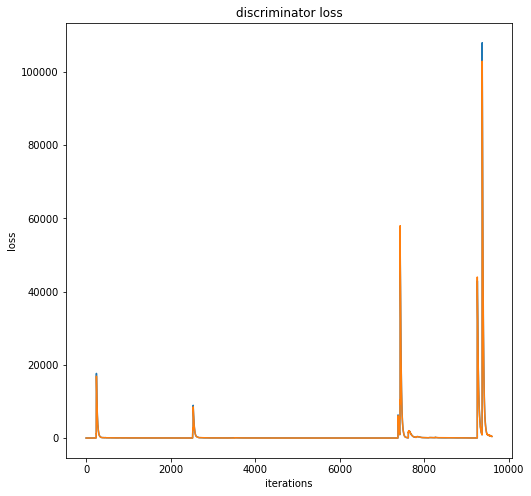

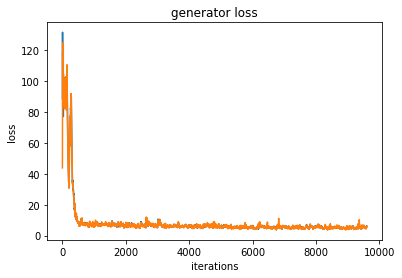

 97%|█████████▋| 9699/10000 [3:07:49<03:47,  1.32it/s]

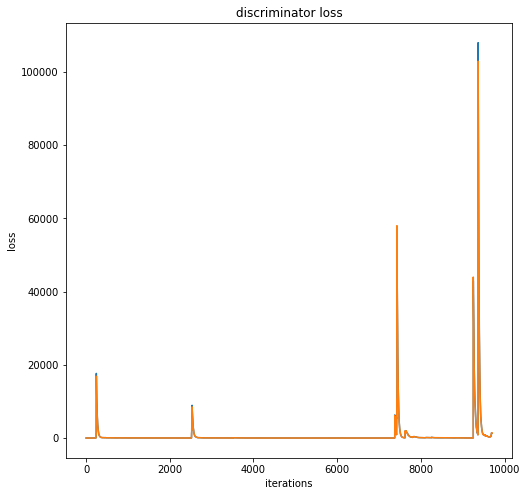

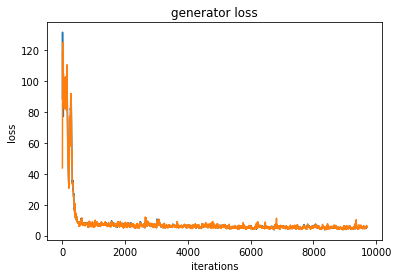

 98%|█████████▊| 9799/10000 [3:09:04<02:28,  1.35it/s]

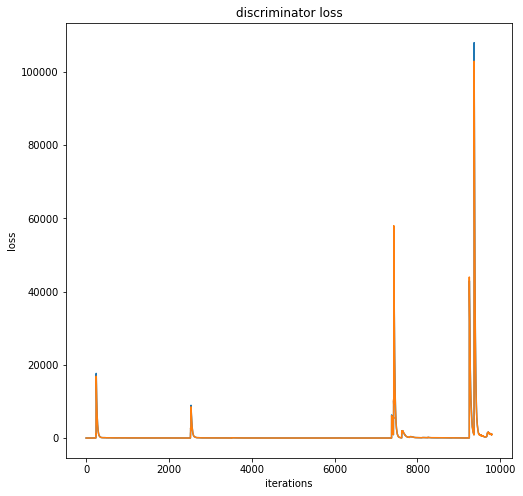

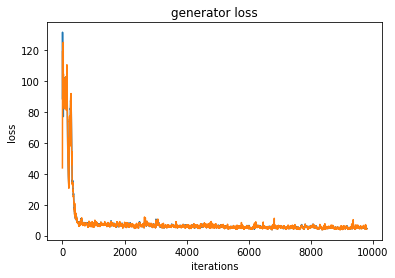

 99%|█████████▉| 9899/10000 [3:10:23<01:13,  1.38it/s]

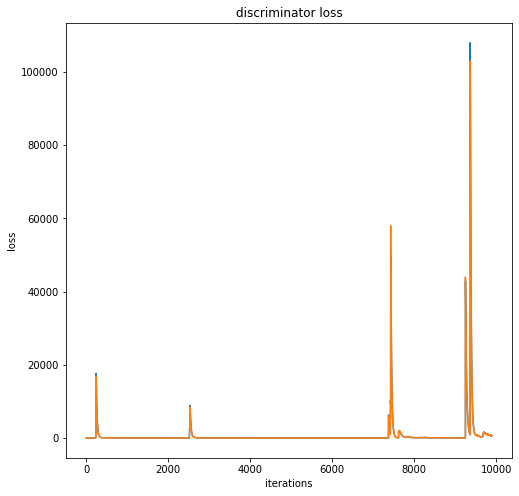

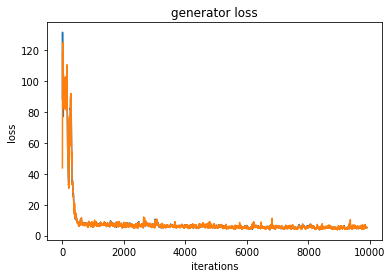

100%|█████████▉| 9999/10000 [3:11:40<00:00,  1.28it/s]

Iteration 10000/703023: dis loss = 528.5188, gen loss = 1.2827


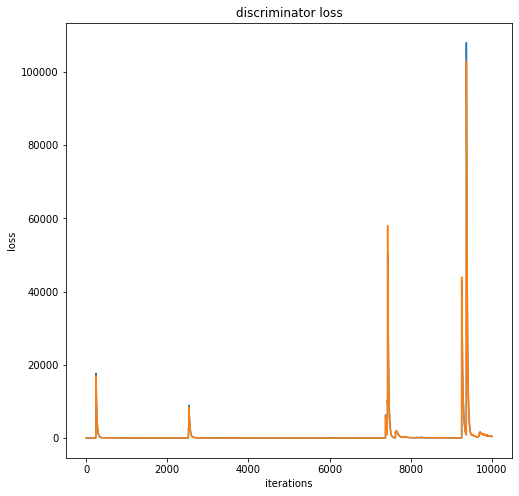

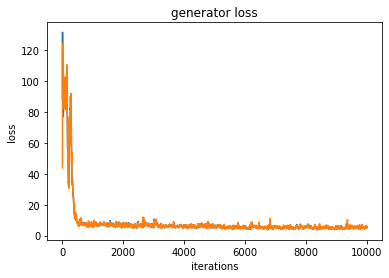

100%|██████████| 10000/10000 [3:11:41<00:00,  1.15s/it]


... Done!


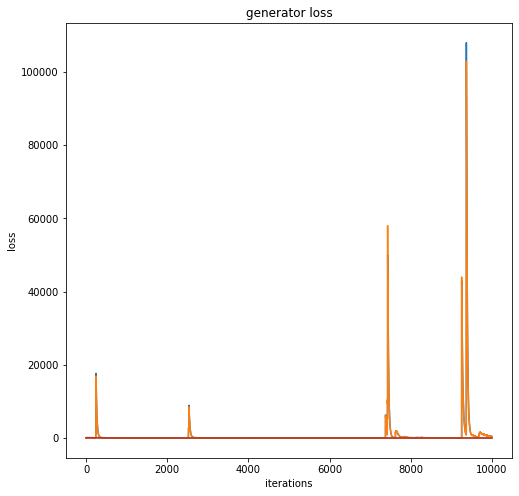

In [12]:
gan = GAN()
gan(train_dataloader)

# # training with different discriminator - dropout, leakyRelu, batch norm, lr=1e-4

  0%|          | 0/10000 [00:00<?, ?it/s]

Start training ...


  1%|          | 99/10000 [01:11<1:58:35,  1.39it/s]

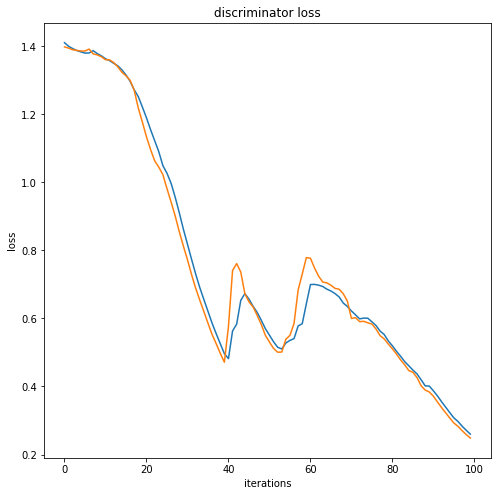

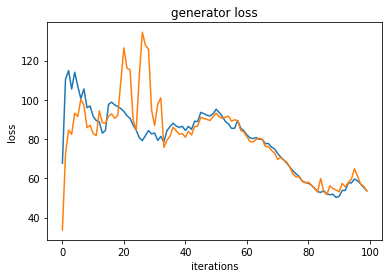

  2%|▏         | 199/10000 [02:17<1:44:15,  1.57it/s]

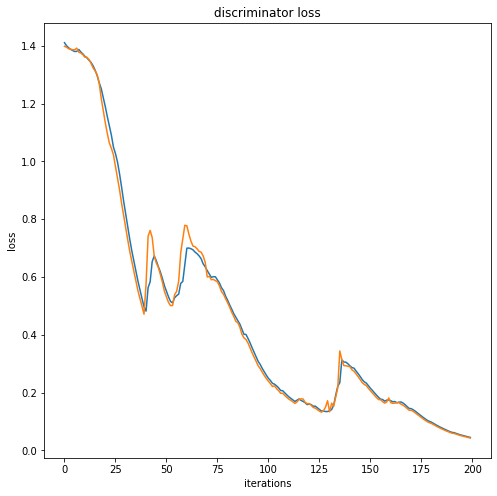

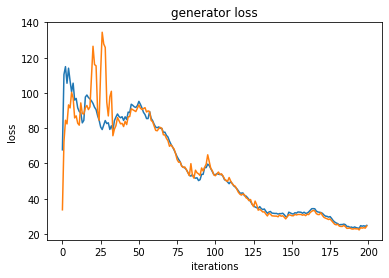

  3%|▎         | 299/10000 [03:23<1:57:09,  1.38it/s]

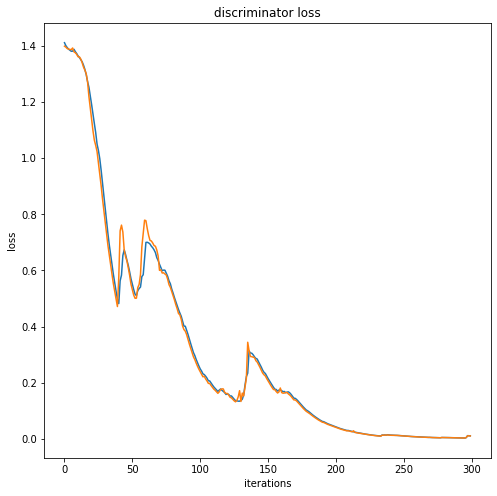

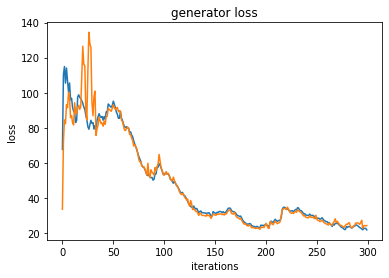

  4%|▍         | 399/10000 [04:29<1:49:13,  1.47it/s]

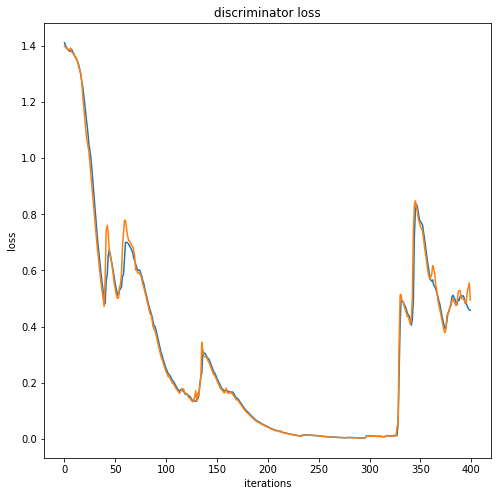

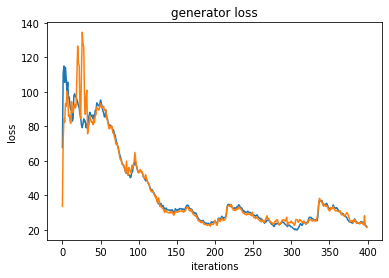

  5%|▍         | 499/10000 [05:33<1:41:05,  1.57it/s]

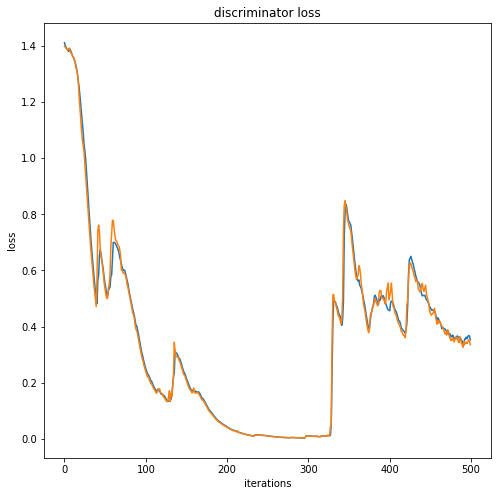

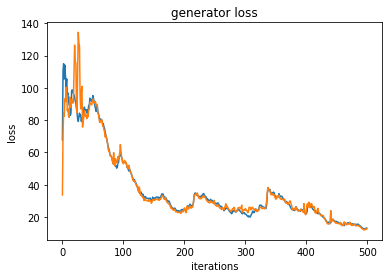

  6%|▌         | 599/10000 [06:39<1:42:10,  1.53it/s]

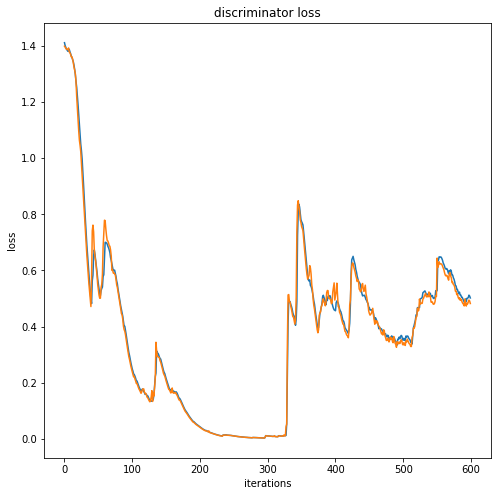

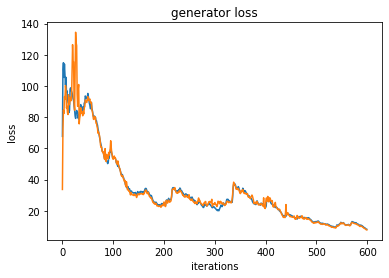

  7%|▋         | 699/10000 [07:44<1:39:33,  1.56it/s]

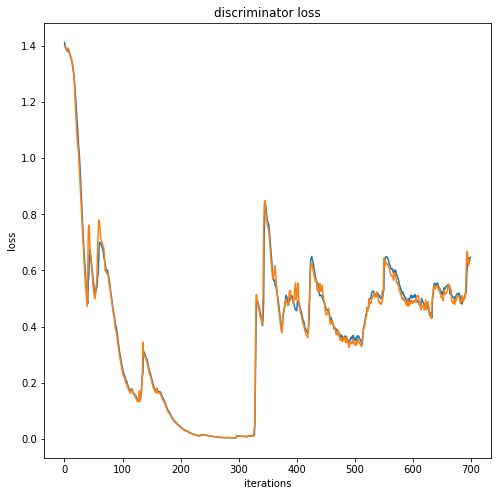

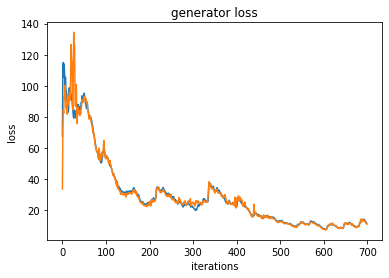

  8%|▊         | 799/10000 [08:49<1:44:18,  1.47it/s]

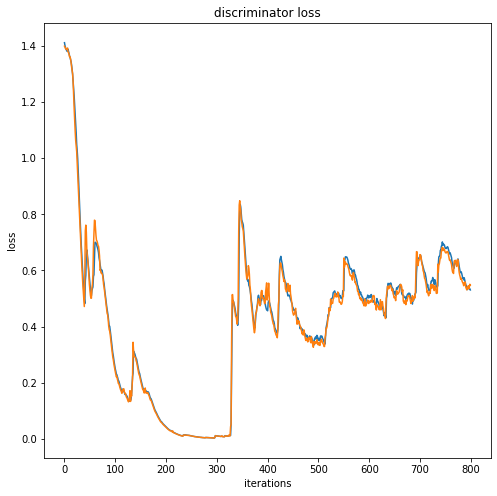

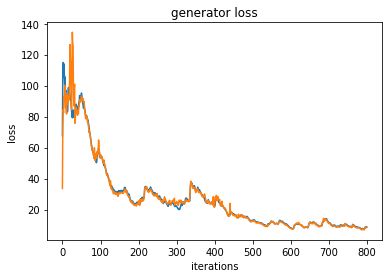

  9%|▉         | 899/10000 [09:54<1:40:36,  1.51it/s]

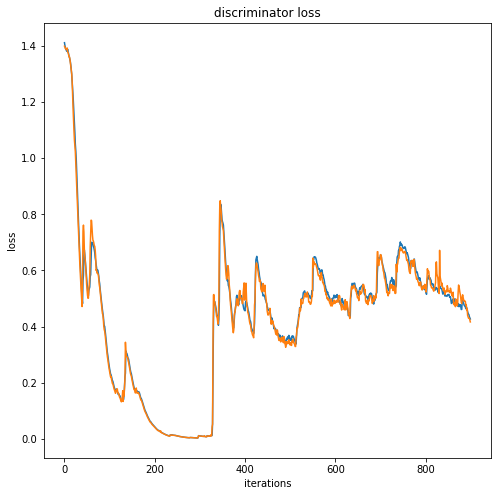

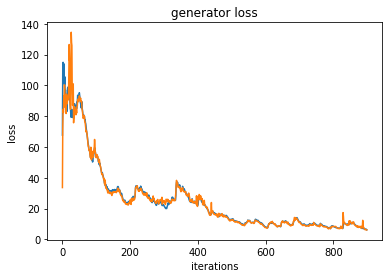

 10%|▉         | 999/10000 [11:00<1:36:22,  1.56it/s]

Iteration 1000/703023: dis loss = 0.4503, gen loss = 7.0362


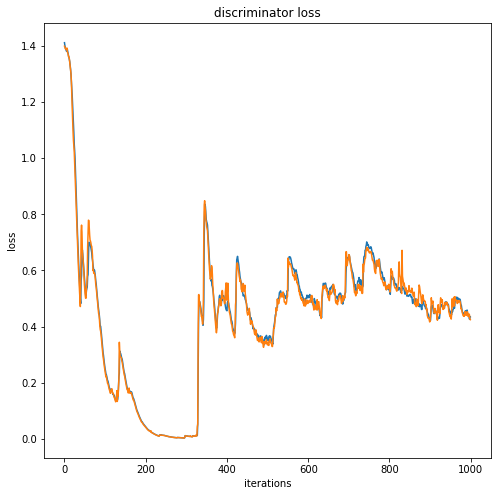

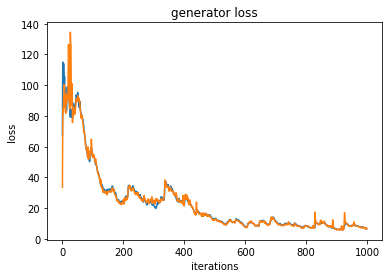

 11%|█         | 1099/10000 [12:04<1:34:00,  1.58it/s]

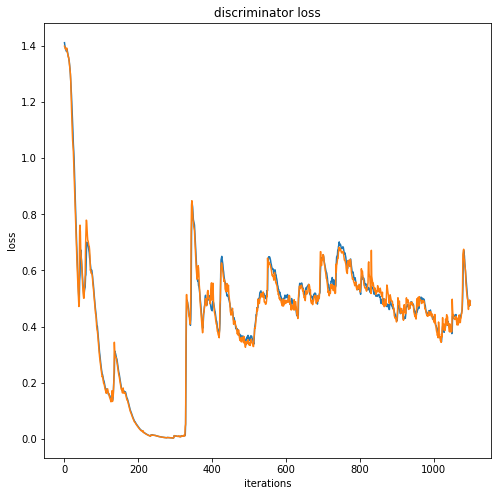

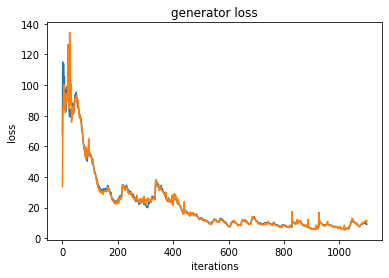

 12%|█▏        | 1199/10000 [13:08<1:32:29,  1.59it/s]

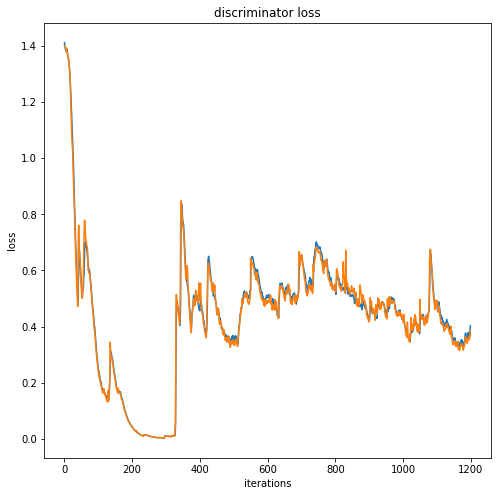

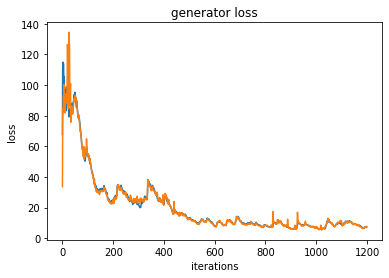

 13%|█▎        | 1299/10000 [14:12<1:33:13,  1.56it/s]

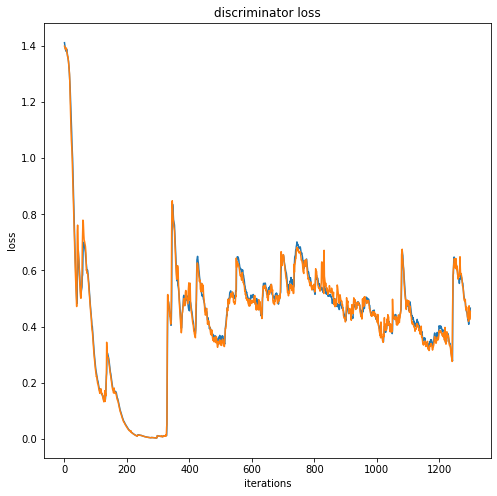

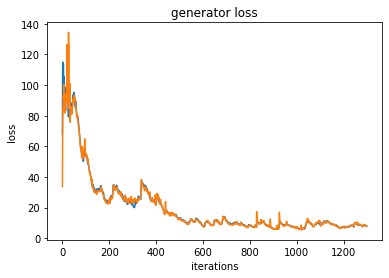

 14%|█▍        | 1399/10000 [15:17<1:32:44,  1.55it/s]

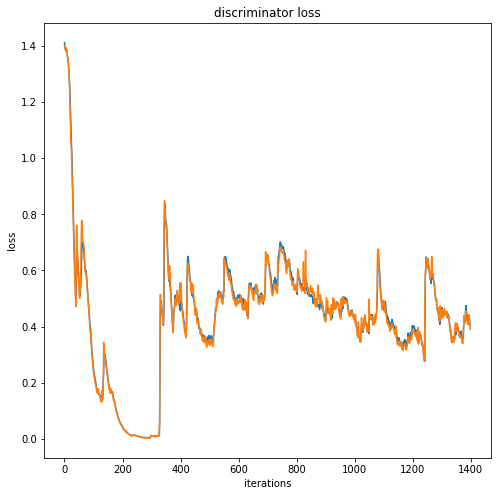

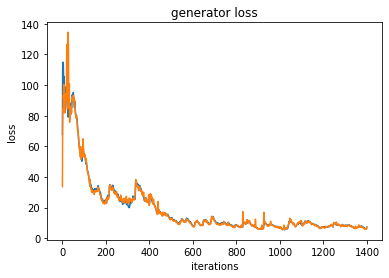

 15%|█▍        | 1499/10000 [16:22<1:33:04,  1.52it/s]

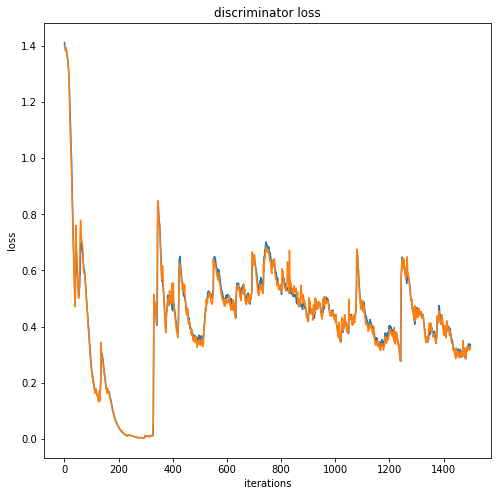

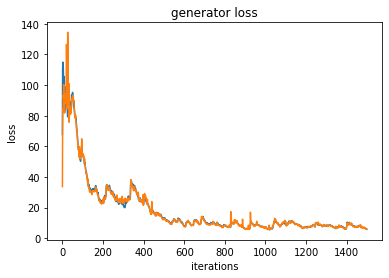

 16%|█▌        | 1599/10000 [17:28<1:30:57,  1.54it/s]

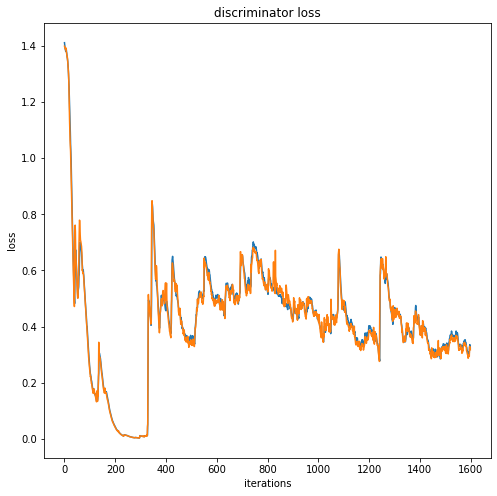

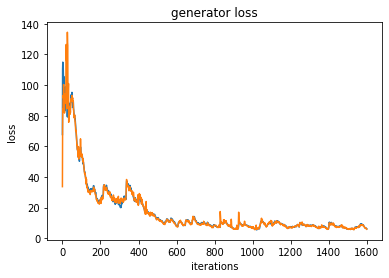

 17%|█▋        | 1699/10000 [18:34<1:31:12,  1.52it/s]

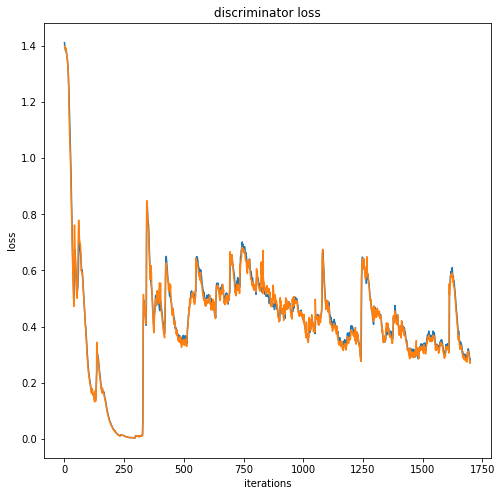

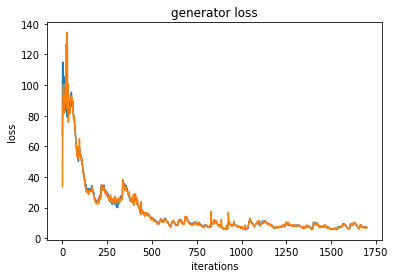

 18%|█▊        | 1799/10000 [19:41<1:27:19,  1.57it/s]

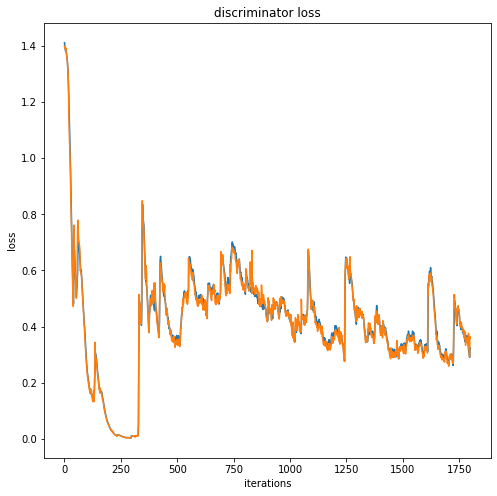

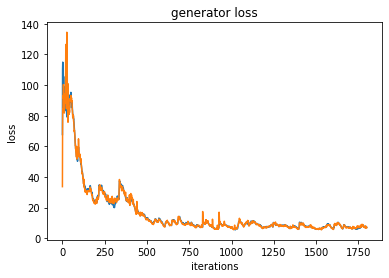

 19%|█▉        | 1899/10000 [20:46<1:27:19,  1.55it/s]

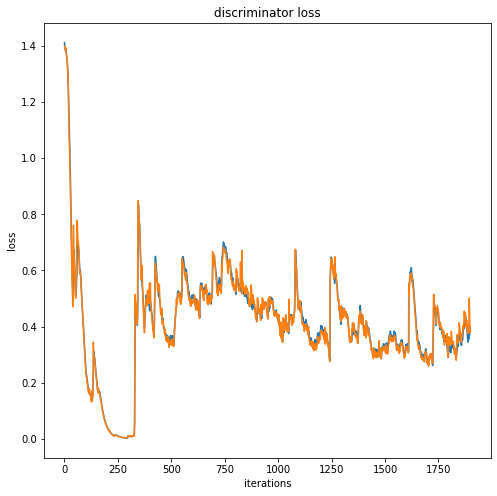

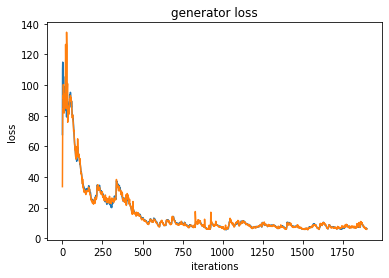

 20%|█▉        | 1999/10000 [21:51<1:25:31,  1.56it/s]

Iteration 2000/703023: dis loss = 0.2700, gen loss = 5.8999


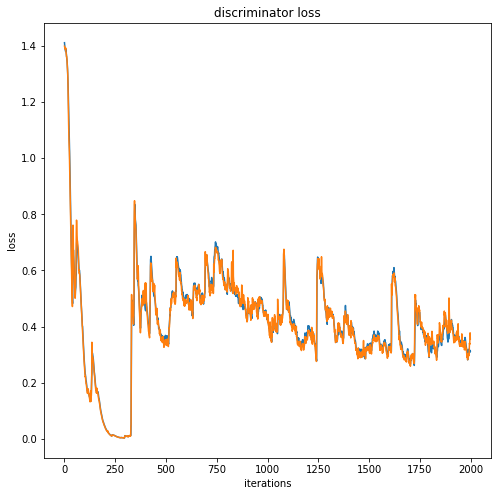

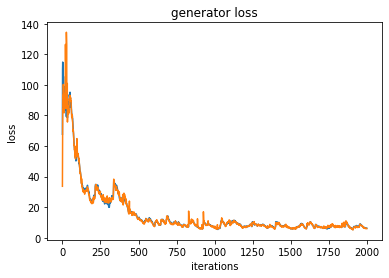

 21%|██        | 2099/10000 [22:57<1:25:40,  1.54it/s]

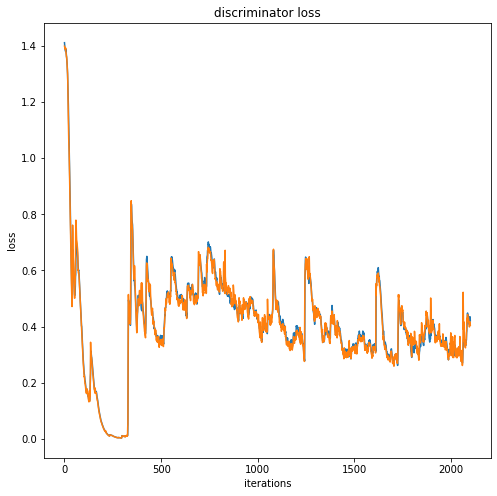

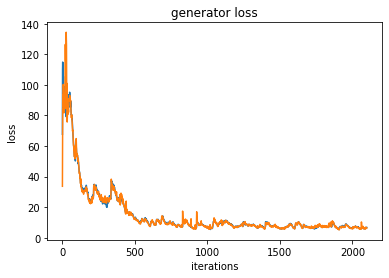

 22%|██▏       | 2199/10000 [24:02<1:24:54,  1.53it/s]

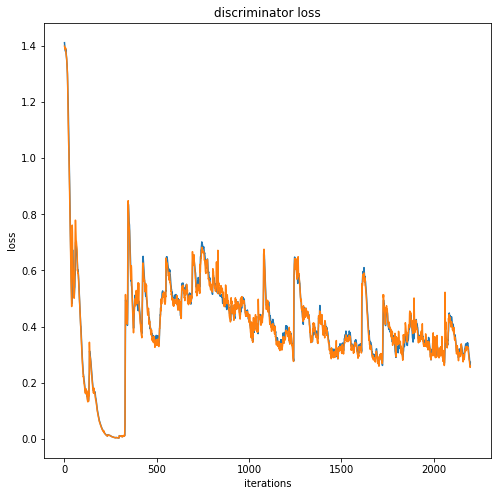

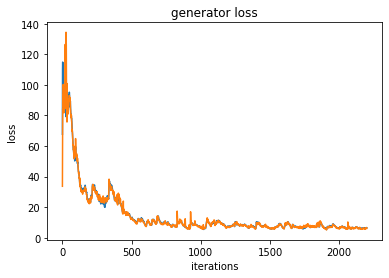

 23%|██▎       | 2299/10000 [25:08<1:22:28,  1.56it/s]

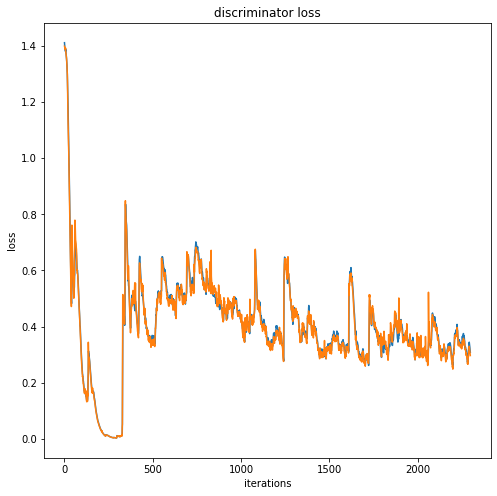

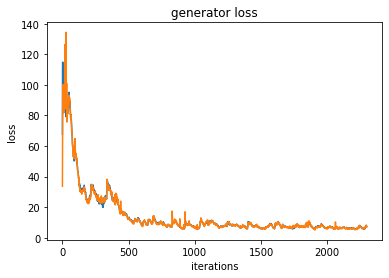

 24%|██▍       | 2399/10000 [26:13<1:23:02,  1.53it/s]

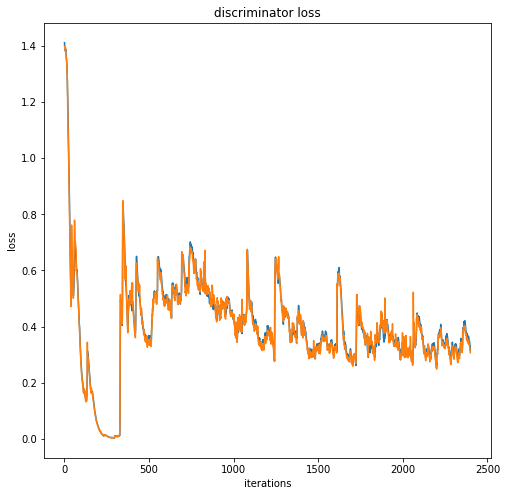

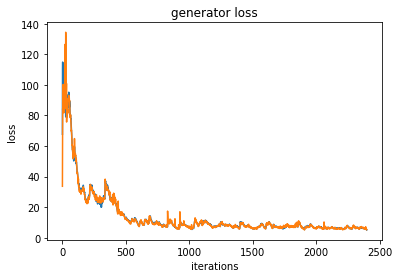

 25%|██▍       | 2499/10000 [27:19<1:22:01,  1.52it/s]

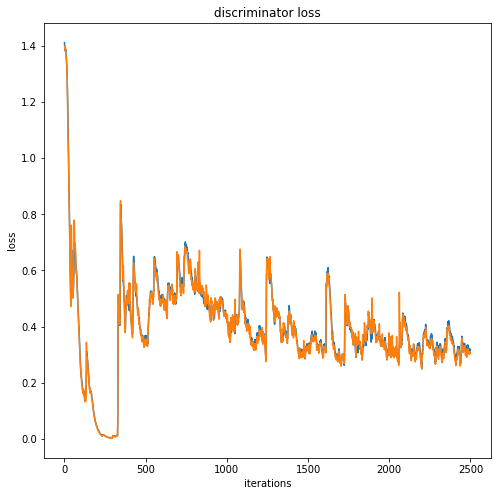

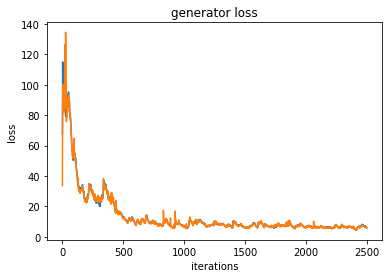

 26%|██▌       | 2599/10000 [28:25<1:19:35,  1.55it/s]

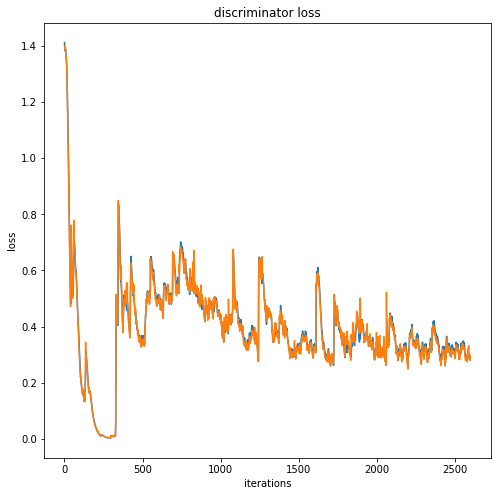

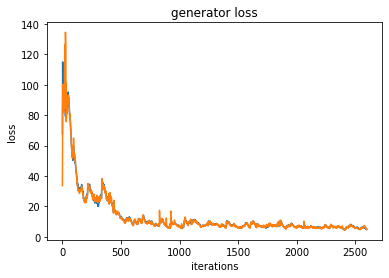

 27%|██▋       | 2699/10000 [29:30<1:20:01,  1.52it/s]

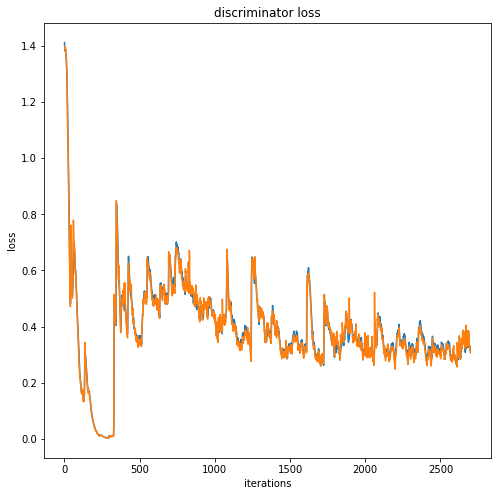

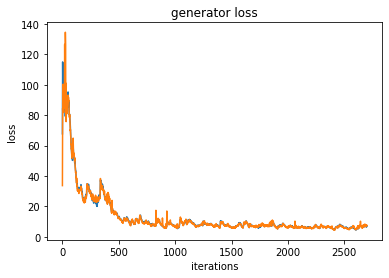

 28%|██▊       | 2799/10000 [30:35<1:17:39,  1.55it/s]

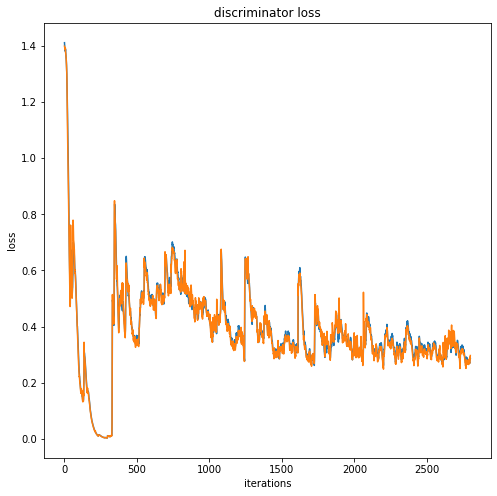

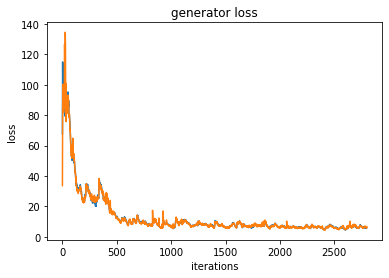

 29%|██▉       | 2899/10000 [31:41<1:17:42,  1.52it/s]

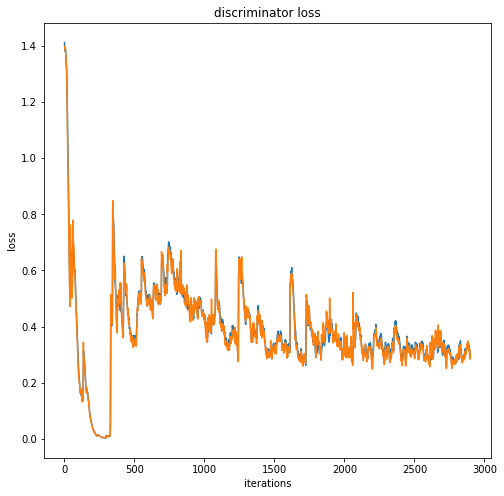

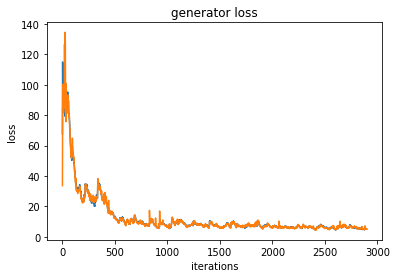

 30%|██▉       | 2999/10000 [32:46<1:15:53,  1.54it/s]

Iteration 3000/703023: dis loss = 0.3849, gen loss = 5.1990


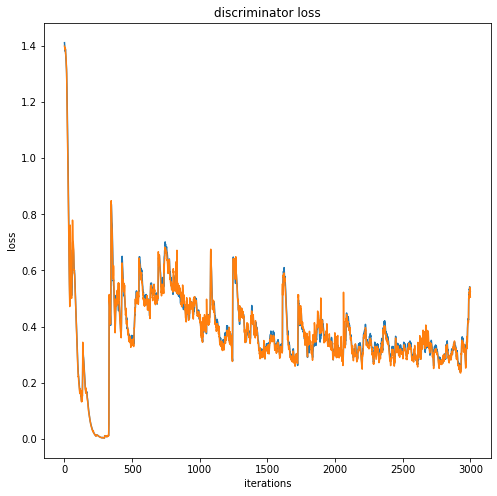

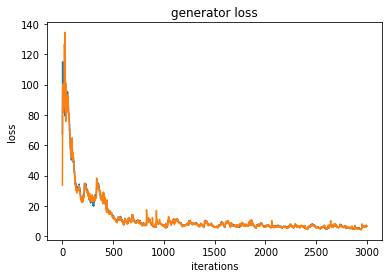

 31%|███       | 3099/10000 [33:52<1:14:26,  1.55it/s]

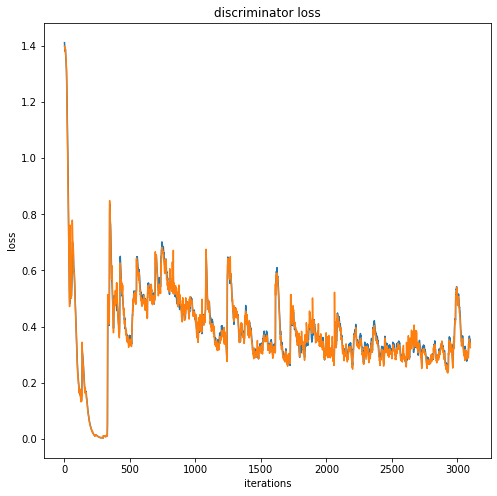

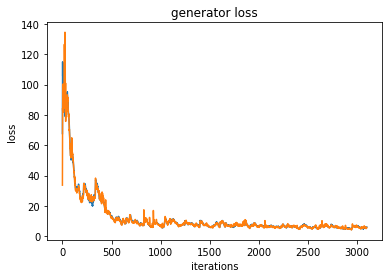

 32%|███▏      | 3199/10000 [34:57<1:12:17,  1.57it/s]

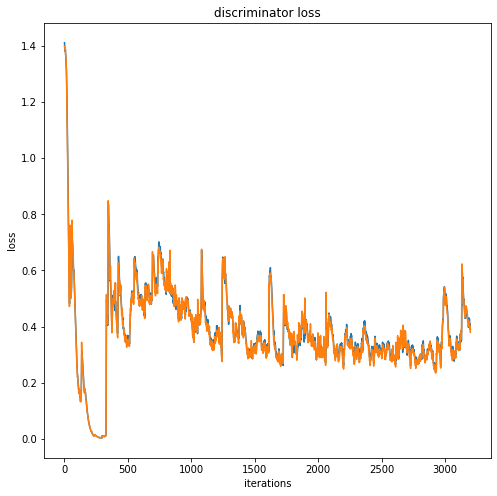

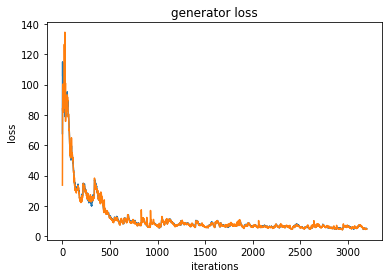

 33%|███▎      | 3299/10000 [36:01<1:10:27,  1.59it/s]

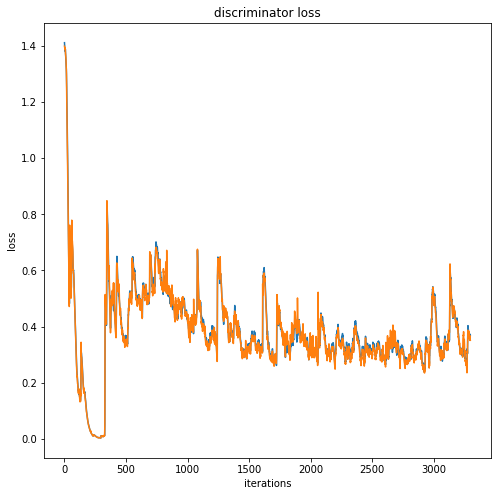

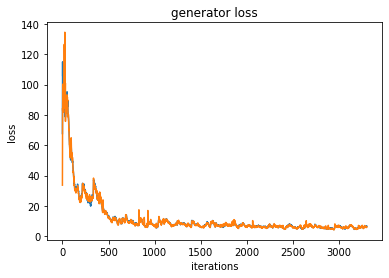

 34%|███▍      | 3399/10000 [37:08<1:11:10,  1.55it/s]

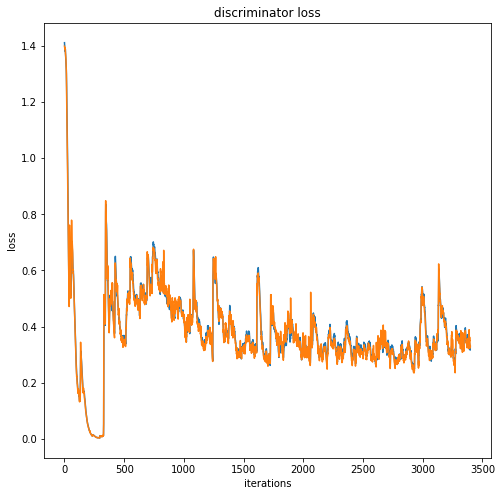

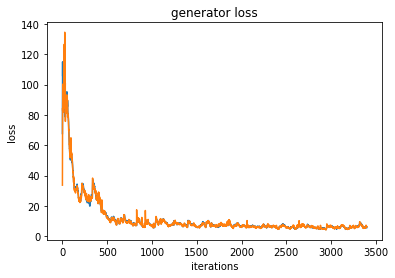

 35%|███▍      | 3499/10000 [38:13<1:09:53,  1.55it/s]

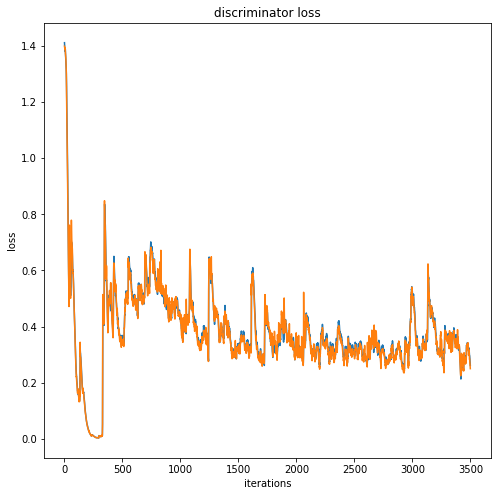

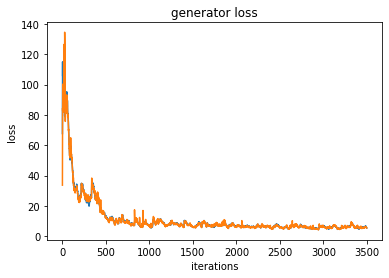

 36%|███▌      | 3599/10000 [39:18<1:08:38,  1.55it/s]

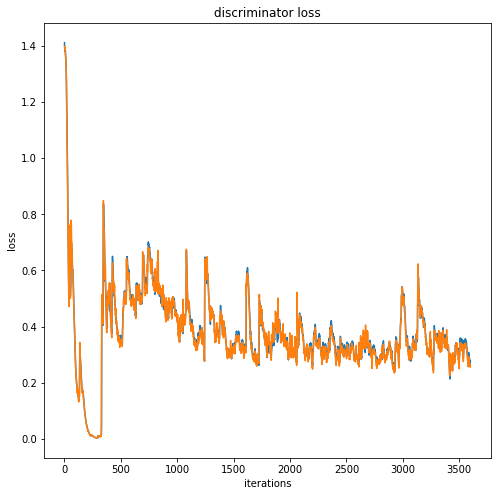

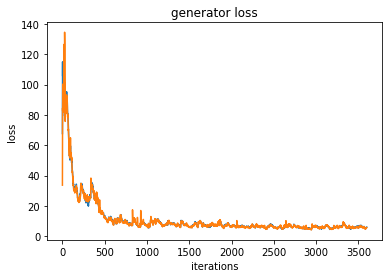

 37%|███▋      | 3699/10000 [40:23<1:08:32,  1.53it/s]

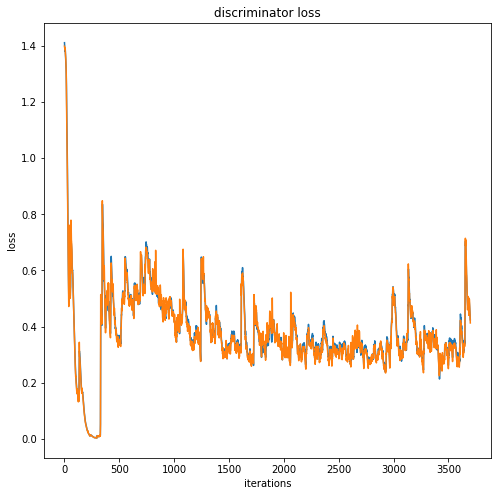

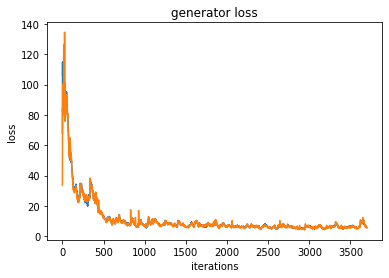

 38%|███▊      | 3799/10000 [41:29<1:06:38,  1.55it/s]

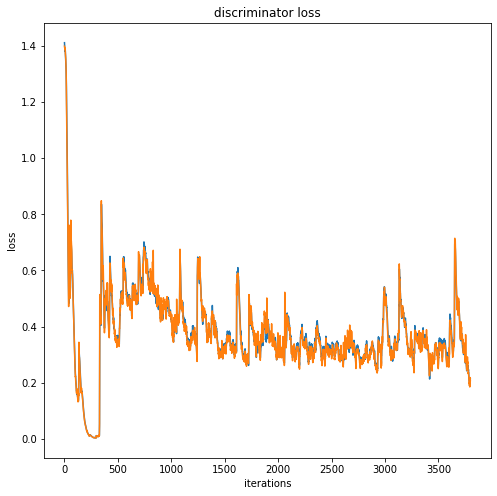

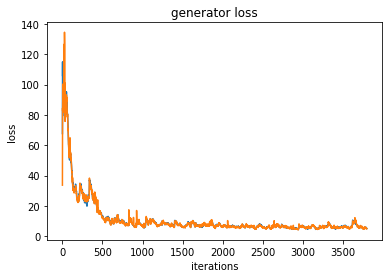

 39%|███▉      | 3899/10000 [42:36<1:06:47,  1.52it/s]

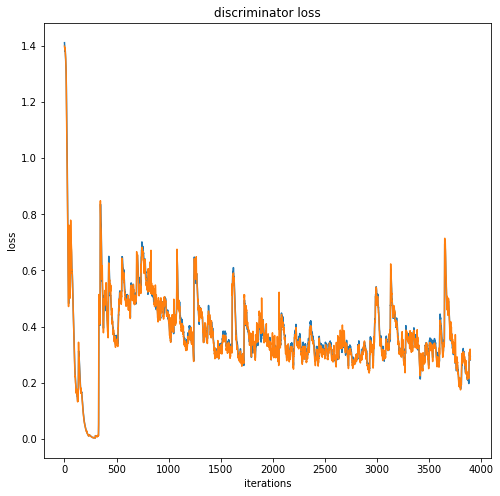

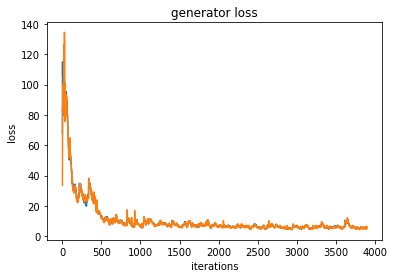

 40%|███▉      | 3999/10000 [43:42<1:04:20,  1.55it/s]

Iteration 4000/703023: dis loss = 0.1773, gen loss = 6.7749


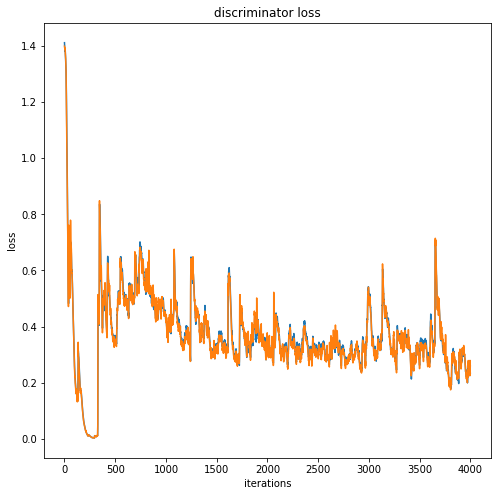

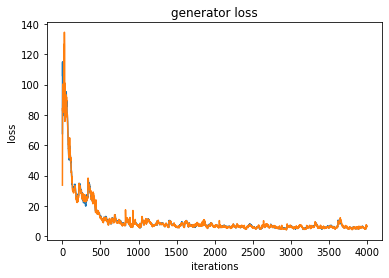

 41%|████      | 4099/10000 [44:48<1:11:52,  1.37it/s]

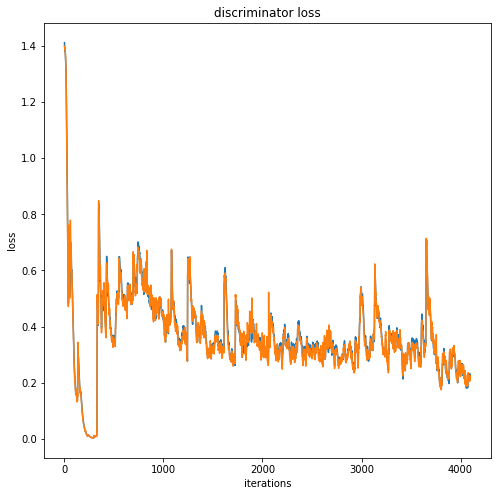

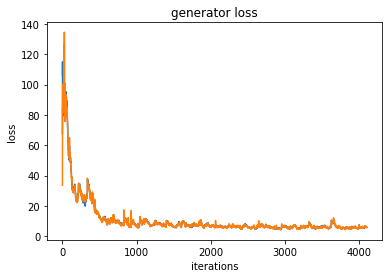

 42%|████▏     | 4199/10000 [45:55<1:02:55,  1.54it/s]

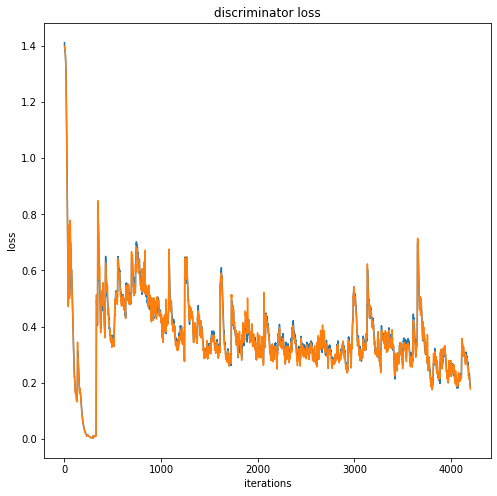

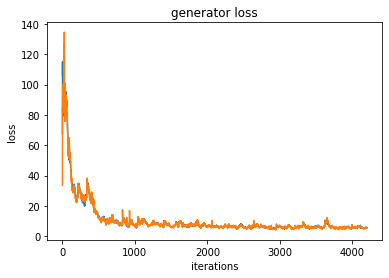

 43%|████▎     | 4299/10000 [47:01<1:02:01,  1.53it/s]

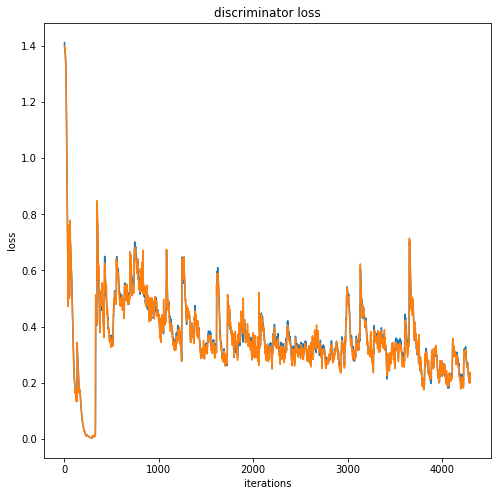

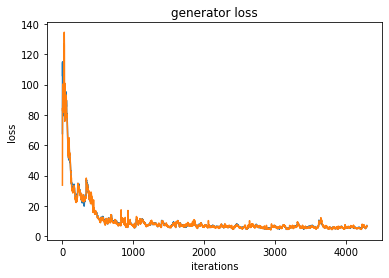

 44%|████▍     | 4399/10000 [48:06<59:46,  1.56it/s]  

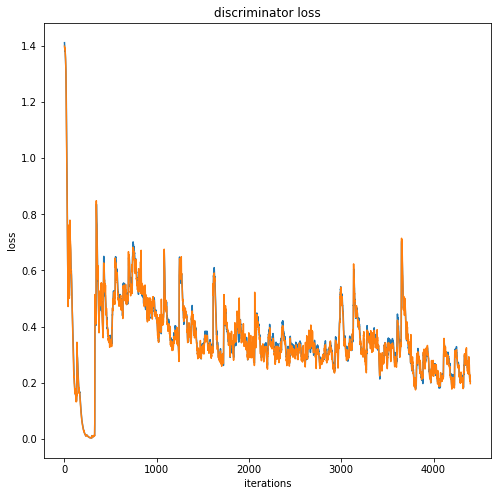

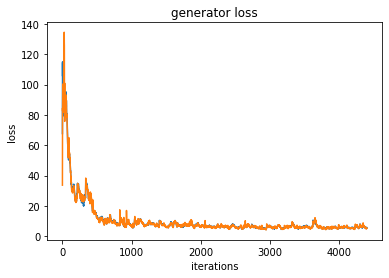

 45%|████▍     | 4499/10000 [49:12<59:49,  1.53it/s]  

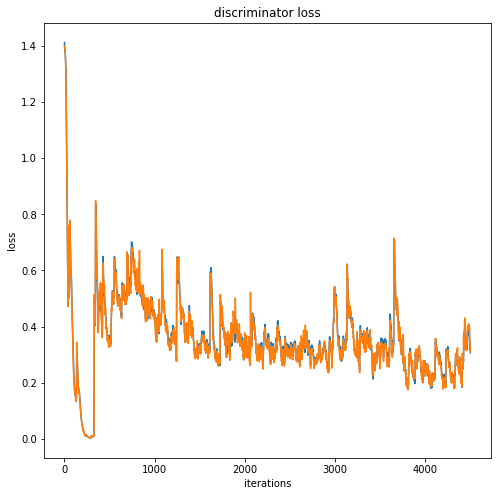

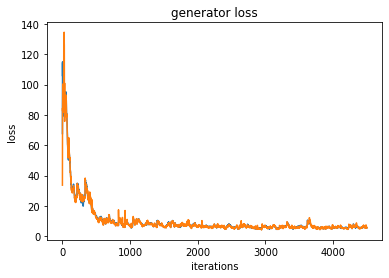

 46%|████▌     | 4599/10000 [50:17<57:58,  1.55it/s]  

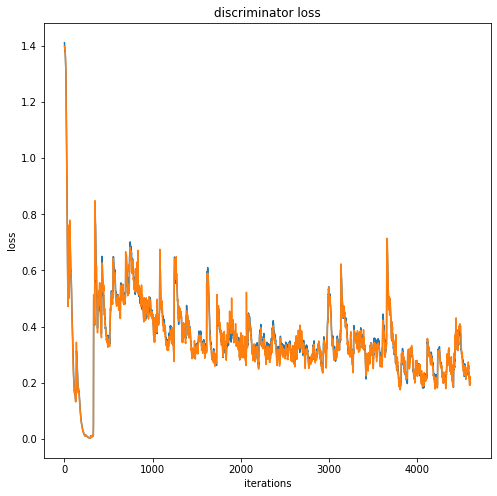

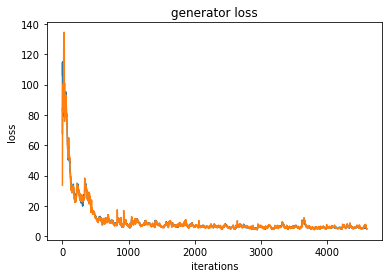

 47%|████▋     | 4699/10000 [51:22<56:57,  1.55it/s]  

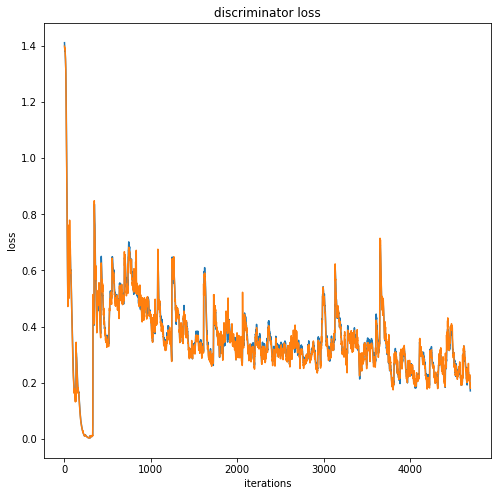

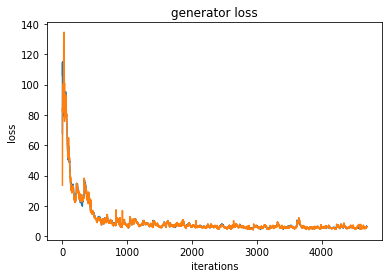

 48%|████▊     | 4799/10000 [52:26<54:46,  1.58it/s]  

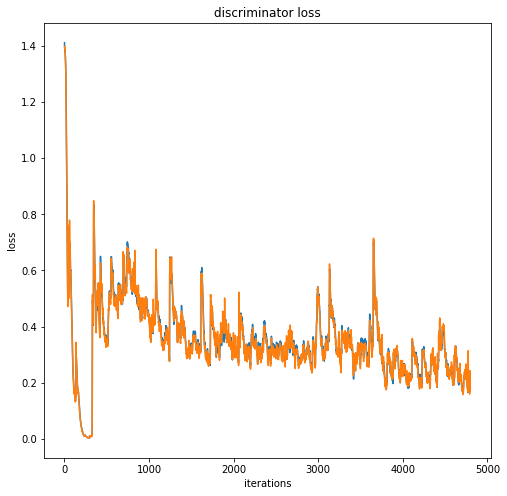

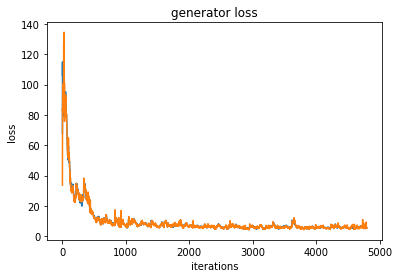

 49%|████▉     | 4899/10000 [53:31<54:39,  1.56it/s]  

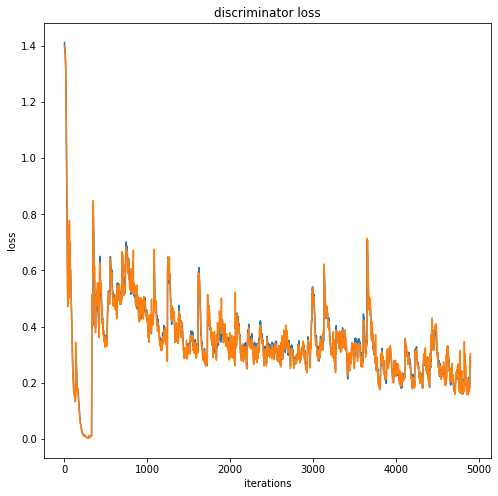

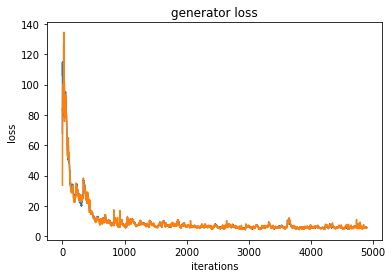

 50%|████▉     | 4999/10000 [54:36<54:26,  1.53it/s]  

Iteration 5000/703023: dis loss = 0.0493, gen loss = 11.9652


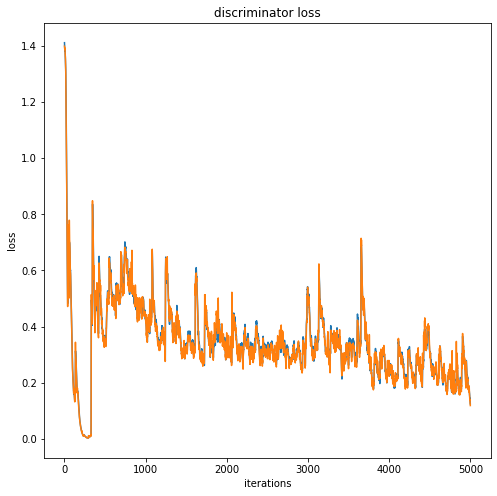

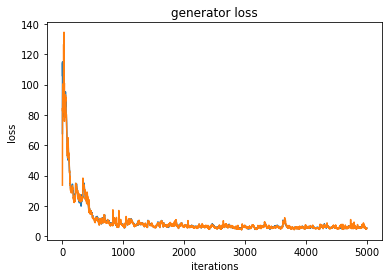

 51%|█████     | 5099/10000 [55:42<52:59,  1.54it/s]  

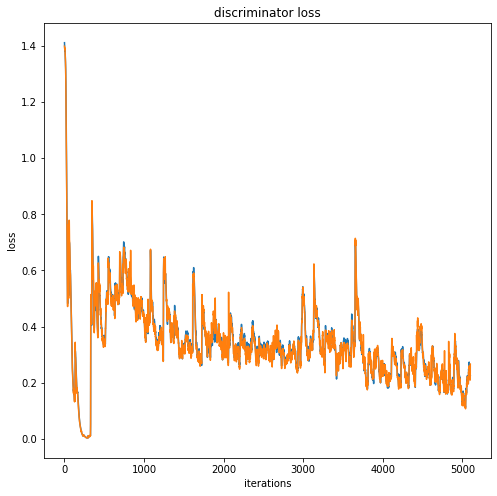

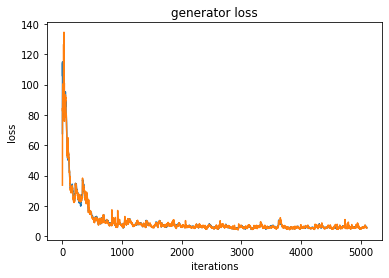

 52%|█████▏    | 5199/10000 [56:47<51:34,  1.55it/s]  

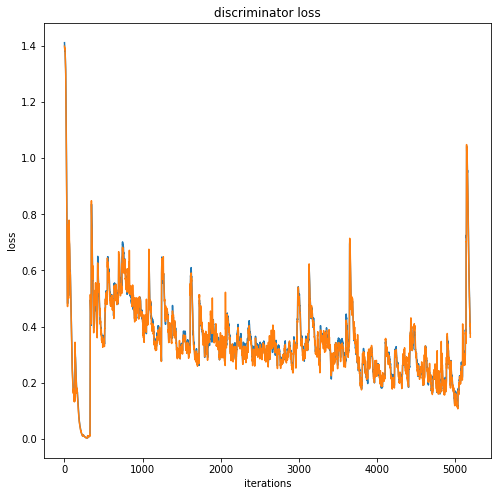

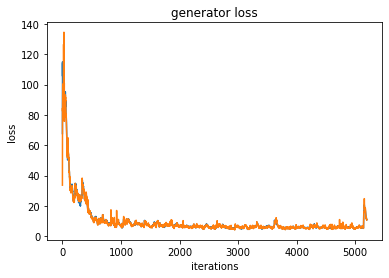

 53%|█████▎    | 5299/10000 [57:52<50:19,  1.56it/s]  

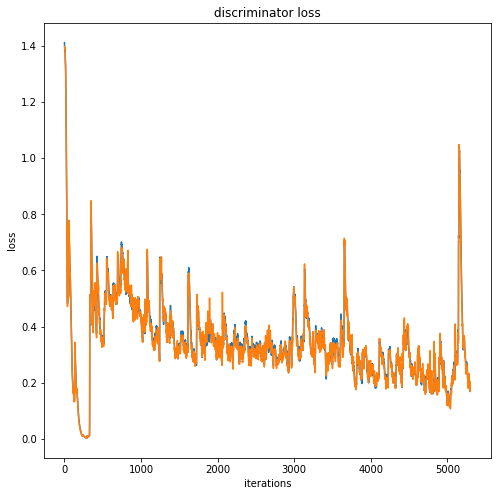

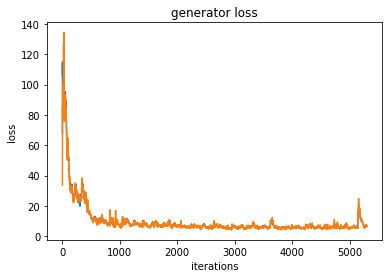

 54%|█████▍    | 5399/10000 [58:58<50:02,  1.53it/s]

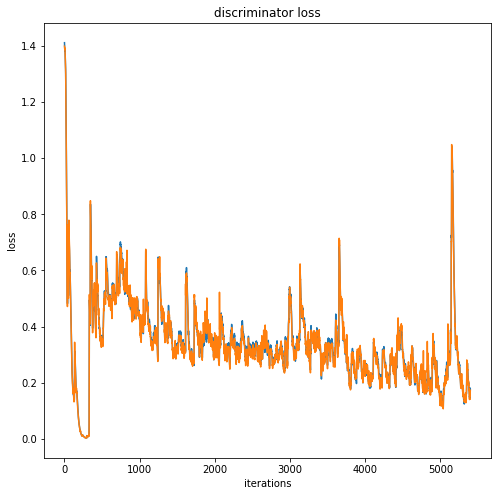

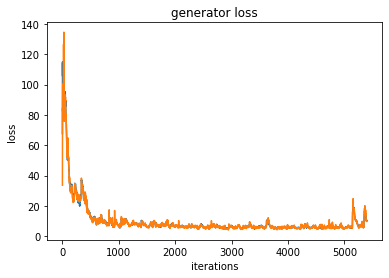

 55%|█████▍    | 5499/10000 [1:00:04<50:17,  1.49it/s]

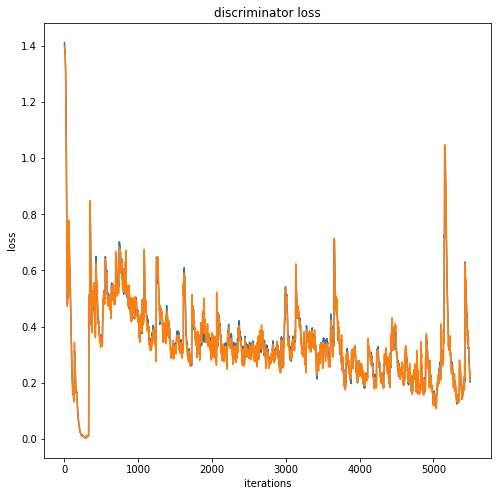

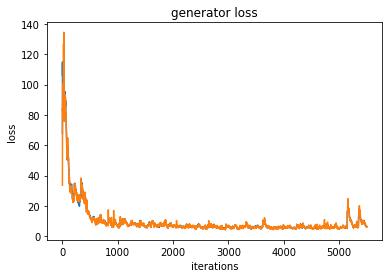

 56%|█████▌    | 5599/10000 [1:01:10<46:14,  1.59it/s]

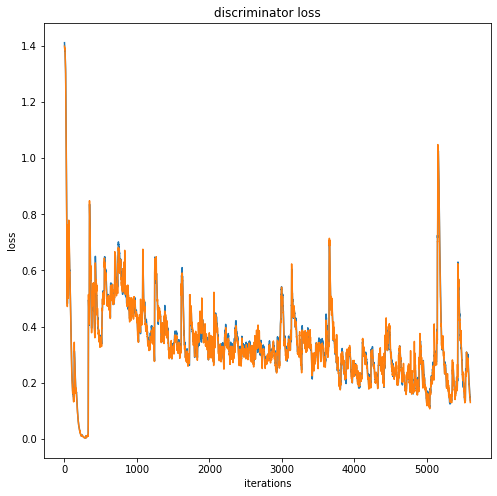

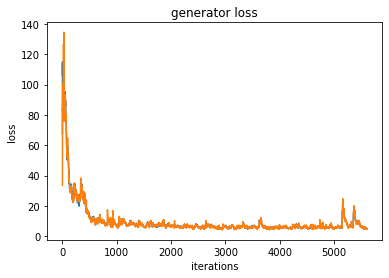

 57%|█████▋    | 5699/10000 [1:02:14<45:47,  1.57it/s]

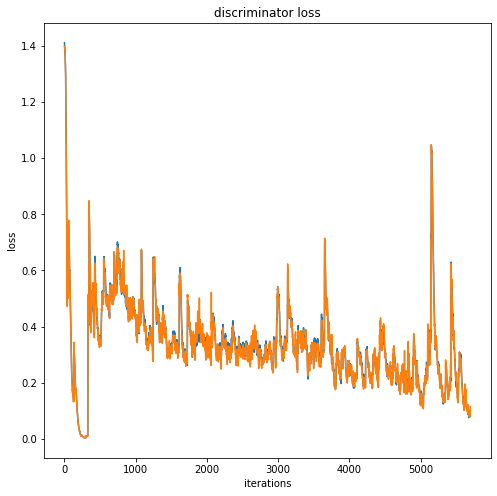

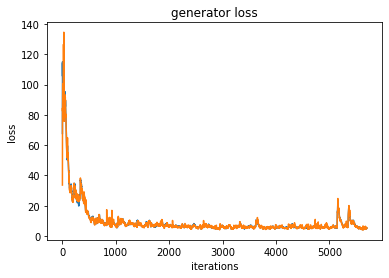

 58%|█████▊    | 5799/10000 [1:03:19<45:23,  1.54it/s]

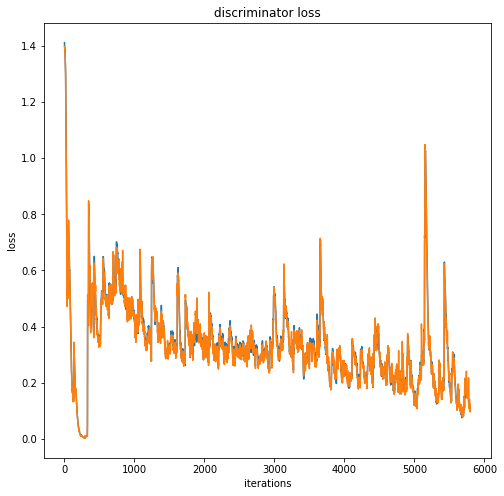

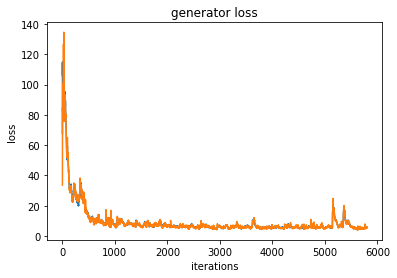

 59%|█████▉    | 5899/10000 [1:04:25<44:55,  1.52it/s]  

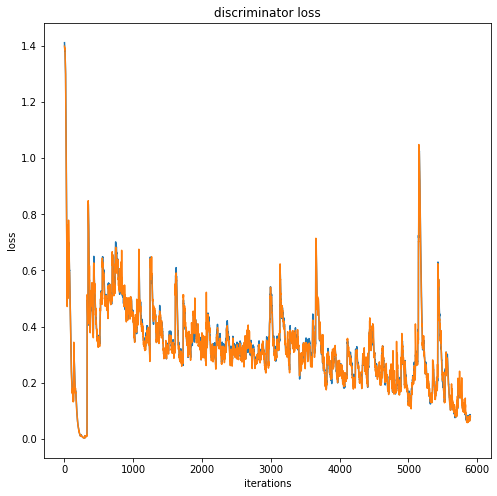

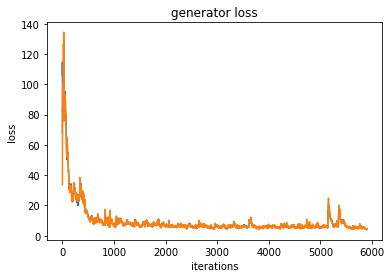

 60%|█████▉    | 5999/10000 [1:05:31<43:24,  1.54it/s]

Iteration 6000/703023: dis loss = 0.1028, gen loss = 3.1698


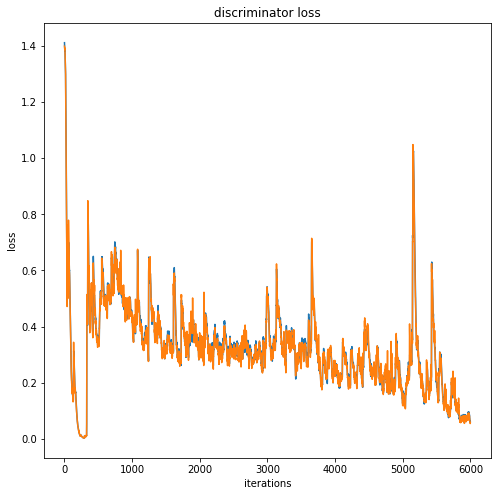

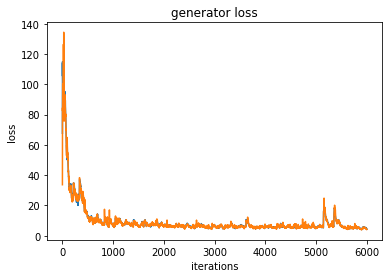

 61%|██████    | 6099/10000 [1:06:36<42:26,  1.53it/s]

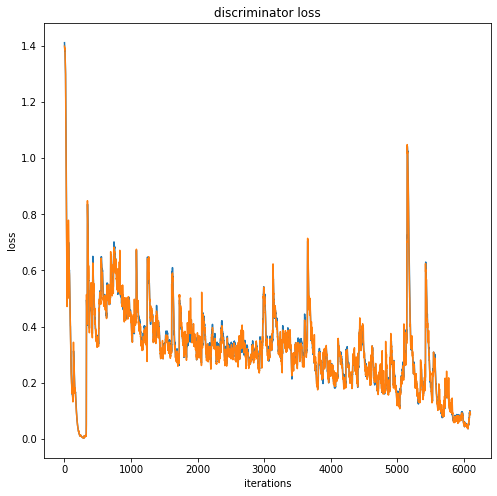

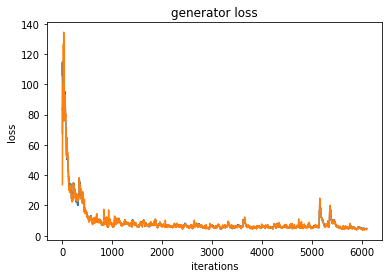

 62%|██████▏   | 6199/10000 [1:07:42<41:44,  1.52it/s]

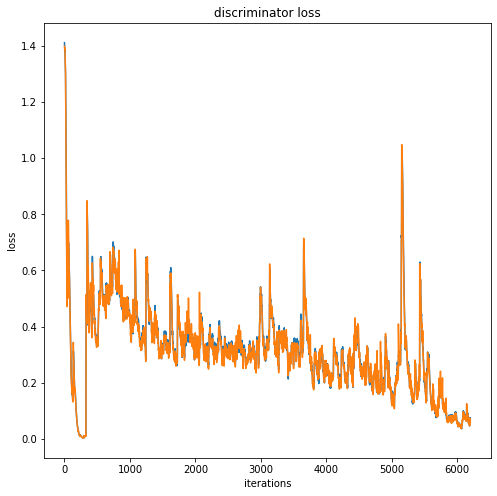

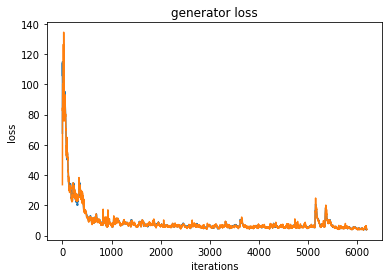

 63%|██████▎   | 6299/10000 [1:08:48<43:48,  1.41it/s]

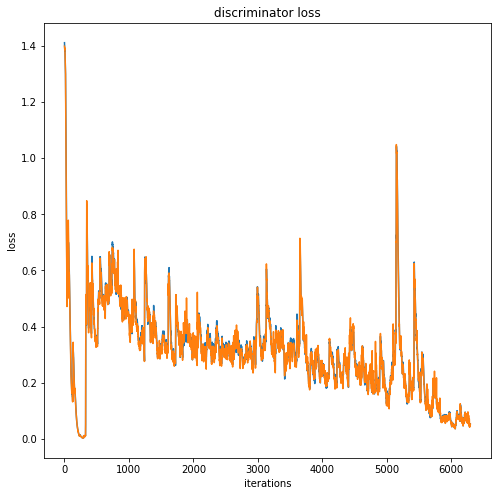

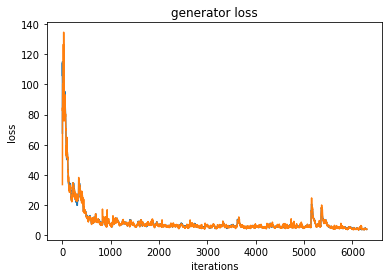

 64%|██████▍   | 6399/10000 [1:09:52<37:53,  1.58it/s]

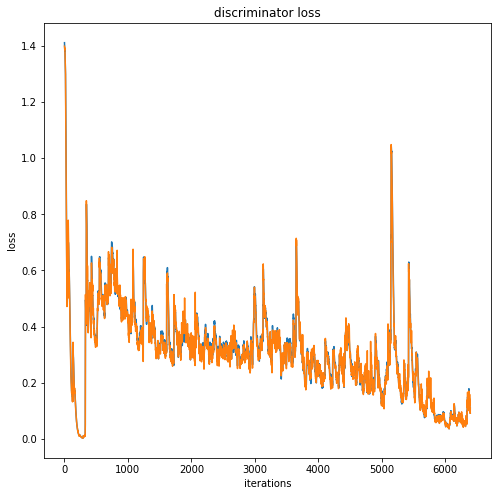

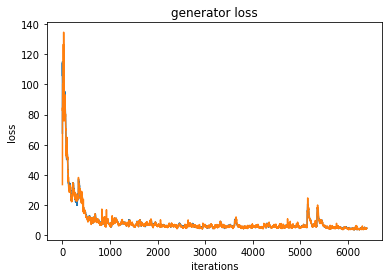

 65%|██████▍   | 6499/10000 [1:10:57<37:09,  1.57it/s]

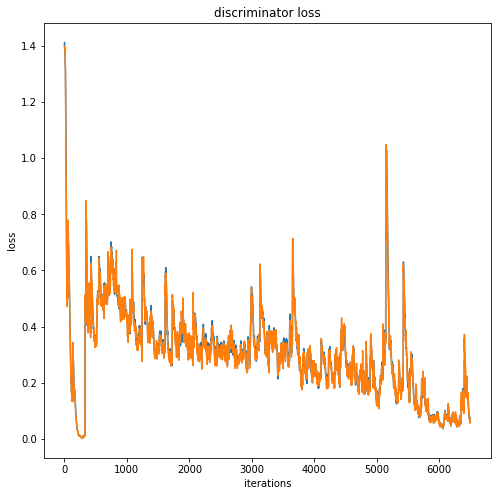

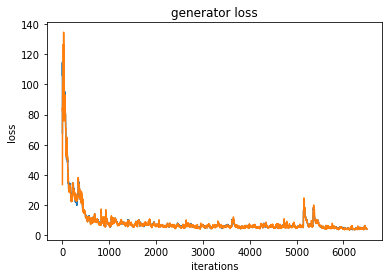

 66%|██████▌   | 6599/10000 [1:12:01<36:17,  1.56it/s]

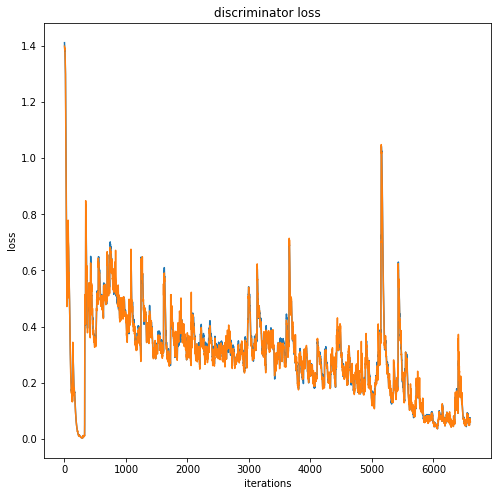

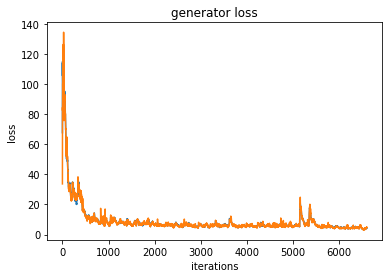

 67%|██████▋   | 6699/10000 [1:13:05<34:53,  1.58it/s]

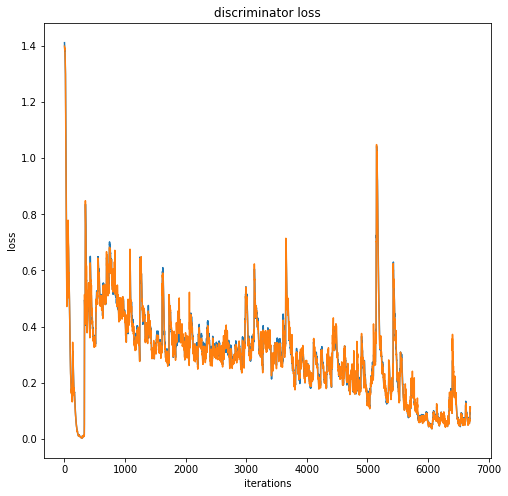

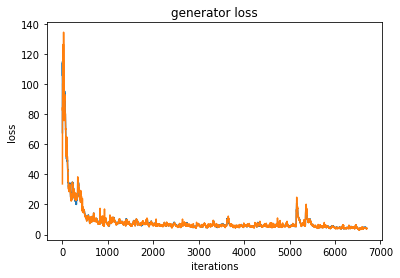

 68%|██████▊   | 6799/10000 [1:14:10<33:46,  1.58it/s]

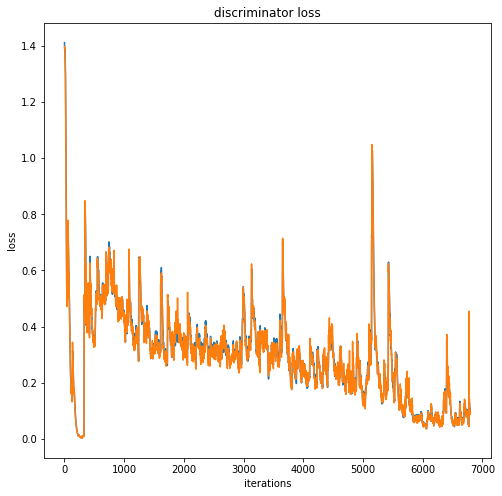

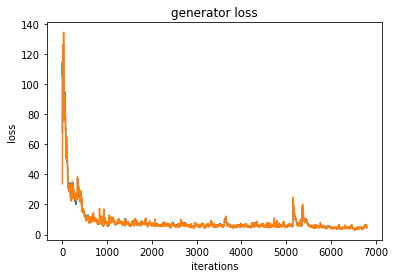

 69%|██████▉   | 6899/10000 [1:15:14<33:07,  1.56it/s]

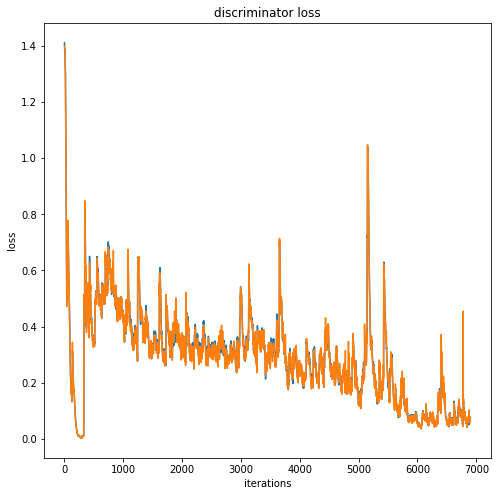

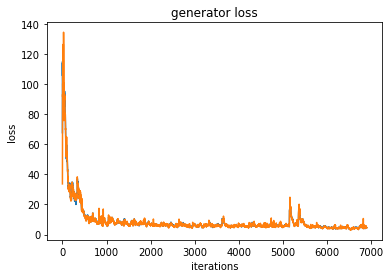

 70%|██████▉   | 6999/10000 [1:16:18<32:02,  1.56it/s]

Iteration 7000/703023: dis loss = 0.0171, gen loss = 5.9117


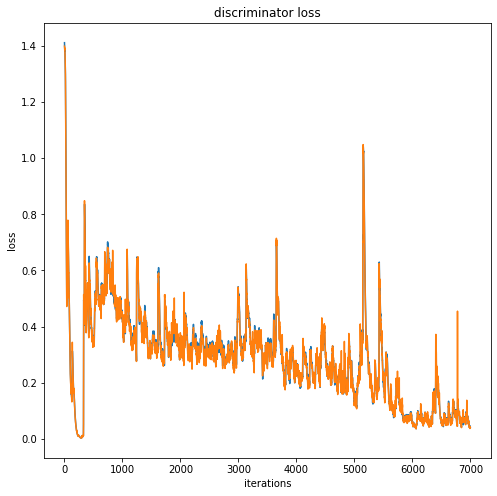

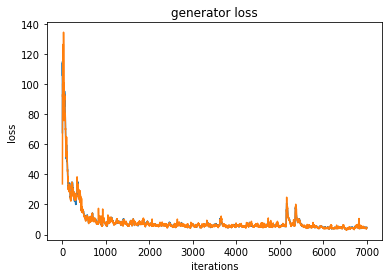

 71%|███████   | 7099/10000 [1:17:23<31:15,  1.55it/s]

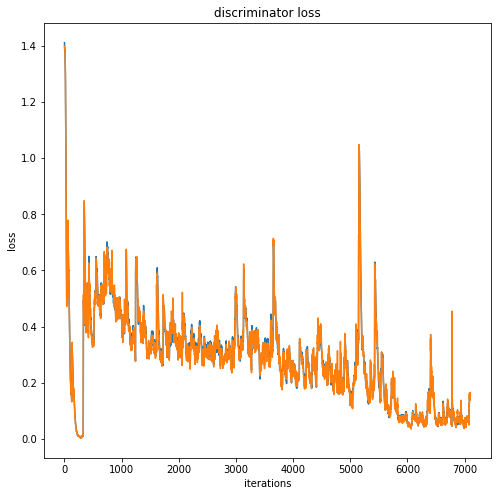

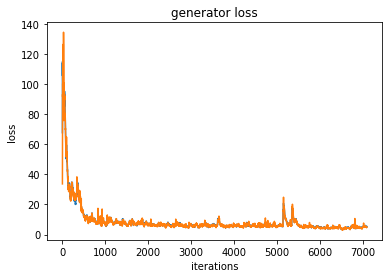

 72%|███████▏  | 7199/10000 [1:18:29<30:18,  1.54it/s]

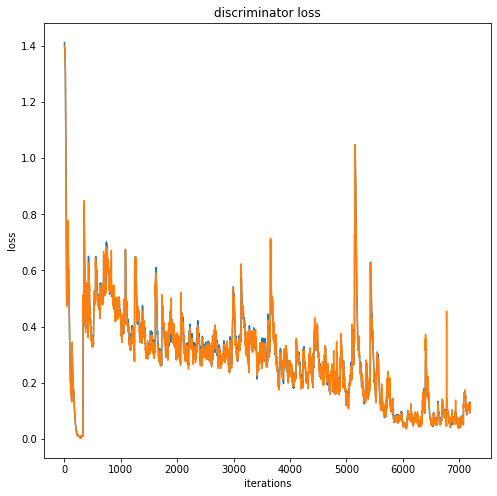

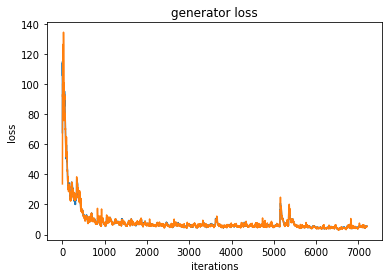

 73%|███████▎  | 7299/10000 [1:19:35<29:39,  1.52it/s]

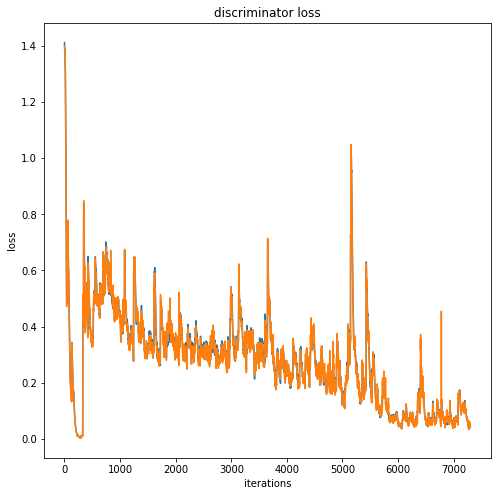

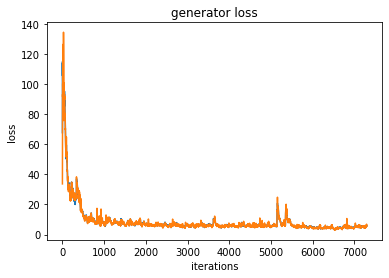

 74%|███████▍  | 7399/10000 [1:20:40<27:56,  1.55it/s]

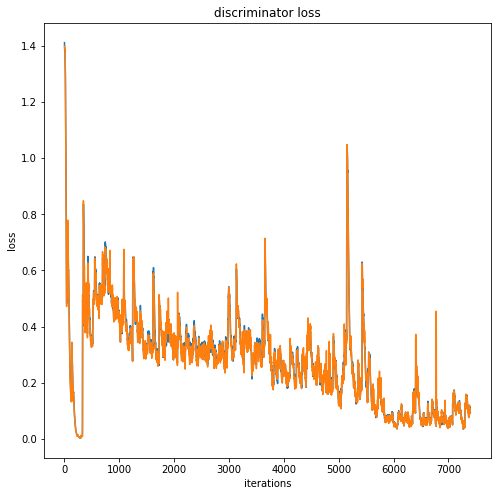

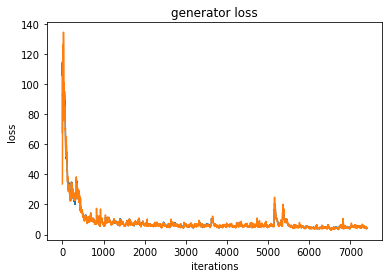

 75%|███████▍  | 7499/10000 [1:21:45<27:39,  1.51it/s]

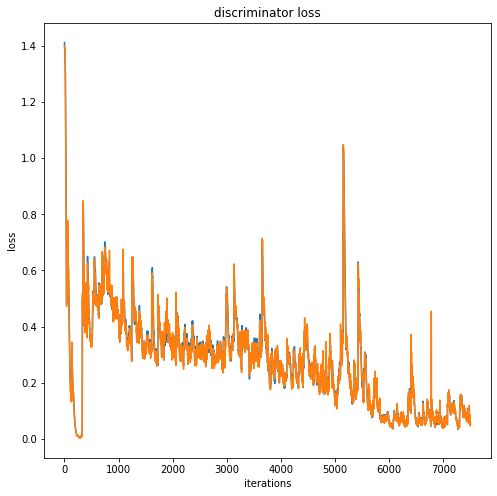

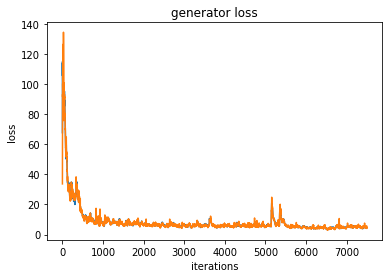

 76%|███████▌  | 7599/10000 [1:22:52<27:50,  1.44it/s]

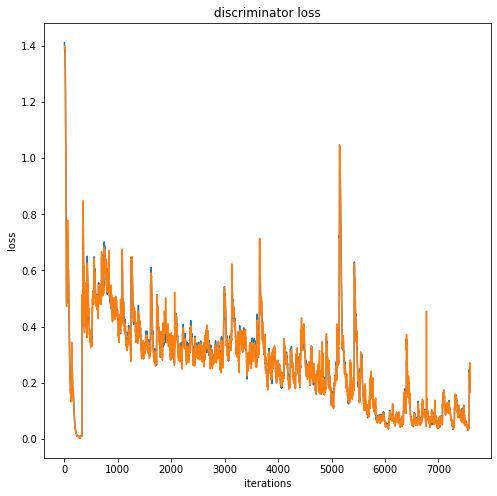

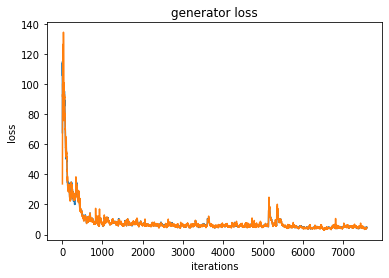

 77%|███████▋  | 7699/10000 [1:23:58<24:50,  1.54it/s]

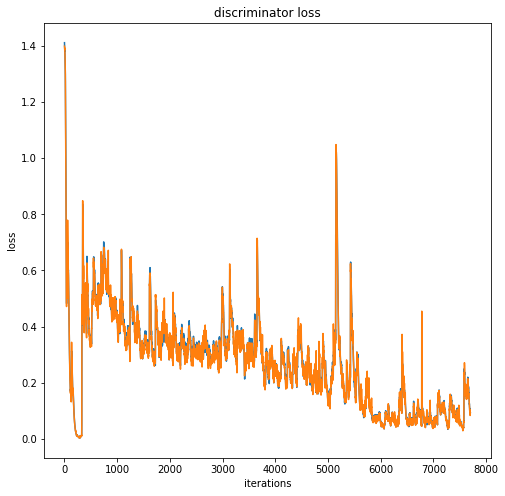

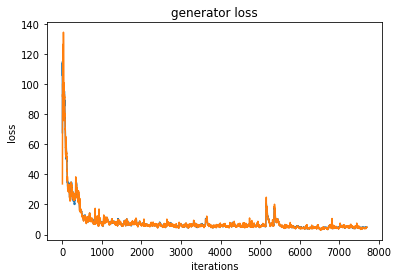

 78%|███████▊  | 7799/10000 [1:25:05<24:15,  1.51it/s]

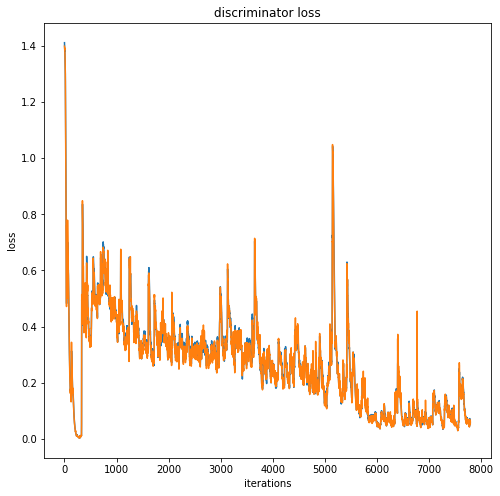

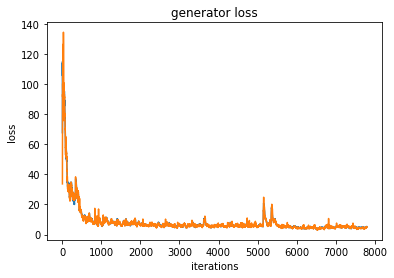

 79%|███████▉  | 7899/10000 [1:26:11<23:05,  1.52it/s]

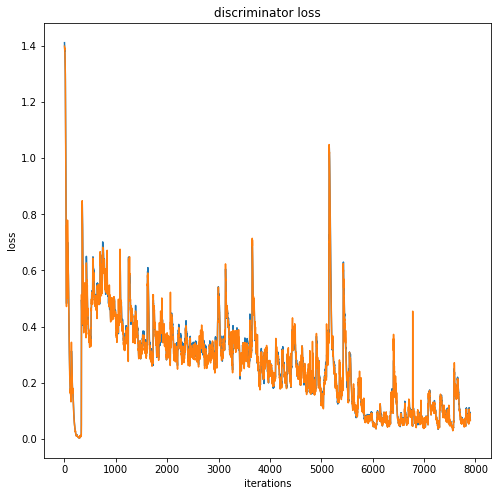

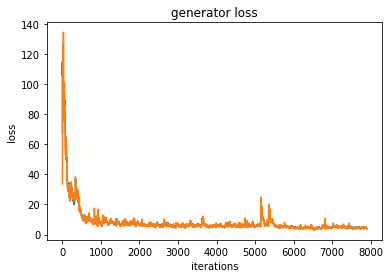

 80%|███████▉  | 7999/10000 [1:27:18<21:55,  1.52it/s]

Iteration 8000/703023: dis loss = 0.0330, gen loss = 1.8540


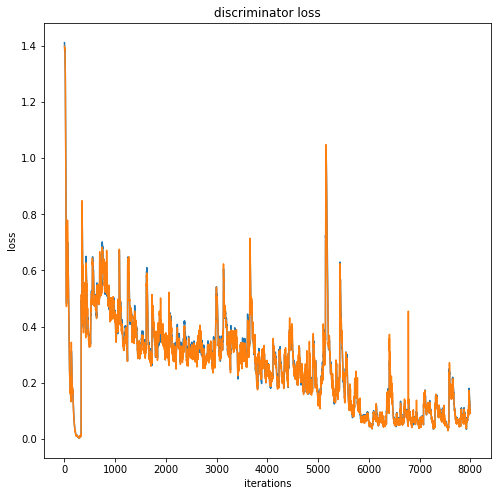

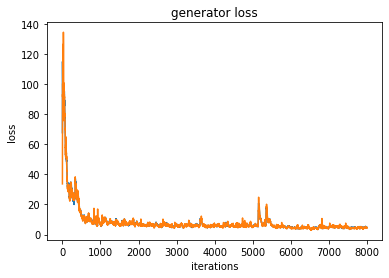

 81%|████████  | 8099/10000 [1:28:24<20:51,  1.52it/s]

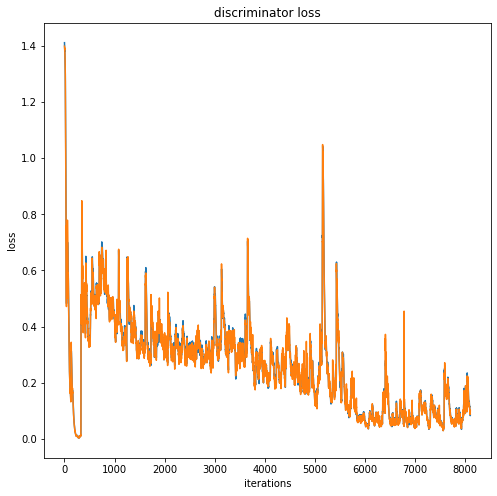

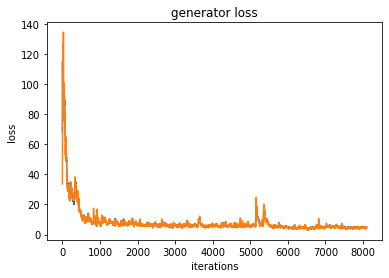

 82%|████████▏ | 8199/10000 [1:29:30<20:15,  1.48it/s]

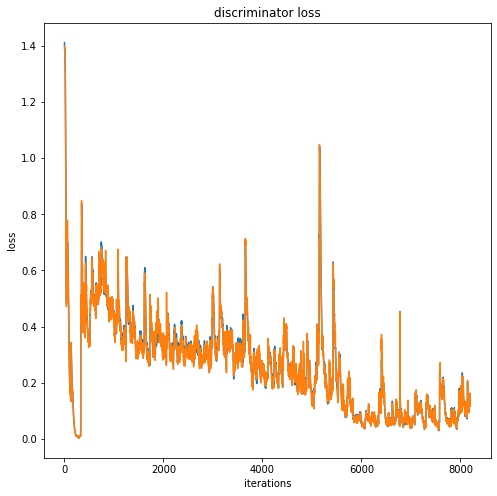

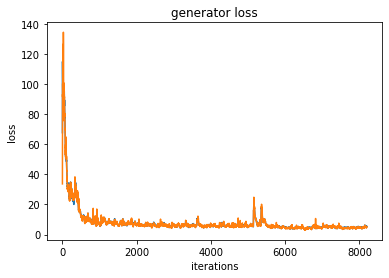

 83%|████████▎ | 8299/10000 [1:30:37<18:54,  1.50it/s]

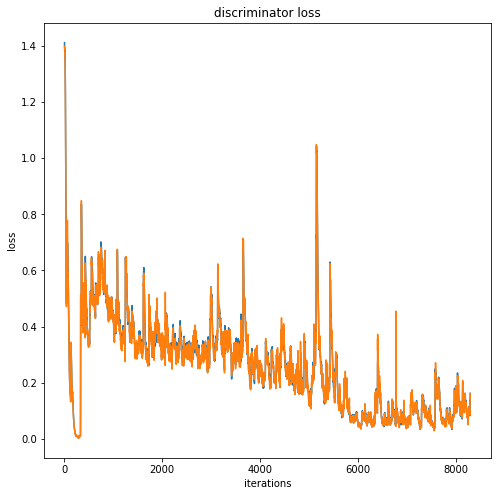

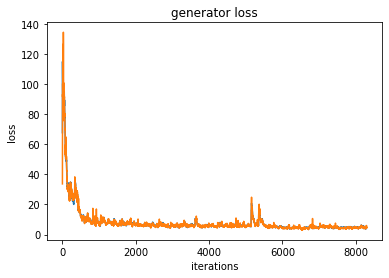

 84%|████████▍ | 8399/10000 [1:31:43<17:10,  1.55it/s]

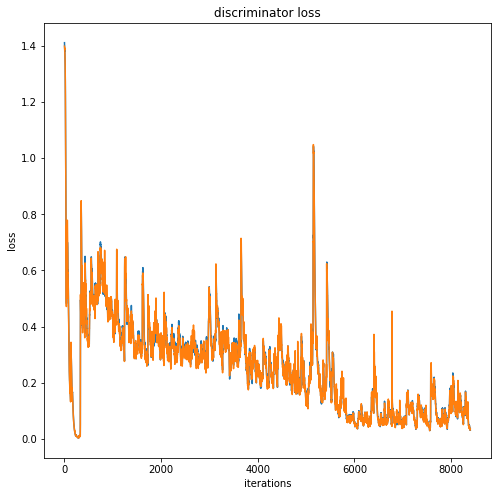

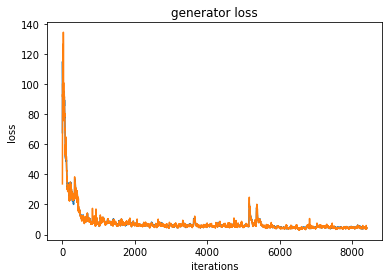

 85%|████████▍ | 8499/10000 [1:32:48<18:19,  1.36it/s]

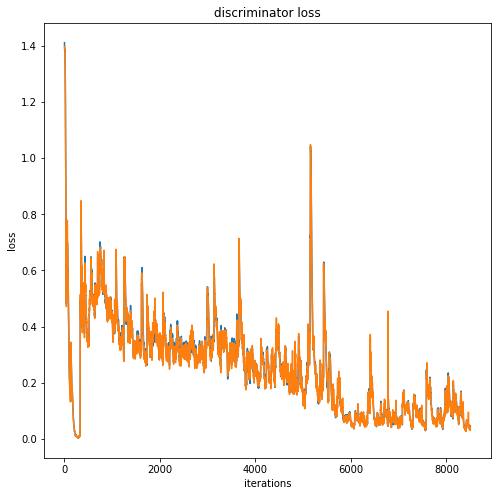

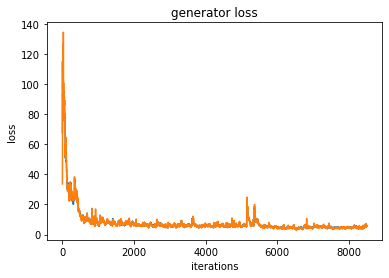

 86%|████████▌ | 8599/10000 [1:33:52<14:51,  1.57it/s]

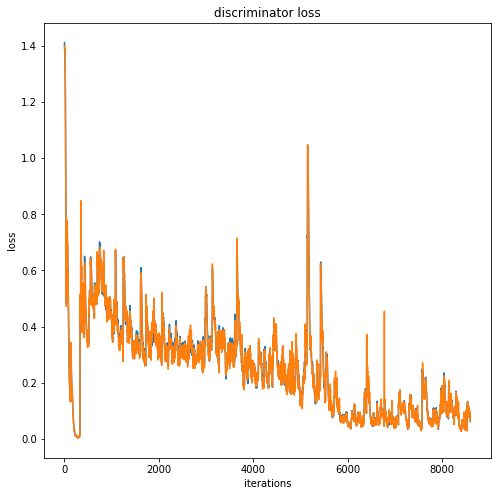

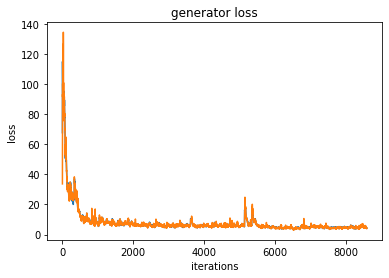

 87%|████████▋ | 8699/10000 [1:34:57<14:02,  1.54it/s]

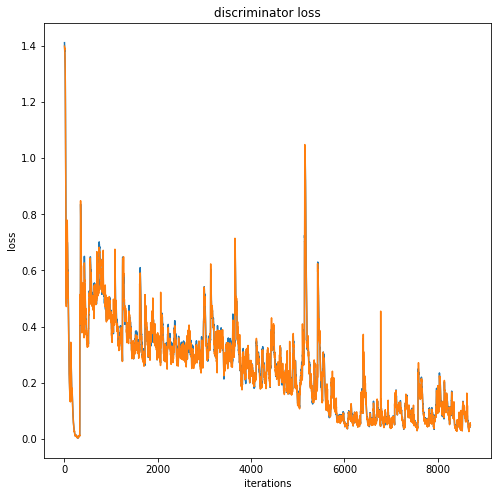

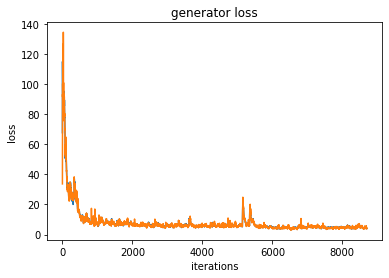

 88%|████████▊ | 8799/10000 [1:36:03<13:11,  1.52it/s]

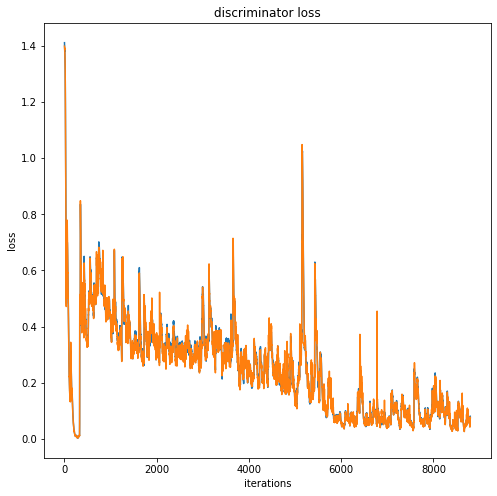

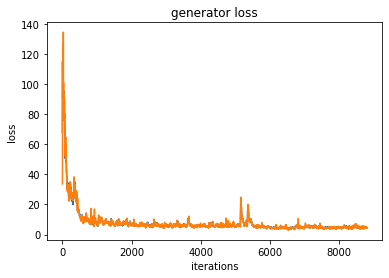

 89%|████████▉ | 8899/10000 [1:37:09<11:56,  1.54it/s]

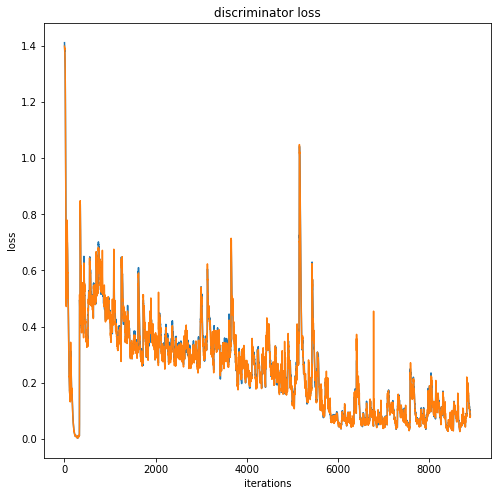

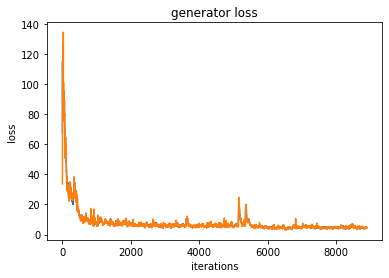

 90%|████████▉ | 8999/10000 [1:38:15<10:59,  1.52it/s]

Iteration 9000/703023: dis loss = 0.0962, gen loss = 5.2580


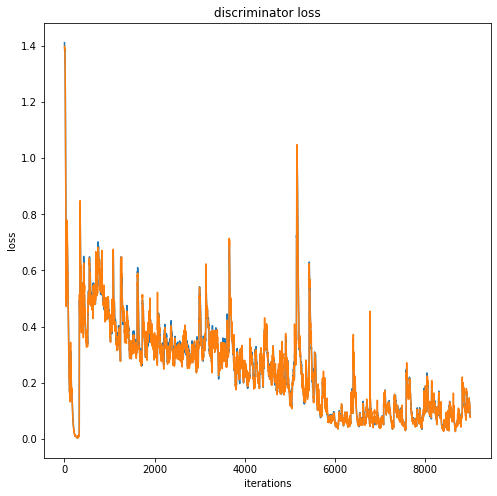

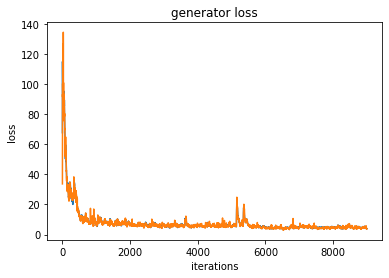

 91%|█████████ | 9099/10000 [1:39:21<09:54,  1.52it/s]

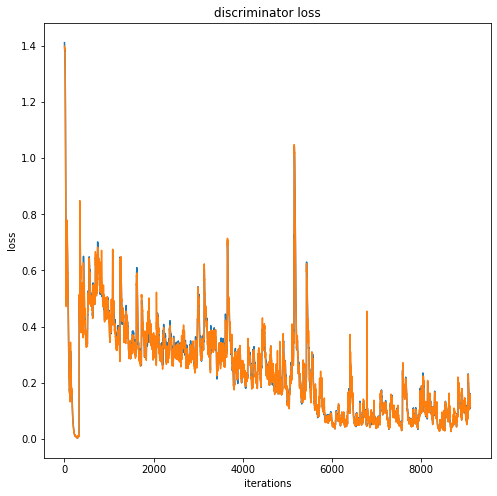

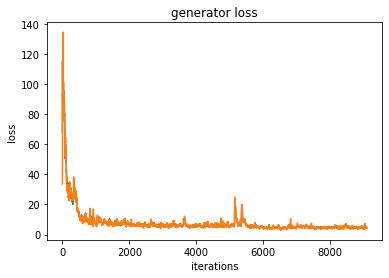

 92%|█████████▏| 9199/10000 [1:40:26<08:36,  1.55it/s]

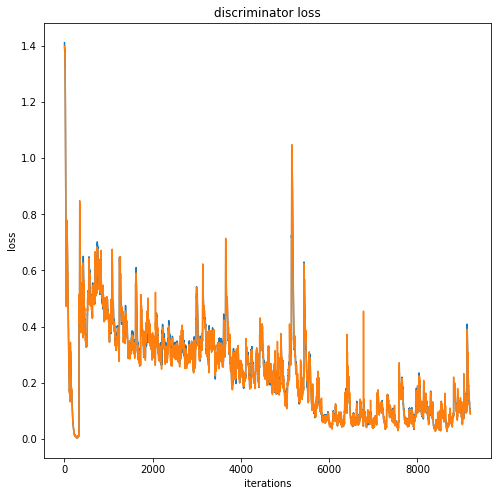

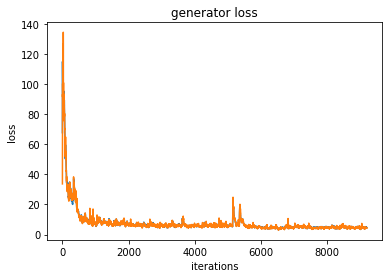

 93%|█████████▎| 9299/10000 [1:41:30<07:26,  1.57it/s]

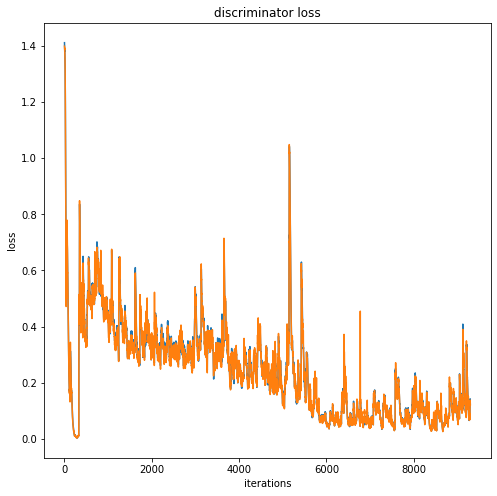

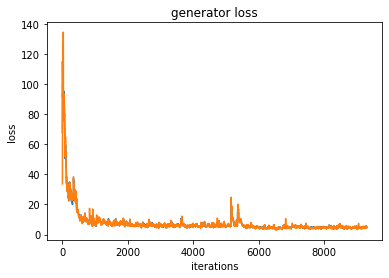

 94%|█████████▍| 9399/10000 [1:42:34<06:23,  1.57it/s]

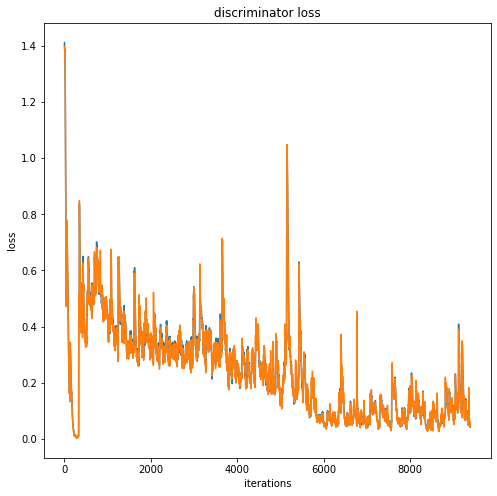

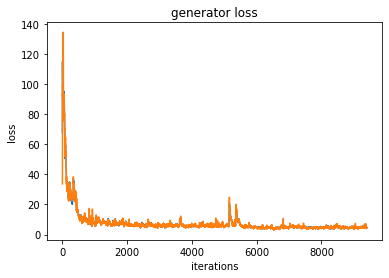

 95%|█████████▍| 9499/10000 [1:43:39<05:17,  1.58it/s]

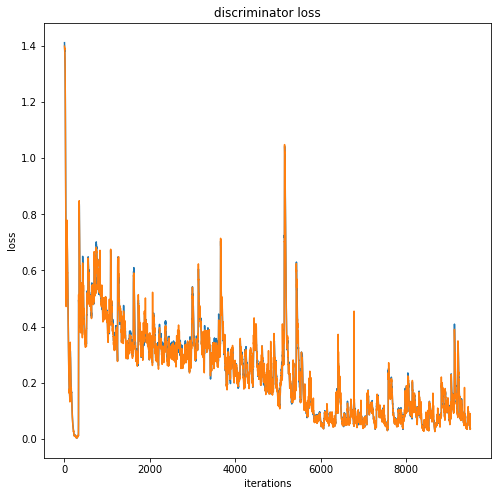

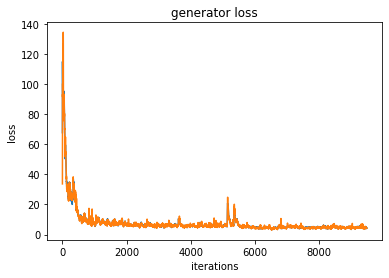

 96%|█████████▌| 9599/10000 [1:44:43<04:23,  1.52it/s]

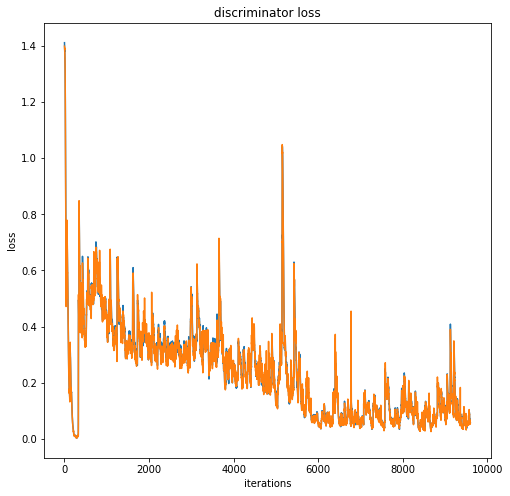

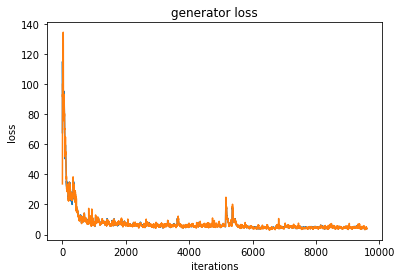

 97%|█████████▋| 9699/10000 [1:45:50<03:14,  1.55it/s]

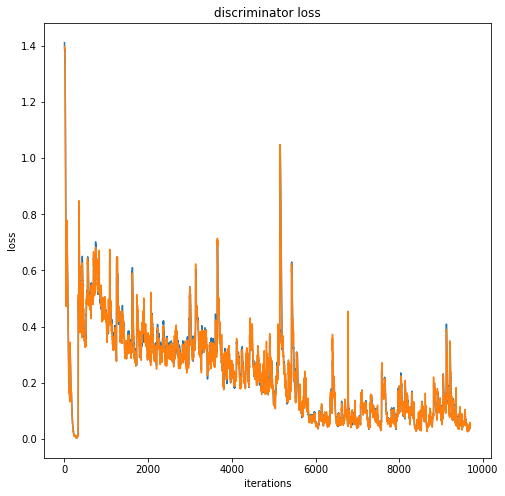

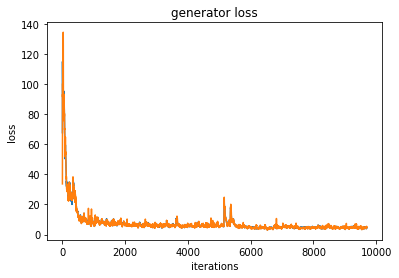

 98%|█████████▊| 9799/10000 [1:46:58<02:12,  1.52it/s]

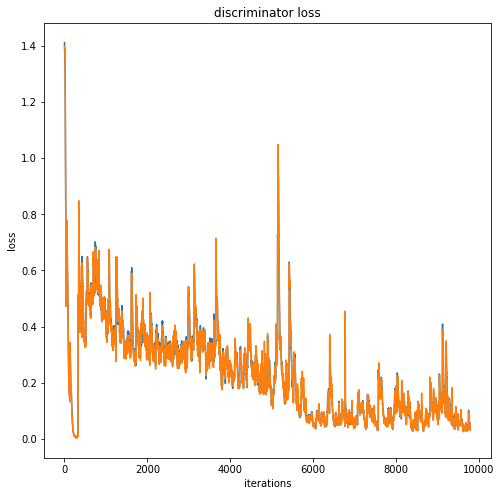

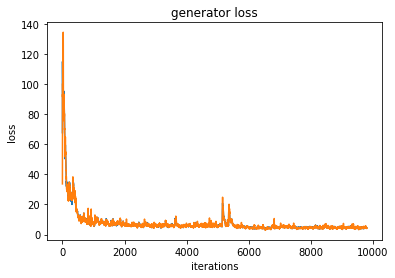

 99%|█████████▉| 9899/10000 [1:48:03<01:05,  1.54it/s]

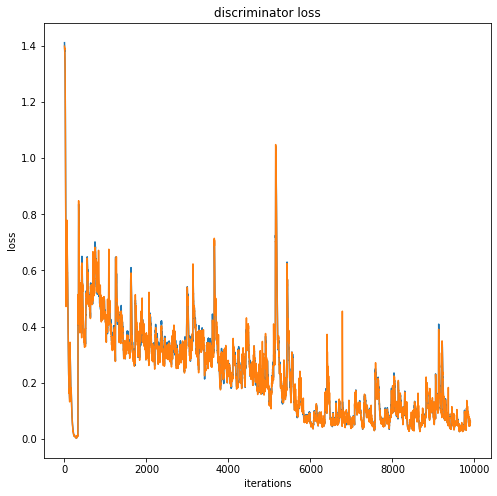

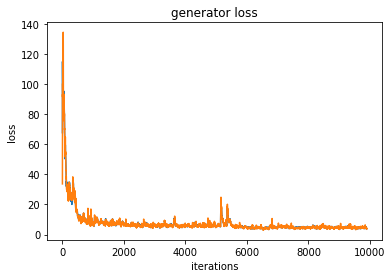

100%|█████████▉| 9999/10000 [1:49:09<00:00,  1.54it/s]

Iteration 10000/703023: dis loss = 0.0345, gen loss = 2.8729


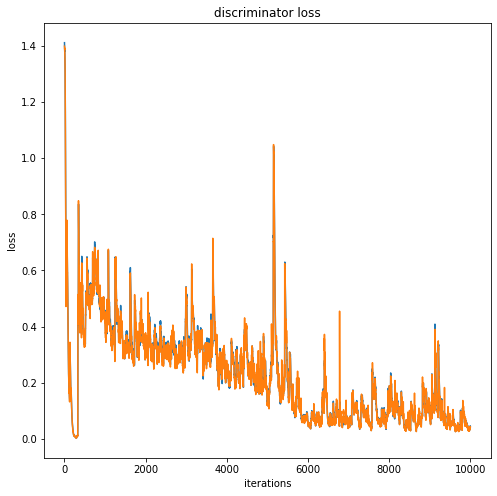

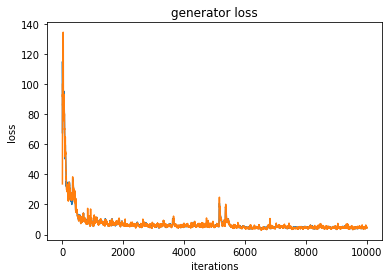

  0%|          | 0/10000 [00:00<?, ?it/s]

Start training ...


  1%|          | 99/10000 [01:11<1:47:50,  1.53it/s]

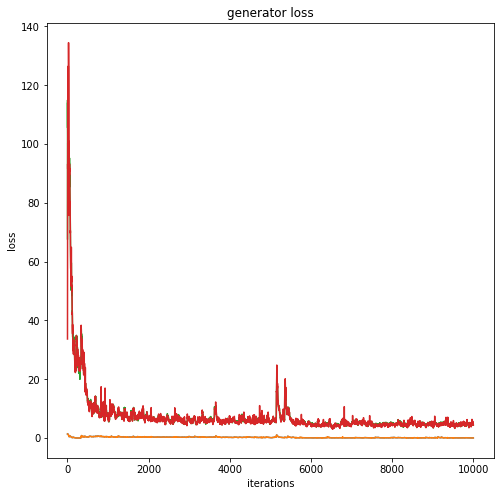

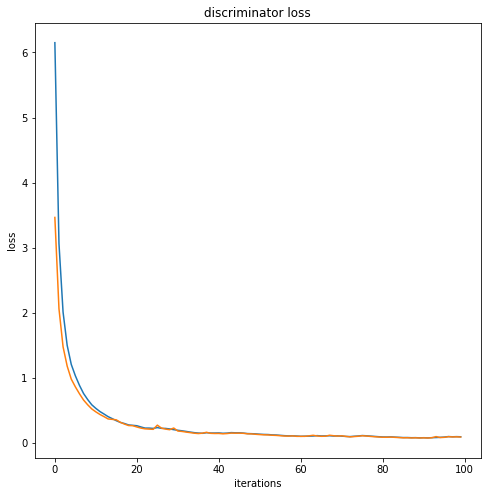

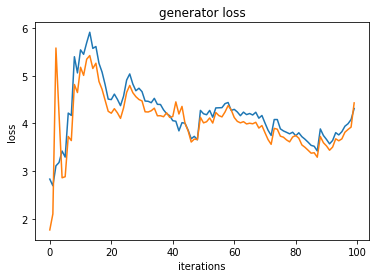

  2%|▏         | 199/10000 [06:19<1:56:55,  1.40it/s]  

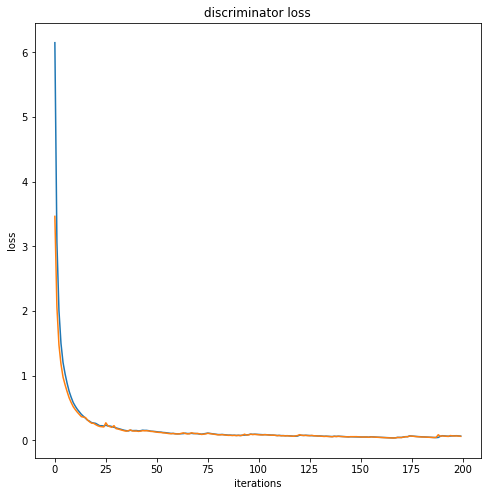

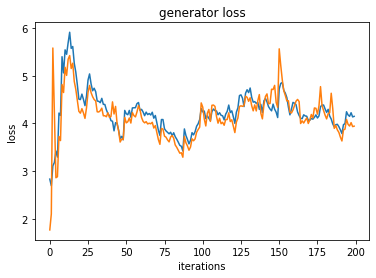

  3%|▎         | 299/10000 [07:32<1:58:13,  1.37it/s]

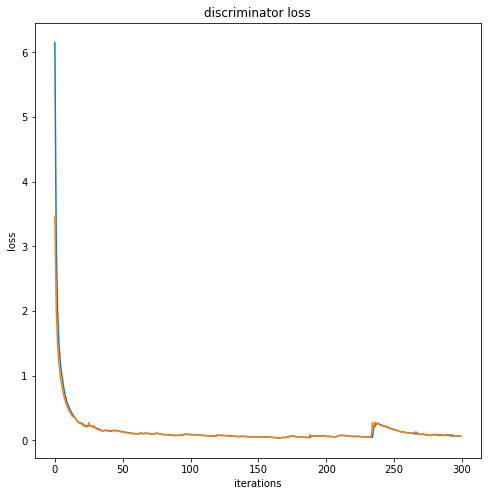

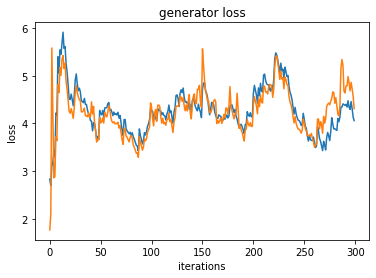

  4%|▍         | 399/10000 [08:50<1:50:05,  1.45it/s]

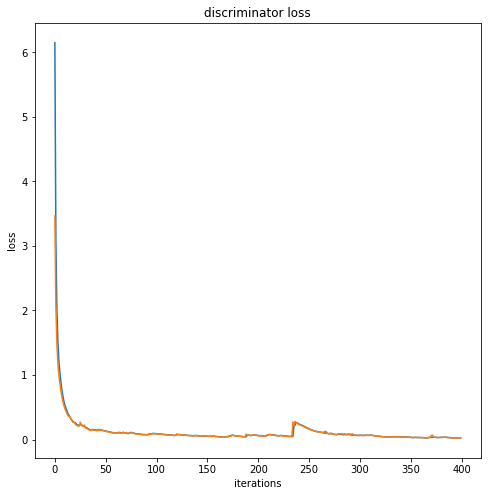

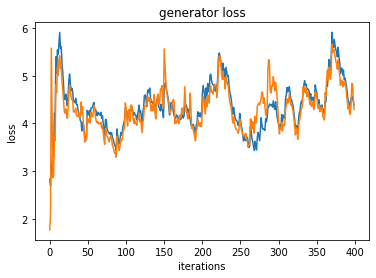

  5%|▍         | 499/10000 [10:00<1:45:40,  1.50it/s]

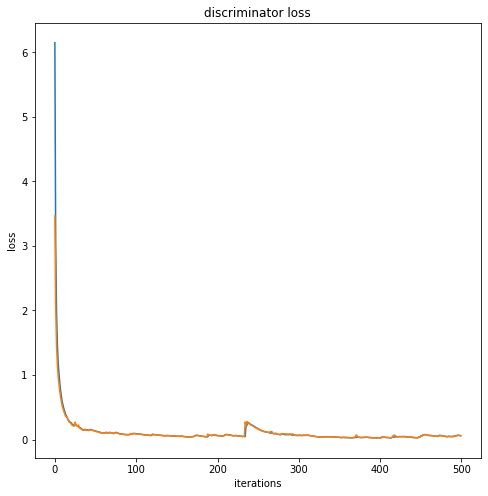

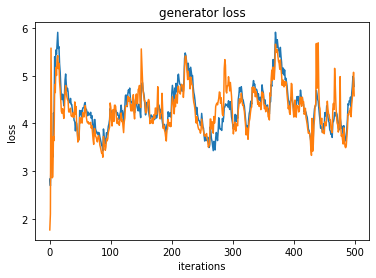

  6%|▌         | 599/10000 [11:10<1:52:36,  1.39it/s]

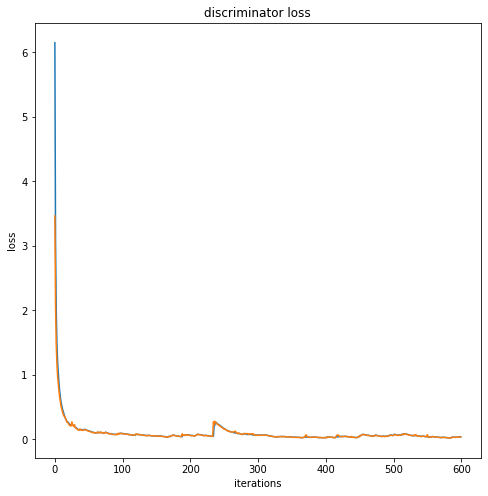

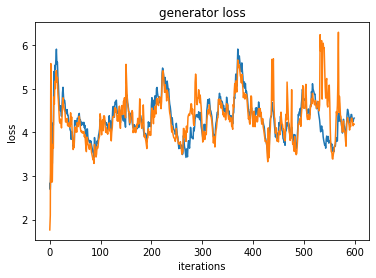

  7%|▋         | 699/10000 [12:17<1:47:05,  1.45it/s]

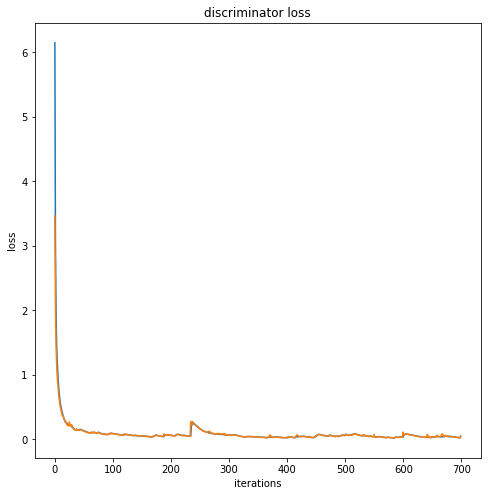

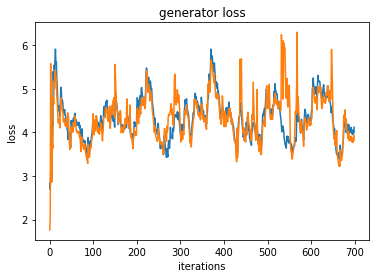

  8%|▊         | 799/10000 [13:29<1:54:42,  1.34it/s]

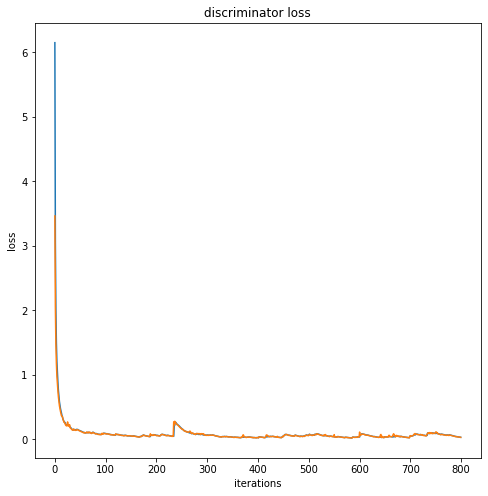

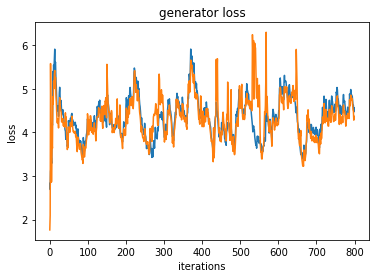

  9%|▉         | 899/10000 [14:39<1:45:28,  1.44it/s]

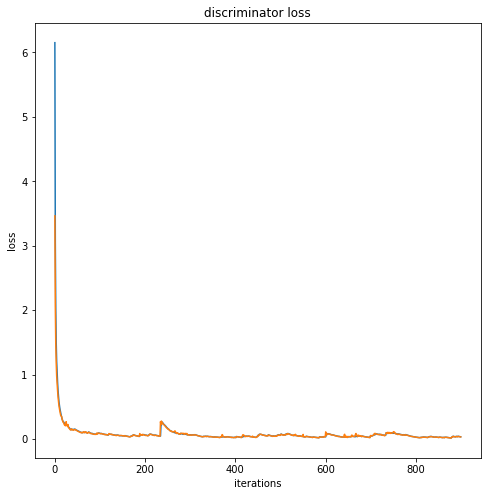

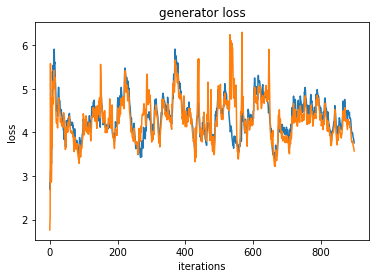

 10%|▉         | 999/10000 [15:49<1:38:47,  1.52it/s]

Iteration 1000/703023: dis loss = 0.0904, gen loss = 4.6128


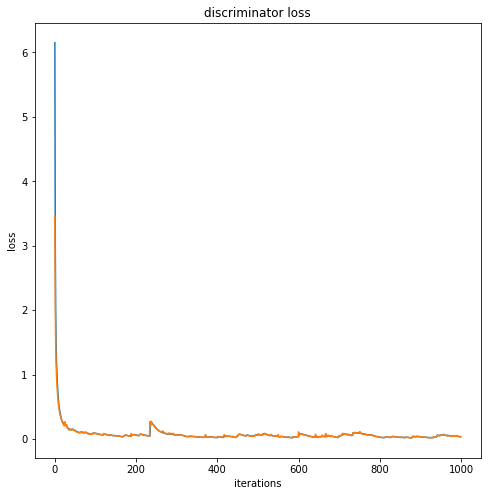

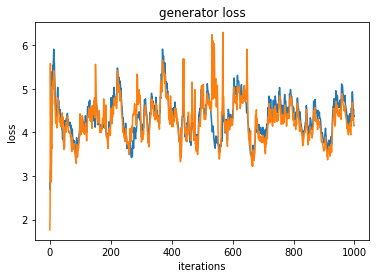

 11%|█         | 1099/10000 [17:01<1:38:54,  1.50it/s]

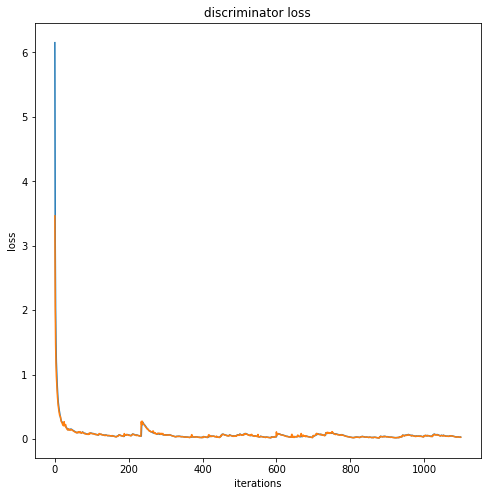

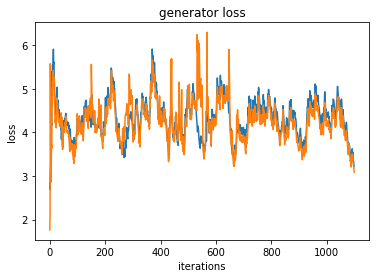

 12%|█▏        | 1199/10000 [18:11<1:39:32,  1.47it/s]

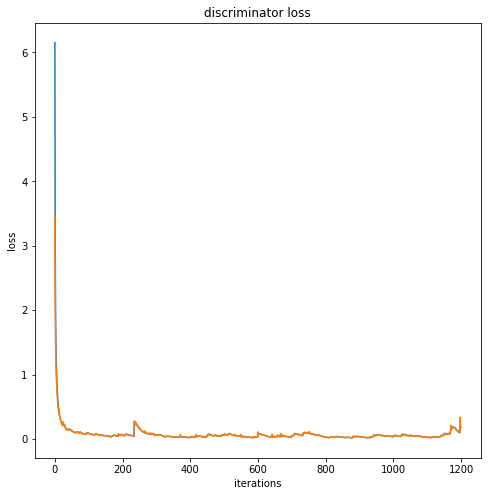

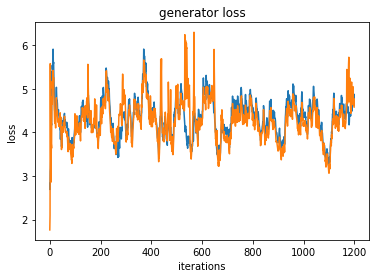

 13%|█▎        | 1299/10000 [19:22<1:46:06,  1.37it/s]

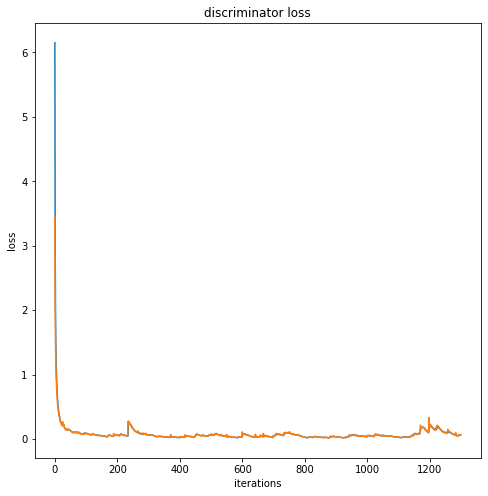

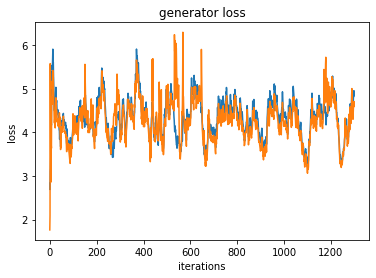

 14%|█▍        | 1399/10000 [20:32<1:35:57,  1.49it/s]

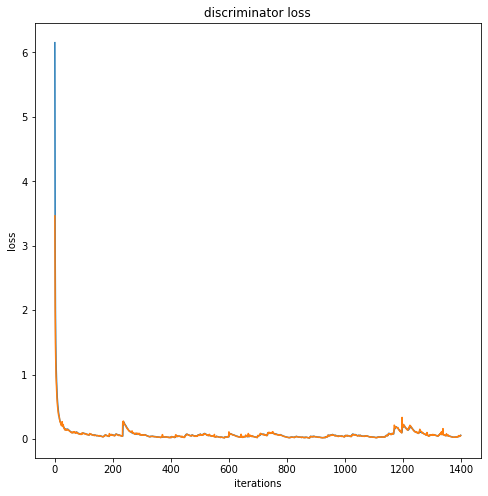

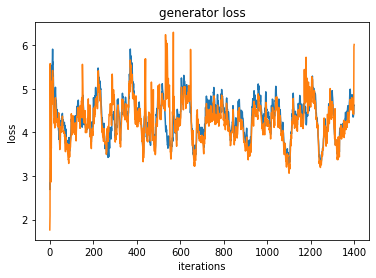

 15%|█▍        | 1499/10000 [21:41<1:35:31,  1.48it/s]

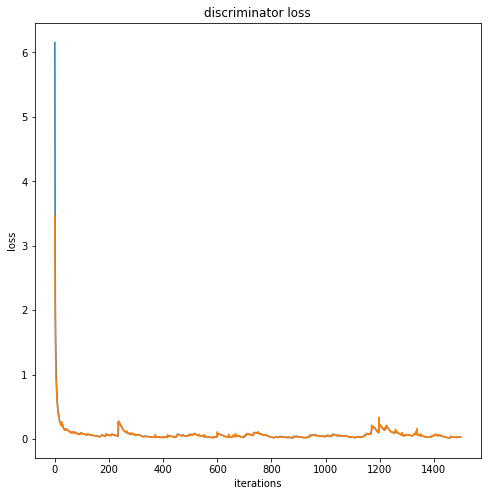

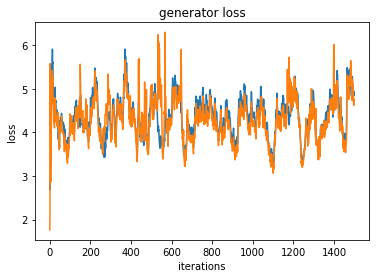

 16%|█▌        | 1599/10000 [22:51<2:17:58,  1.01it/s]

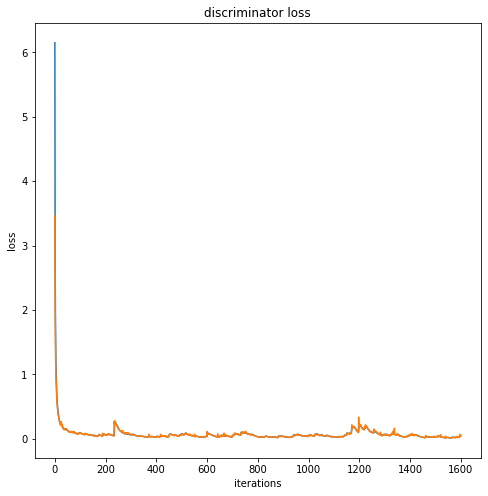

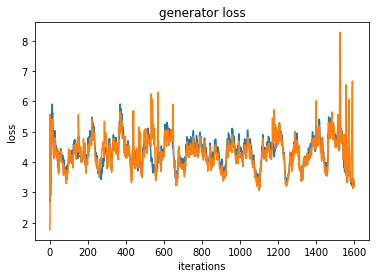

 17%|█▋        | 1699/10000 [24:10<3:04:06,  1.33s/it]

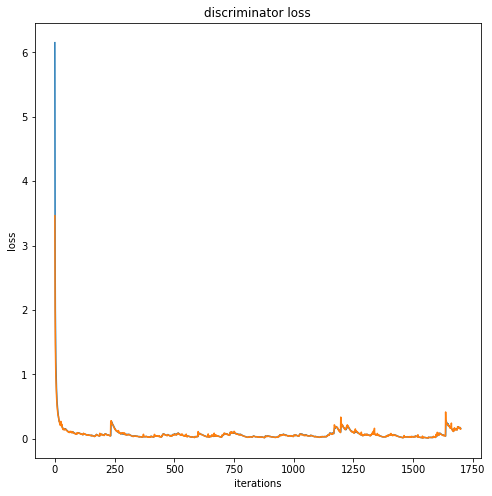

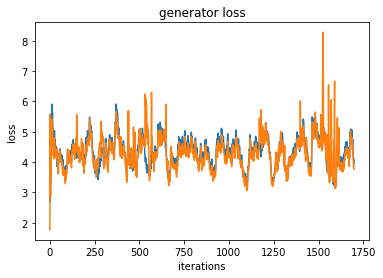

 18%|█▊        | 1799/10000 [25:29<1:41:28,  1.35it/s]

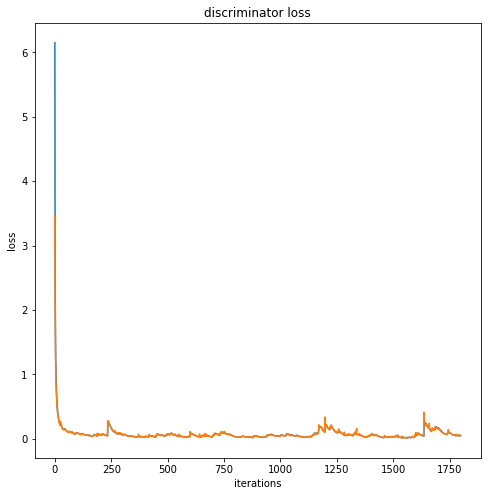

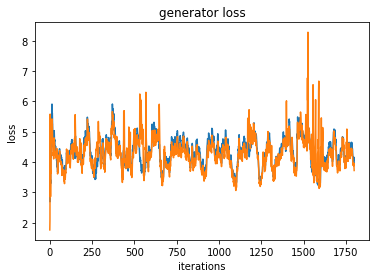

 19%|█▉        | 1899/10000 [26:49<1:41:03,  1.34it/s]

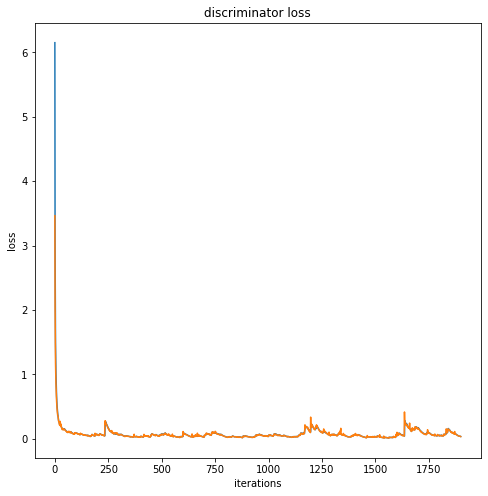

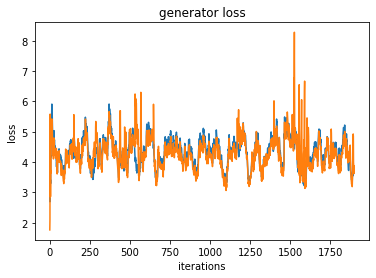

 20%|█▉        | 1999/10000 [28:11<1:39:29,  1.34it/s]

Iteration 2000/703023: dis loss = 0.0018, gen loss = 3.5451


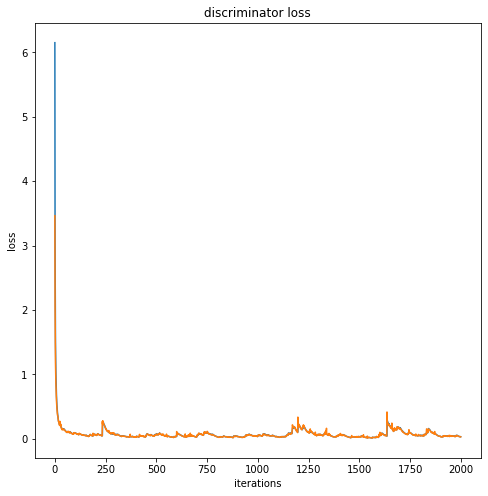

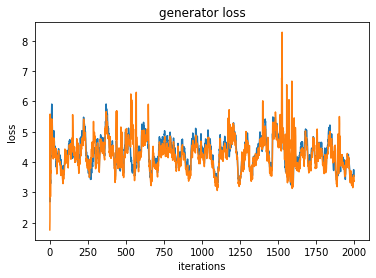

 21%|██        | 2099/10000 [29:34<1:35:59,  1.37it/s]

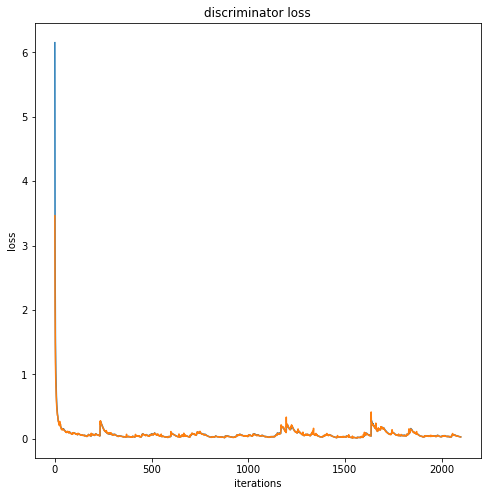

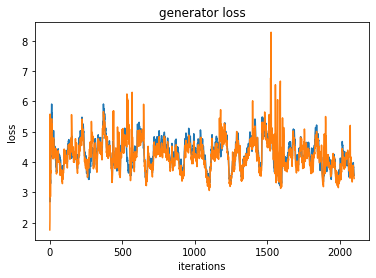

 22%|██▏       | 2199/10000 [30:50<1:33:13,  1.39it/s]

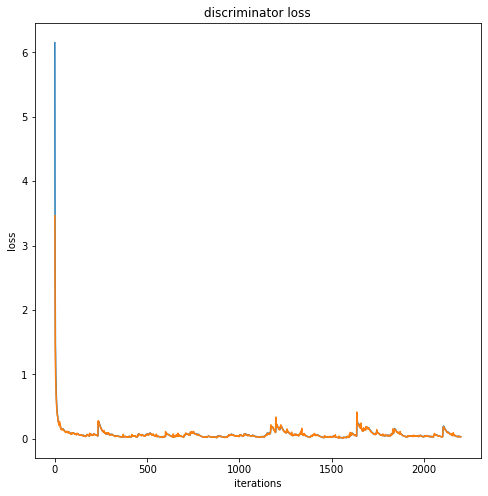

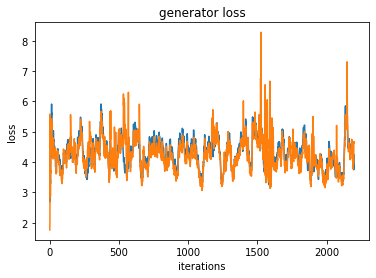

 23%|██▎       | 2299/10000 [32:14<2:34:45,  1.21s/it]

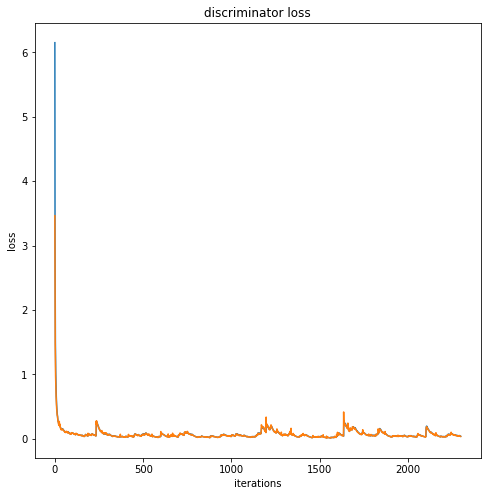

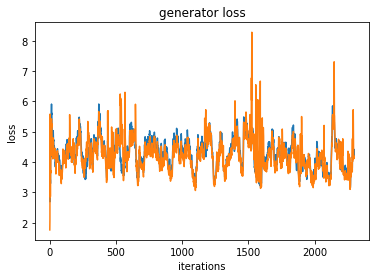

 24%|██▍       | 2399/10000 [33:38<1:34:43,  1.34it/s]

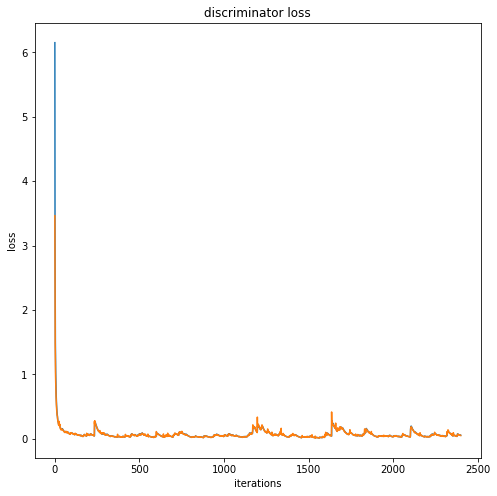

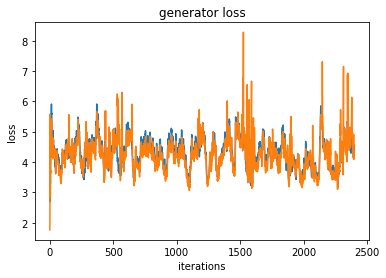

 25%|██▍       | 2499/10000 [34:56<1:29:39,  1.39it/s]

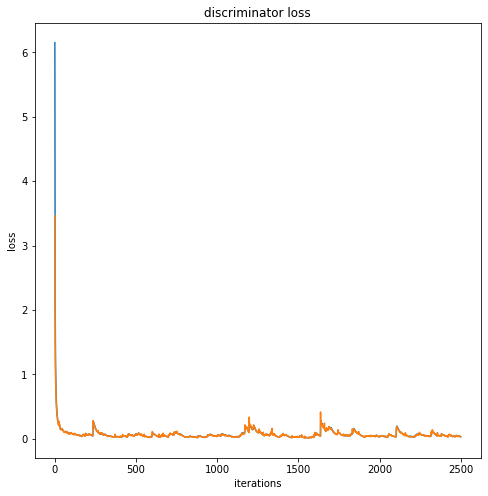

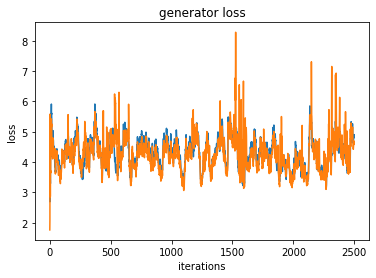

 26%|██▌       | 2599/10000 [36:17<1:26:03,  1.43it/s]

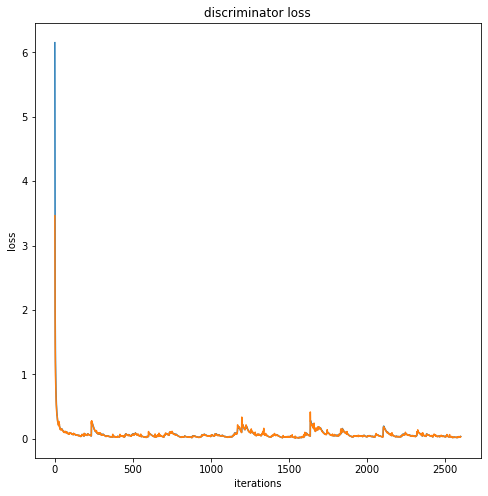

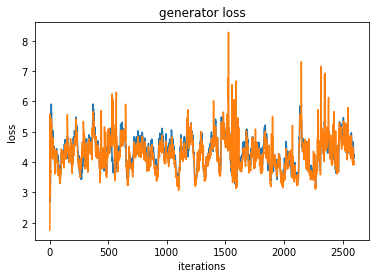

 27%|██▋       | 2699/10000 [37:39<1:27:52,  1.38it/s]

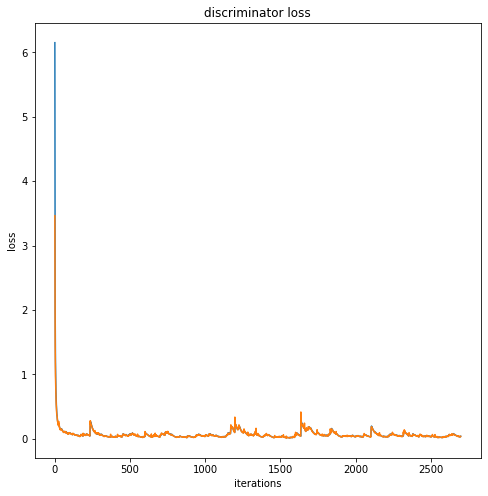

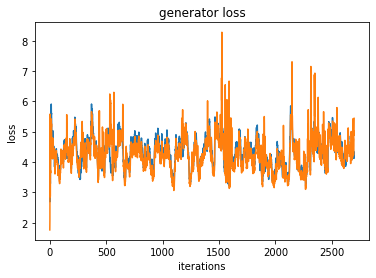

 28%|██▊       | 2799/10000 [38:58<1:25:03,  1.41it/s]

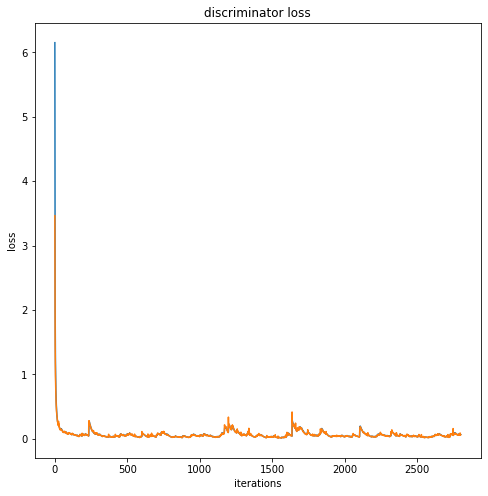

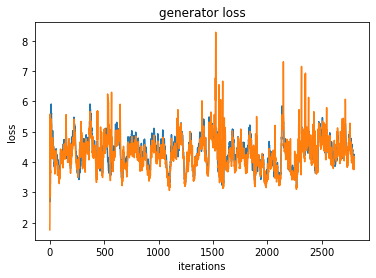

 29%|██▉       | 2899/10000 [40:14<1:49:13,  1.08it/s]

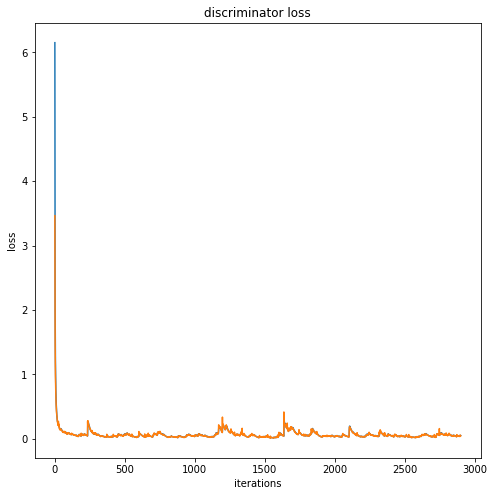

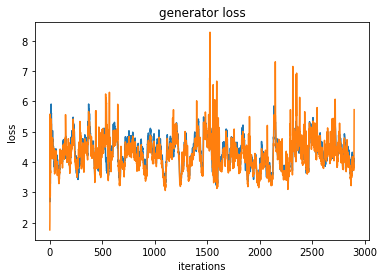

 30%|██▉       | 2999/10000 [41:28<1:28:08,  1.32it/s]

Iteration 3000/703023: dis loss = 0.0139, gen loss = 2.2425


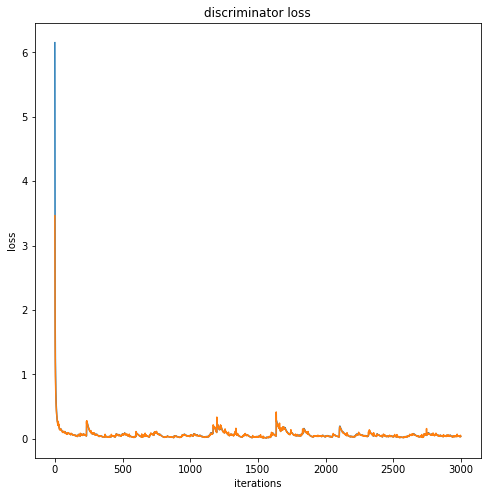

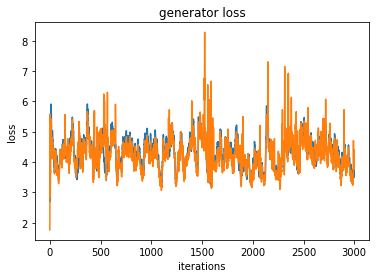

 31%|███       | 3099/10000 [42:42<1:20:11,  1.43it/s]

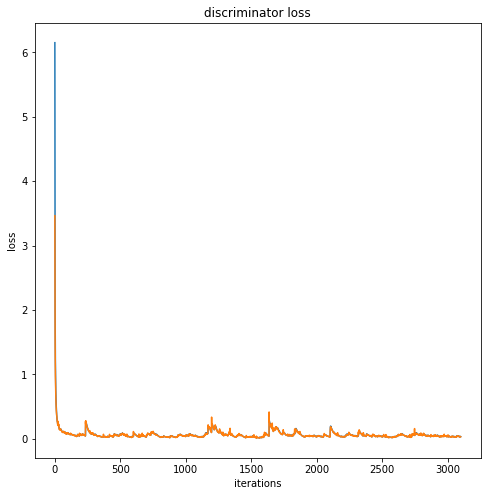

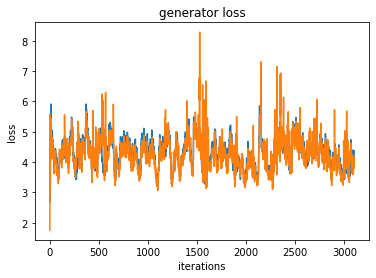

 32%|███▏      | 3199/10000 [43:54<1:16:56,  1.47it/s]

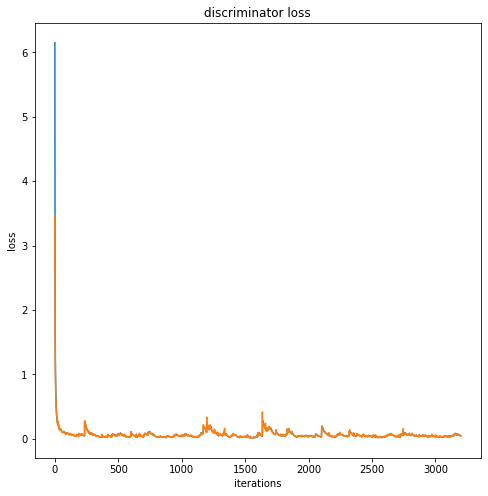

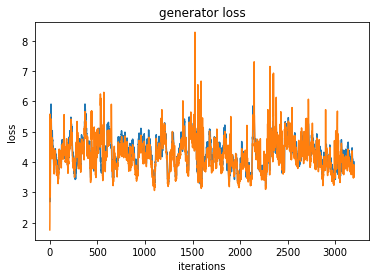

 33%|███▎      | 3299/10000 [45:08<1:26:44,  1.29it/s]

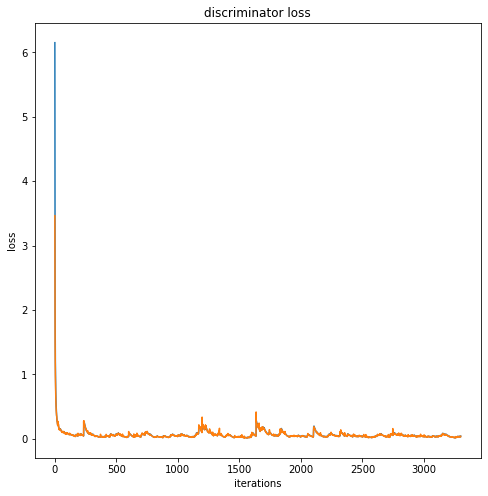

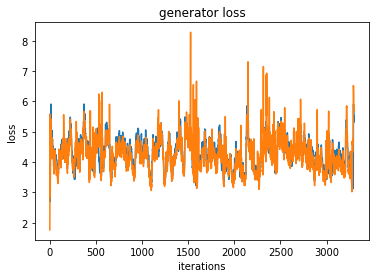

 33%|███▎      | 3319/10000 [45:23<1:20:20,  1.39it/s]

In [ ]:
gan = GAN()
gan(train_dataloader)

# training with different discriminator - dropout, leakyRelu, batch norm, lr=1e3

  0%|          | 0/10000 [00:00<?, ?it/s]

Start training ...


  1%|          | 99/10000 [01:08<1:48:10,  1.53it/s]

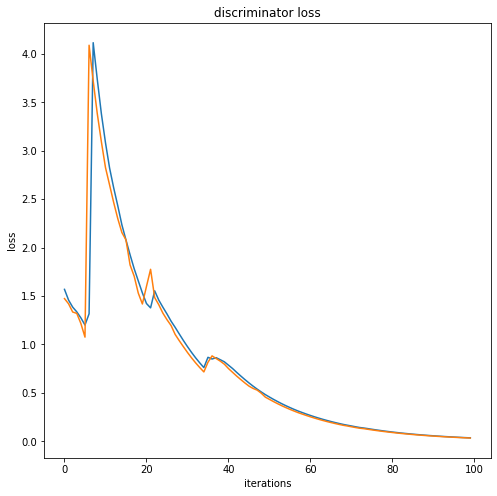

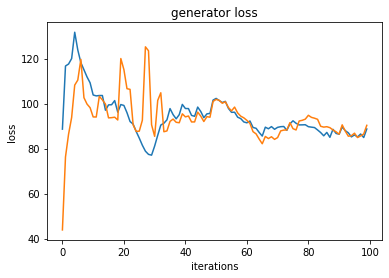

  2%|▏         | 199/10000 [02:16<1:47:19,  1.52it/s]

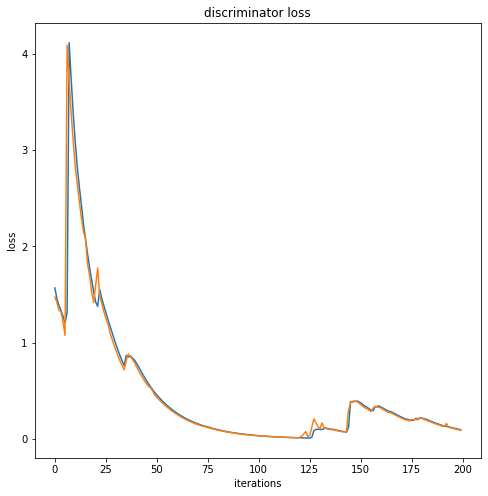

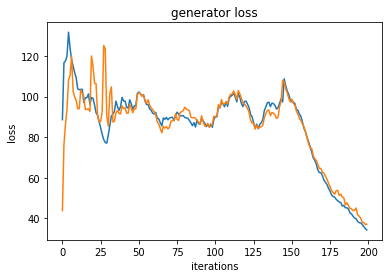

  3%|▎         | 299/10000 [03:22<1:48:09,  1.49it/s]

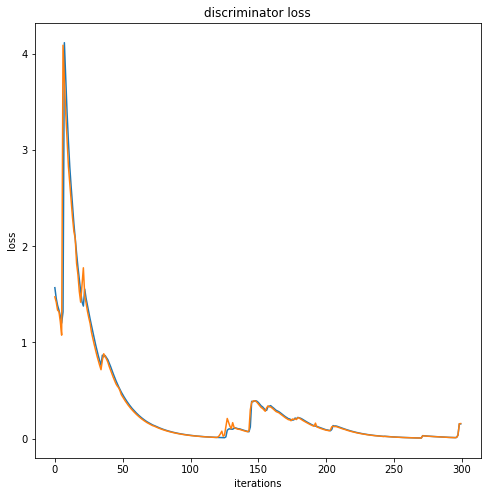

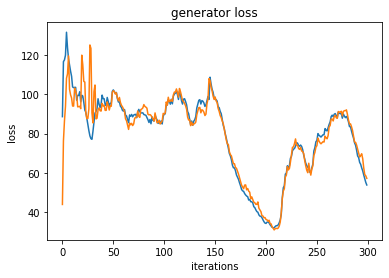

  4%|▍         | 399/10000 [04:28<1:43:24,  1.55it/s]

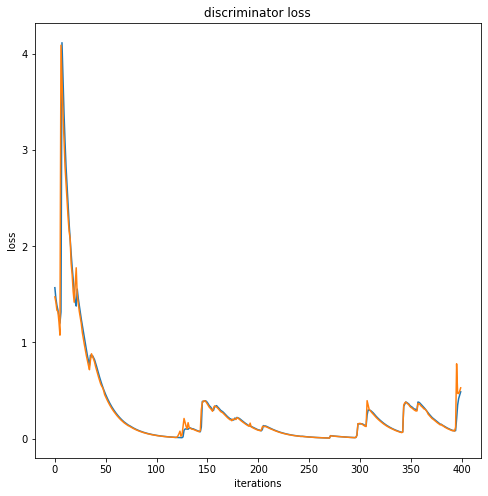

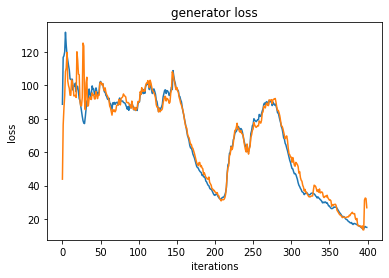

  5%|▍         | 499/10000 [05:33<1:42:36,  1.54it/s]

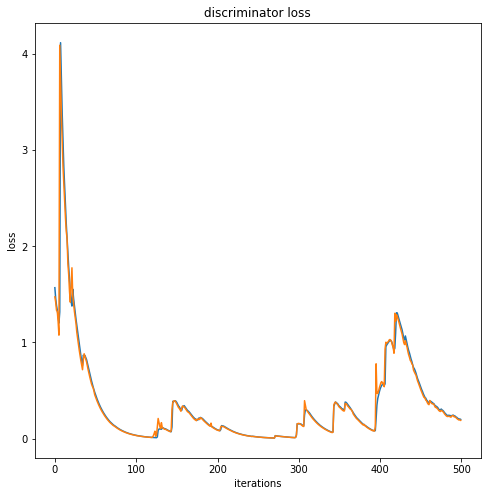

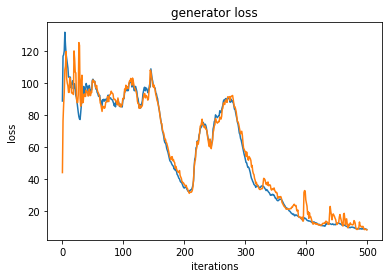

  6%|▌         | 599/10000 [06:40<1:43:46,  1.51it/s]

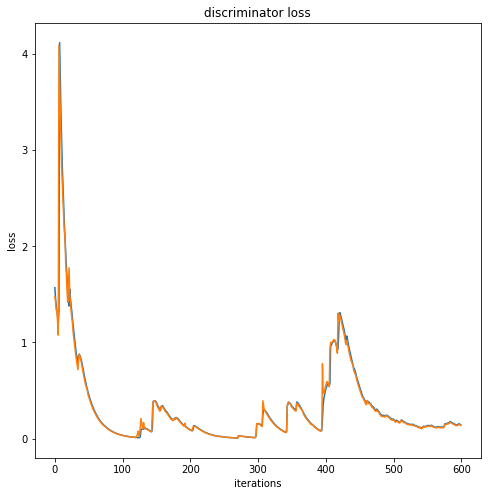

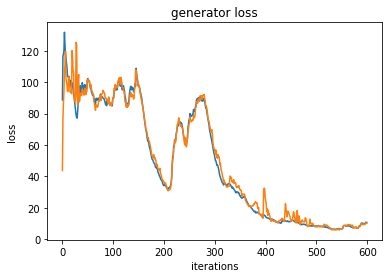

  7%|▋         | 699/10000 [07:47<1:44:23,  1.48it/s]

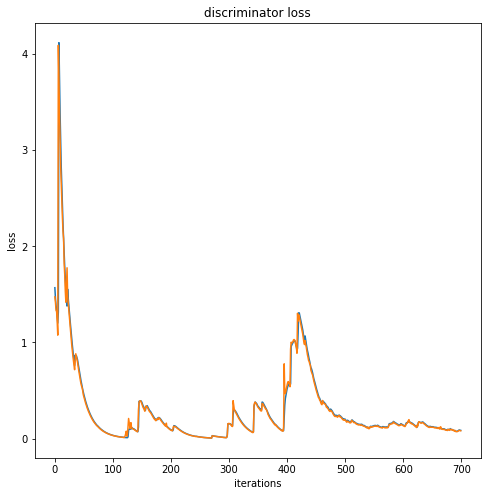

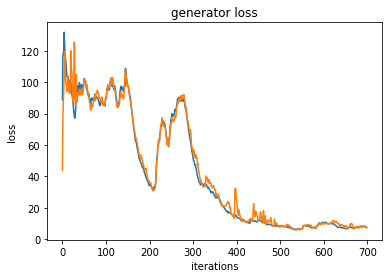

  8%|▊         | 799/10000 [08:53<1:41:40,  1.51it/s]

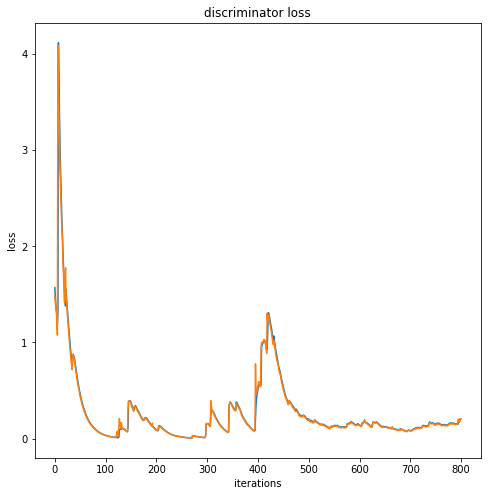

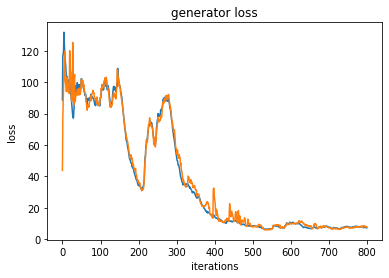

  9%|▉         | 899/10000 [10:00<1:43:12,  1.47it/s]

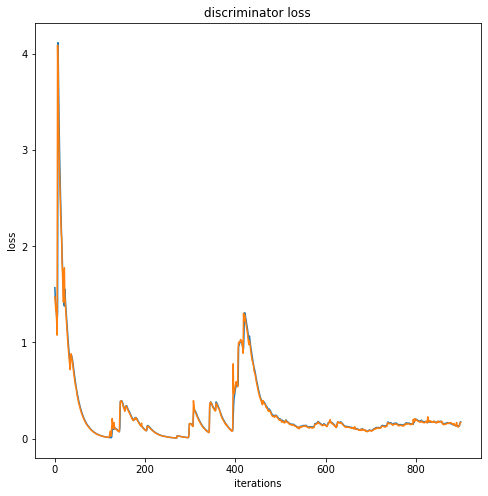

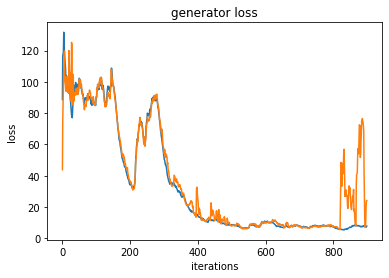

 10%|▉         | 999/10000 [11:09<1:40:24,  1.49it/s]

Iteration 1000/703023: dis loss = 0.0889, gen loss = 4.4405


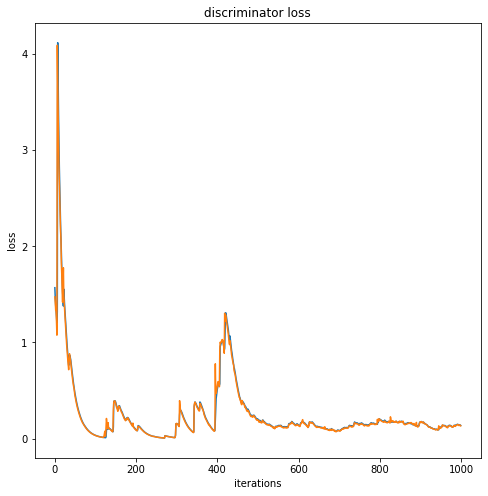

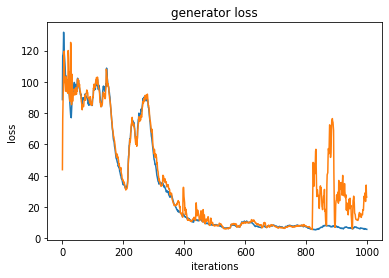

 11%|█         | 1099/10000 [12:15<1:36:44,  1.53it/s]

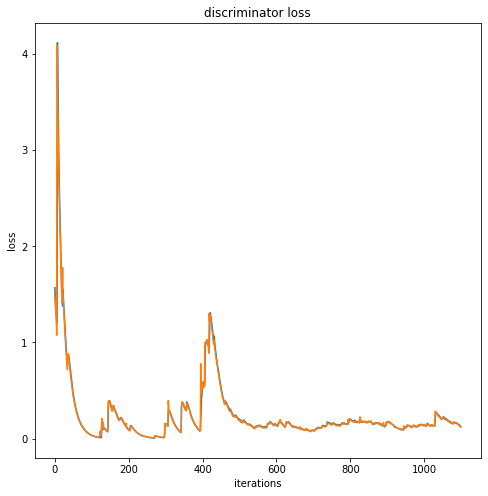

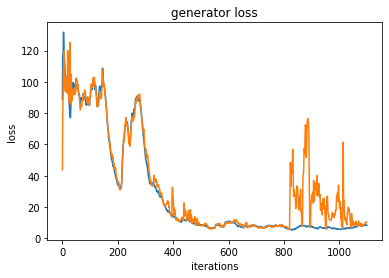

 12%|█▏        | 1199/10000 [13:21<1:38:13,  1.49it/s]

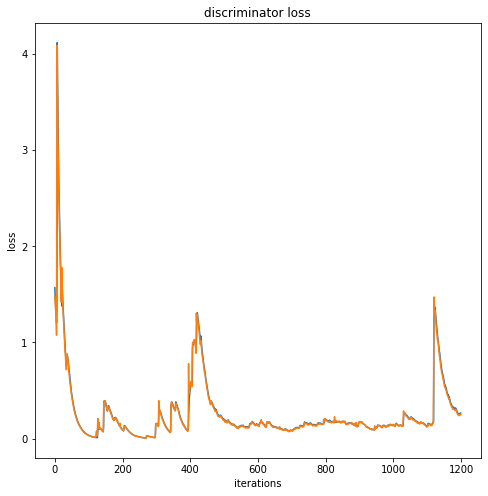

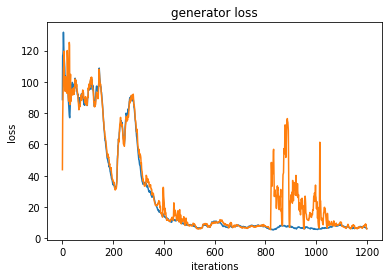

 13%|█▎        | 1299/10000 [14:27<1:36:28,  1.50it/s]

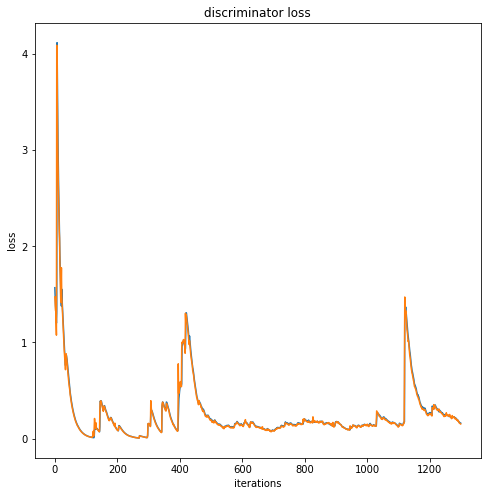

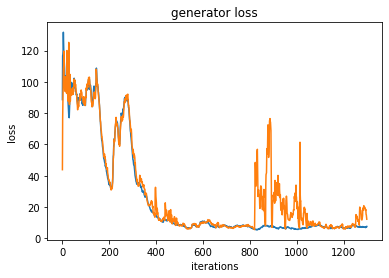

 14%|█▍        | 1399/10000 [15:34<1:33:45,  1.53it/s]

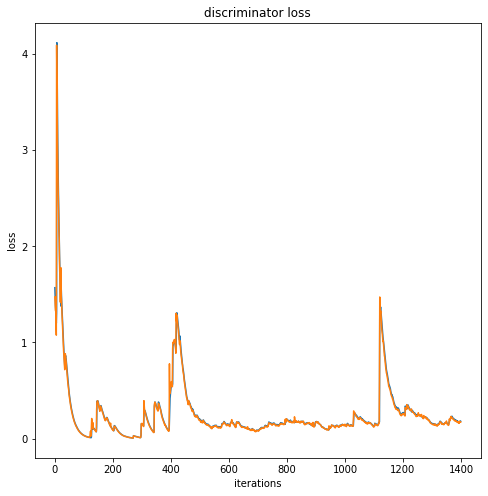

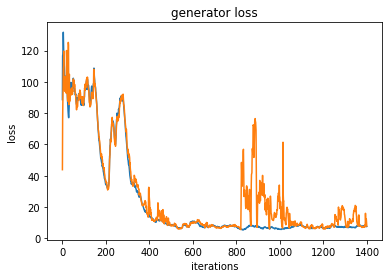

 15%|█▍        | 1499/10000 [16:40<1:34:30,  1.50it/s]

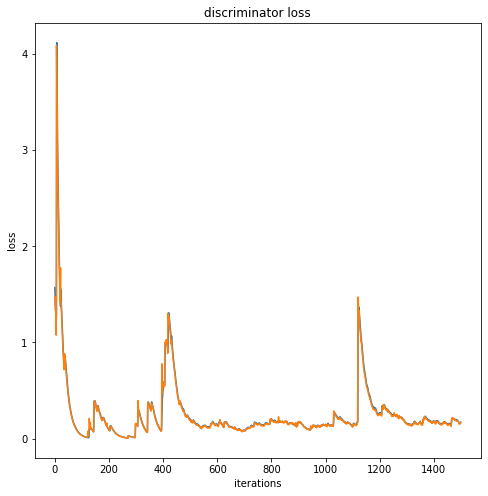

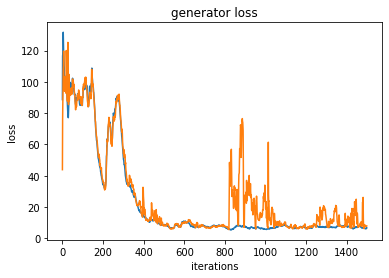

 16%|█▌        | 1599/10000 [17:47<1:34:45,  1.48it/s]

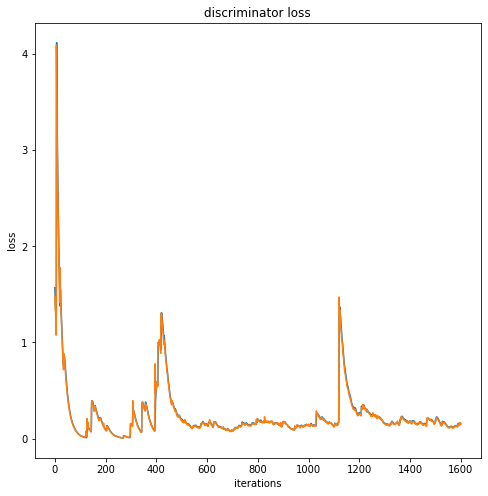

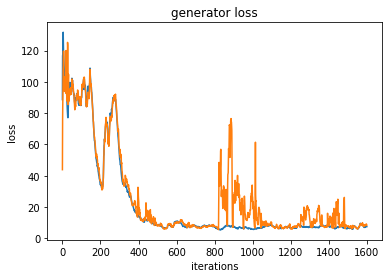

 17%|█▋        | 1699/10000 [18:55<1:36:06,  1.44it/s]

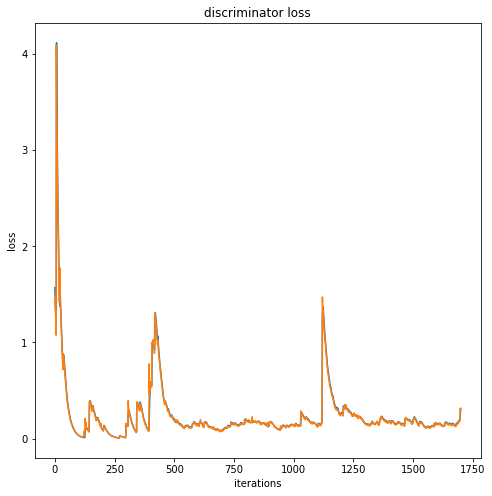

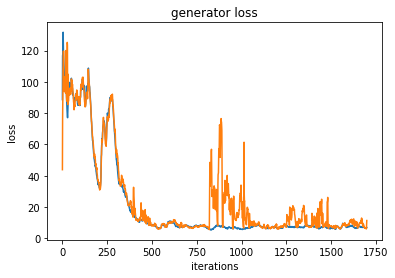

 18%|█▊        | 1799/10000 [20:03<1:29:17,  1.53it/s]

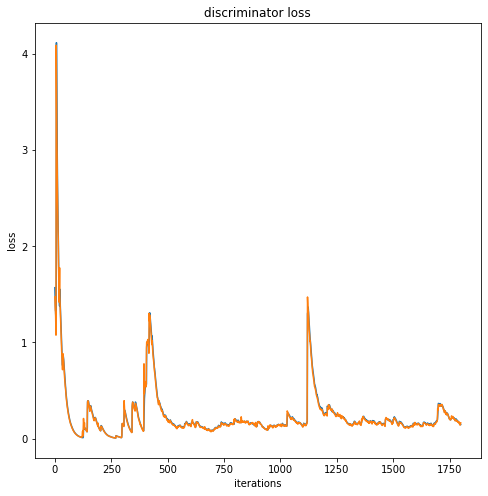

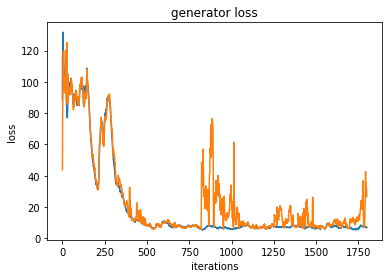

 19%|█▉        | 1899/10000 [21:10<1:31:04,  1.48it/s]

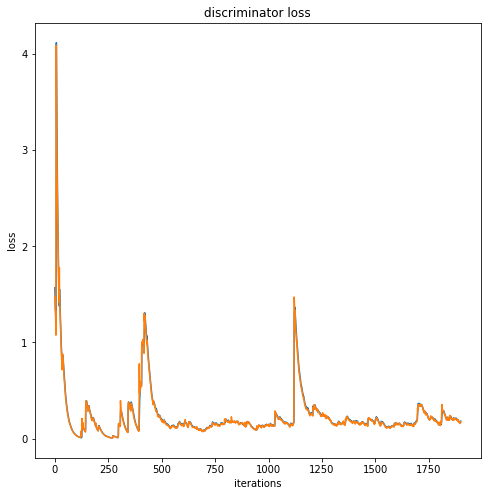

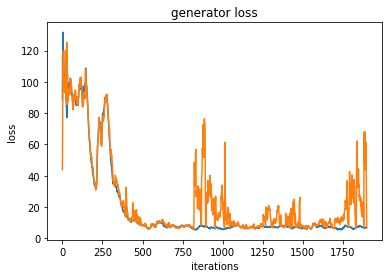

 20%|█▉        | 1999/10000 [22:16<1:28:05,  1.51it/s]

Iteration 2000/703023: dis loss = 0.1061, gen loss = 11.3395


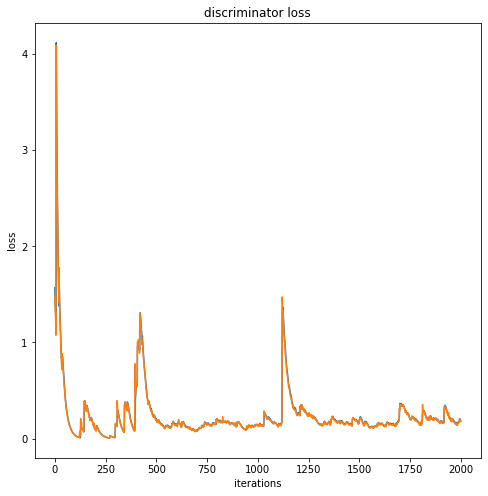

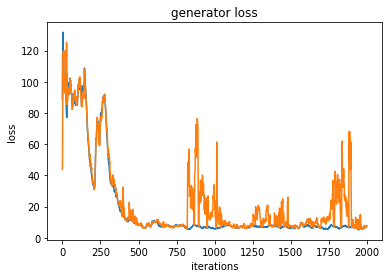

 21%|██        | 2099/10000 [23:24<1:28:35,  1.49it/s]

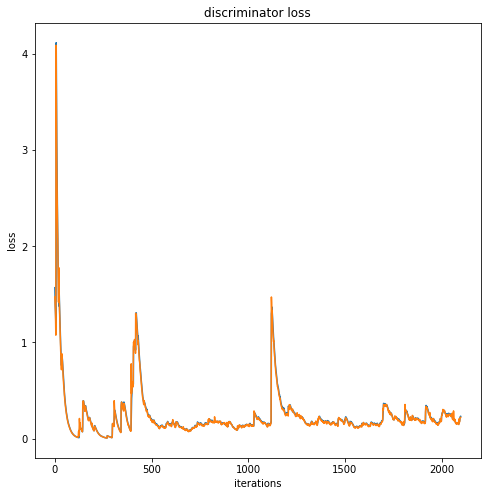

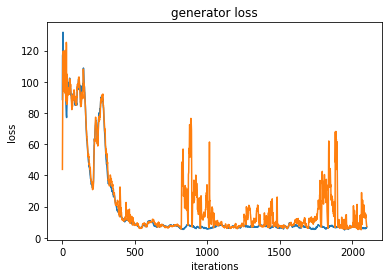

 22%|██▏       | 2199/10000 [24:30<1:25:59,  1.51it/s]

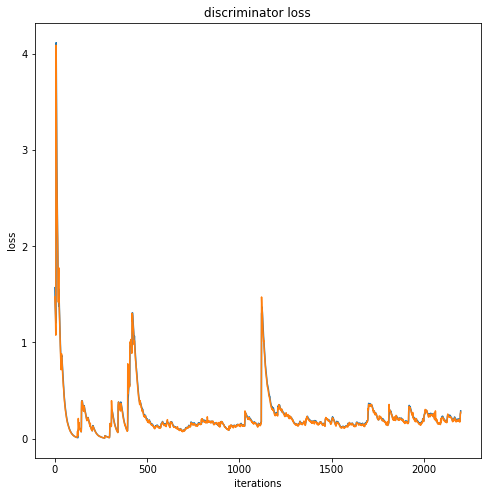

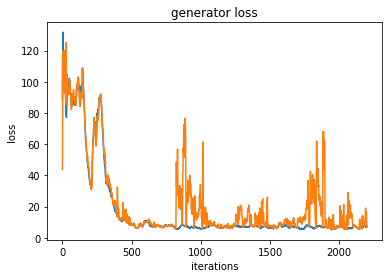

 23%|██▎       | 2299/10000 [25:36<1:24:16,  1.52it/s]

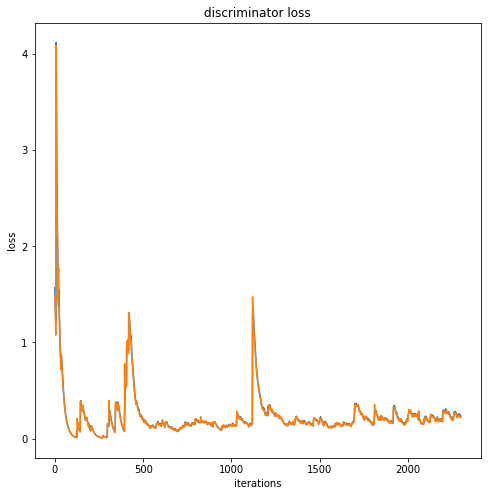

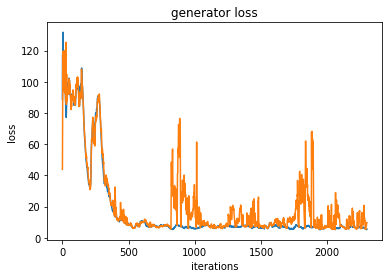

 24%|██▍       | 2399/10000 [26:43<1:24:46,  1.49it/s]

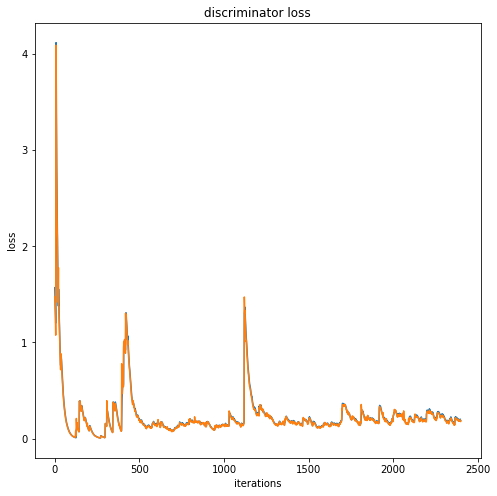

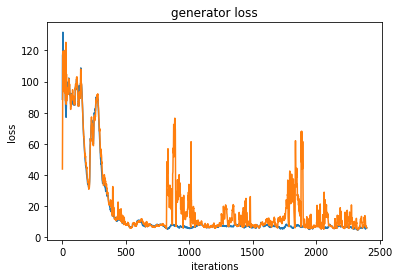

 25%|██▍       | 2499/10000 [27:50<1:23:15,  1.50it/s]

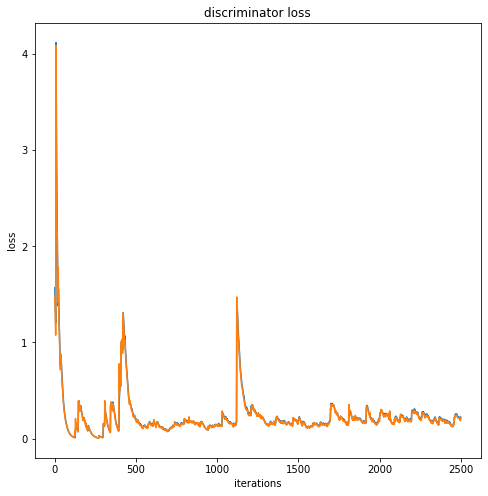

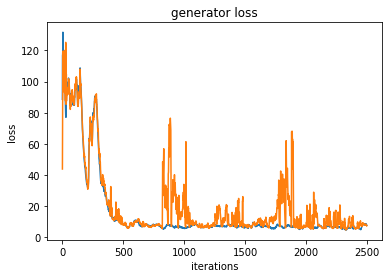

 26%|██▌       | 2599/10000 [28:58<1:21:42,  1.51it/s]

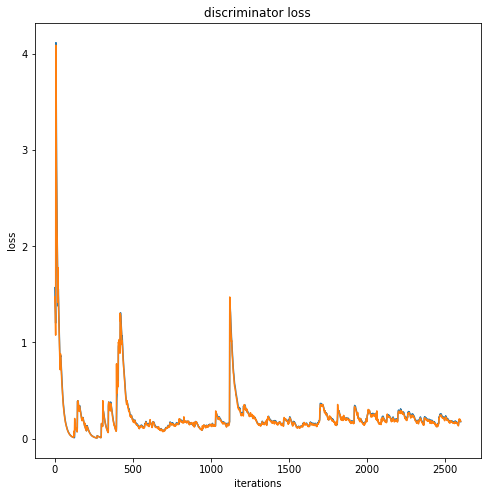

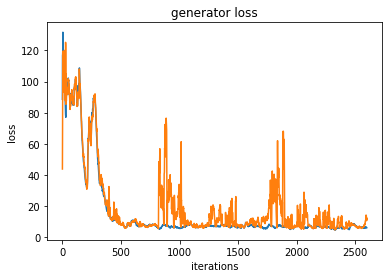

 27%|██▋       | 2699/10000 [30:04<1:21:06,  1.50it/s]

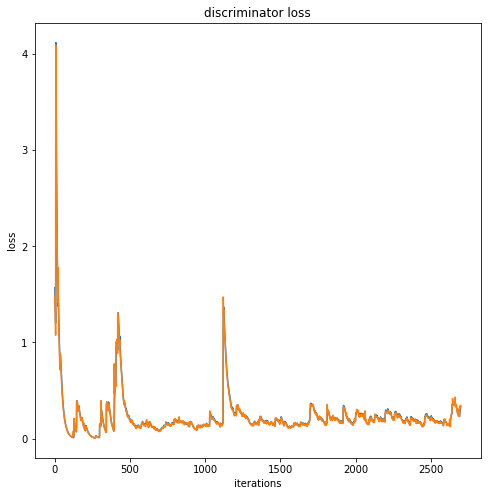

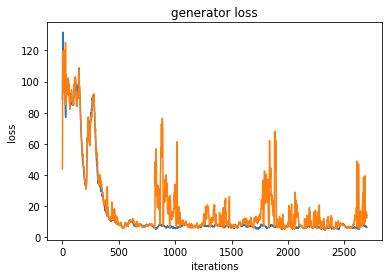

 28%|██▊       | 2799/10000 [31:10<1:20:02,  1.50it/s]

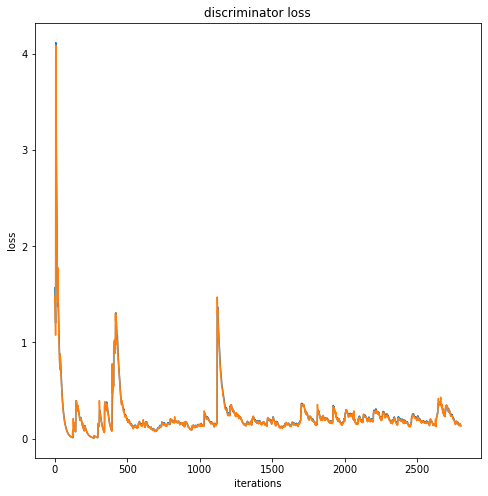

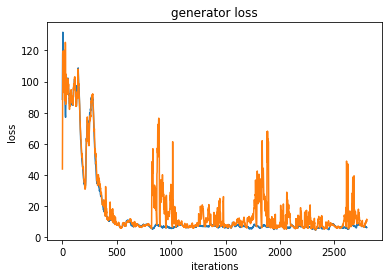

 29%|██▉       | 2899/10000 [32:18<1:17:41,  1.52it/s]

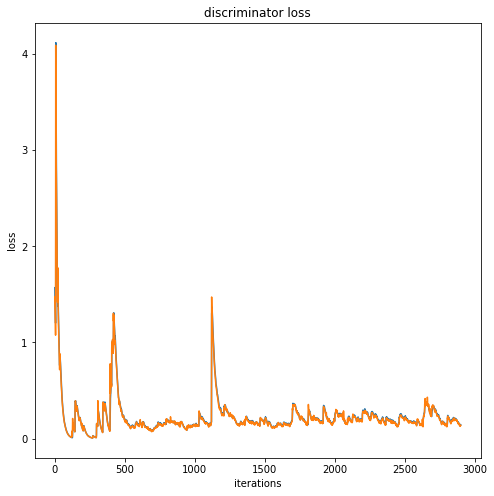

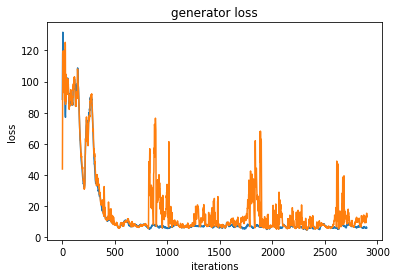

 30%|██▉       | 2999/10000 [33:25<1:17:30,  1.51it/s]

Iteration 3000/703023: dis loss = 0.7602, gen loss = 4.0910


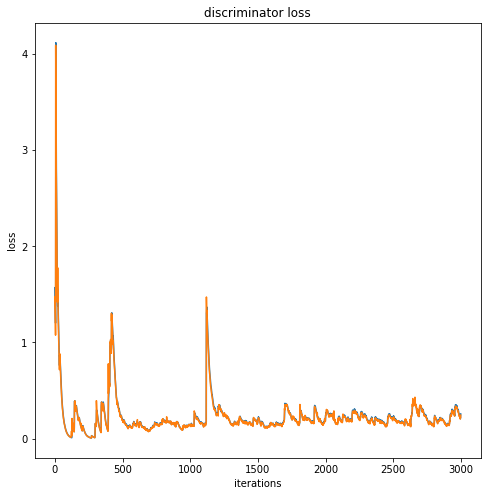

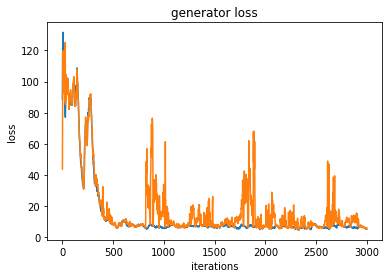

 31%|███       | 3099/10000 [34:32<1:15:59,  1.51it/s]

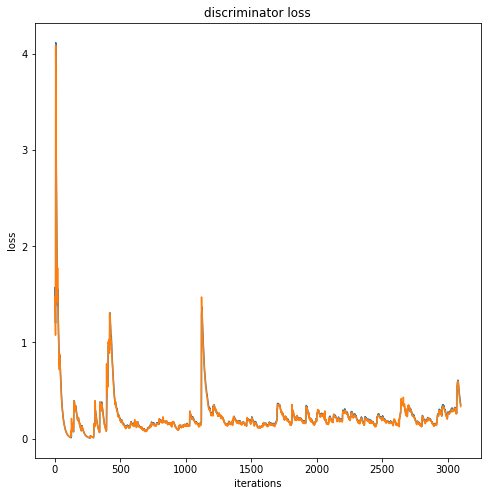

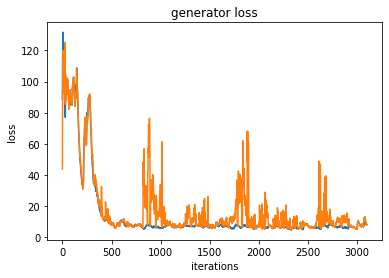

 32%|███▏      | 3199/10000 [35:38<1:14:31,  1.52it/s]

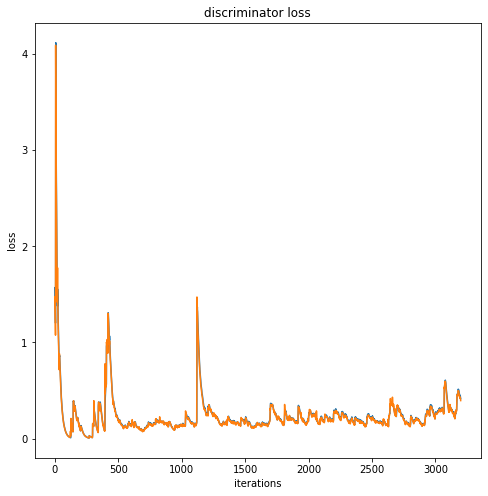

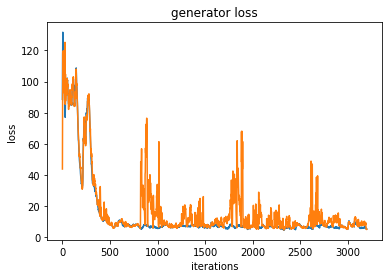

 33%|███▎      | 3299/10000 [36:44<1:13:07,  1.53it/s]

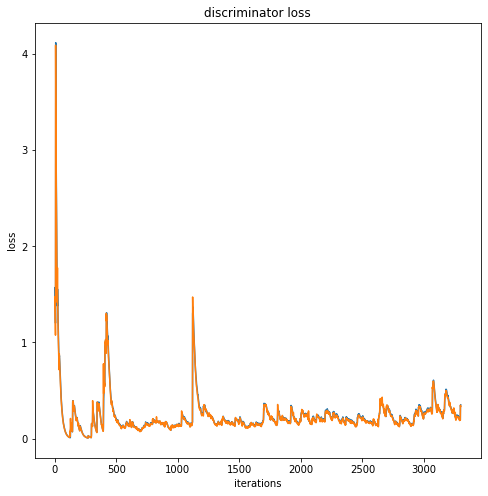

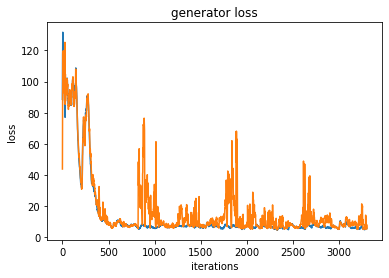

 34%|███▍      | 3399/10000 [37:50<1:13:41,  1.49it/s]

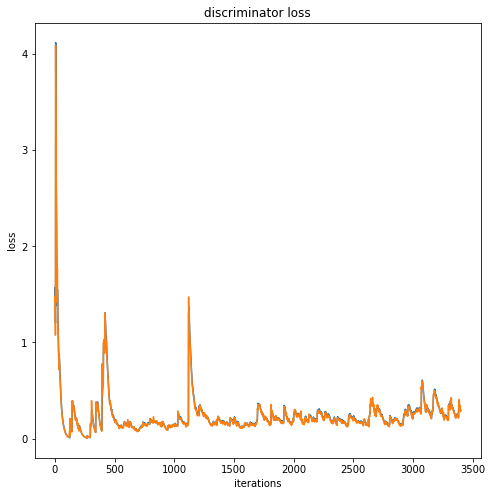

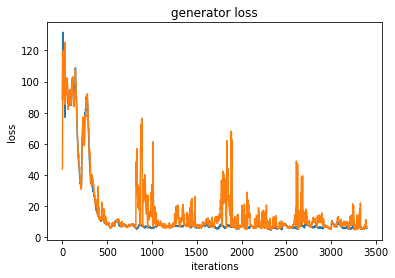

 35%|███▍      | 3499/10000 [38:57<1:11:28,  1.52it/s]

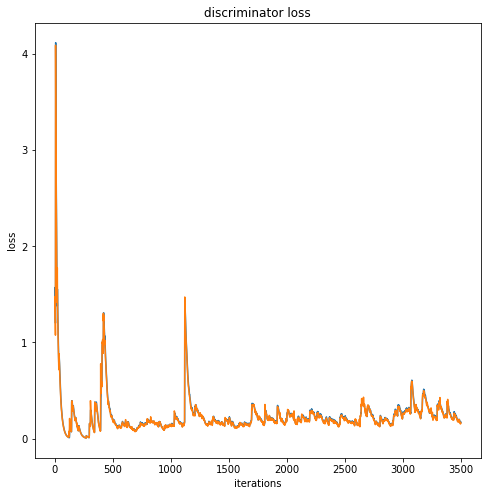

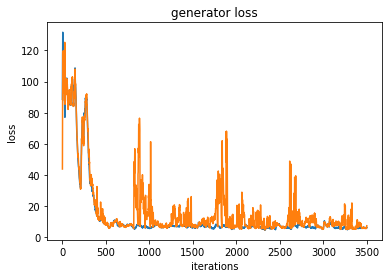

 36%|███▌      | 3599/10000 [40:04<1:11:00,  1.50it/s]

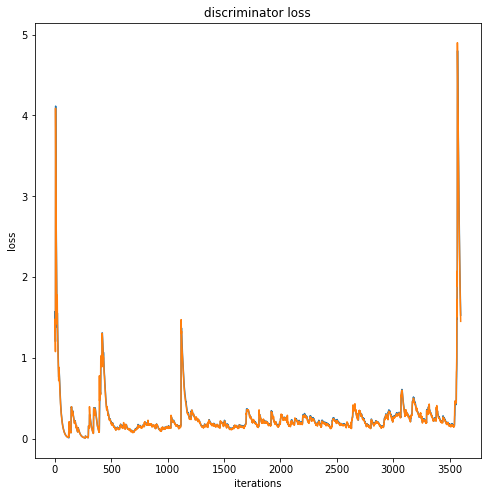

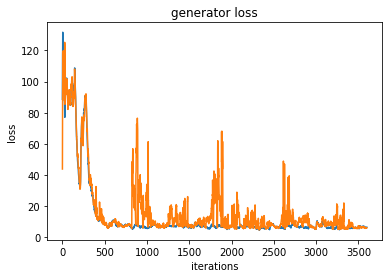

 37%|███▋      | 3699/10000 [41:11<1:09:29,  1.51it/s]

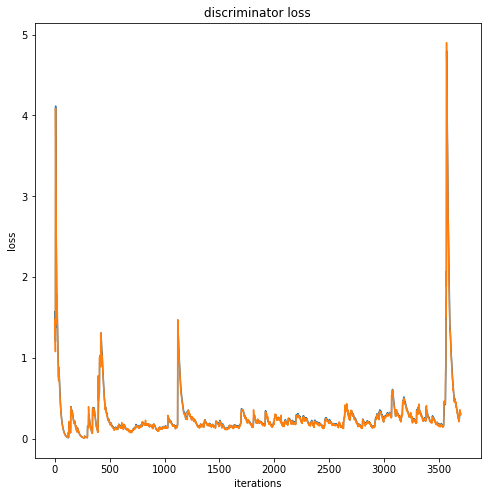

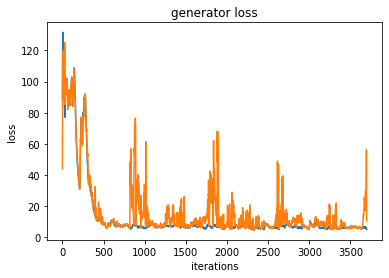

 38%|███▊      | 3799/10000 [42:20<1:08:26,  1.51it/s]

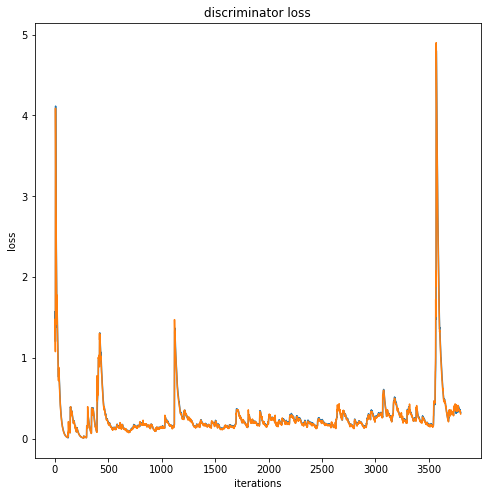

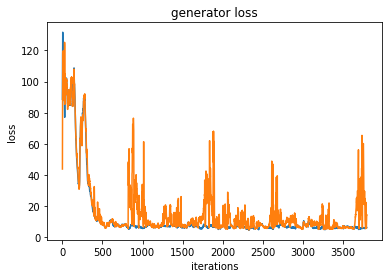

 39%|███▉      | 3899/10000 [43:28<1:09:27,  1.46it/s]

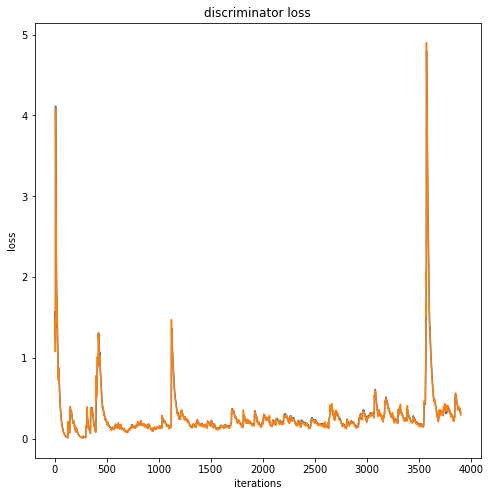

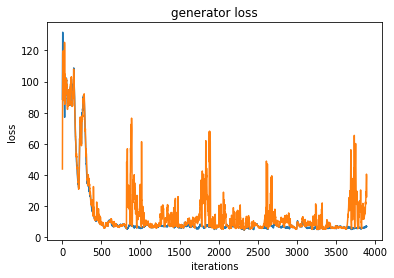

 40%|███▉      | 3999/10000 [44:35<1:05:07,  1.54it/s]

Iteration 4000/703023: dis loss = 0.1995, gen loss = 3.0258


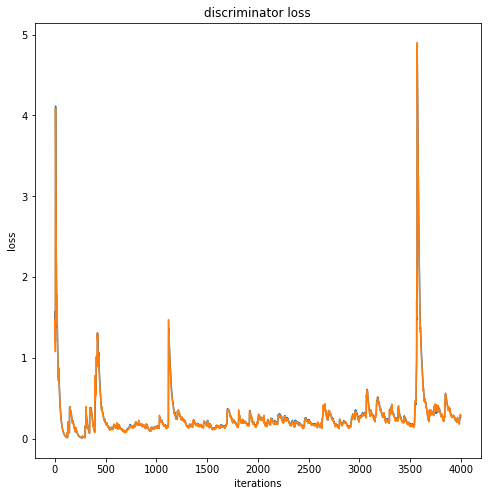

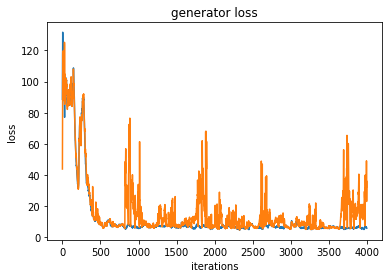

 41%|████      | 4099/10000 [45:42<1:05:33,  1.50it/s]

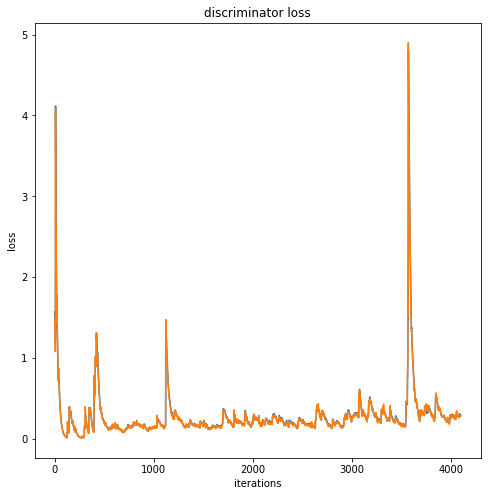

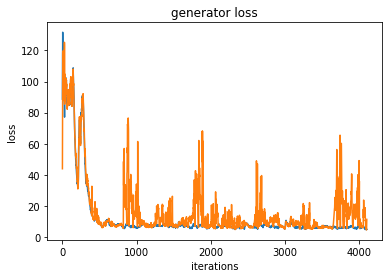

 42%|████▏     | 4199/10000 [46:48<1:03:20,  1.53it/s]

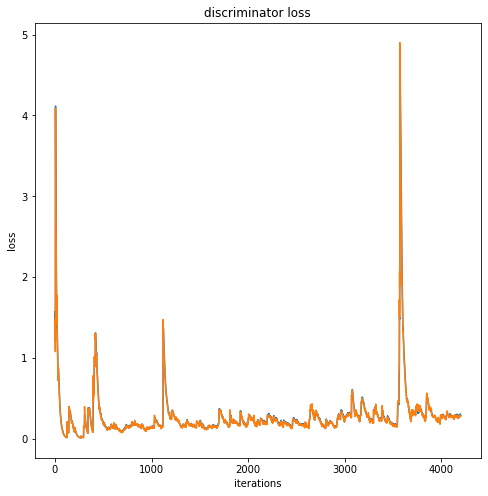

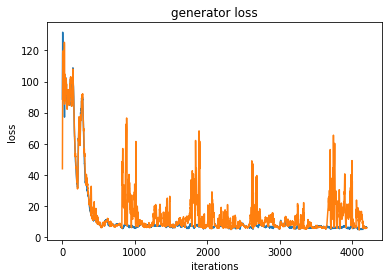

 43%|████▎     | 4299/10000 [47:54<1:02:25,  1.52it/s]

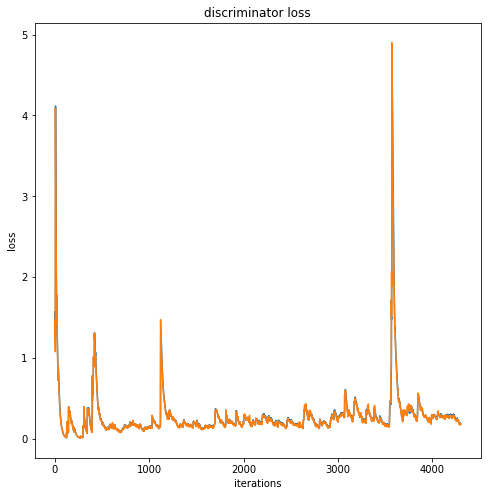

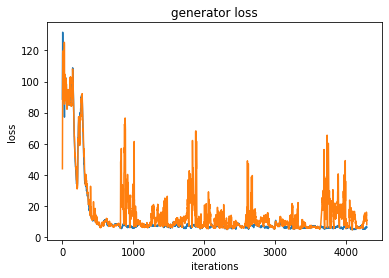

 44%|████▍     | 4399/10000 [49:01<1:00:52,  1.53it/s]

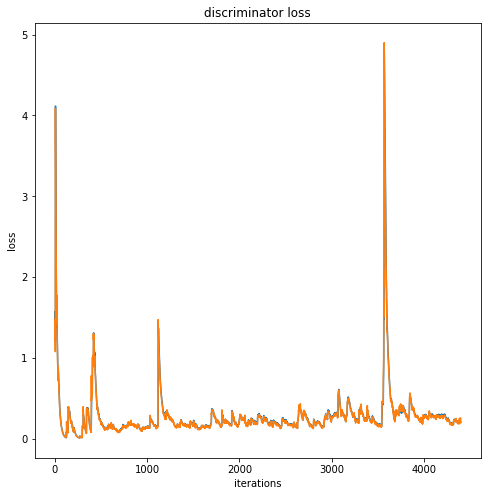

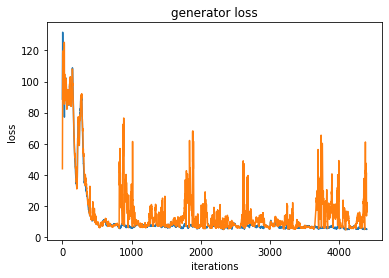

 45%|████▍     | 4499/10000 [50:09<1:00:40,  1.51it/s]

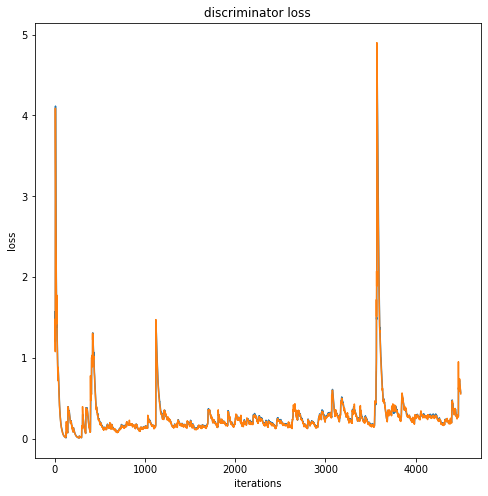

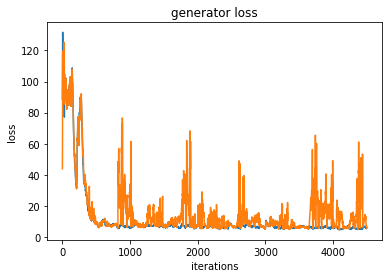

 46%|████▌     | 4599/10000 [51:17<1:03:47,  1.41it/s]

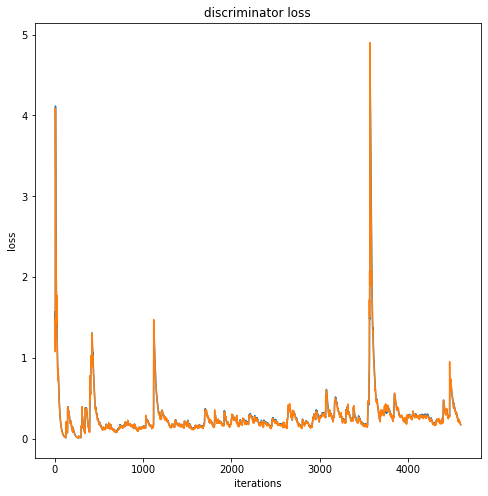

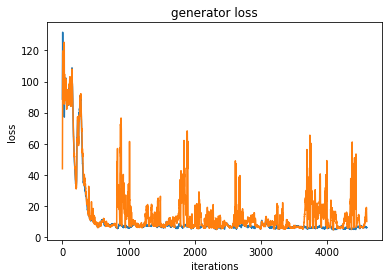

 47%|████▋     | 4699/10000 [52:23<58:21,  1.51it/s]  

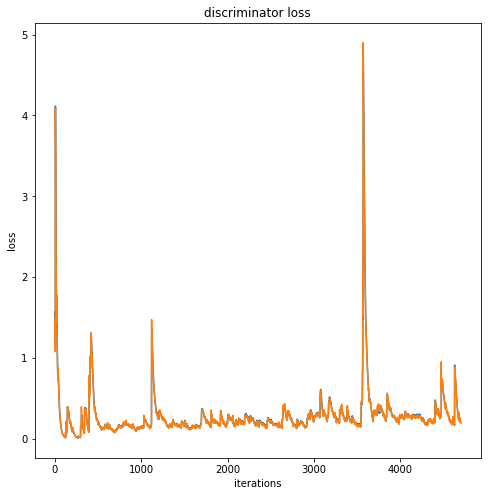

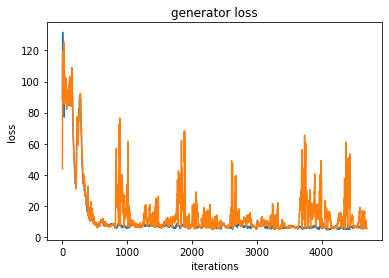

 48%|████▊     | 4799/10000 [53:29<56:21,  1.54it/s]  

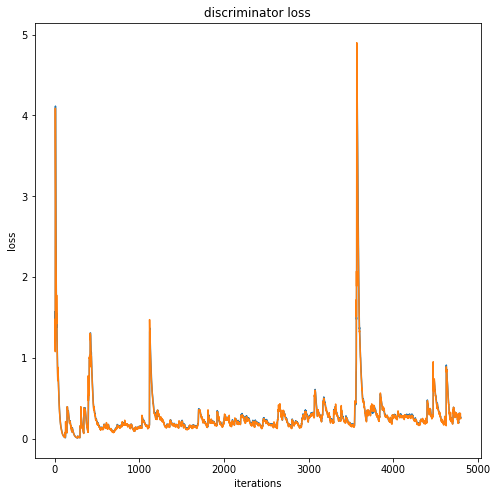

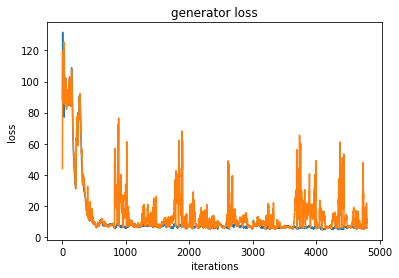

 49%|████▉     | 4899/10000 [54:35<56:24,  1.51it/s]  

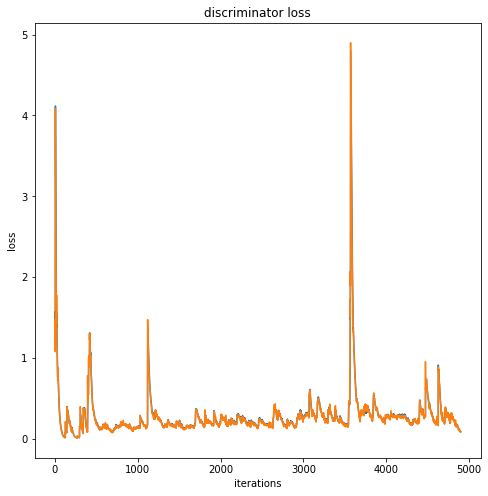

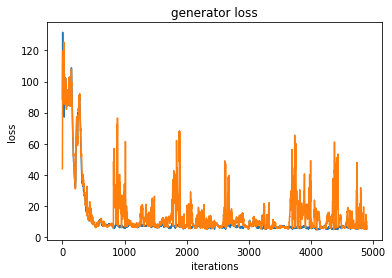

 50%|████▉     | 4999/10000 [55:42<55:50,  1.49it/s]  

Iteration 5000/703023: dis loss = 0.0790, gen loss = 1.3912


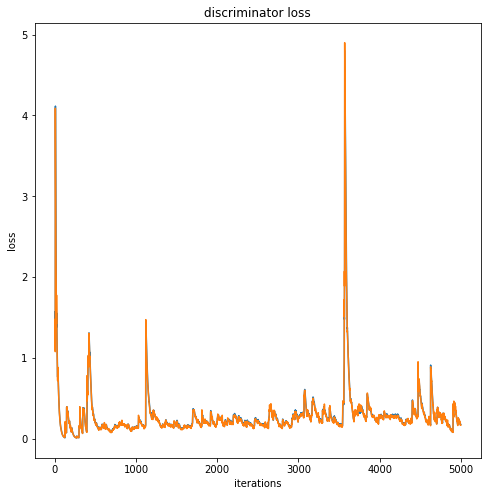

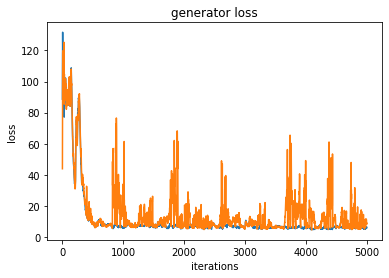

 51%|█████     | 5099/10000 [56:48<55:24,  1.47it/s]  

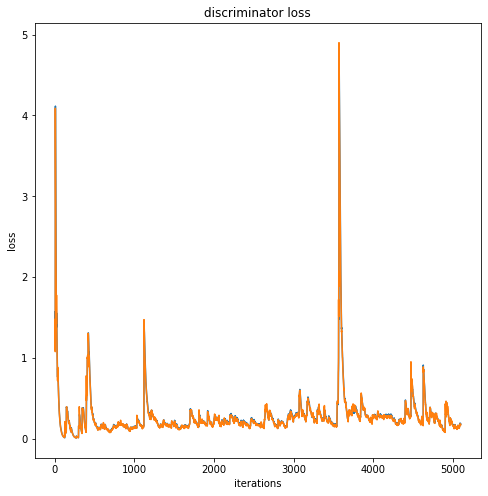

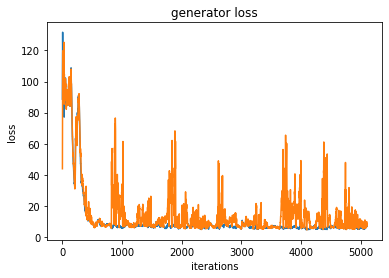

 52%|█████▏    | 5199/10000 [57:56<52:52,  1.51it/s]  

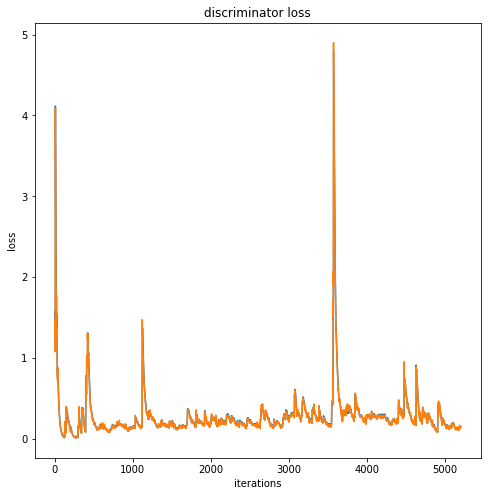

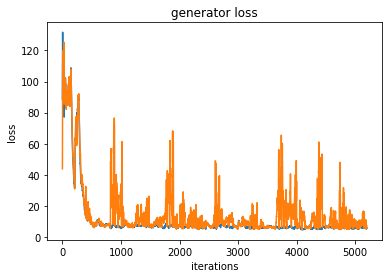

 53%|█████▎    | 5299/10000 [59:03<51:59,  1.51it/s]  

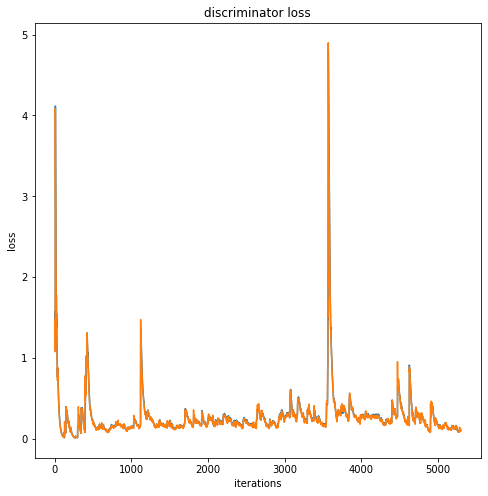

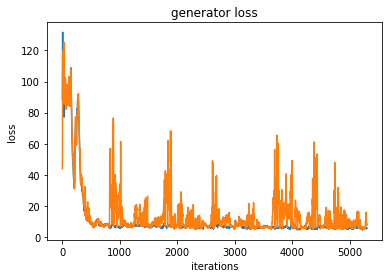

 54%|█████▍    | 5399/10000 [1:00:12<50:32,  1.52it/s]

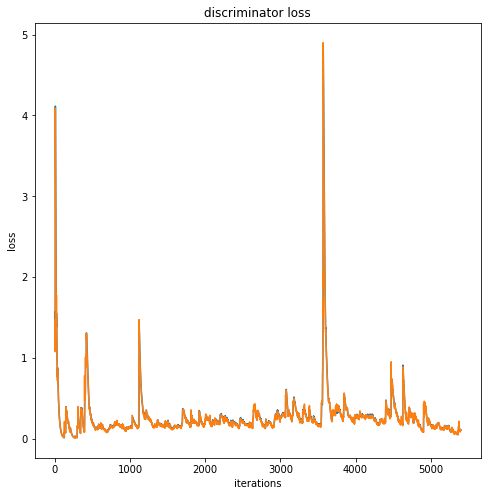

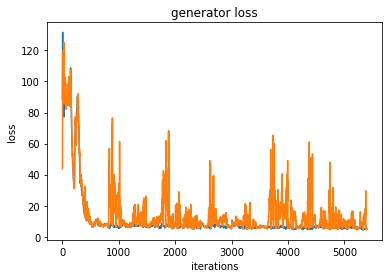

 55%|█████▍    | 5499/10000 [1:01:21<51:49,  1.45it/s]  

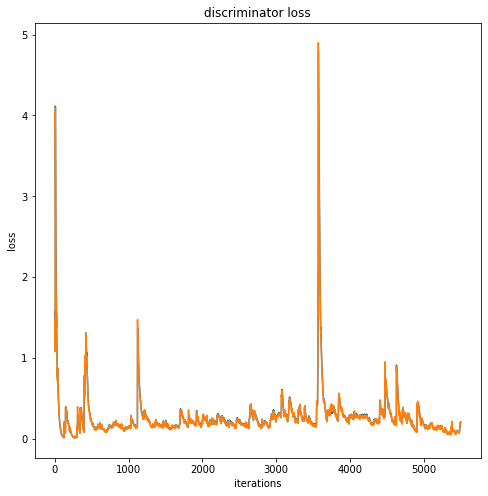

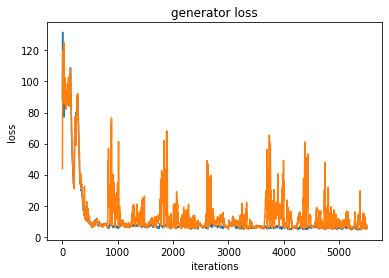

 56%|█████▌    | 5599/10000 [1:02:29<47:09,  1.56it/s]  

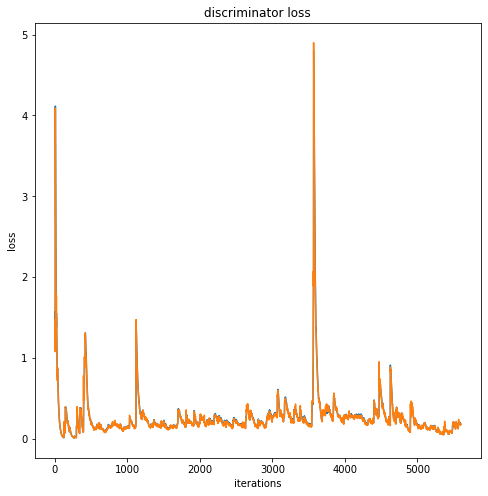

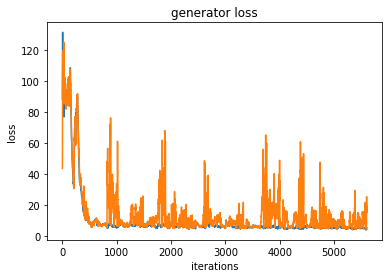

 57%|█████▋    | 5699/10000 [1:03:34<46:18,  1.55it/s]

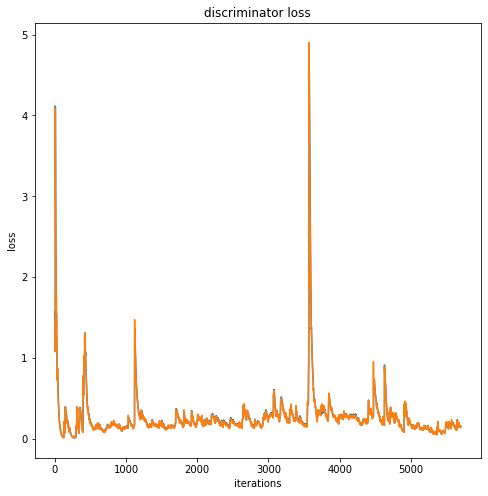

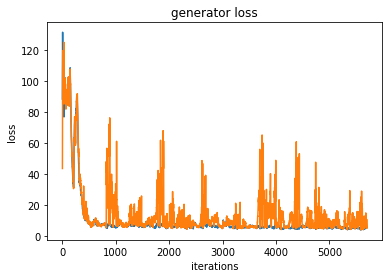

 58%|█████▊    | 5799/10000 [1:04:40<46:37,  1.50it/s]

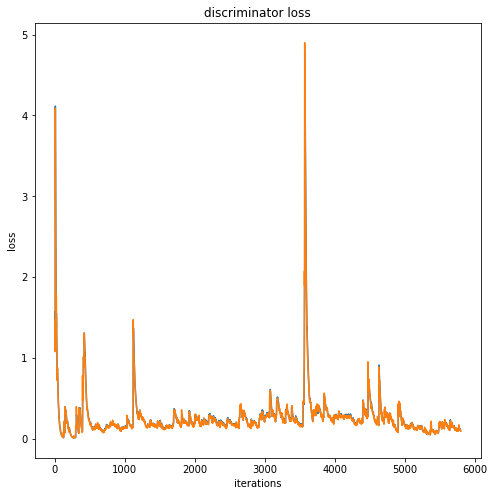

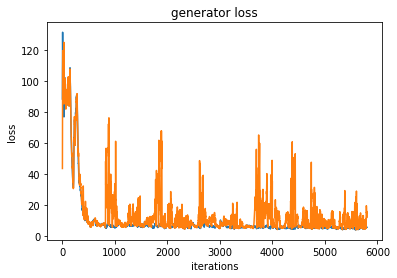

 59%|█████▉    | 5899/10000 [1:05:47<45:31,  1.50it/s]

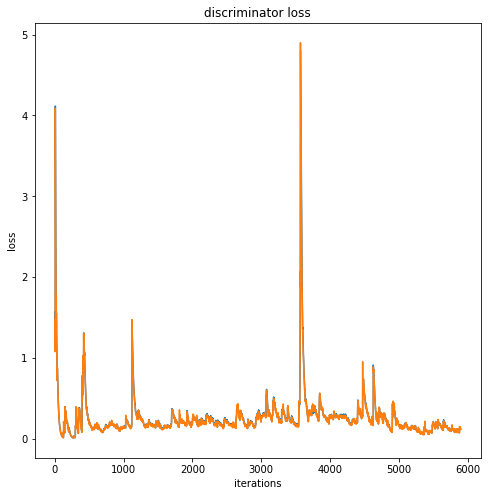

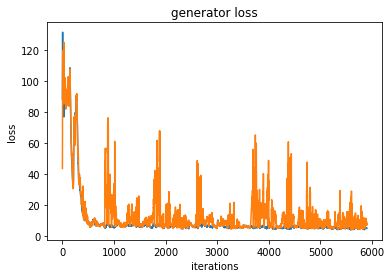

 60%|█████▉    | 5999/10000 [1:06:54<44:09,  1.51it/s]

Iteration 6000/703023: dis loss = 0.1004, gen loss = 10.7022


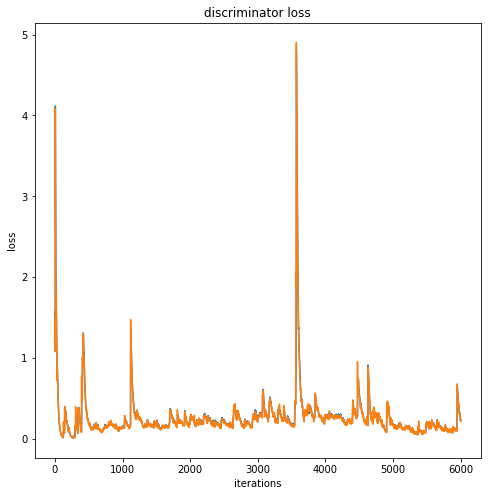

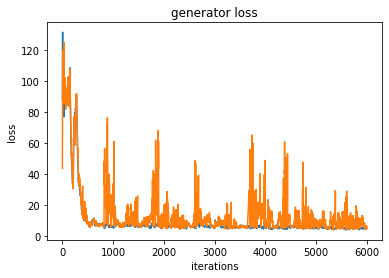

 61%|██████    | 6099/10000 [1:08:00<42:12,  1.54it/s]

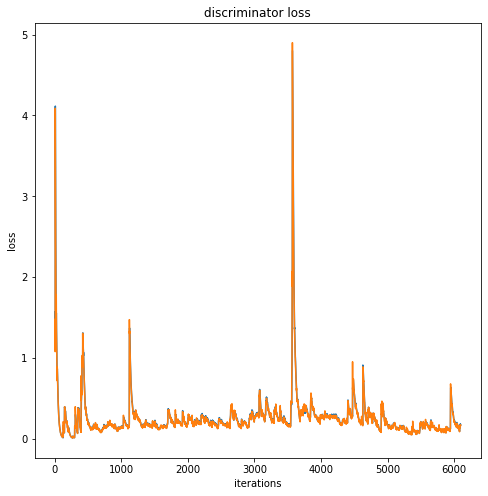

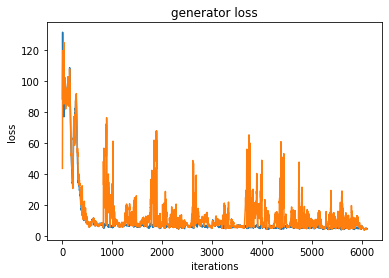

 62%|██████▏   | 6199/10000 [1:09:07<42:00,  1.51it/s]

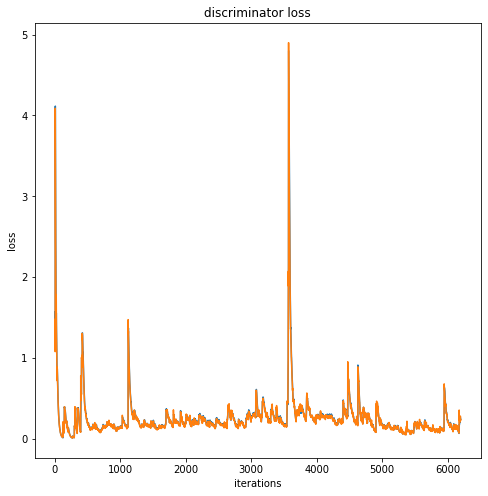

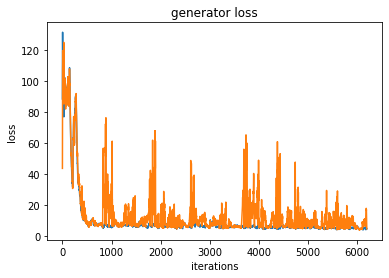

 63%|██████▎   | 6299/10000 [1:10:14<40:15,  1.53it/s]

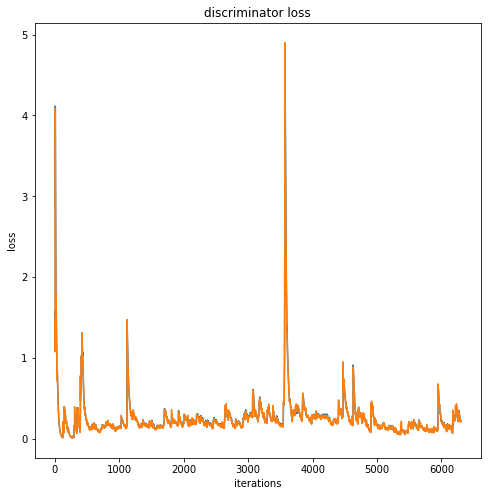

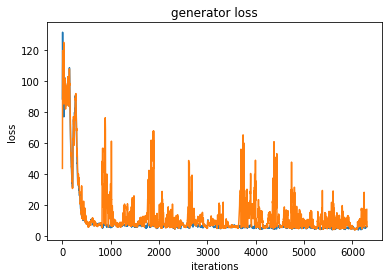

 64%|██████▍   | 6399/10000 [1:11:20<39:03,  1.54it/s]

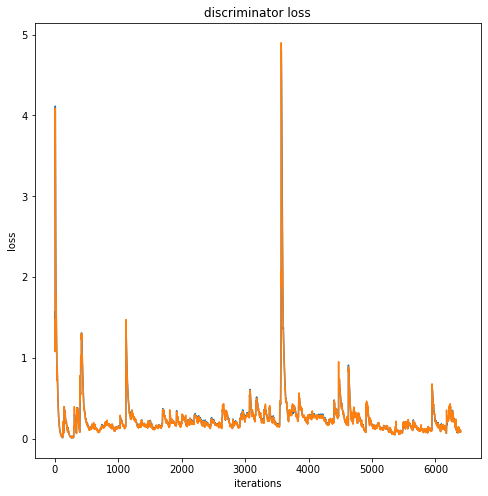

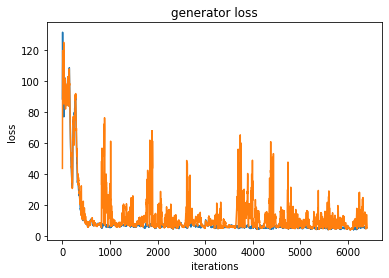

 65%|██████▍   | 6499/10000 [1:12:25<38:09,  1.53it/s]

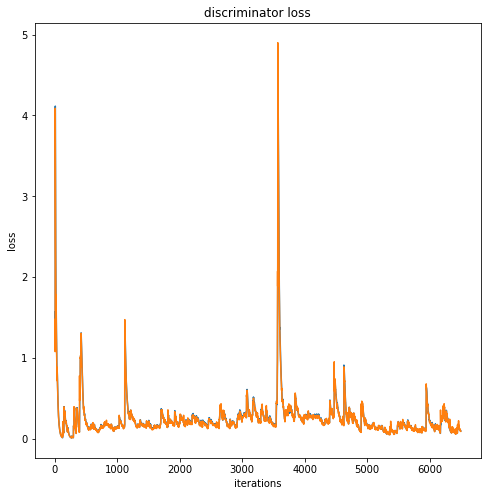

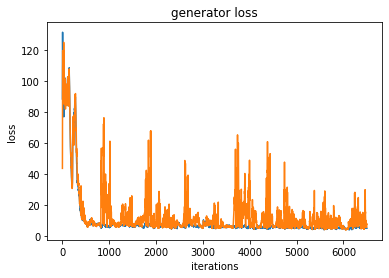

 66%|██████▌   | 6599/10000 [1:13:31<37:05,  1.53it/s]

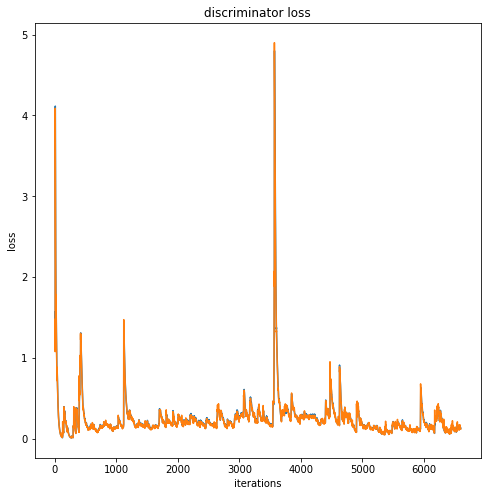

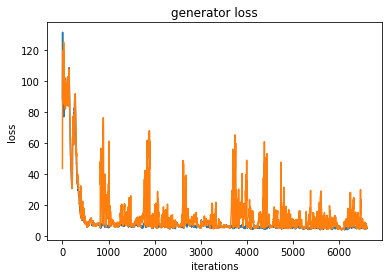

 67%|██████▋   | 6699/10000 [1:14:37<36:02,  1.53it/s]

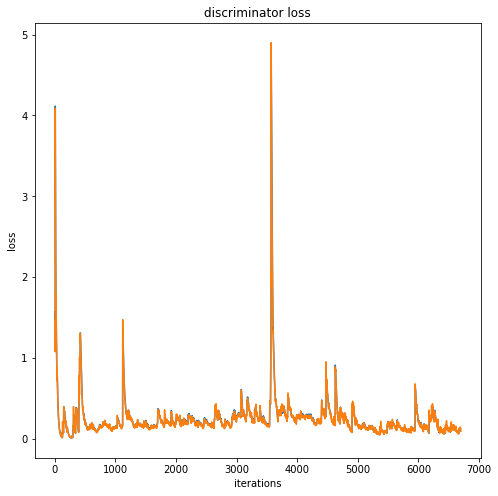

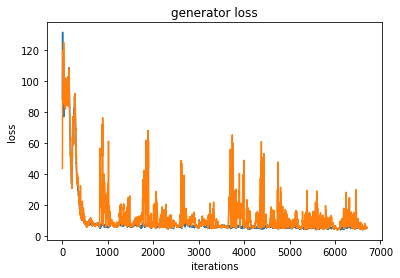

 68%|██████▊   | 6799/10000 [1:15:43<34:26,  1.55it/s]

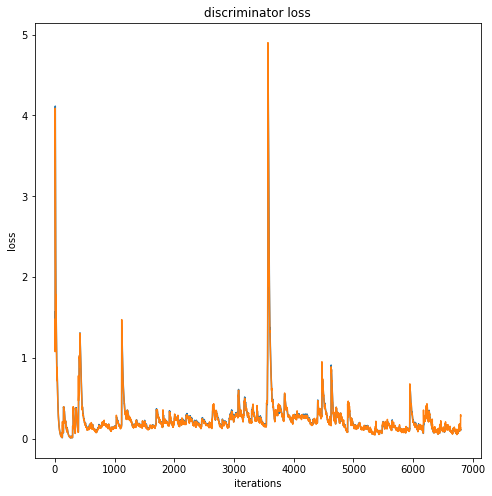

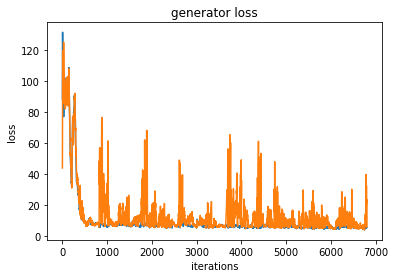

 69%|██████▉   | 6899/10000 [1:16:49<34:00,  1.52it/s]

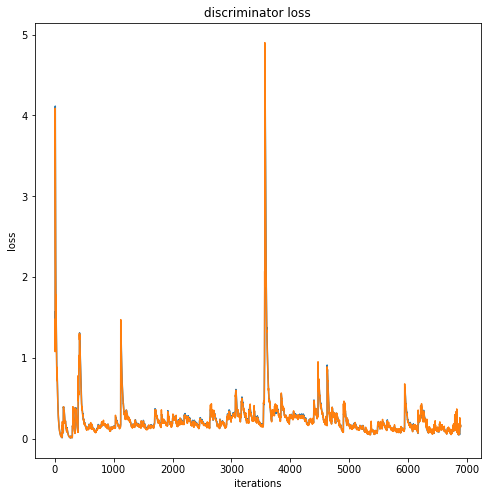

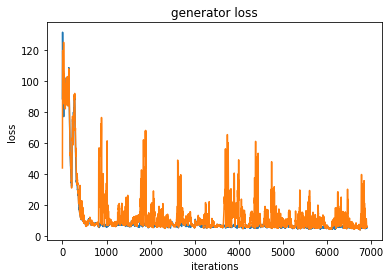

 70%|██████▉   | 6999/10000 [1:17:55<33:11,  1.51it/s]

Iteration 7000/703023: dis loss = 0.1488, gen loss = 5.9994


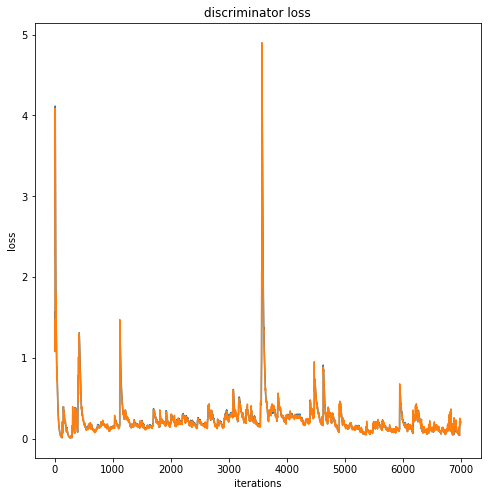

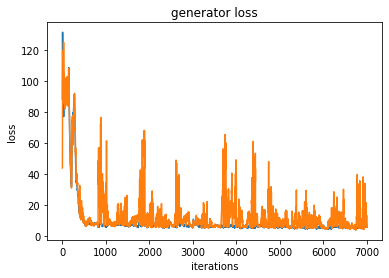

 71%|███████   | 7099/10000 [1:19:02<31:53,  1.52it/s]

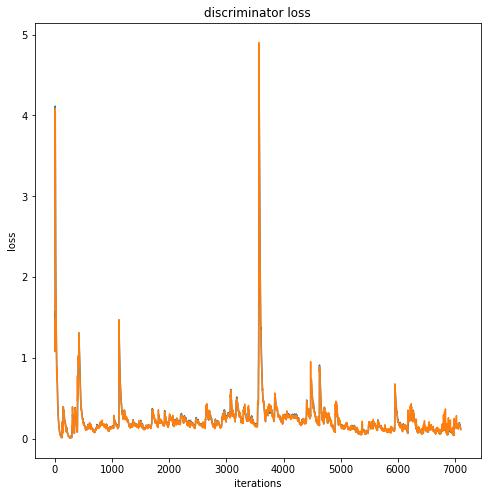

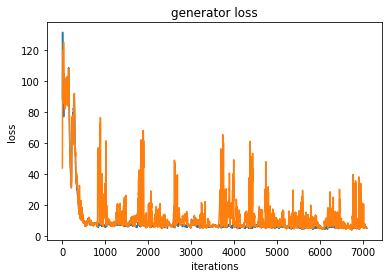

 72%|███████▏  | 7199/10000 [1:20:09<31:27,  1.48it/s]

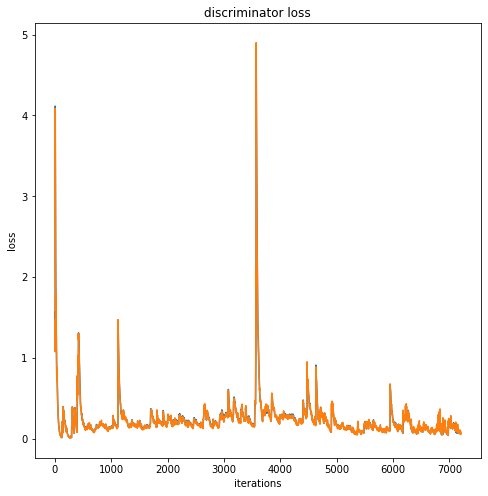

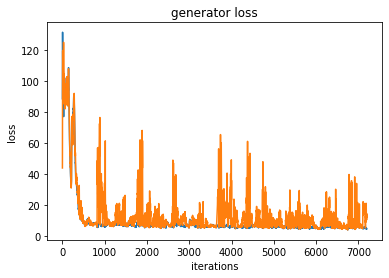

 73%|███████▎  | 7299/10000 [1:21:17<31:41,  1.42it/s]

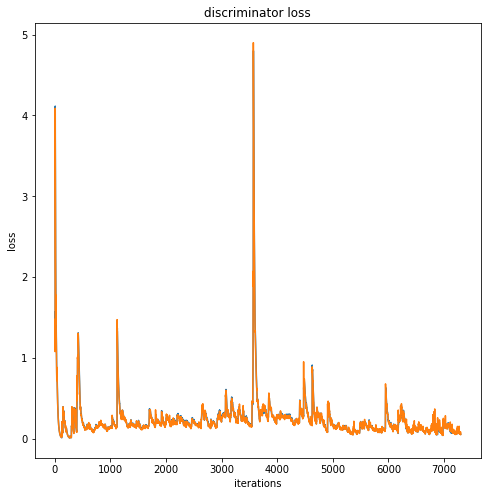

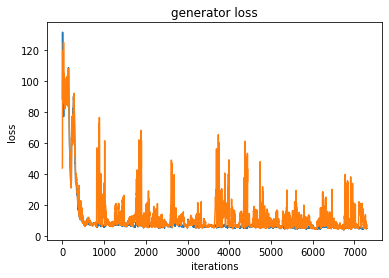

 74%|███████▍  | 7399/10000 [1:22:25<28:41,  1.51it/s]

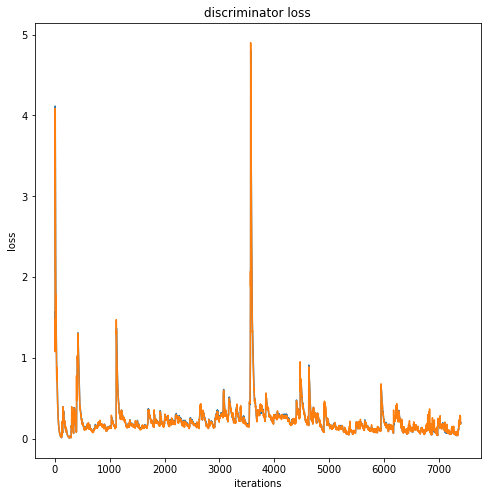

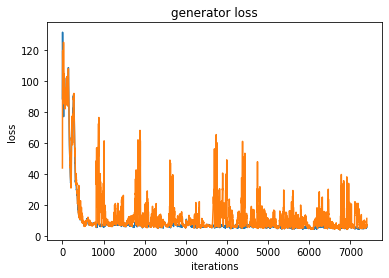

 75%|███████▍  | 7499/10000 [1:23:32<28:39,  1.45it/s]

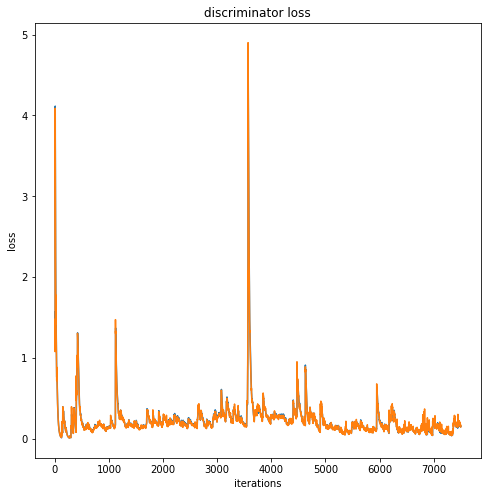

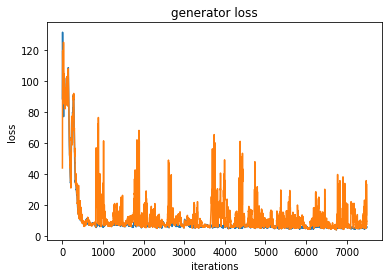

 76%|███████▌  | 7599/10000 [1:24:40<26:56,  1.49it/s]

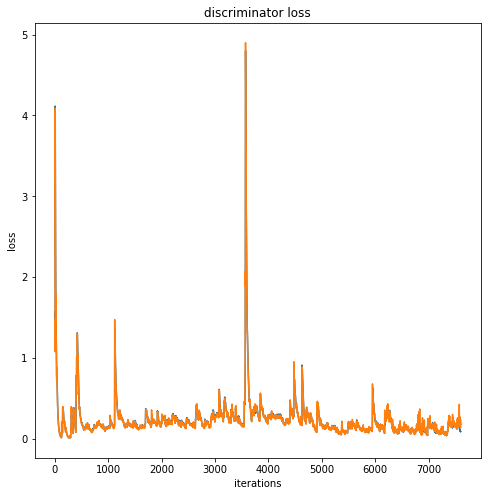

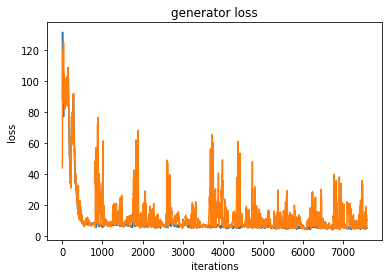

 77%|███████▋  | 7699/10000 [1:25:48<25:25,  1.51it/s]

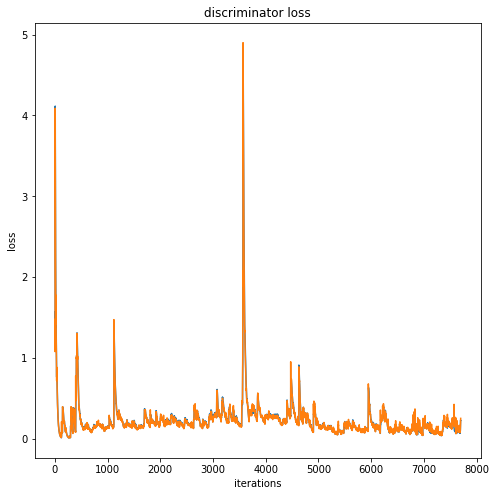

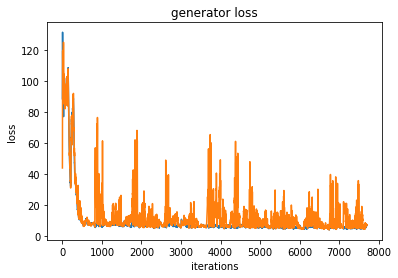

 78%|███████▊  | 7799/10000 [1:26:56<25:19,  1.45it/s]

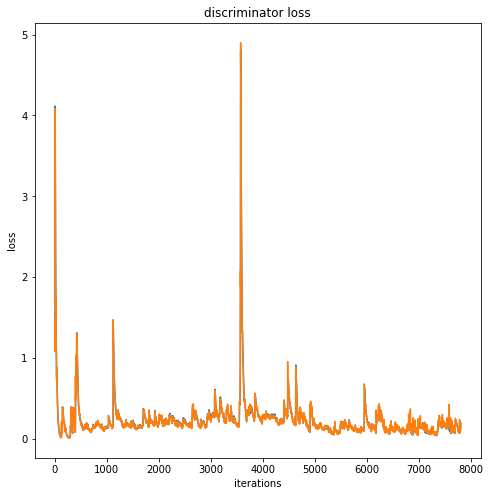

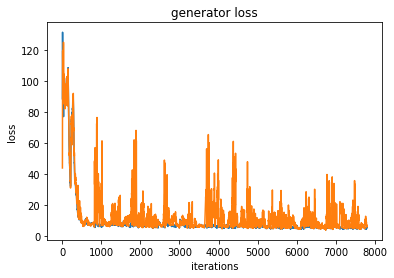

 79%|███████▉  | 7899/10000 [1:28:04<23:40,  1.48it/s]

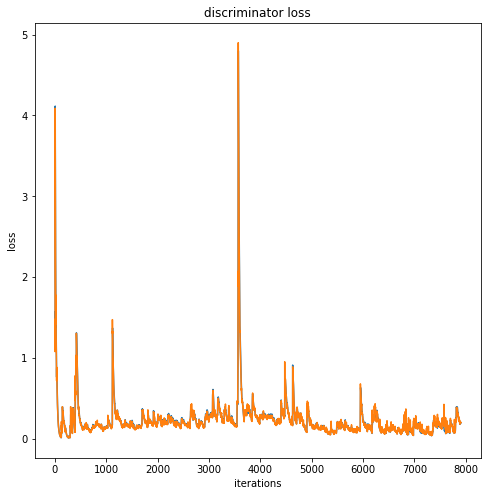

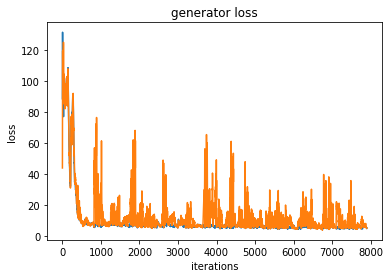

 80%|███████▉  | 7999/10000 [1:29:13<22:19,  1.49it/s]

Iteration 8000/703023: dis loss = 0.0028, gen loss = 11.3569


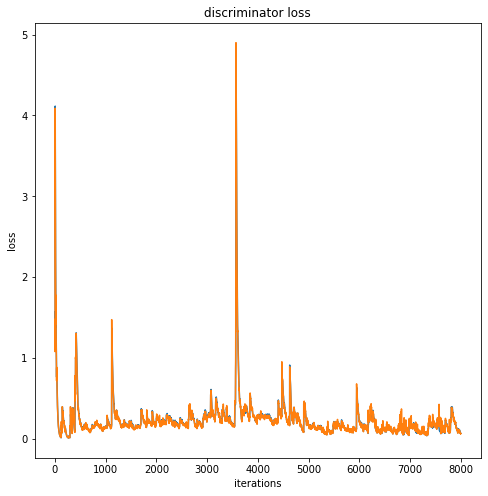

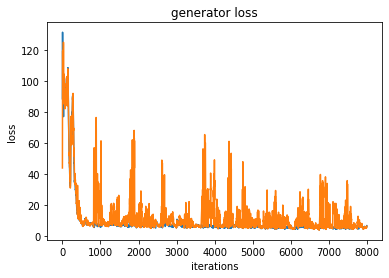

 81%|████████  | 8099/10000 [1:30:22<21:39,  1.46it/s]

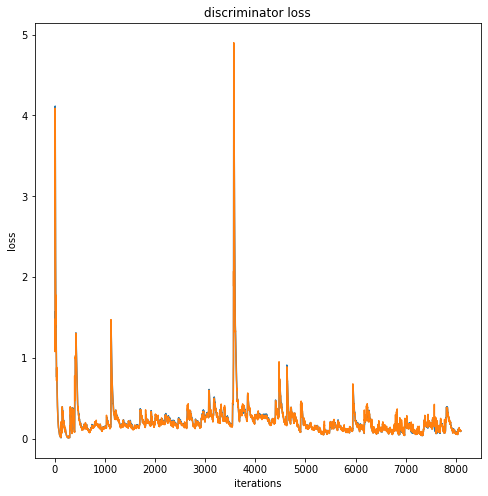

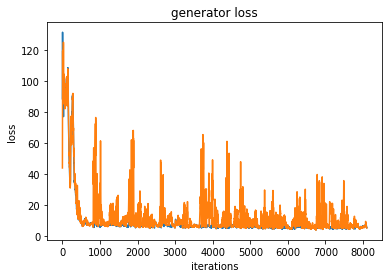

 82%|████████▏ | 8199/10000 [1:31:30<20:29,  1.46it/s]

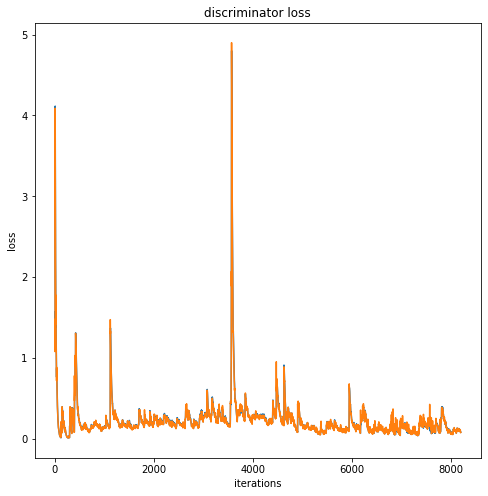

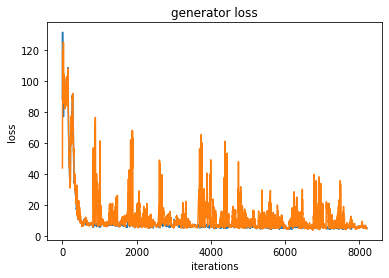

 83%|████████▎ | 8299/10000 [1:32:38<19:41,  1.44it/s]

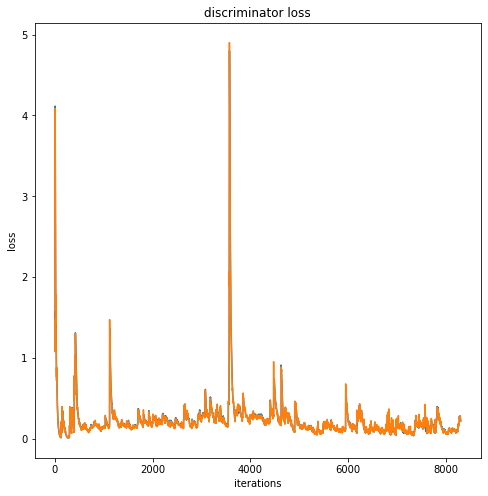

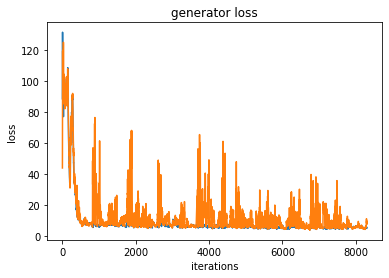

 84%|████████▍ | 8399/10000 [1:33:47<17:46,  1.50it/s]

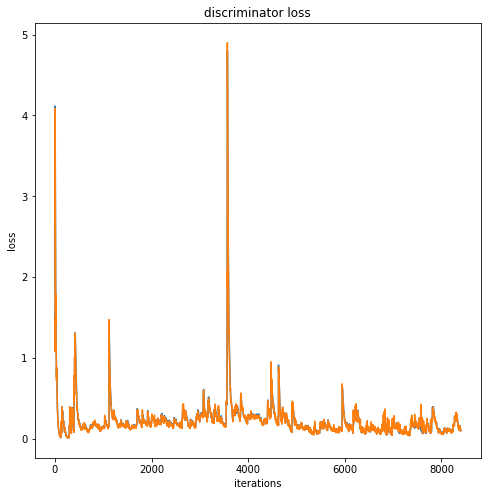

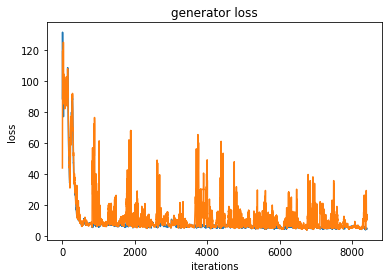

 85%|████████▍ | 8499/10000 [1:34:53<16:26,  1.52it/s]

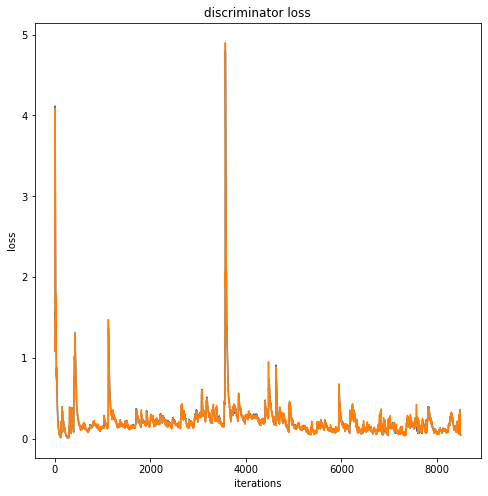

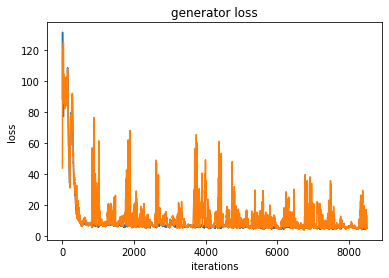

 86%|████████▌ | 8599/10000 [1:35:59<15:17,  1.53it/s]

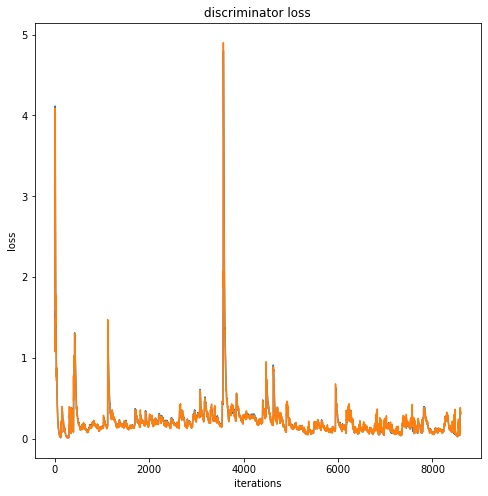

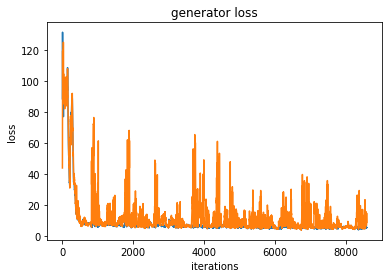

 87%|████████▋ | 8699/10000 [1:37:06<14:12,  1.53it/s]

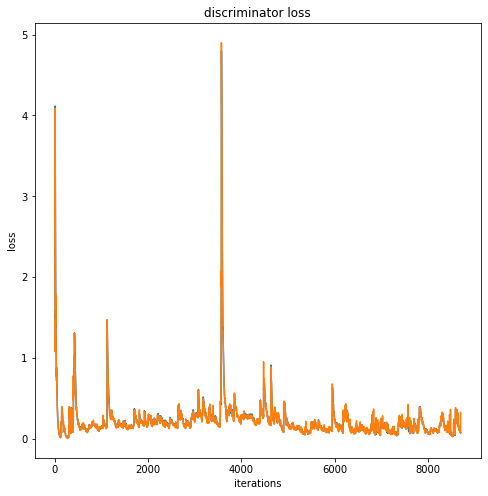

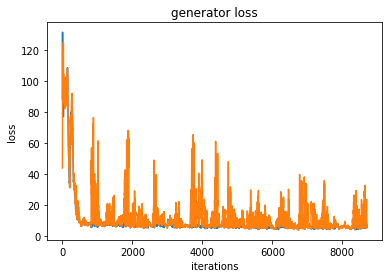

 88%|████████▊ | 8799/10000 [1:38:14<13:24,  1.49it/s]

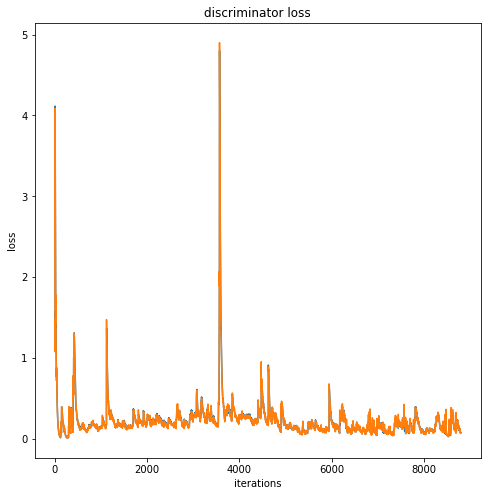

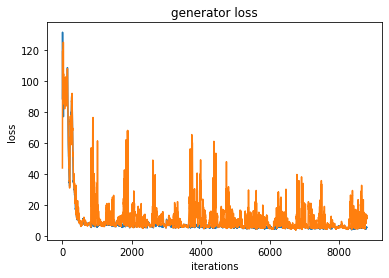

 89%|████████▉ | 8899/10000 [1:39:23<12:13,  1.50it/s]

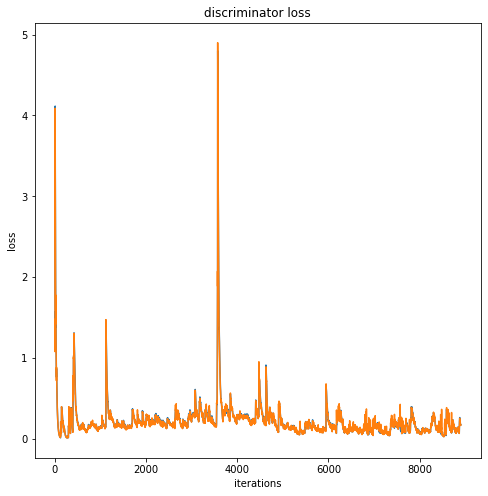

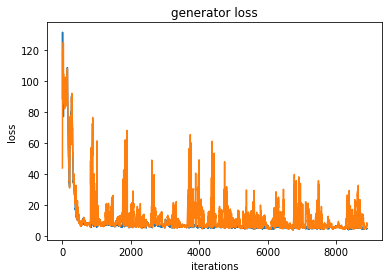

 90%|████████▉ | 8999/10000 [1:40:29<11:02,  1.51it/s]

Iteration 9000/703023: dis loss = 0.0697, gen loss = 1.8028


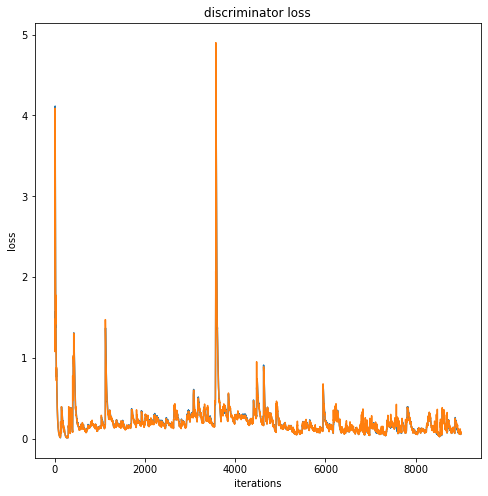

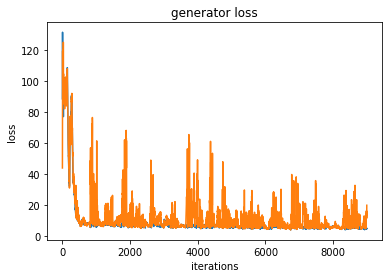

 91%|█████████ | 9099/10000 [1:41:36<10:00,  1.50it/s]

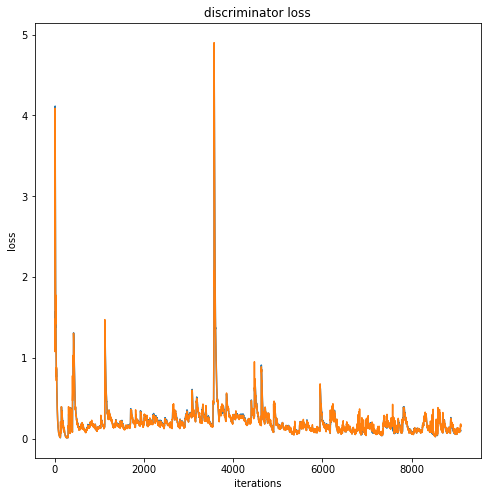

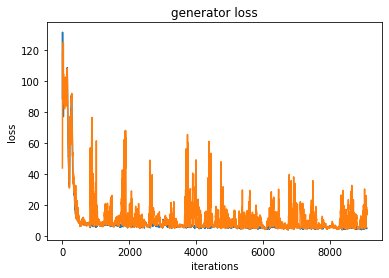

 92%|█████████▏| 9199/10000 [1:42:42<08:42,  1.53it/s]

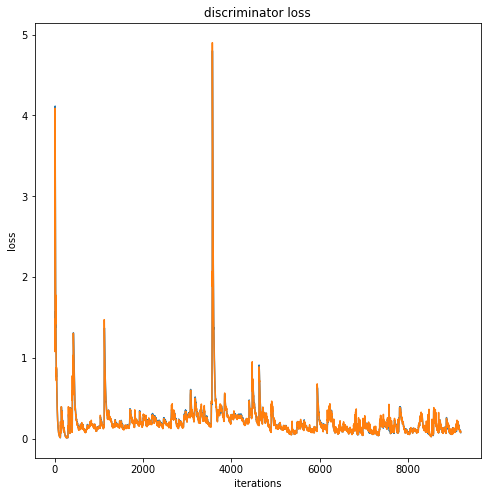

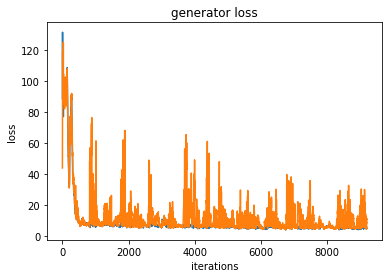

 93%|█████████▎| 9299/10000 [1:43:48<07:32,  1.55it/s]

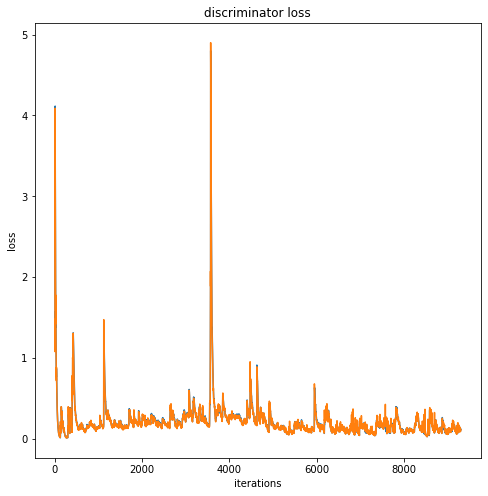

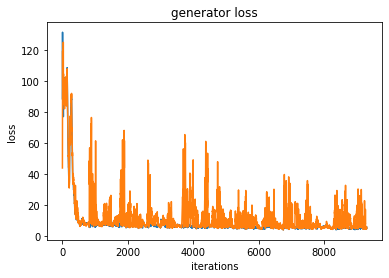

 94%|█████████▍| 9399/10000 [1:44:53<06:34,  1.52it/s]

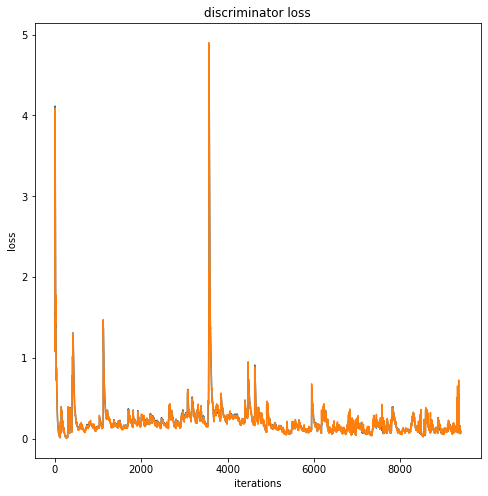

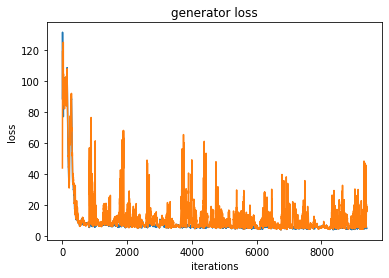

 95%|█████████▍| 9499/10000 [1:46:00<05:26,  1.53it/s]

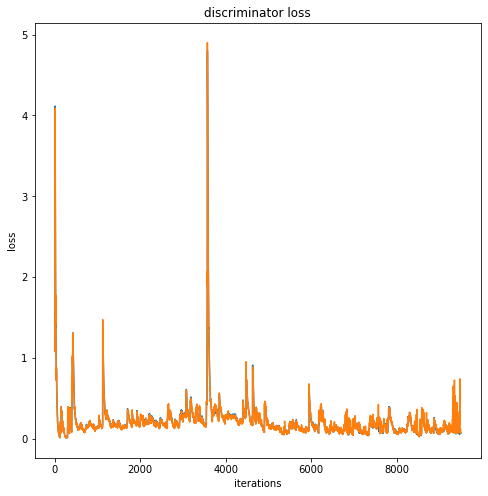

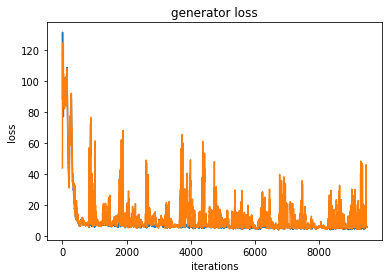

 96%|█████████▌| 9599/10000 [1:47:06<04:28,  1.50it/s]

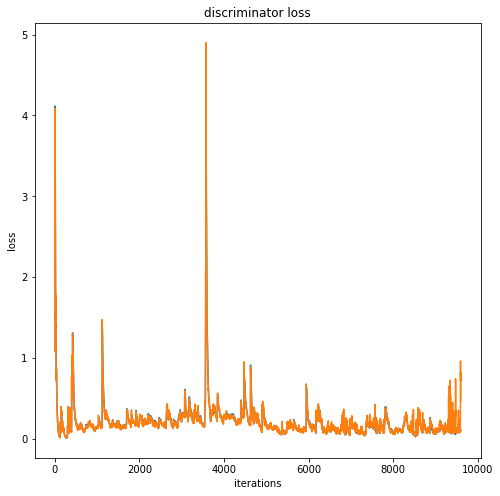

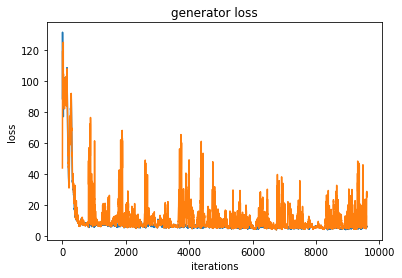

 97%|█████████▋| 9699/10000 [1:48:13<03:22,  1.49it/s]

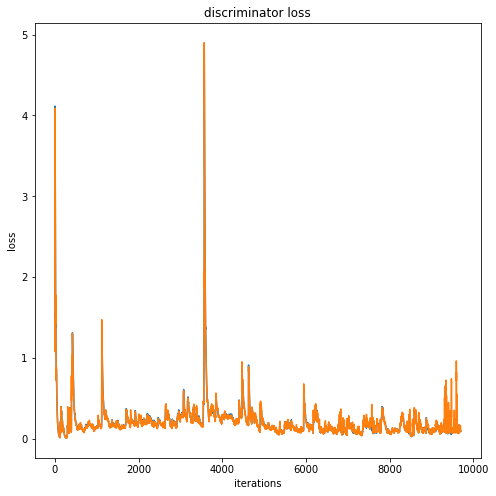

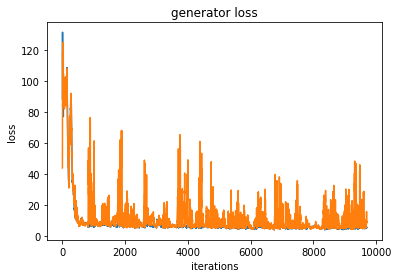

 98%|█████████▊| 9799/10000 [1:49:22<02:19,  1.44it/s]

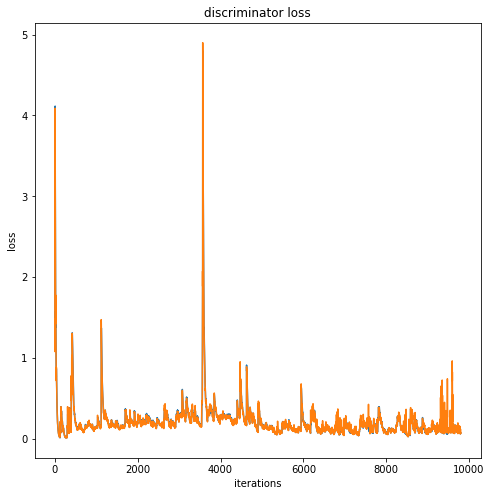

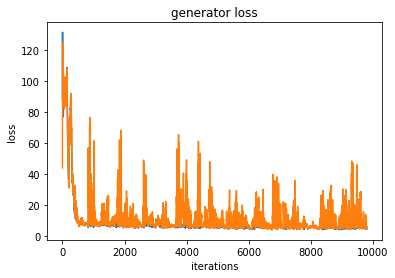

 99%|█████████▉| 9899/10000 [1:50:30<01:06,  1.51it/s]

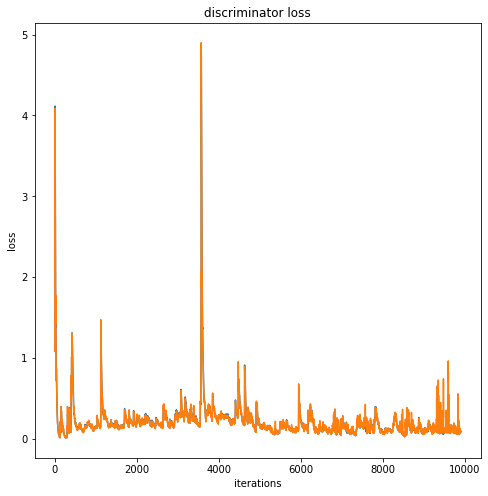

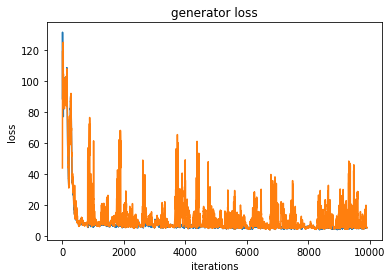

100%|█████████▉| 9999/10000 [1:51:37<00:00,  1.50it/s]

Iteration 10000/703023: dis loss = 0.1224, gen loss = 1.2827


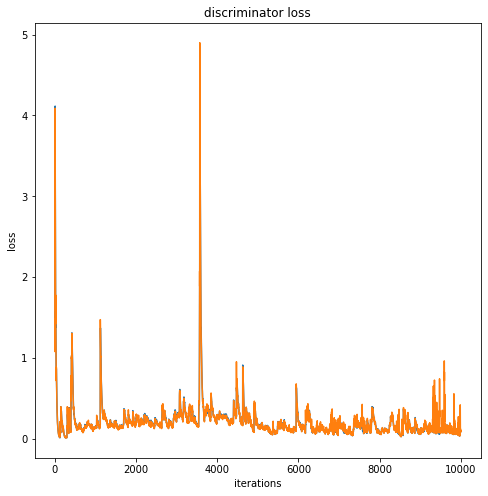

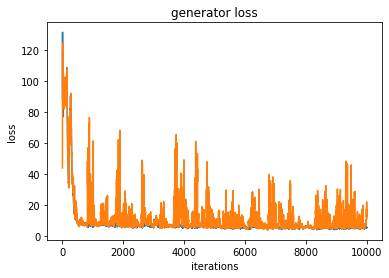

  0%|          | 0/10000 [00:00<?, ?it/s]

Start training ...


  1%|          | 99/10000 [01:15<1:52:31,  1.47it/s]

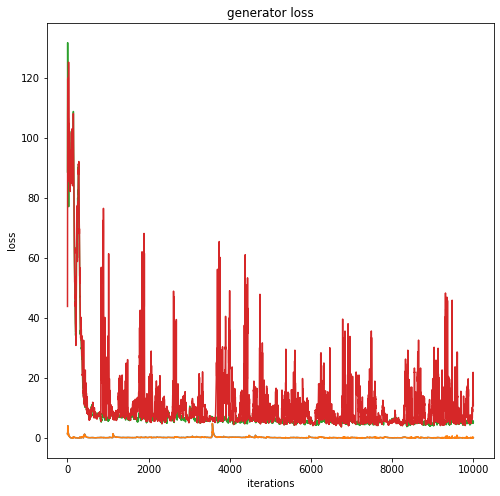

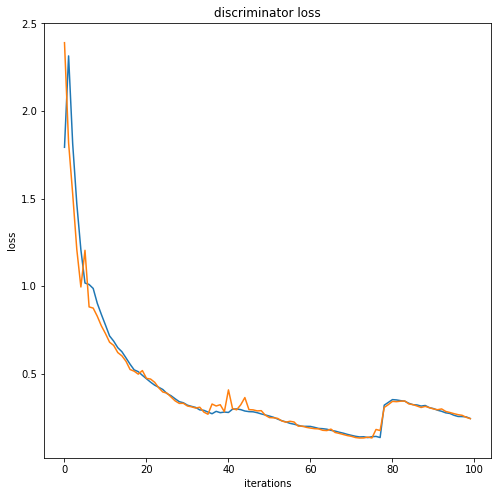

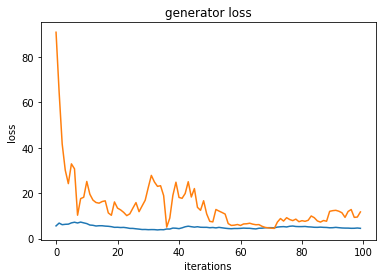

  2%|▏         | 199/10000 [02:25<1:51:20,  1.47it/s]

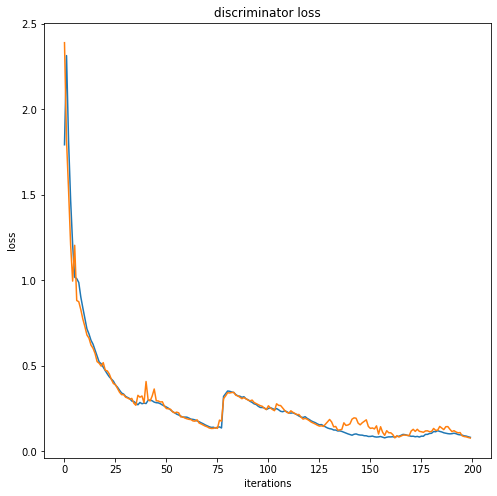

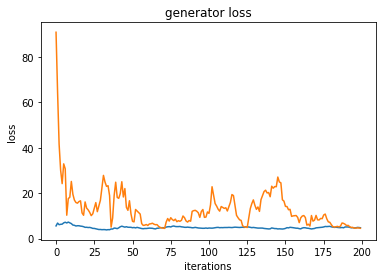

  3%|▎         | 299/10000 [03:35<1:54:05,  1.42it/s]

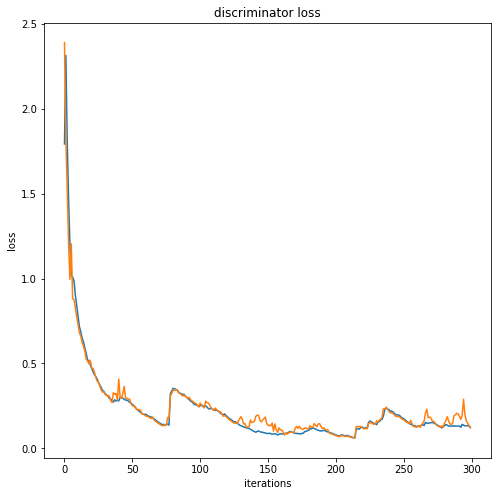

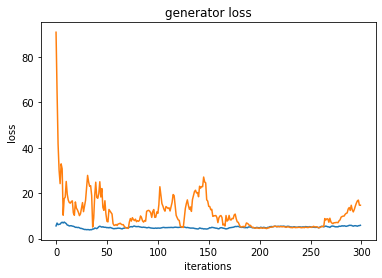

  4%|▍         | 399/10000 [04:44<1:45:43,  1.51it/s]

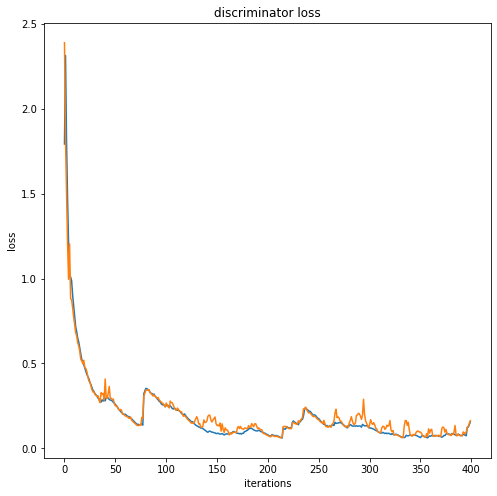

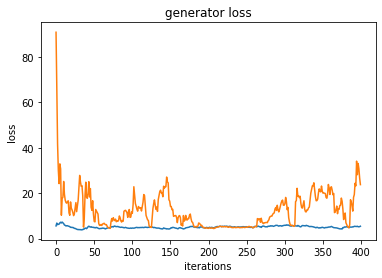

  5%|▍         | 499/10000 [05:52<1:45:09,  1.51it/s]

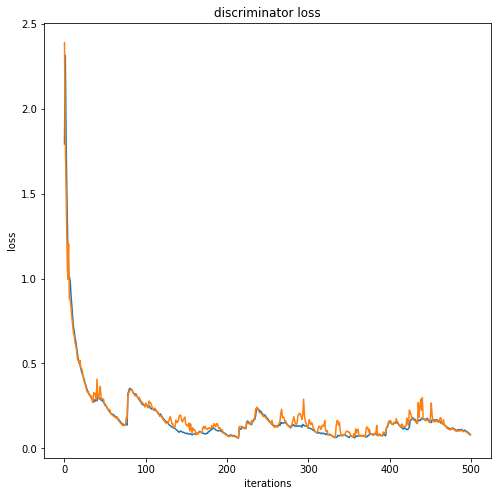

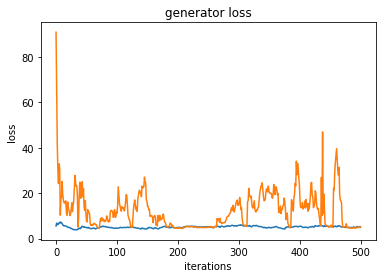

  6%|▌         | 599/10000 [06:58<1:41:29,  1.54it/s]

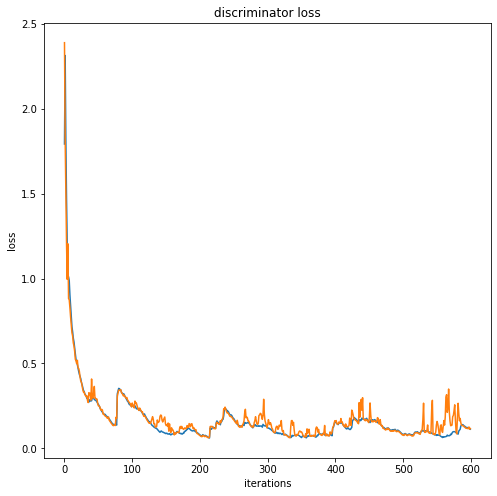

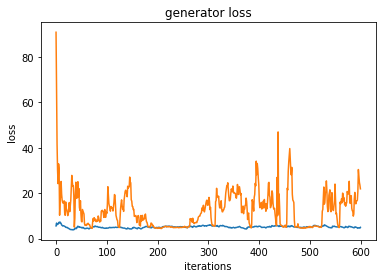

  7%|▋         | 699/10000 [08:06<1:42:32,  1.51it/s]

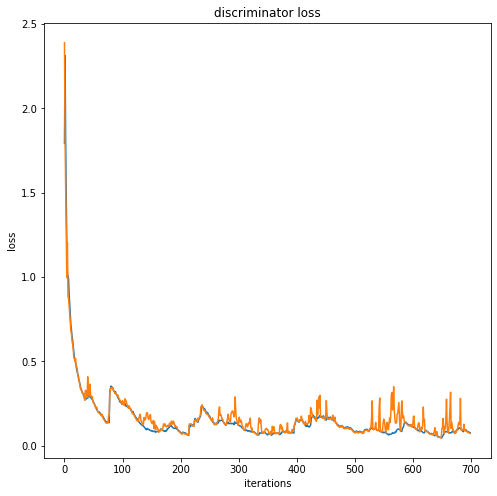

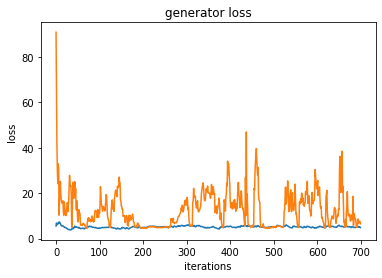

  8%|▊         | 799/10000 [09:14<1:44:42,  1.46it/s]

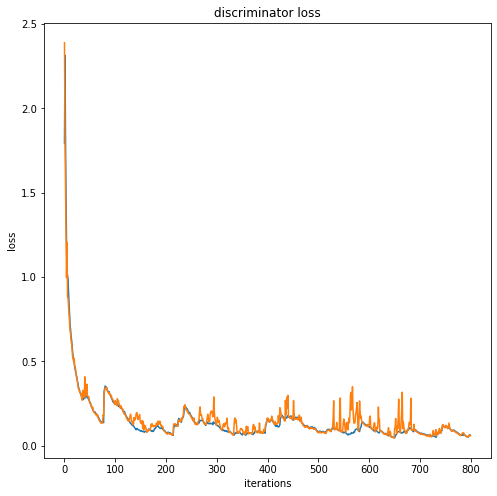

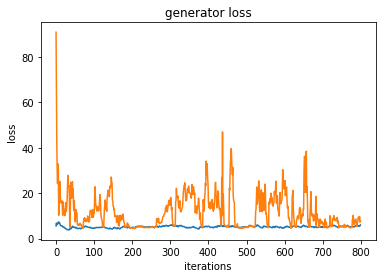

  9%|▉         | 899/10000 [14:46<1:48:57,  1.39it/s]  

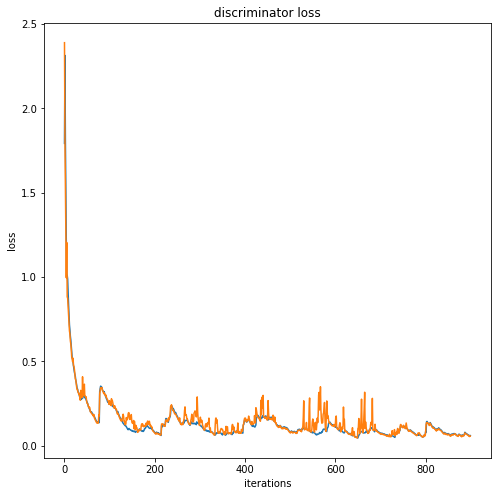

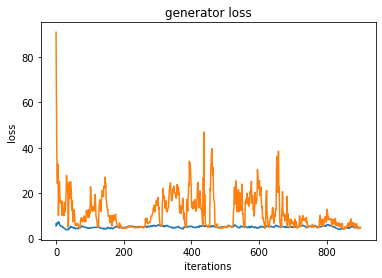

 10%|▉         | 995/10000 [16:00<1:49:13,  1.37it/s]

In [ ]:
gan = GAN()
gan(train_dataloader)

# Evaluation on the test set

In [14]:
def calculate_MSE_loss(predicted, targets, availabilities, num_iter = 1000):
    loss = nn.MSELoss(reduction = 'mean')
    
    predicted_ = torch.stack(predicted)
    targets_ = torch.stack(targets)
    availabilities_ = torch.stack(availabilities)
    availabilities_ = availabilities_.view(-1, 32, 50, 1)
    loss_temp = loss(predicted_ * availabilities_, targets_ * availabilities_)
    iter_loss = (num_iter, loss_temp)
    return iter_loss

In [15]:
def test(ganModel):    
    future_coords_offsets_pd = []
    real_target = []
    target_availabilities = []
    timestamps = []
    agent_ids = []
    test_losses = []
    num_iter = 1

    # Start testing
    with torch.no_grad():
        # load test set        
        dataiter = tqdm(test_dataloader)

        for data in dataiter:
            history_positions = torch.flip(data['history_positions'], [1]).to(device)
            real_target.append(data["target_positions"])
            target_availabilities.append(data["target_availabilities"])


            # Set the generator to evaluation mode, to make batchnorm stats stay fixed
            ganModel._generator.eval()
            future_coords_offsets_pd.append(ganModel._generator(history_positions))
            
            # Test on first 1000 batches            
            if num_iter % 1000 == 0 :
                iter_loss = calculate_MSE_loss(future_coords_offsets_pd, real_target, target_availabilities)
                test_losses.append(iter_loss)
                print("iteration: ", iter_loss[0], ", loss: ", iter_loss[1])
                break
            num_iter += 1
    # Save the result
    torch.save(future_coords_offsets_pd, save_path + "ganv2_future_all.pt")
    torch.save(real_target, save_path + "ganv2_target_all.pt")
    torch.save(target_availabilities, save_path + "ganv2_t_avail_all.pt")
    torch.save(timestamps, save_path + "ganv2_timestamps_all.pt")
    torch.save(agent_ids, save_path + "ganv2_ids_all.pt")

    # Calculate MSE Loss
    avg_loss = calculate_MSE_loss(future_coords_offsets_pd, real_target, target_availabilities, num_iter - 1)
    test_losses.append(avg_loss)
    print("MSE on the test set: ", avg_loss)

# Load model saved

In [16]:
ganModel = GAN()
ganModel.load_state_dict(torch.load(save_path + "gan_v2_0.pt"))
ganModel

GAN(
  (_l2_loss): MSELoss()
  (_discriminator): Discriminator(
    (fc): Sequential(
      (0): Linear(in_features=6400, out_features=3200, bias=True)
      (1): BatchNorm1d(3200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01, inplace=True)
      (3): Dropout(p=0.5, inplace=False)
      (4): Linear(in_features=3200, out_features=1600, bias=True)
      (5): BatchNorm1d(1600, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (6): LeakyReLU(negative_slope=0.01, inplace=True)
      (7): Dropout(p=0.5, inplace=False)
      (8): Linear(in_features=1600, out_features=800, bias=True)
      (9): BatchNorm1d(800, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.01, inplace=True)
      (11): Dropout(p=0.5, inplace=False)
      (12): Linear(in_features=800, out_features=1, bias=True)
    )
    (lstm): LSTM(2, 128, batch_first=True)
  )
  (_generator): Generator(
   

## test lr=1e-3

In [33]:
test(ganModel)

  1%|          | 999/185990 [03:10<9:13:34,  5.57it/s] 

iteration:  1000 , loss:  tensor(2.5579)


  1%|          | 999/185990 [03:11<9:50:27,  5.22it/s]

MSE on the test set:  (999, tensor(2.5579))


## test lr=1e-4

In [15]:
test(ganModel)

  1%|          | 999/185990 [03:06<10:05:19,  5.09it/s]

iteration:  1000 , loss:  tensor(2.1463)


  1%|          | 999/185990 [03:07<9:37:38,  5.34it/s] 


MSE on the test set:  (999, tensor(2.1463))


## test lr=5e-3

In [18]:
test(ganModel)

  1%|          | 999/185990 [03:19<12:06:27,  4.24it/s]

iteration:  1000 , loss:  tensor(2.5574)


  1%|          | 999/185990 [03:20<10:17:27,  4.99it/s]

MSE on the test set:  (999, tensor(2.5574))


# Check diversity

In [40]:
import pandas as pd

def make_N_samples(ganModel, n=100):
    future_coords_offsets_pd = []
    real_target = []
    target_availabilities = []
    timestamps = []
    agent_ids = []
    test_losses = []
    num_iter = 1
    loss = nn.MSELoss(reduction = 'mean')
    test_df = pd.DataFrame()
    batch_size = 32

    with torch.no_grad():
        dataiter = tqdm(test_dataloader)

        # GET DATA
        for i, data in enumerate(dataiter):
            if i == 0:
                history_positions = torch.flip(data['history_positions'], [1]).to(device)
                real_target.append(data["target_positions"])
                target_availabilities.append(data["target_availabilities"])
            else:
                break

        # RUN 100 ITER on 1 BATCH
        for j in range(n):
            ganModel._generator.eval()
            real_target  = ganModel._generator(history_positions)

            batch_size = real_target.shape[0]
            time_length = real_target.shape[1]


            for q in range(batch_size):
                for t in range(time_length):
                    dic = {  
                        'agent_id': q,
                        't' : t,
                        'target_x' : data["target_positions"][q,t,0].numpy(),
                        'target_y' : data["target_positions"][q,t,1].numpy(),
                        'predict_x' : real_target[q,t,0].numpy(),
                        'predict_y' : real_target[q,t,1].numpy(),
                        'avail' : data["target_availabilities"][q,t].numpy()
                    }
                    if dic['avail'] == 1:
                        dic['loss'] = (dic['target_x'] - dic['predict_x']) ** 2 + (dic['target_y'] - dic['predict_y']) ** 2
                    else:
                        dic['loss'] = 0
                    test_df = test_df.append(dic, ignore_index = True)         
            print("j th iter: ", j)
        return(test_df)  

In [42]:
# save to csv file
test_df = make_N_samples(ganModel, 10)
test_df.to_csv(save_path + 'test_df_bdl.csv', index = False)

  0%|          | 1/185990 [00:00<40:57:34,  1.26it/s]


j th iter:  0
j th iter:  1
j th iter:  2
j th iter:  3
j th iter:  4
j th iter:  5
j th iter:  6
j th iter:  7
j th iter:  8
j th iter:  9


# test result on 1000 iteration with 1 epoch, lr= 1e-3

In [55]:
avg_loss = calculate_MSE_loss(future_coords_offsets_pd, real_target, target_availabilities)
test_losses.append(avg_loss)
print("MSE on the test set: ", avg_loss)

MSE on the test set:  (1000, tensor(2.6551))


# training with two epochs, Relu in discriminator, lr=1e-3

  0%|          | 0/10000 [00:00<?, ?it/s]

Start training ...


/Users/seongohryoo/anaconda3/envs/tensorflow/lib/python3.6/site-packages/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
  1%|          | 99/10000 [02:23<4:18:19,  1.57s/it]

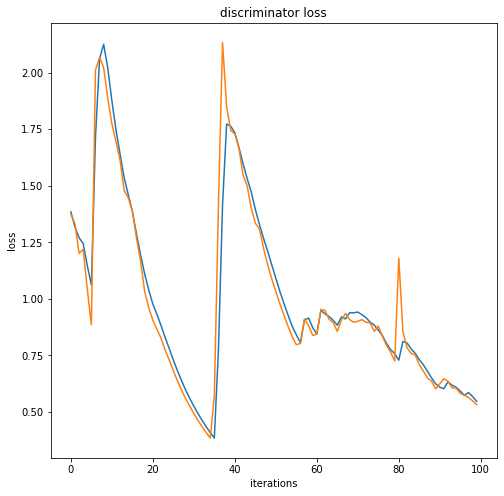

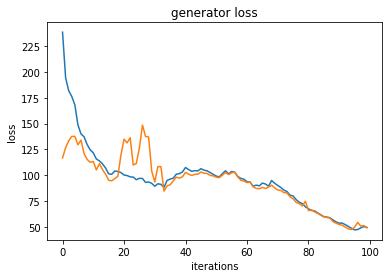

  2%|▏         | 199/10000 [05:03<4:14:41,  1.56s/it]

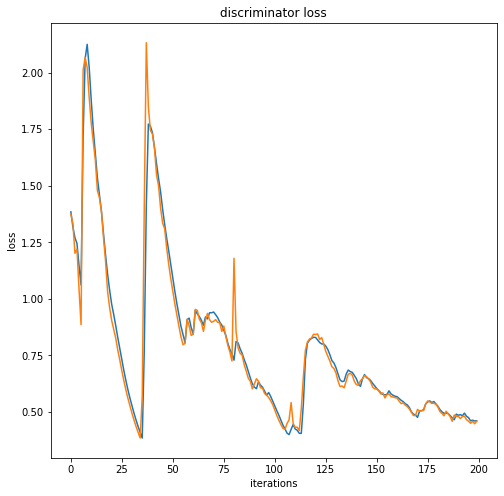

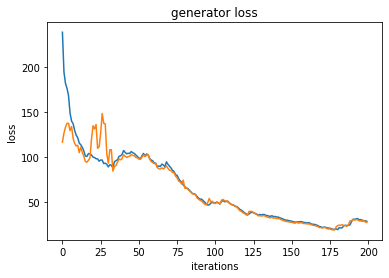

  3%|▎         | 299/10000 [07:36<4:02:46,  1.50s/it]

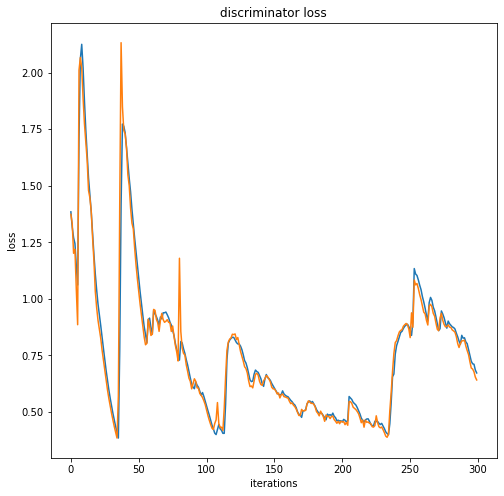

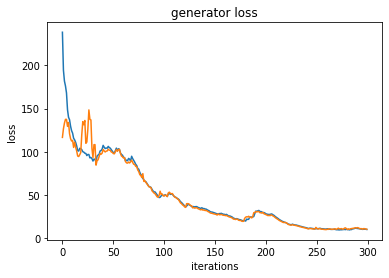

  4%|▍         | 399/10000 [10:07<3:38:40,  1.37s/it]

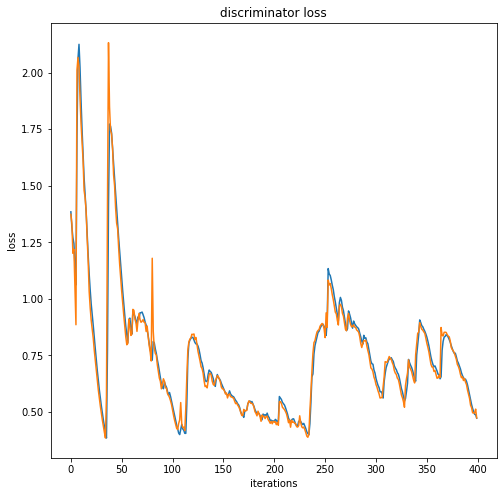

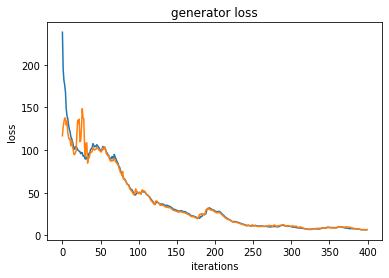

  5%|▍         | 499/10000 [12:29<3:50:12,  1.45s/it]

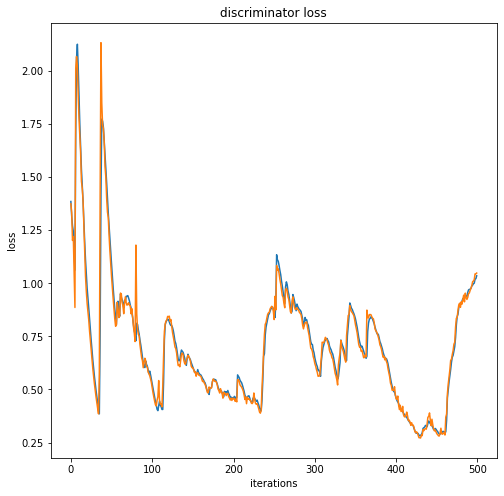

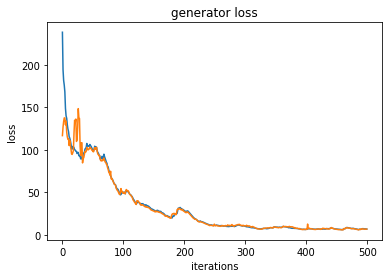

  6%|▌         | 599/10000 [15:10<4:19:48,  1.66s/it]

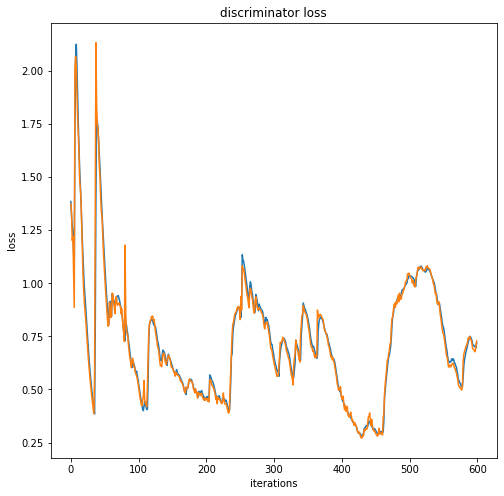

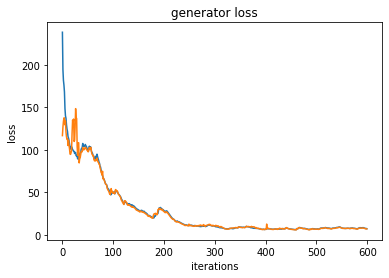

  7%|▋         | 699/10000 [17:49<3:53:34,  1.51s/it]

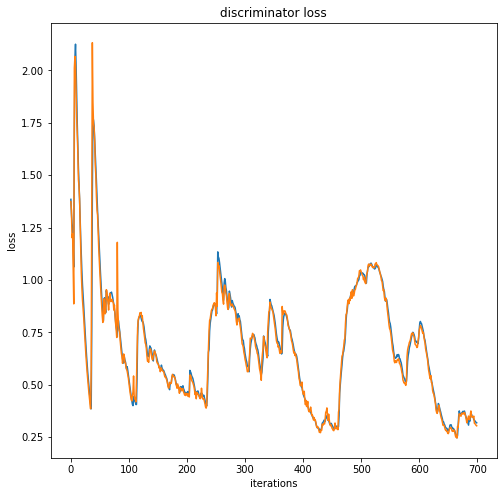

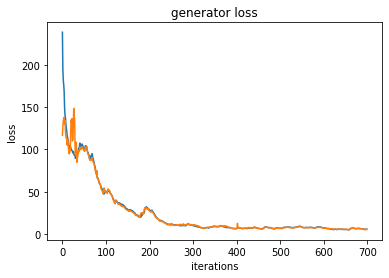

  8%|▊         | 799/10000 [20:18<3:51:03,  1.51s/it]

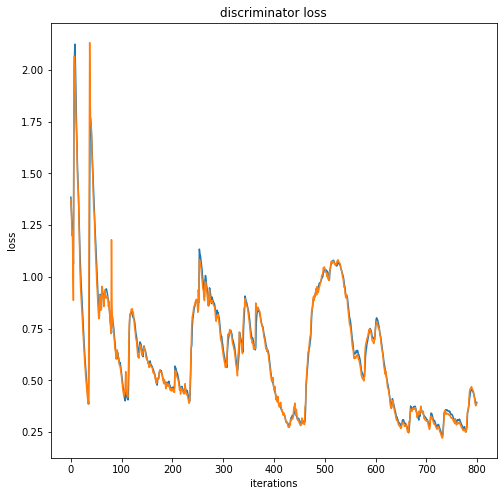

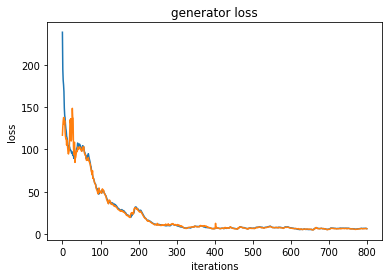

  9%|▉         | 899/10000 [22:51<4:06:52,  1.63s/it]

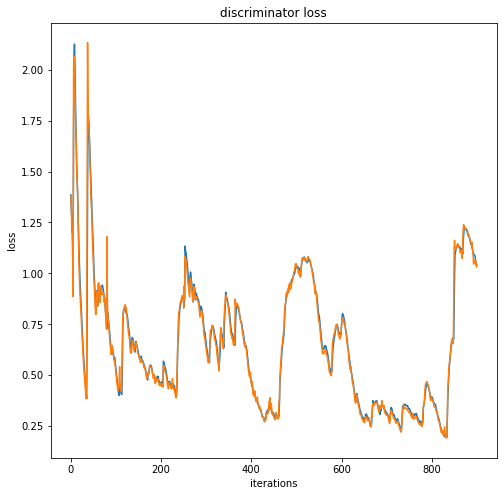

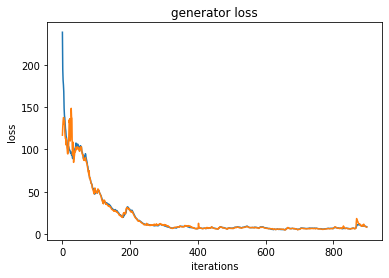

 10%|▉         | 999/10000 [25:44<4:05:05,  1.63s/it]

Iteration 1000/703023: dis loss = 0.2569, gen loss = 4.1603


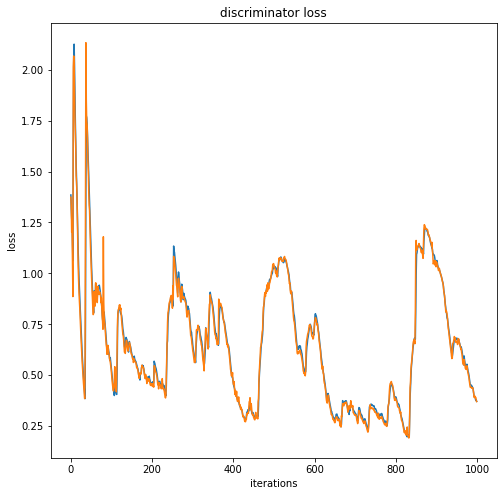

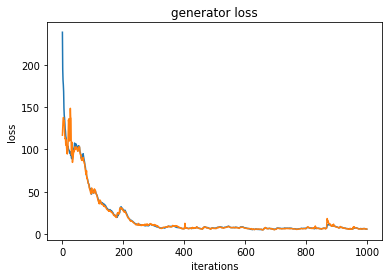

 11%|█         | 1099/10000 [28:13<3:24:00,  1.38s/it]

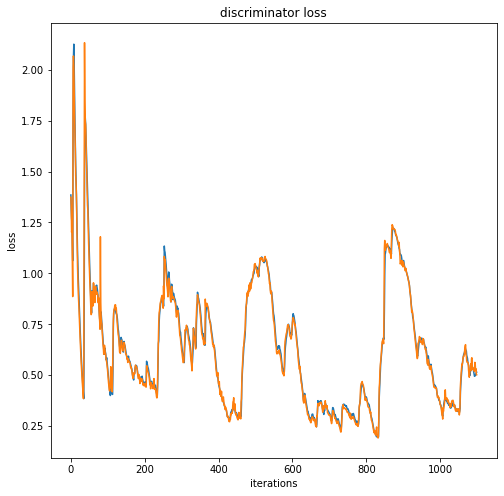

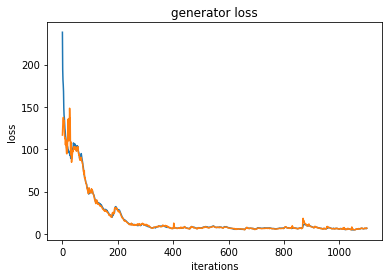

 12%|█▏        | 1199/10000 [30:31<3:22:35,  1.38s/it]

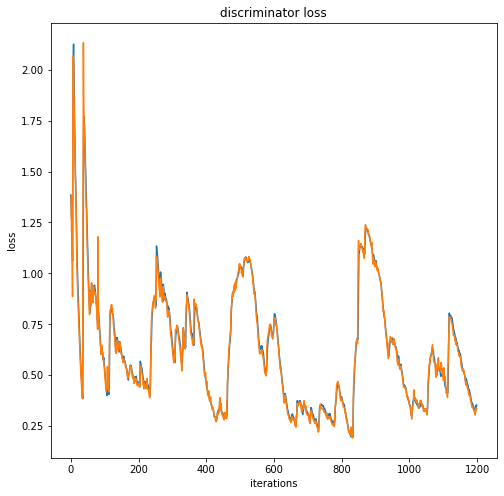

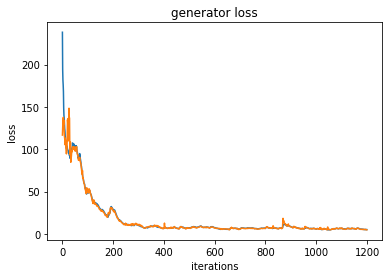

 13%|█▎        | 1299/10000 [33:01<3:46:23,  1.56s/it]

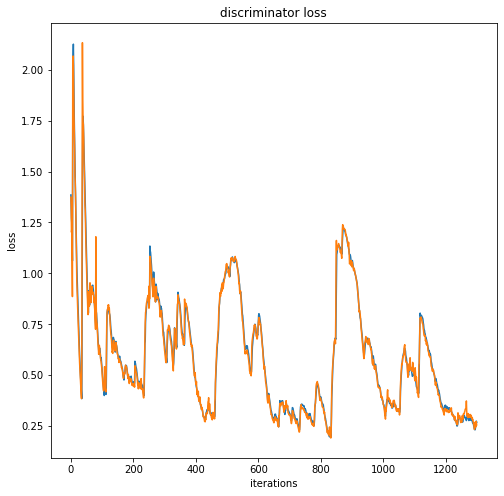

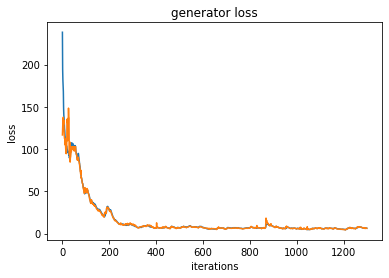

 14%|█▍        | 1399/10000 [35:30<3:34:27,  1.50s/it]

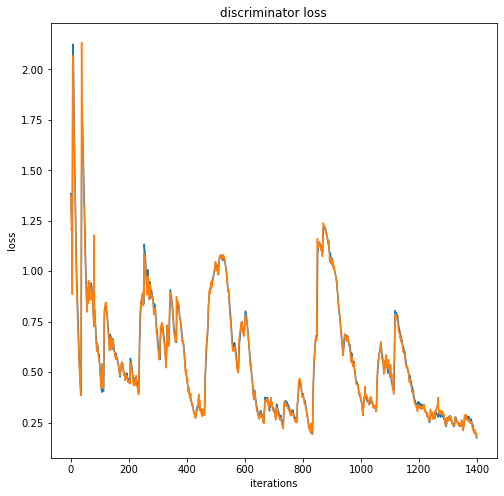

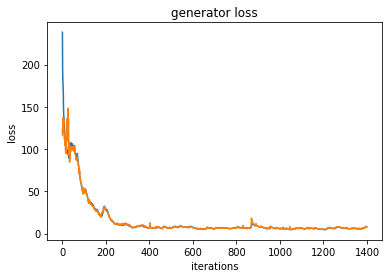

 15%|█▍        | 1499/10000 [38:04<3:55:21,  1.66s/it]

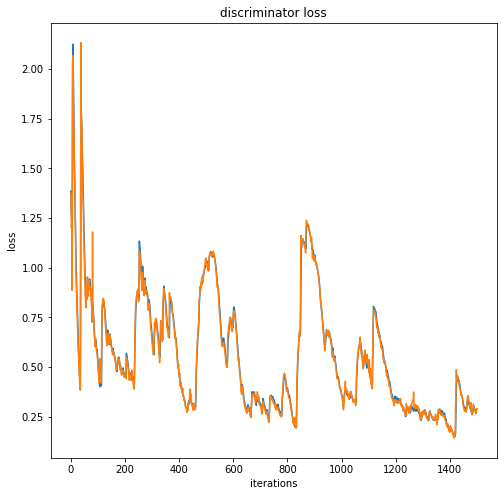

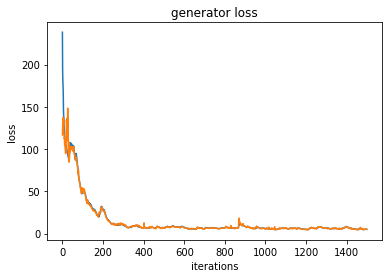

 16%|█▌        | 1599/10000 [40:42<3:47:56,  1.63s/it]

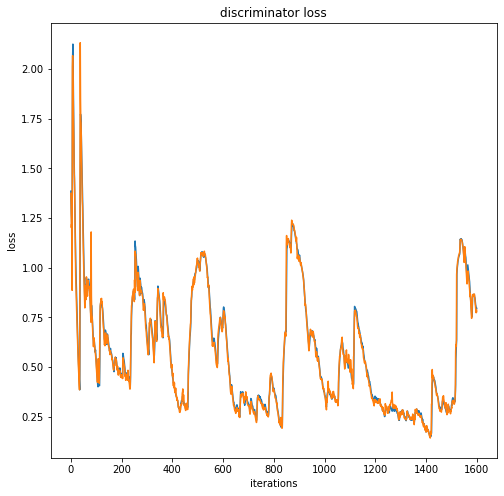

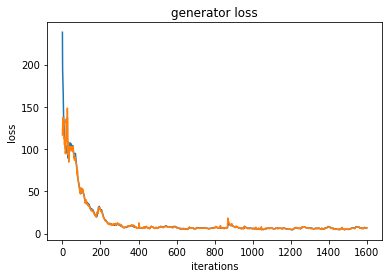

 17%|█▋        | 1699/10000 [43:29<3:50:10,  1.66s/it]

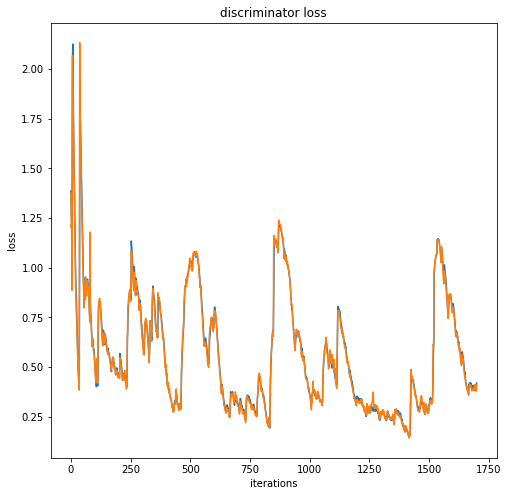

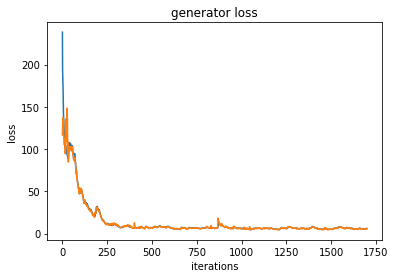

 18%|█▊        | 1799/10000 [46:08<3:17:55,  1.45s/it]

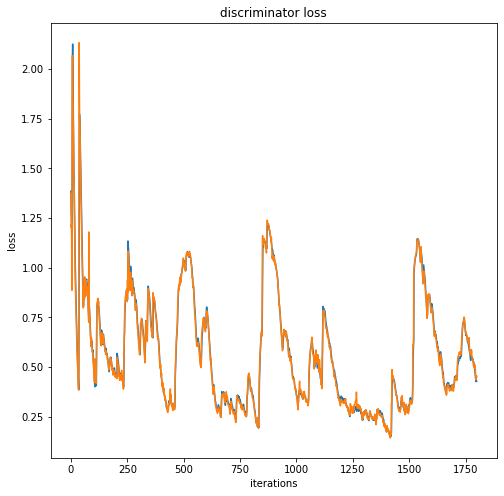

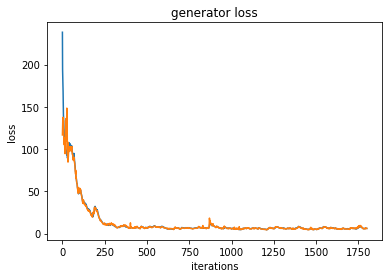

 19%|█▉        | 1899/10000 [48:43<3:15:41,  1.45s/it]

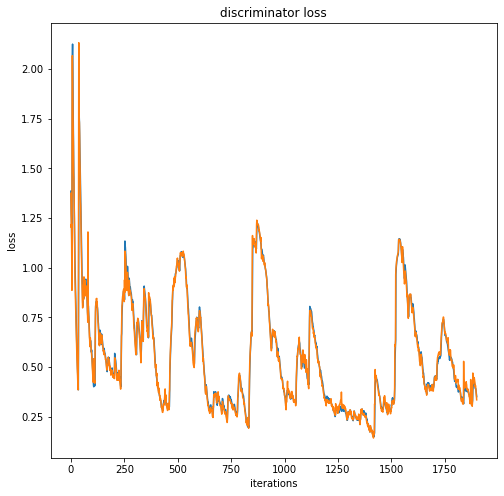

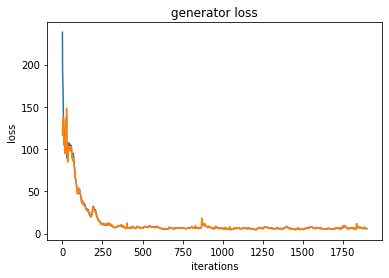

 20%|█▉        | 1999/10000 [51:18<3:21:37,  1.51s/it]

Iteration 2000/703023: dis loss = 0.5153, gen loss = 4.8308


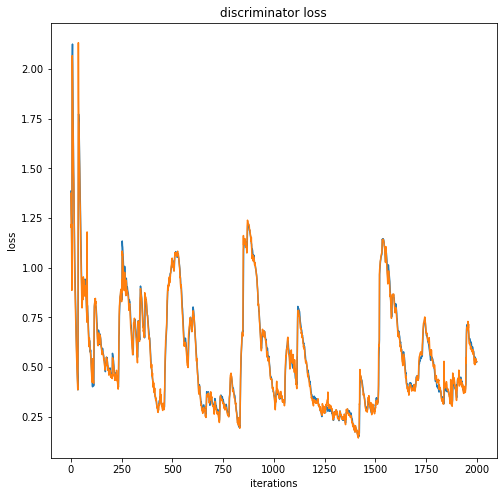

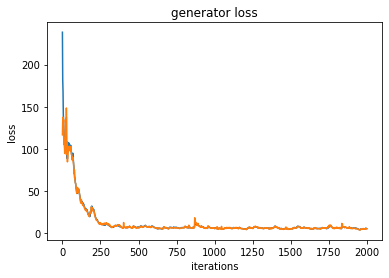

 21%|██        | 2099/10000 [53:44<3:30:51,  1.60s/it]

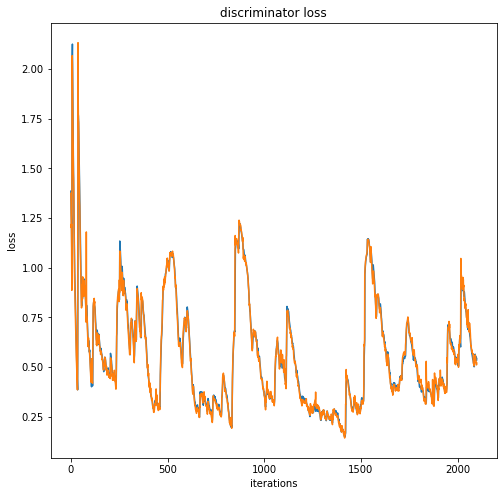

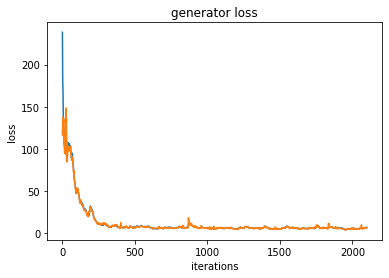

 22%|██▏       | 2199/10000 [56:26<3:20:56,  1.55s/it]

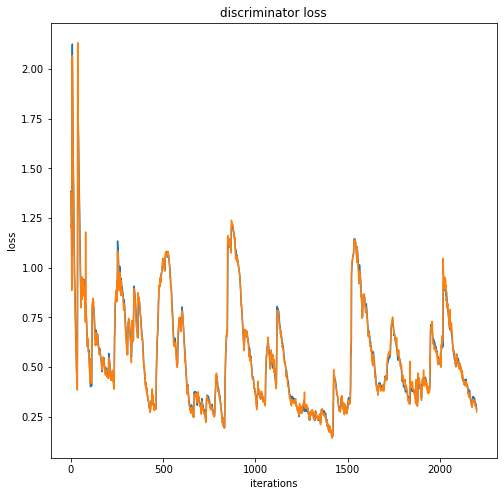

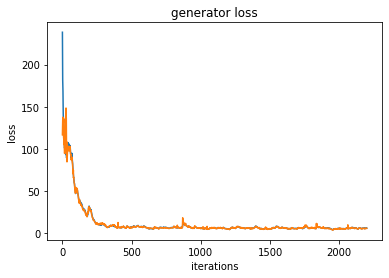

 23%|██▎       | 2299/10000 [59:00<3:16:28,  1.53s/it]

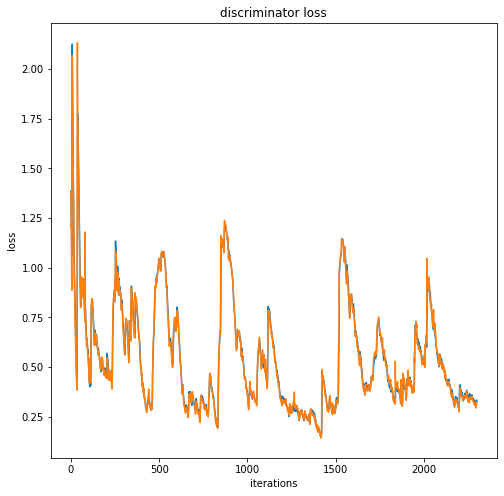

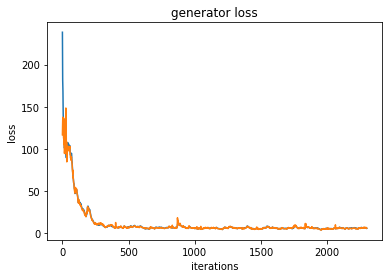

 24%|██▍       | 2399/10000 [1:01:34<3:18:16,  1.57s/it]

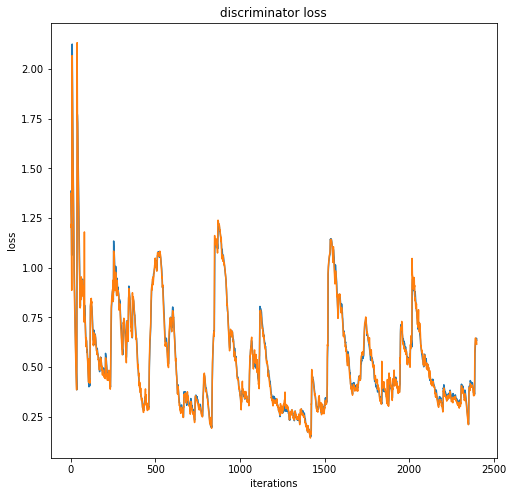

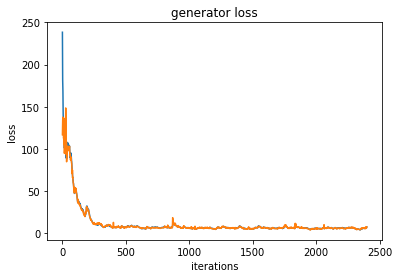

 25%|██▍       | 2499/10000 [1:04:14<3:28:04,  1.66s/it]

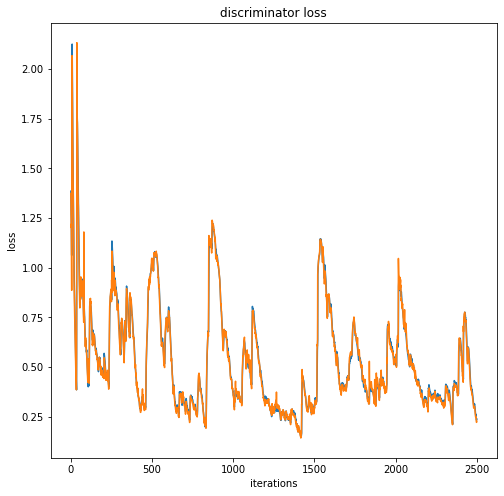

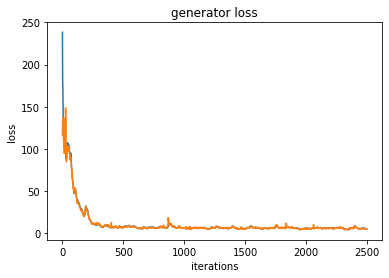

 26%|██▌       | 2599/10000 [1:06:58<3:18:18,  1.61s/it]

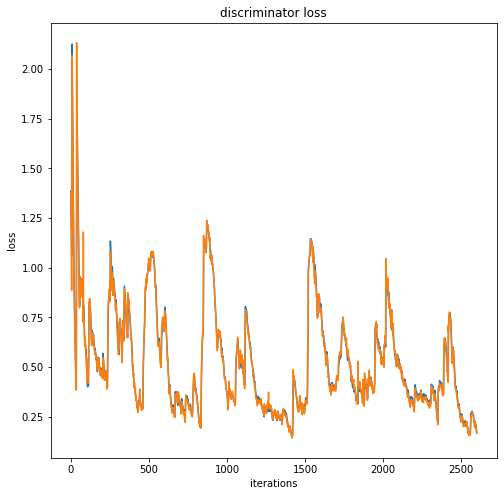

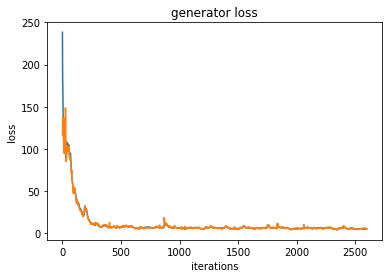

 27%|██▋       | 2699/10000 [1:09:17<3:03:42,  1.51s/it]

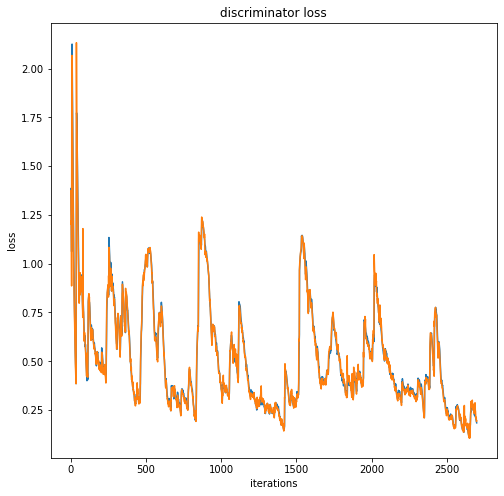

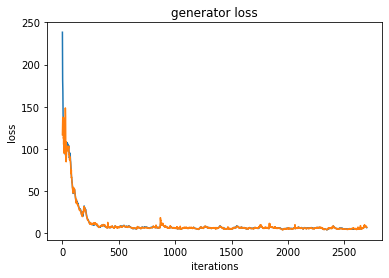

 28%|██▊       | 2799/10000 [1:11:51<3:02:54,  1.52s/it]

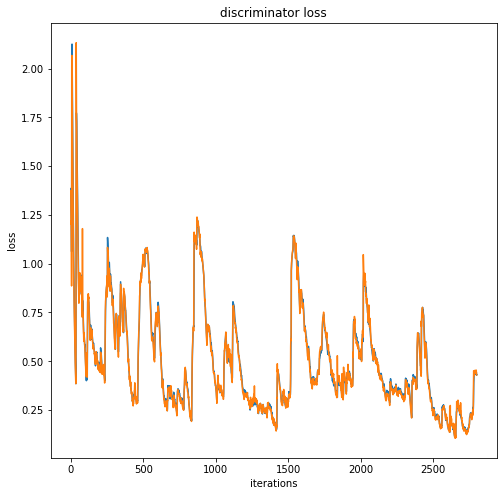

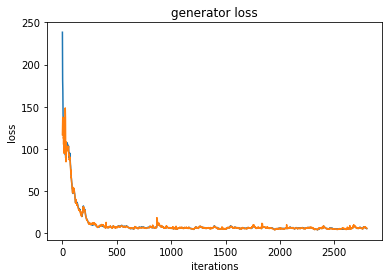

 29%|██▉       | 2899/10000 [1:14:33<3:22:02,  1.71s/it]

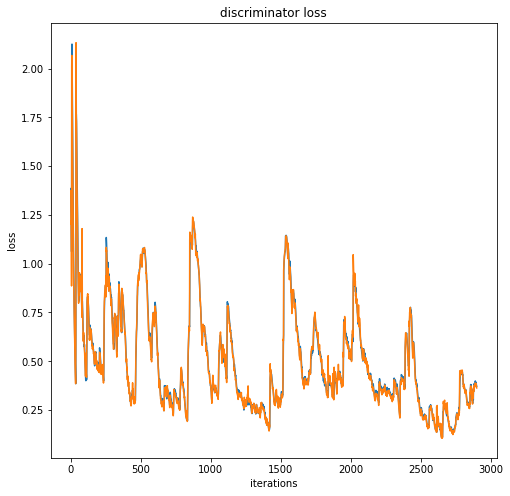

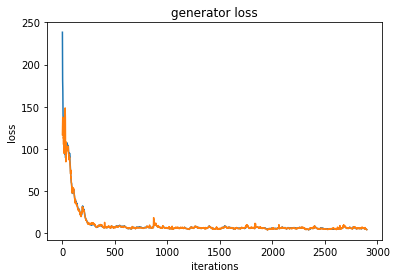

 30%|██▉       | 2999/10000 [1:17:12<3:08:05,  1.61s/it]

Iteration 3000/703023: dis loss = 0.4099, gen loss = 3.9437


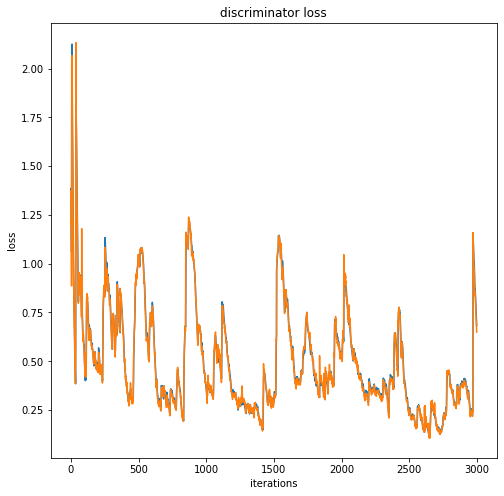

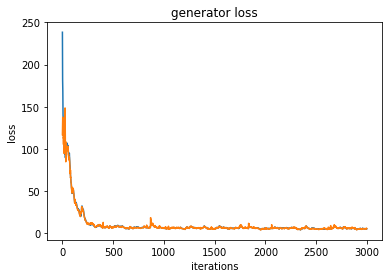

 31%|███       | 3099/10000 [1:19:52<3:02:51,  1.59s/it]

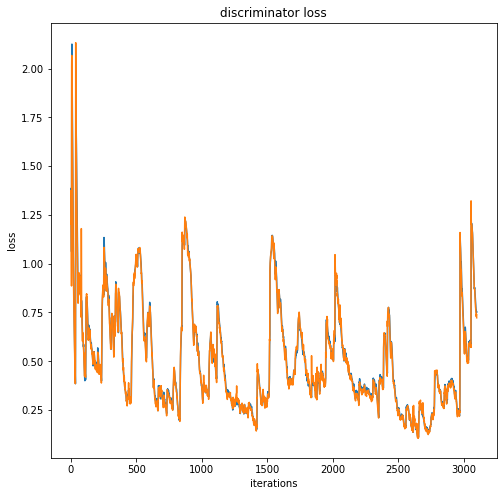

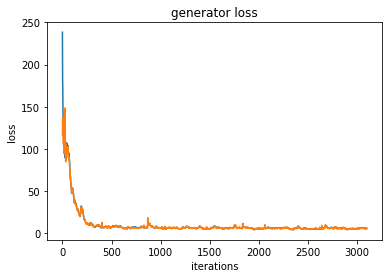

 32%|███▏      | 3199/10000 [1:22:26<2:50:57,  1.51s/it]

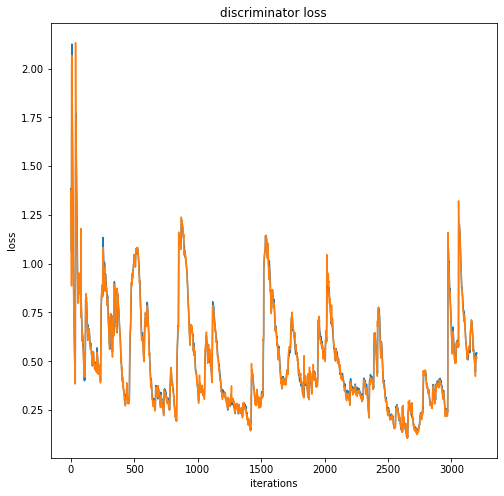

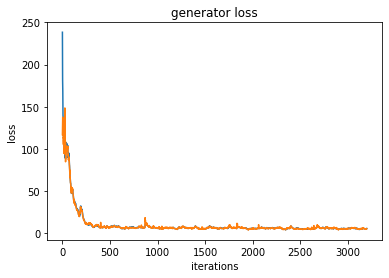

 33%|███▎      | 3299/10000 [1:24:52<2:33:51,  1.38s/it]

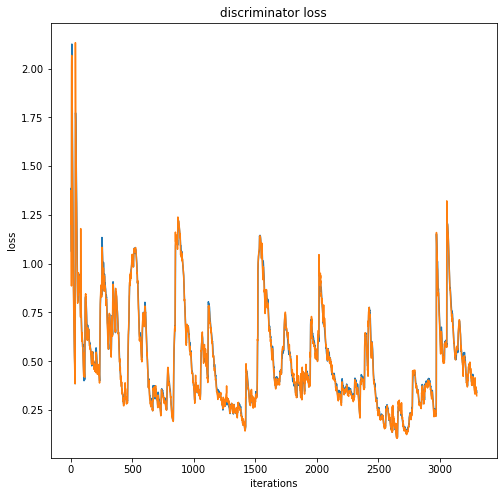

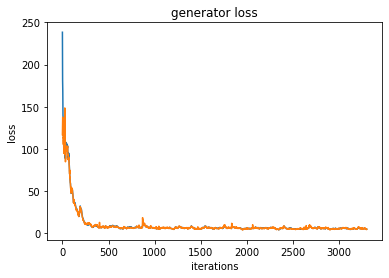

 34%|███▍      | 3399/10000 [1:27:21<2:54:13,  1.58s/it]

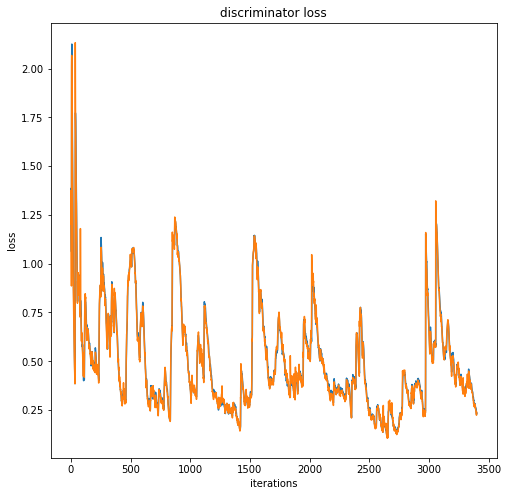

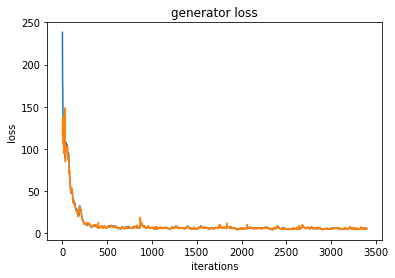

 35%|███▍      | 3499/10000 [1:29:58<2:49:28,  1.56s/it]

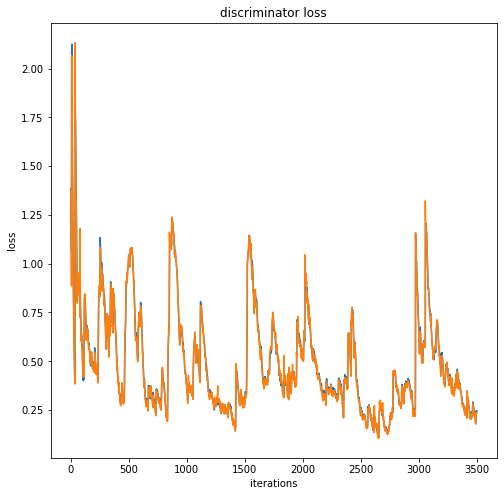

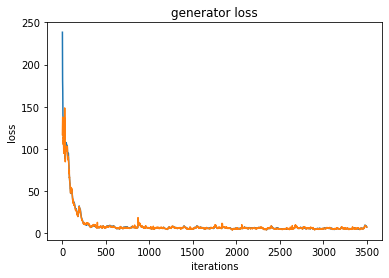

 36%|███▌      | 3599/10000 [1:32:35<2:48:17,  1.58s/it]

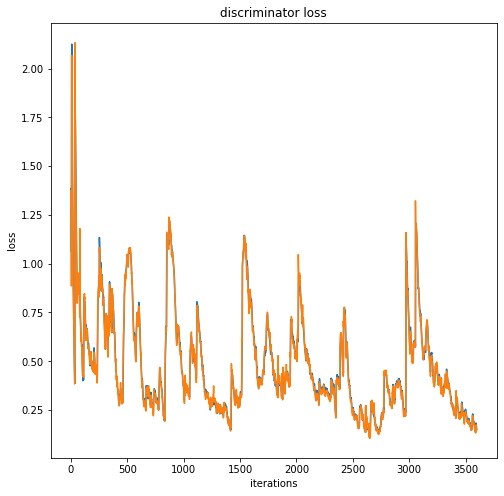

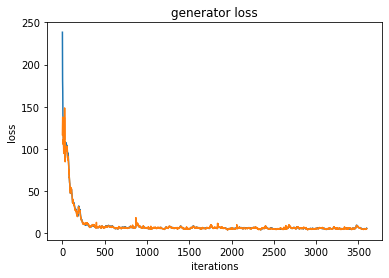

 37%|███▋      | 3699/10000 [1:35:12<2:45:43,  1.58s/it]

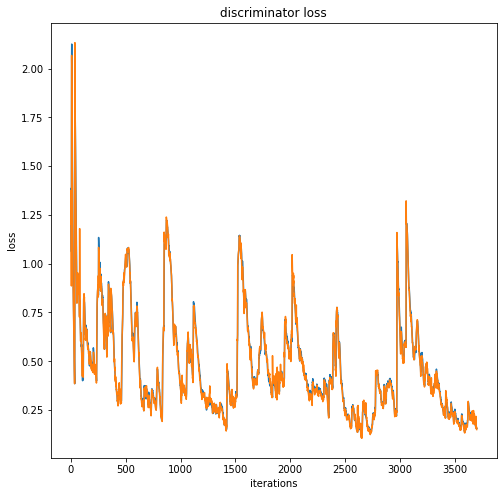

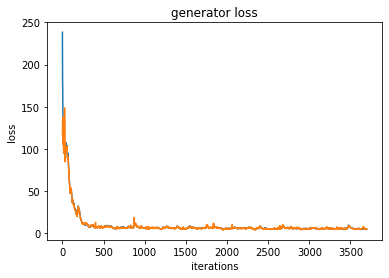

 38%|███▊      | 3799/10000 [1:37:50<2:45:25,  1.60s/it]

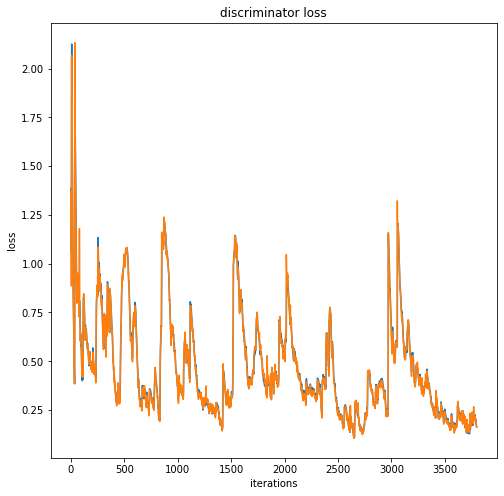

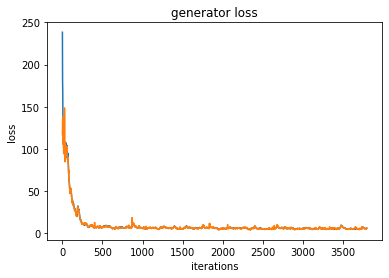

 39%|███▉      | 3899/10000 [1:40:40<2:53:17,  1.70s/it]

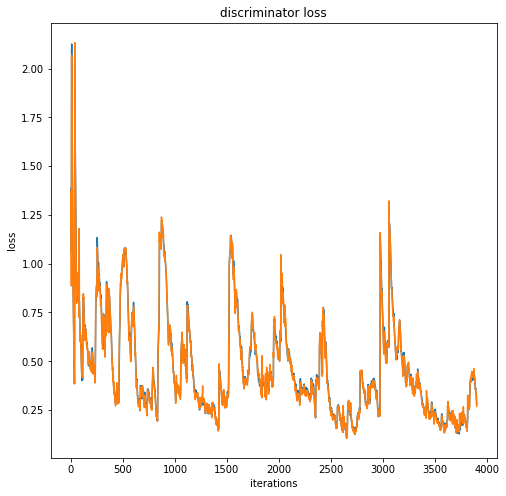

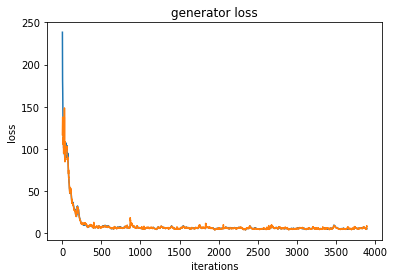

 40%|███▉      | 3999/10000 [1:43:23<2:30:36,  1.51s/it]

Iteration 4000/703023: dis loss = 0.1935, gen loss = 3.1877


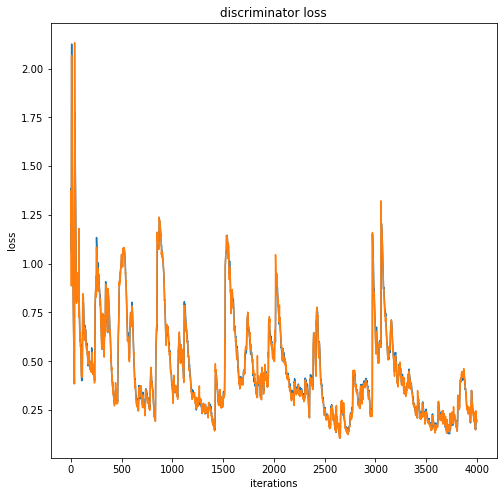

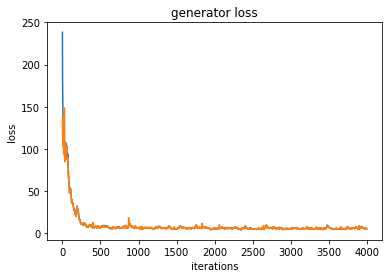

 41%|████      | 4099/10000 [1:46:02<2:44:28,  1.67s/it]

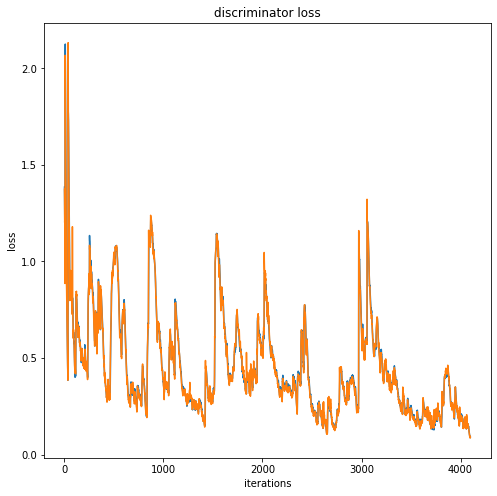

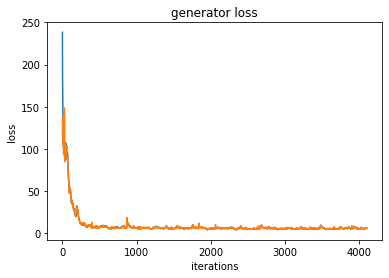

 42%|████▏     | 4199/10000 [1:48:40<2:30:04,  1.55s/it]

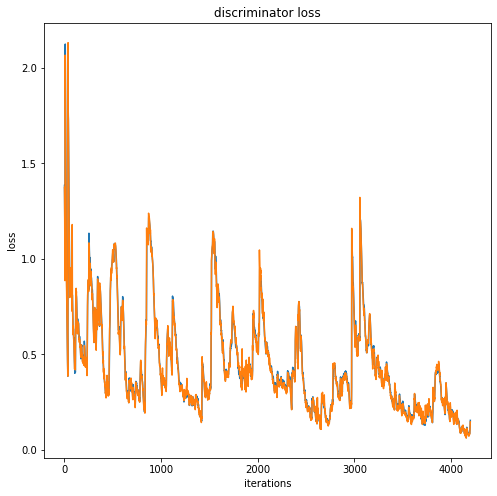

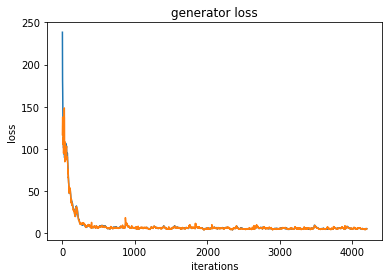

 43%|████▎     | 4299/10000 [1:51:18<2:31:38,  1.60s/it]

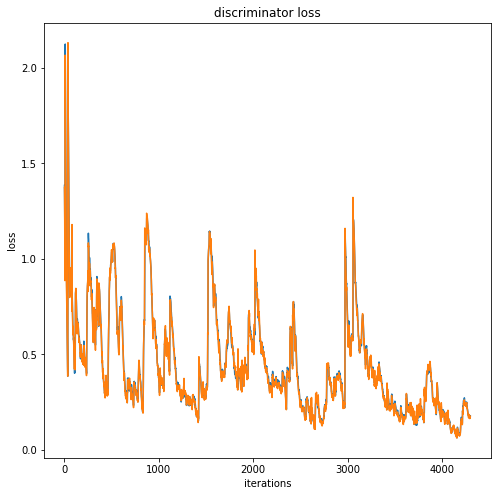

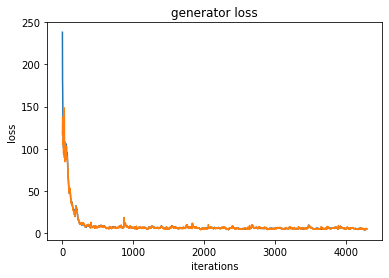

 44%|████▍     | 4399/10000 [1:53:54<2:23:51,  1.54s/it]

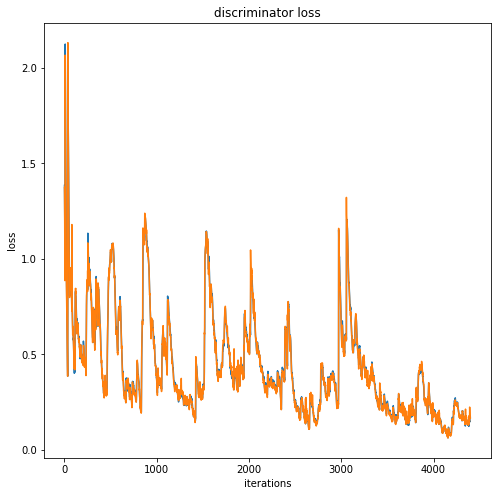

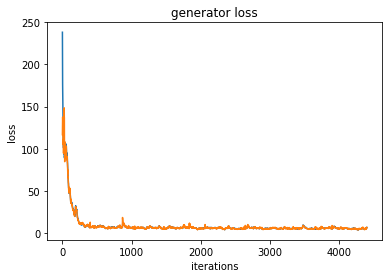

 45%|████▍     | 4499/10000 [1:56:33<2:24:32,  1.58s/it]

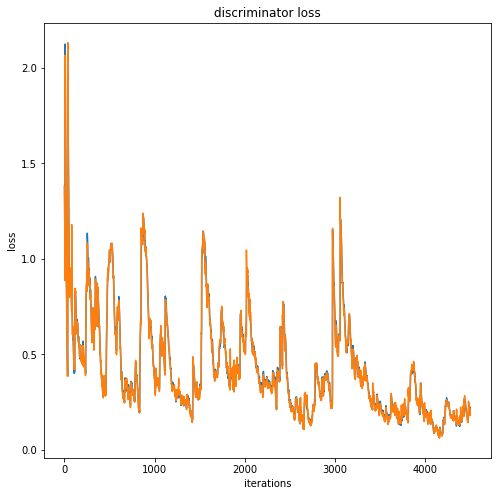

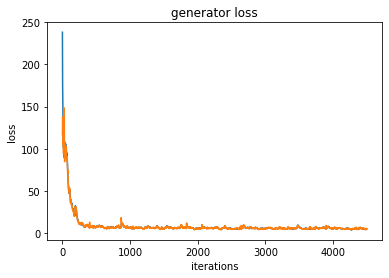

 46%|████▌     | 4599/10000 [1:59:07<2:23:09,  1.59s/it]

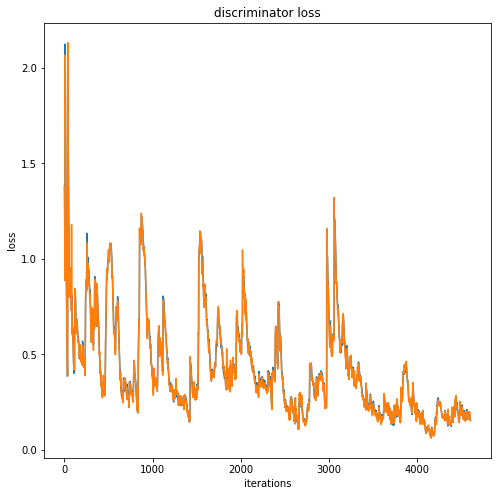

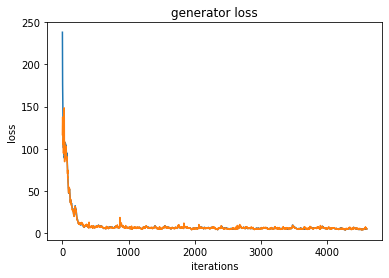

 47%|████▋     | 4699/10000 [2:01:33<2:06:10,  1.43s/it]

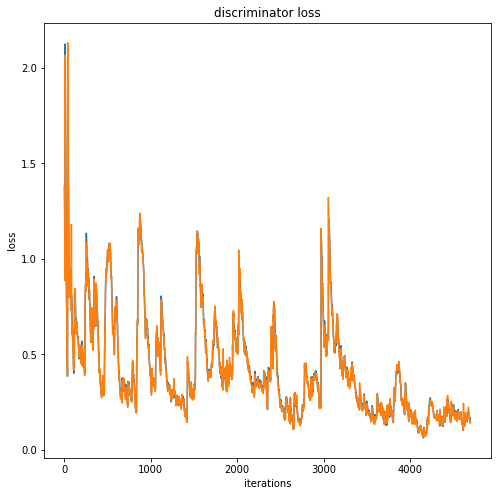

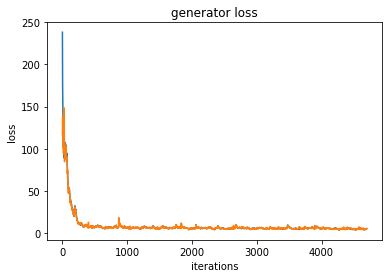

 48%|████▊     | 4799/10000 [2:03:53<1:52:55,  1.30s/it]

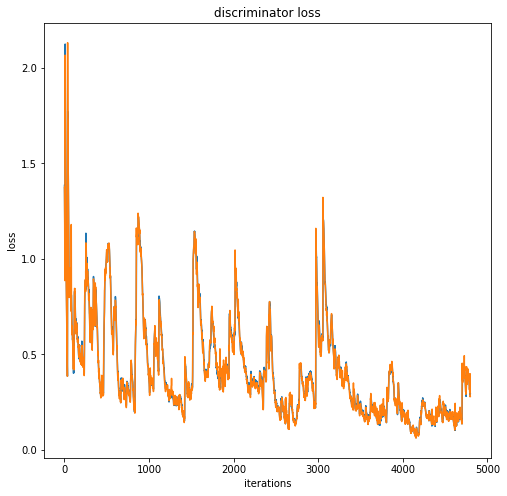

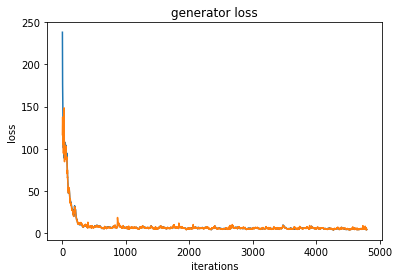

 49%|████▉     | 4899/10000 [2:06:16<1:56:58,  1.38s/it]

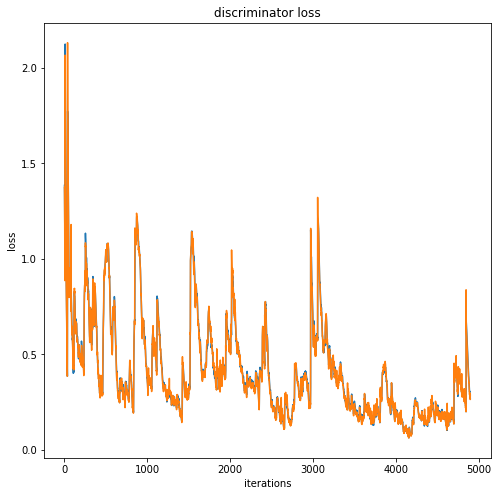

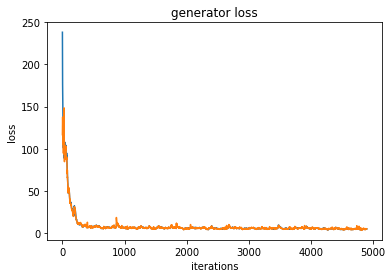

 50%|████▉     | 4999/10000 [2:08:54<2:11:32,  1.58s/it]

Iteration 5000/703023: dis loss = 0.1618, gen loss = 6.0148


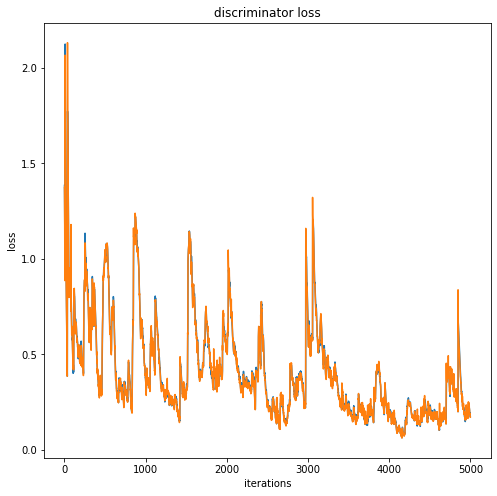

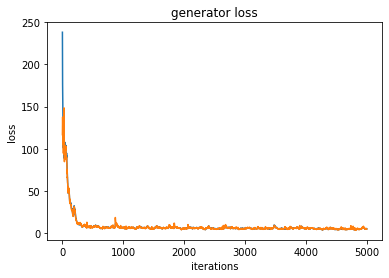

 51%|█████     | 5099/10000 [2:11:30<2:11:43,  1.61s/it]

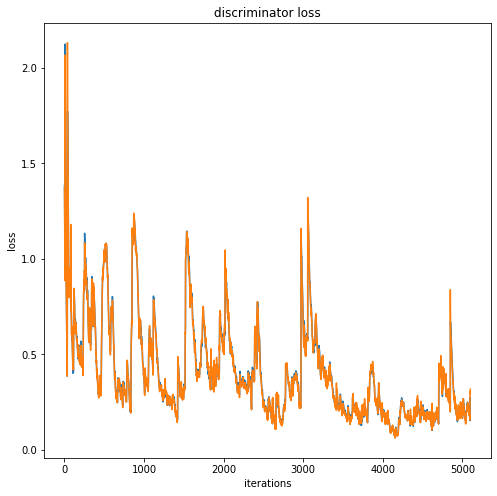

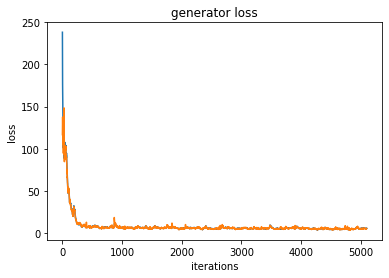

 52%|█████▏    | 5199/10000 [2:14:12<2:01:22,  1.52s/it]

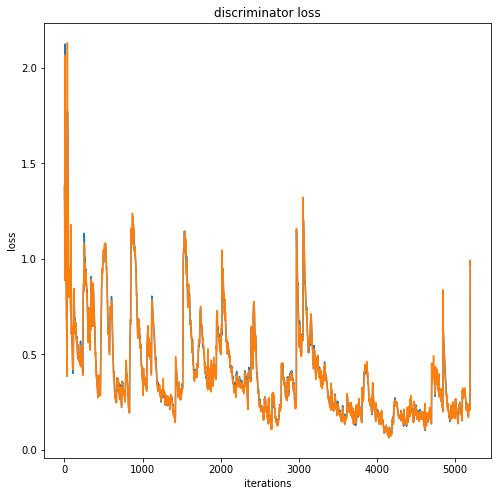

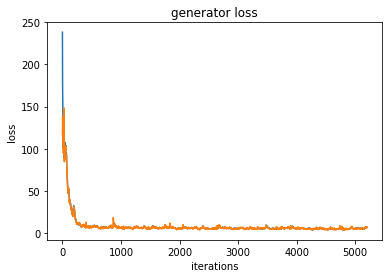

 53%|█████▎    | 5299/10000 [2:16:45<2:03:36,  1.58s/it]

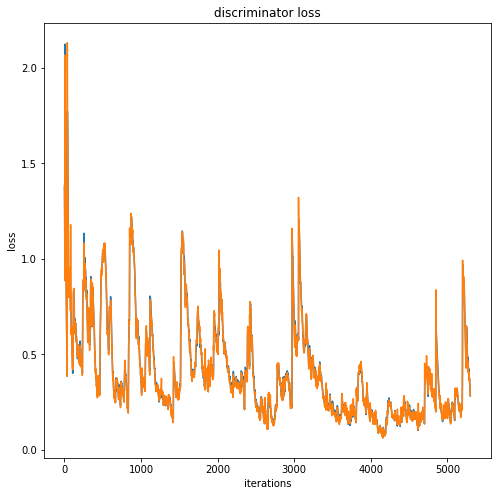

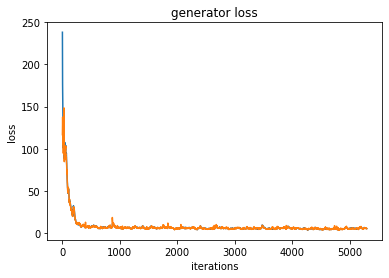

 54%|█████▍    | 5399/10000 [2:19:27<2:05:21,  1.63s/it]

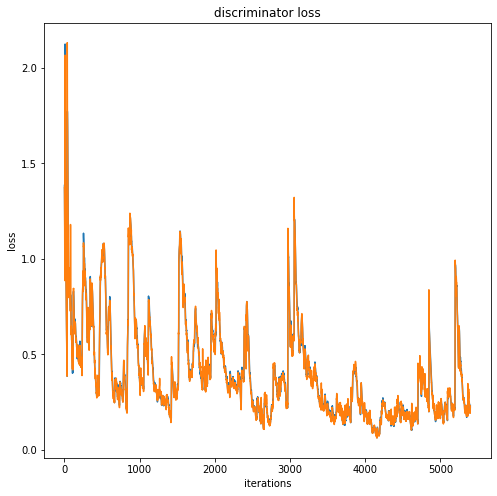

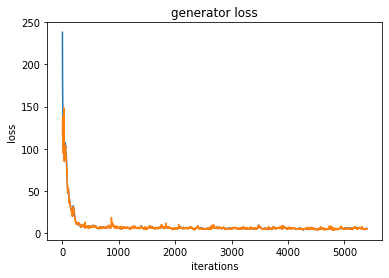

 55%|█████▍    | 5499/10000 [2:22:14<2:12:31,  1.77s/it]

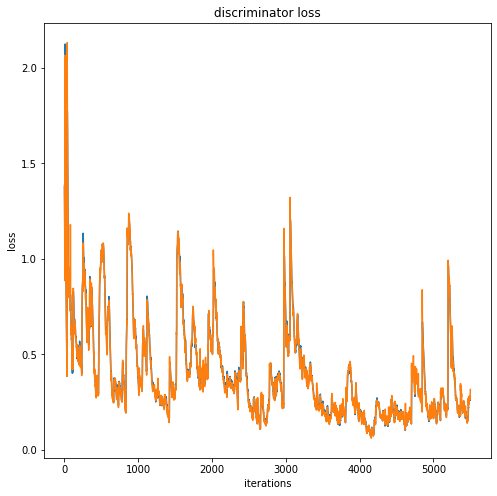

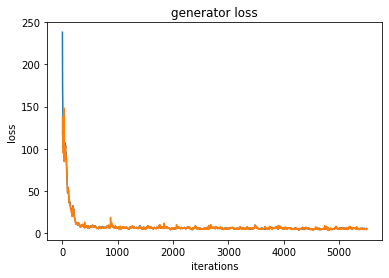

 56%|█████▌    | 5599/10000 [2:25:08<1:51:52,  1.53s/it]

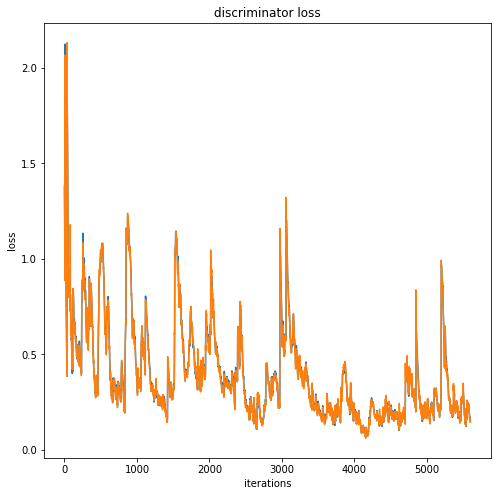

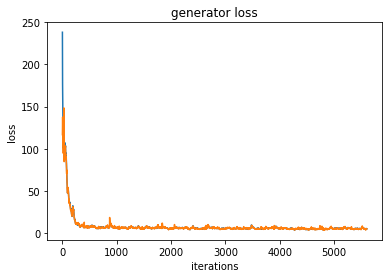

 57%|█████▋    | 5699/10000 [2:27:32<1:41:25,  1.41s/it]

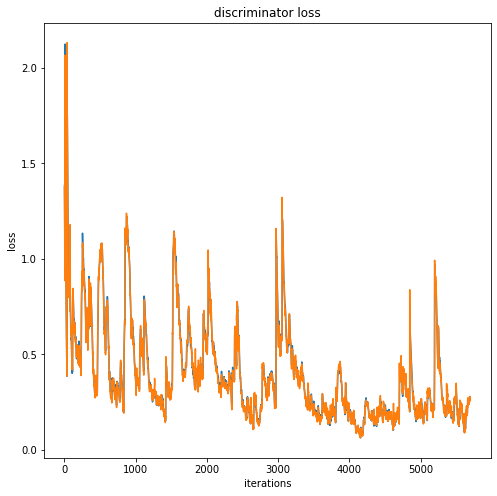

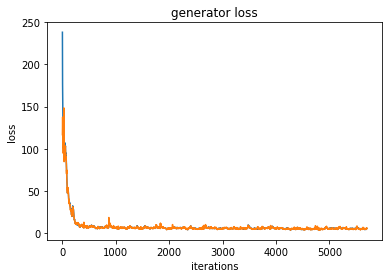

 58%|█████▊    | 5799/10000 [2:29:58<1:49:55,  1.57s/it]

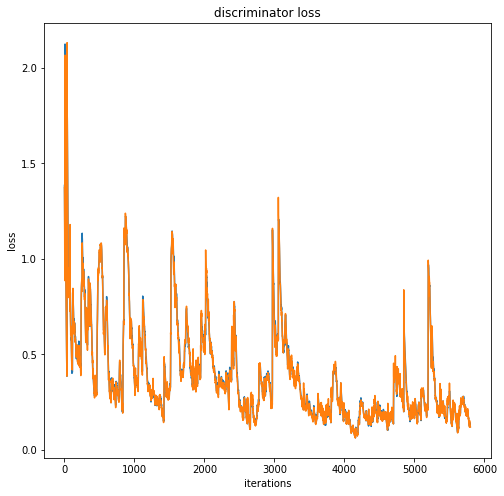

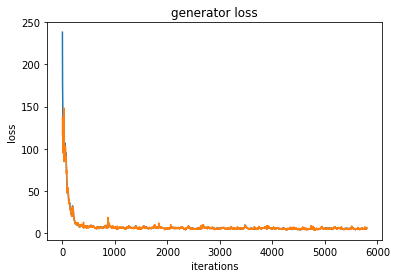

 59%|█████▉    | 5899/10000 [2:32:39<1:52:05,  1.64s/it]

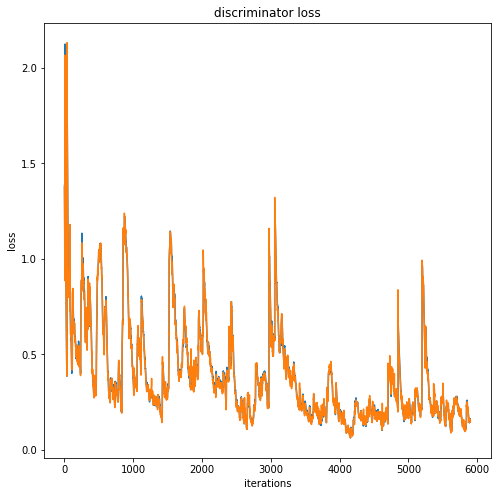

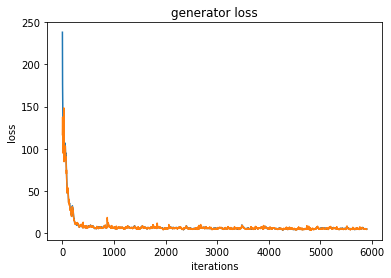

 60%|█████▉    | 5999/10000 [2:35:24<1:49:30,  1.64s/it]

Iteration 6000/703023: dis loss = 0.2333, gen loss = 2.7959


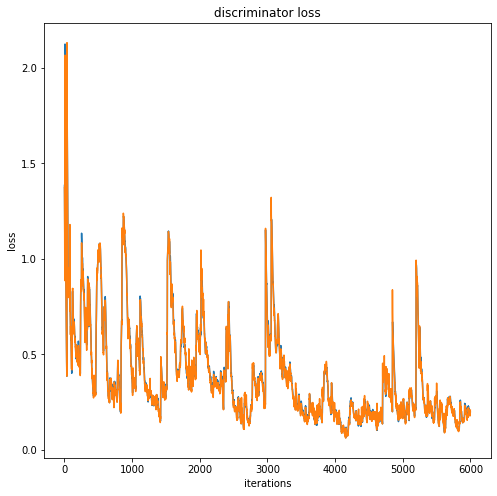

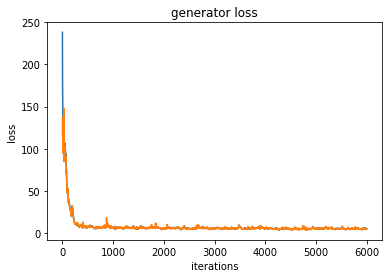

 61%|██████    | 6099/10000 [2:38:06<1:42:11,  1.57s/it]

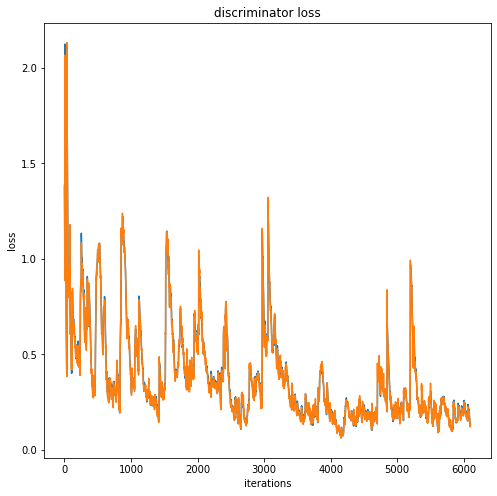

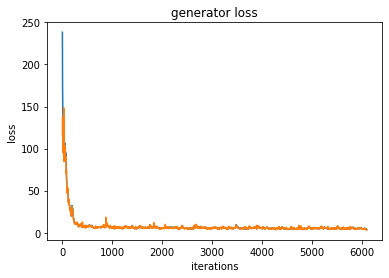

 62%|██████▏   | 6199/10000 [2:40:49<1:42:27,  1.62s/it]

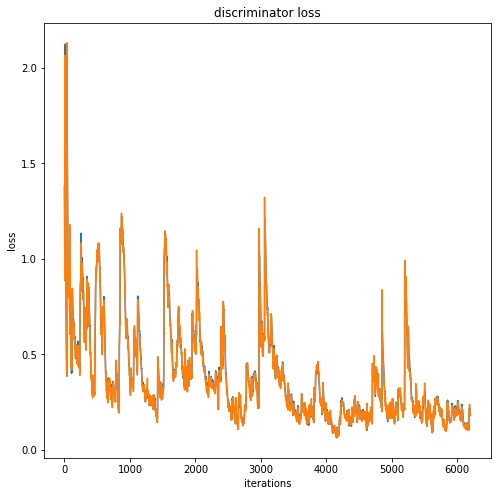

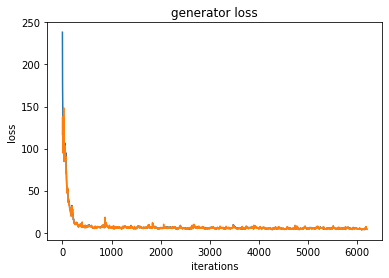

 63%|██████▎   | 6299/10000 [2:43:27<1:40:25,  1.63s/it]

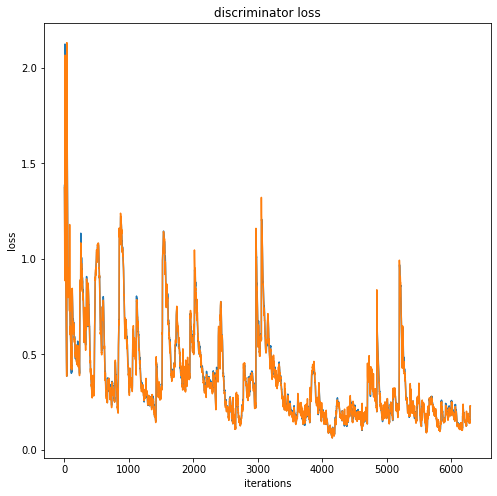

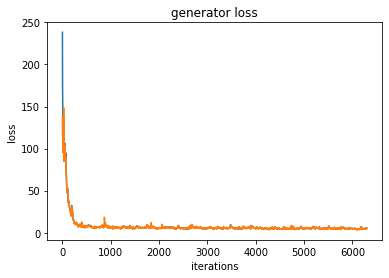

 64%|██████▍   | 6399/10000 [2:45:57<1:23:08,  1.39s/it]

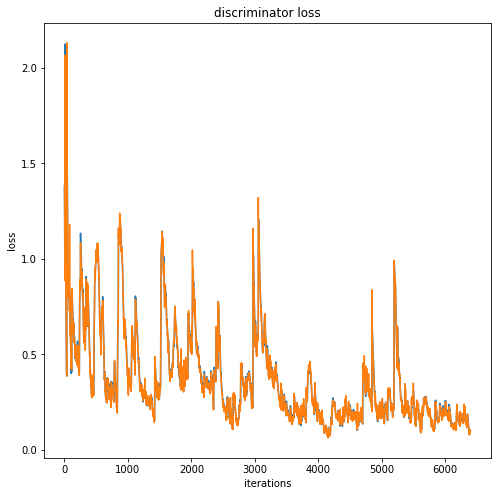

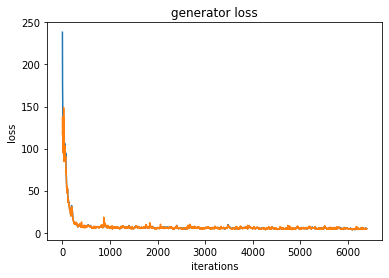

 65%|██████▍   | 6499/10000 [2:48:21<1:28:17,  1.51s/it]

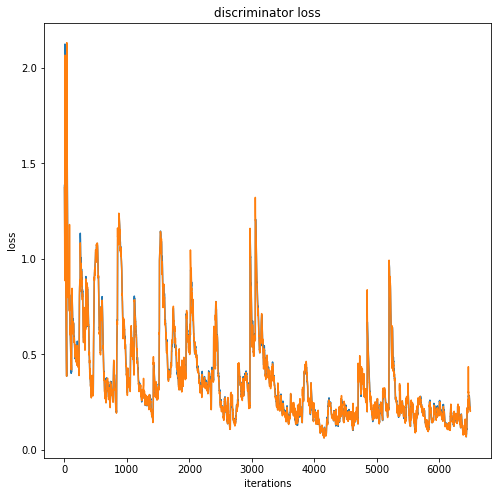

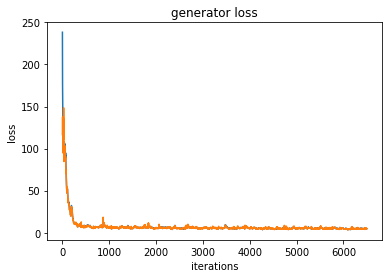

 66%|██████▌   | 6599/10000 [2:50:50<1:22:26,  1.45s/it]

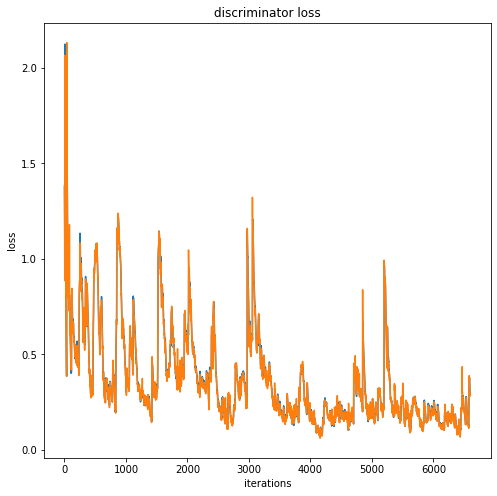

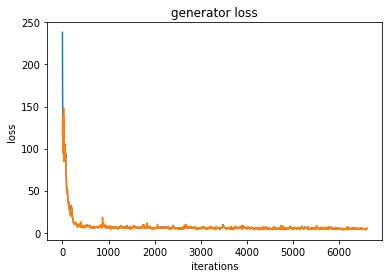

 67%|██████▋   | 6699/10000 [2:53:16<1:22:11,  1.49s/it]

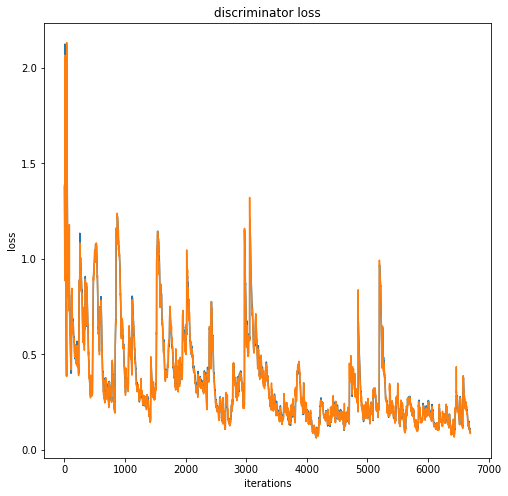

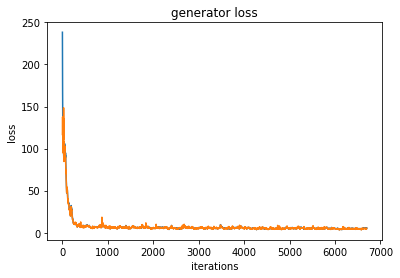

 68%|██████▊   | 6799/10000 [2:55:41<1:11:36,  1.34s/it]

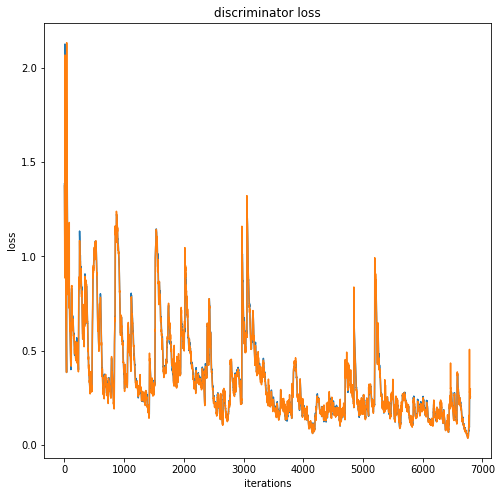

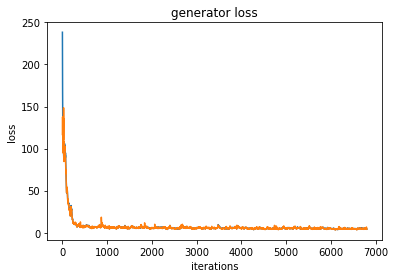

 69%|██████▉   | 6899/10000 [2:58:05<1:21:10,  1.57s/it]

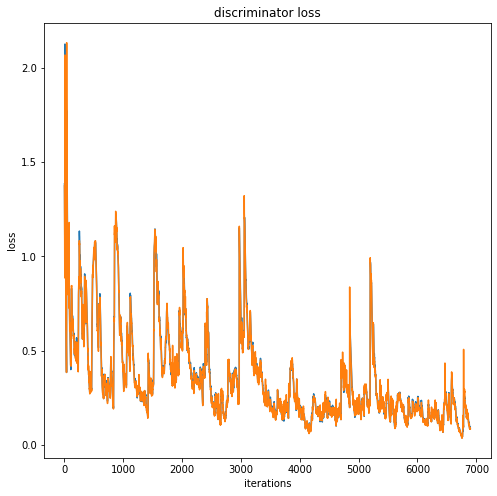

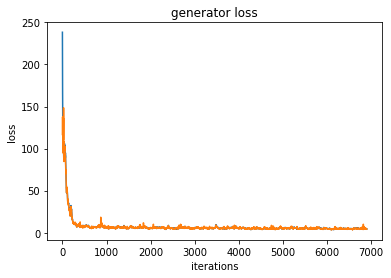

 70%|██████▉   | 6999/10000 [3:00:27<1:12:39,  1.45s/it]

Iteration 7000/703023: dis loss = 0.0830, gen loss = 2.5576


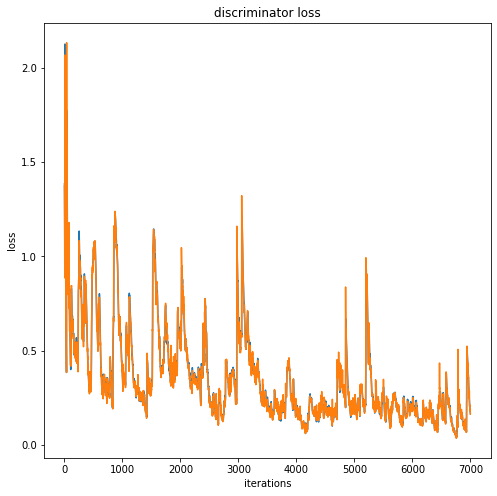

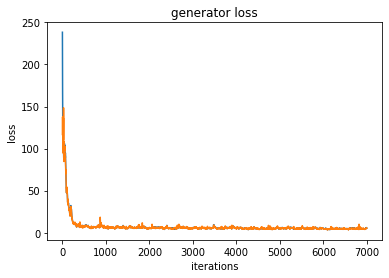

 71%|███████   | 7099/10000 [3:03:03<1:13:30,  1.52s/it]

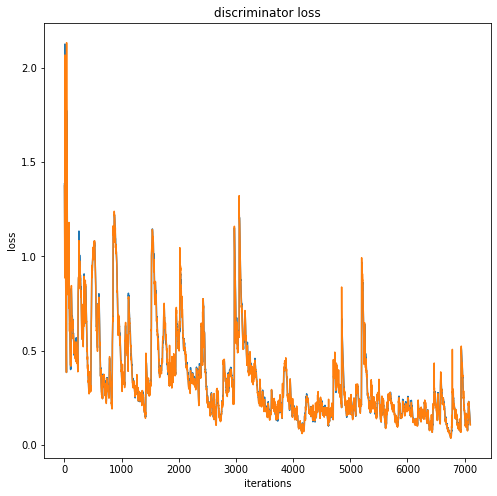

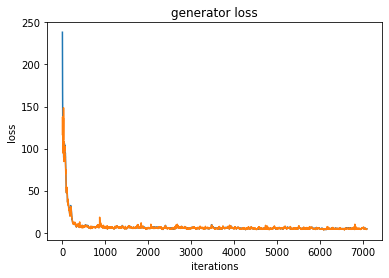

 72%|███████▏  | 7199/10000 [3:05:47<1:16:50,  1.65s/it]

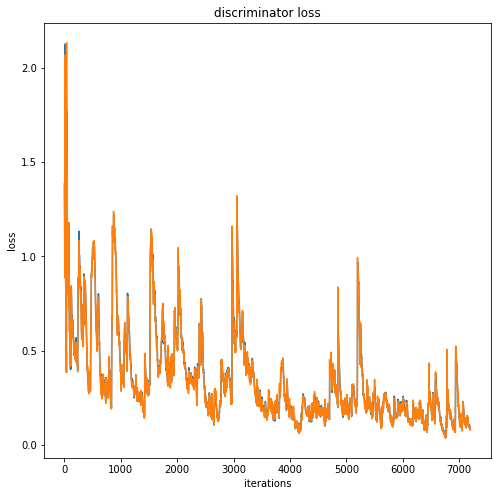

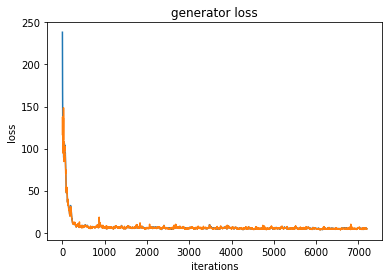

 73%|███████▎  | 7299/10000 [3:08:27<1:12:06,  1.60s/it]

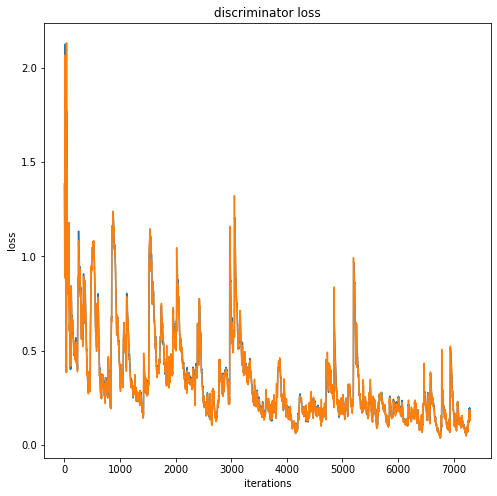

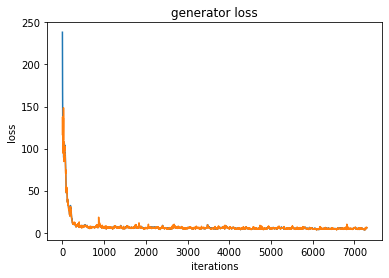

 74%|███████▍  | 7399/10000 [3:11:07<1:09:20,  1.60s/it]

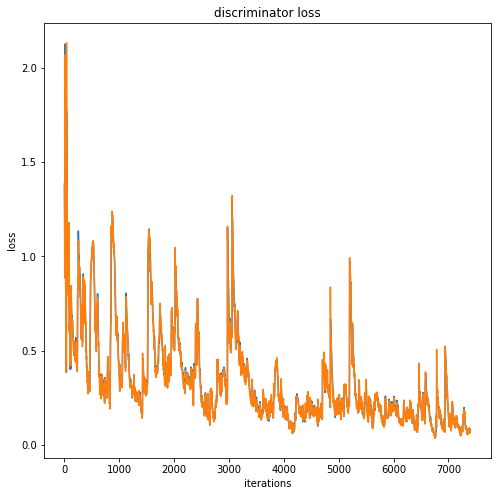

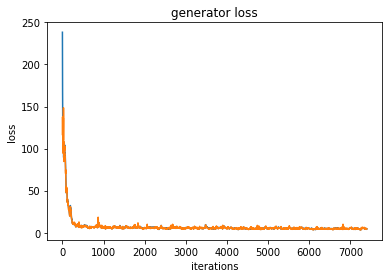

 75%|███████▍  | 7499/10000 [3:13:45<1:05:51,  1.58s/it]

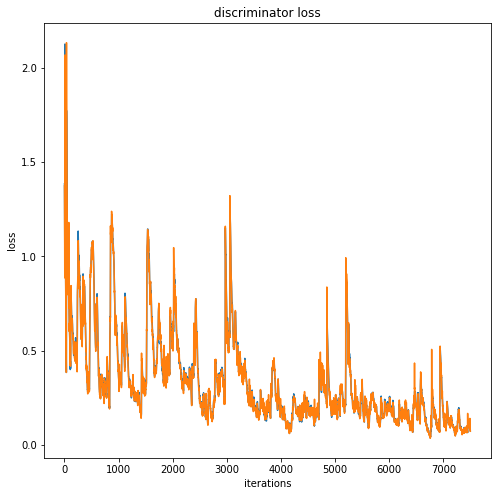

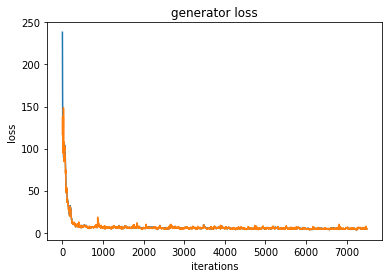

 76%|███████▌  | 7599/10000 [3:16:30<1:07:37,  1.69s/it]

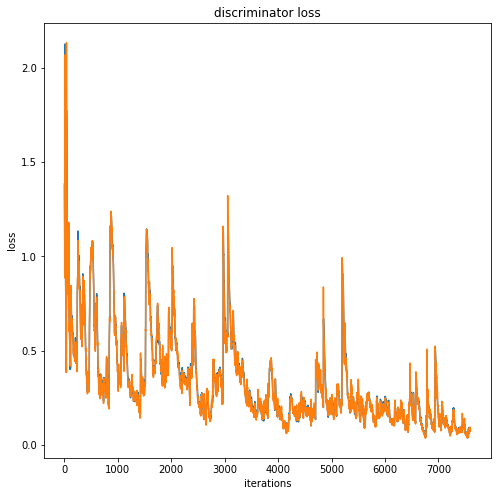

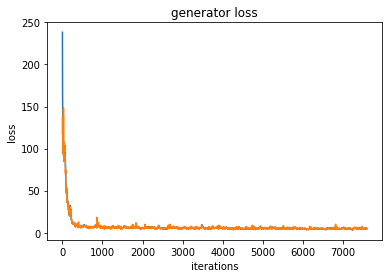

 77%|███████▋  | 7699/10000 [3:19:12<1:00:30,  1.58s/it]

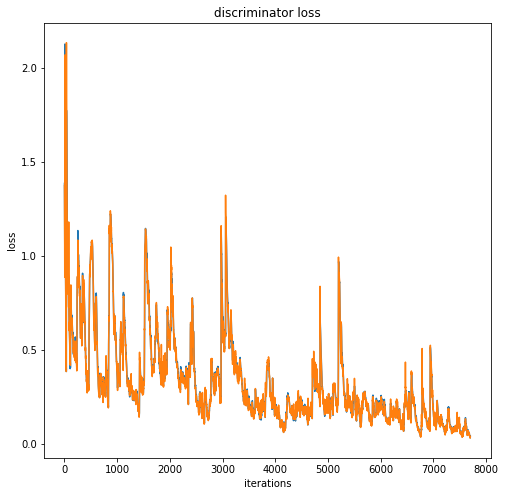

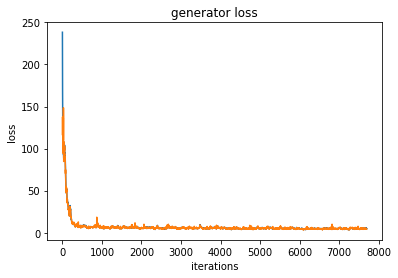

 78%|███████▊  | 7799/10000 [3:21:57<1:05:03,  1.77s/it]

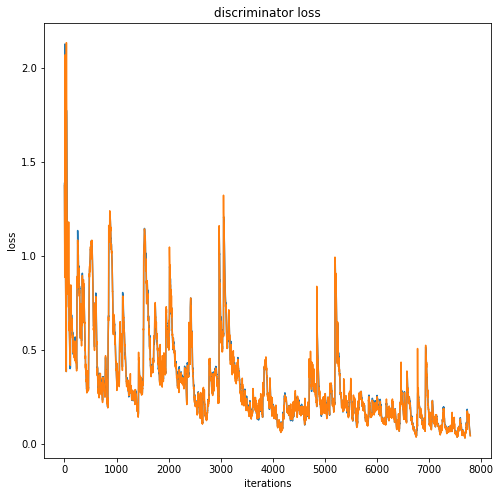

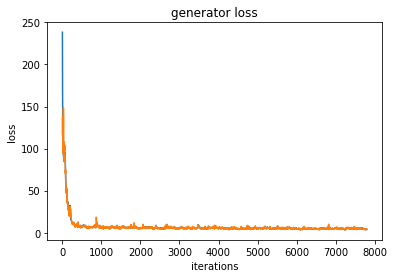

 79%|███████▉  | 7899/10000 [3:24:47<59:00,  1.69s/it]  

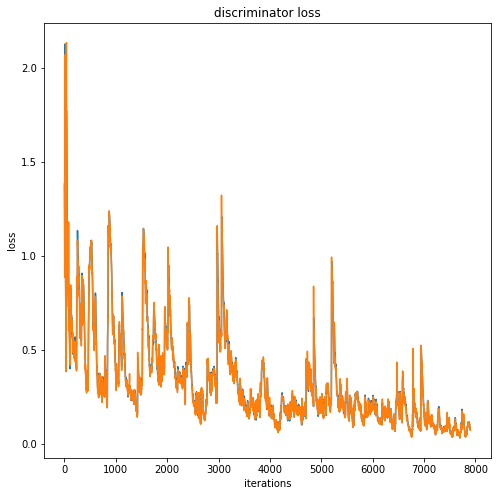

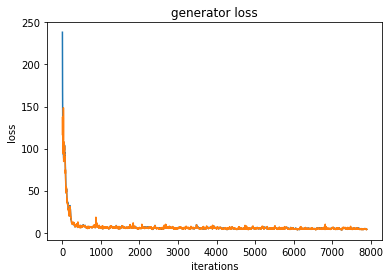

 80%|███████▉  | 7999/10000 [3:27:34<56:32,  1.70s/it]  

Iteration 8000/703023: dis loss = 0.0834, gen loss = 7.5965


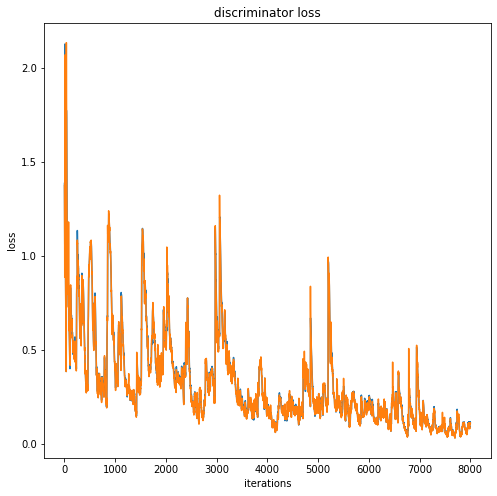

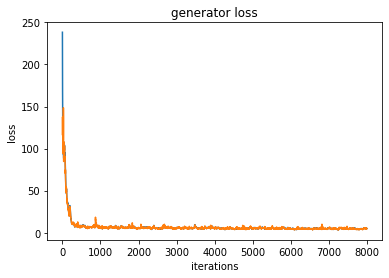

 81%|████████  | 8099/10000 [3:30:21<52:57,  1.67s/it]  

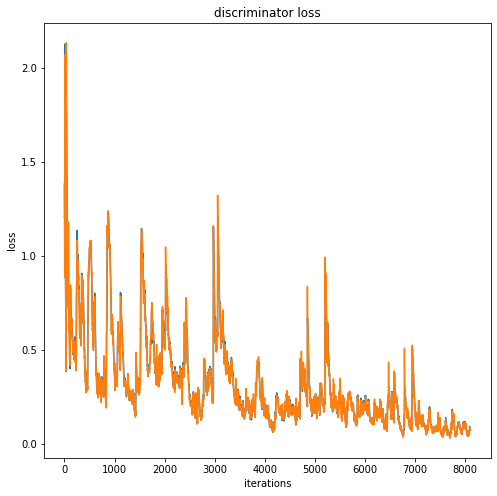

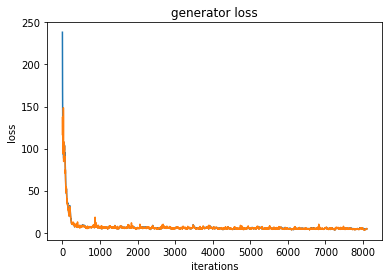

 82%|████████▏ | 8199/10000 [3:33:09<51:15,  1.71s/it]

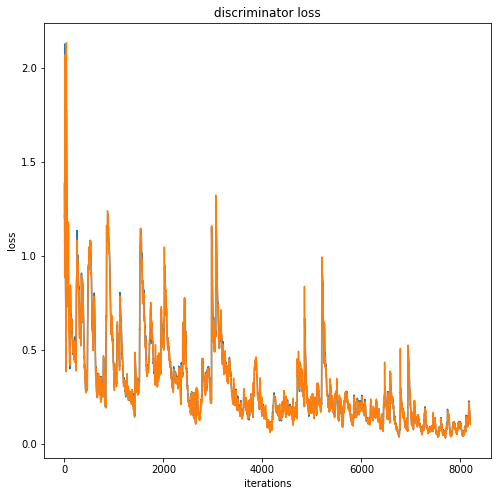

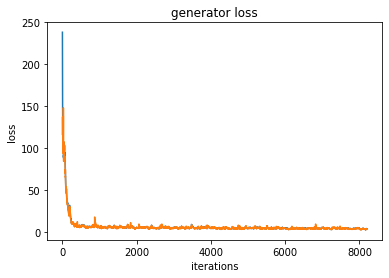

 83%|████████▎ | 8299/10000 [3:35:59<49:14,  1.74s/it]

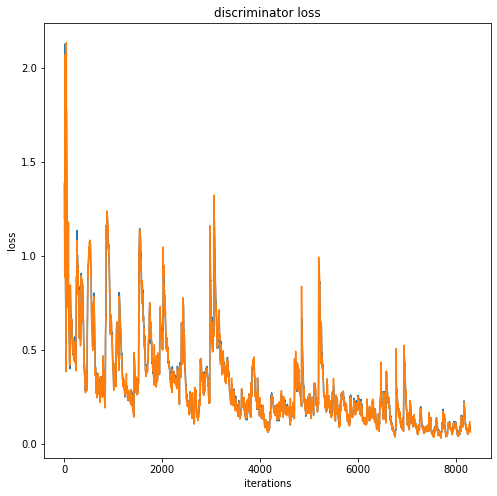

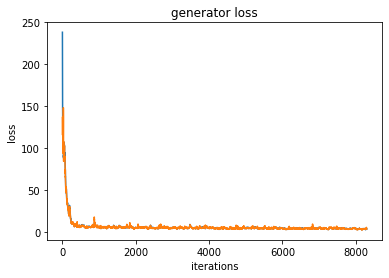

 84%|████████▍ | 8399/10000 [3:38:44<40:54,  1.53s/it]

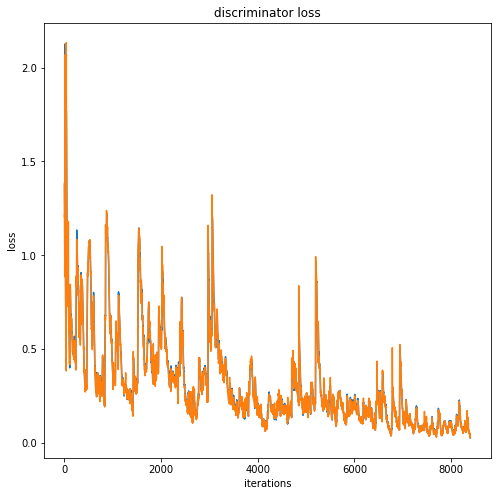

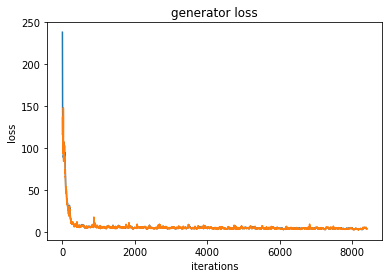

 85%|████████▍ | 8499/10000 [3:41:11<35:21,  1.41s/it]

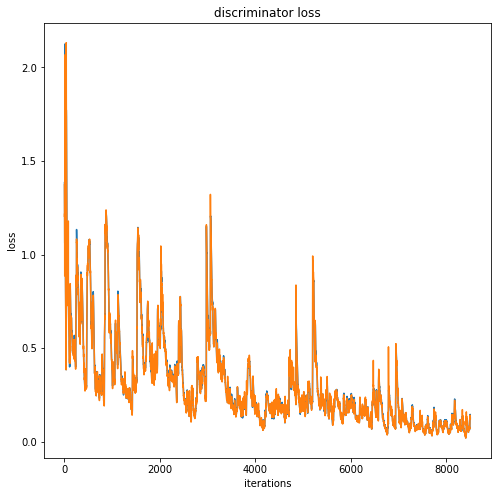

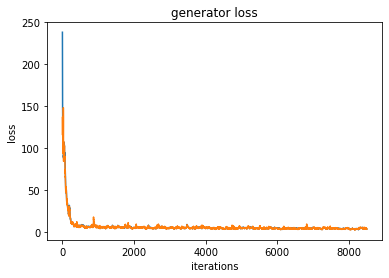

 86%|████████▌ | 8599/10000 [3:43:37<35:12,  1.51s/it]

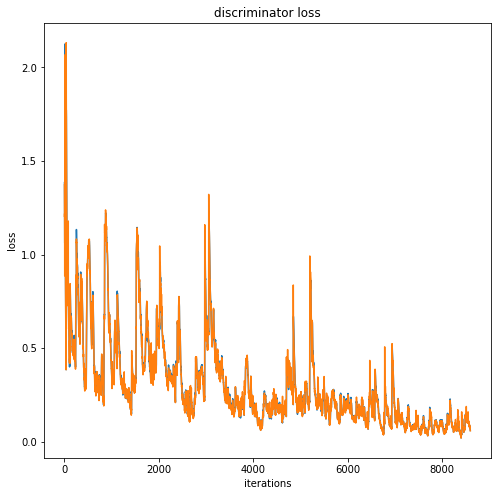

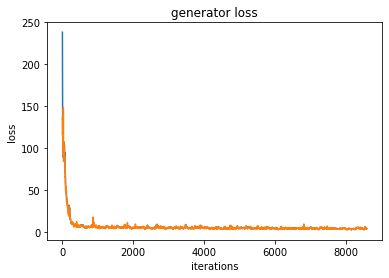

 87%|████████▋ | 8699/10000 [3:46:06<31:08,  1.44s/it]

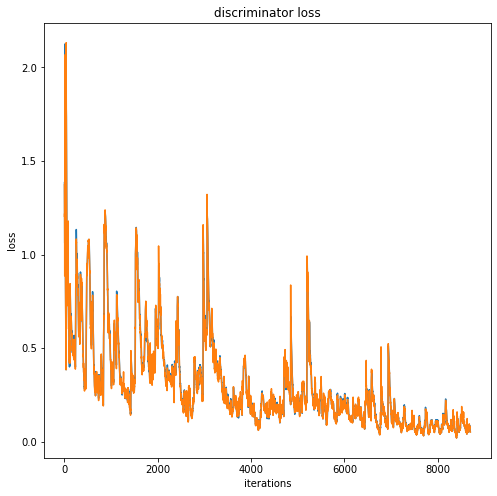

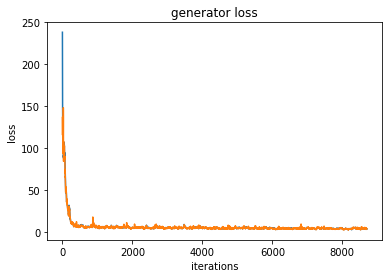

 88%|████████▊ | 8799/10000 [3:48:49<32:41,  1.63s/it]

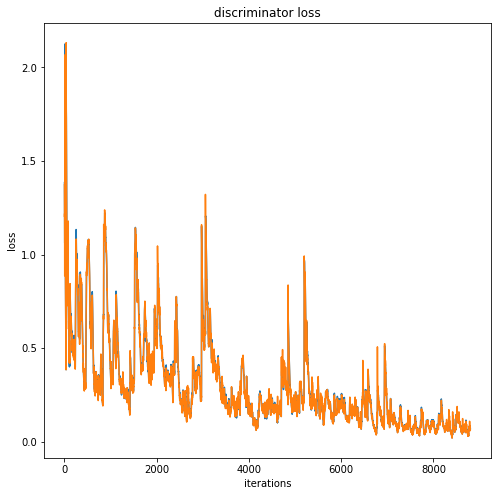

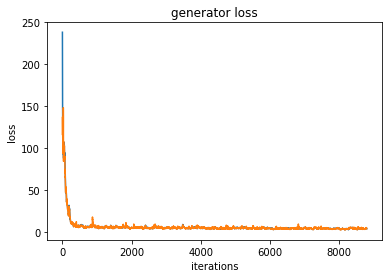

 89%|████████▉ | 8899/10000 [3:51:29<29:19,  1.60s/it]

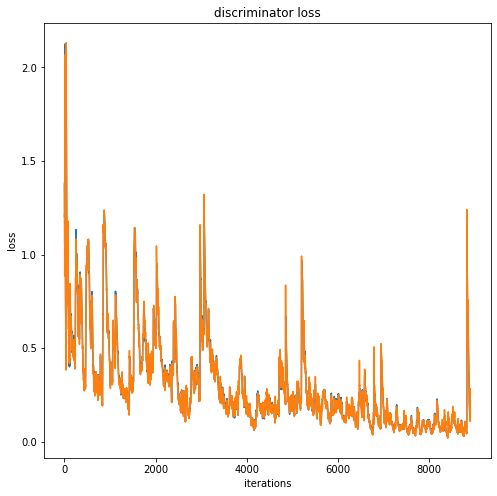

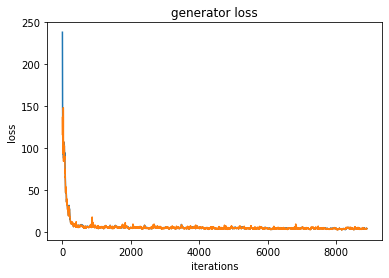

 90%|████████▉ | 8999/10000 [3:54:17<27:25,  1.64s/it]

Iteration 9000/703023: dis loss = 0.2559, gen loss = 2.2623


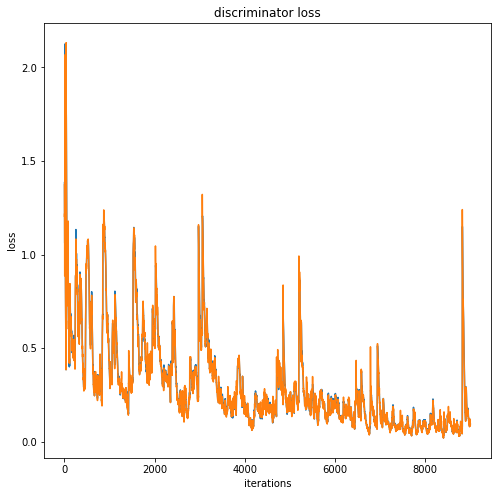

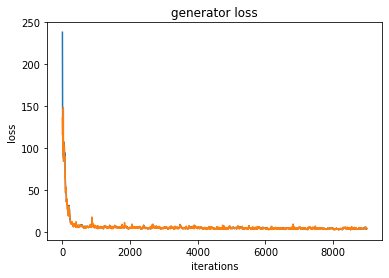

 91%|█████████ | 9099/10000 [3:56:55<25:16,  1.68s/it]

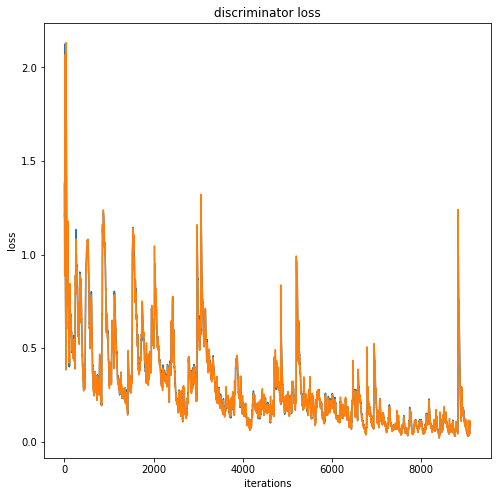

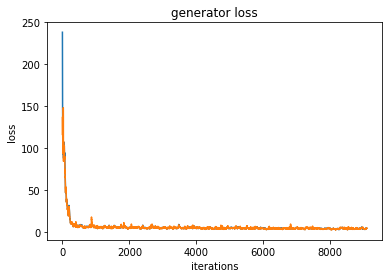

 92%|█████████▏| 9199/10000 [3:59:30<21:06,  1.58s/it]

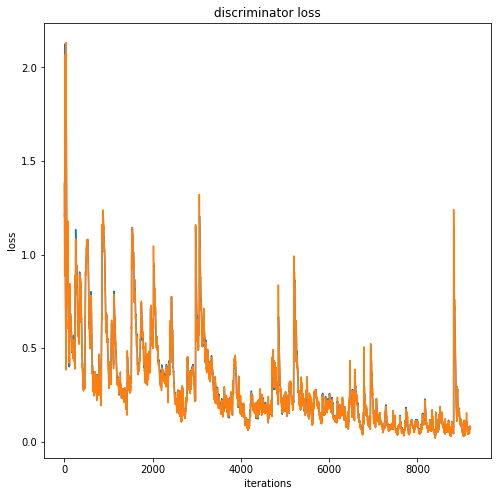

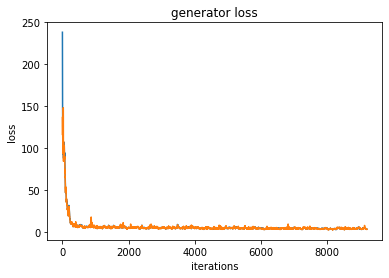

 93%|█████████▎| 9299/10000 [4:01:55<17:20,  1.48s/it]

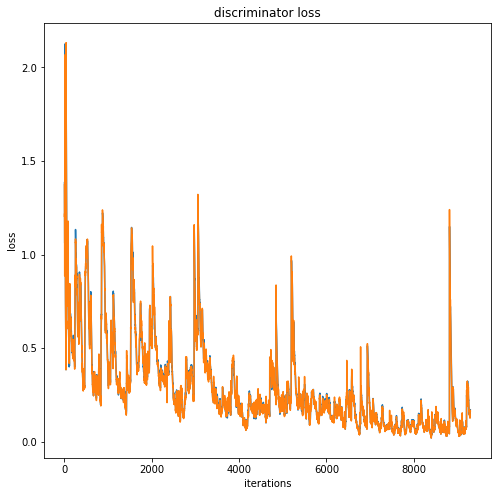

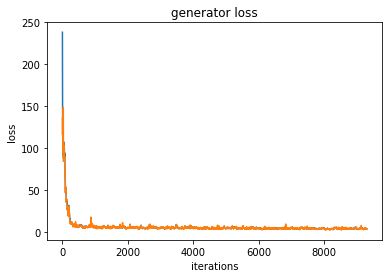

 94%|█████████▍| 9399/10000 [4:04:19<14:59,  1.50s/it]

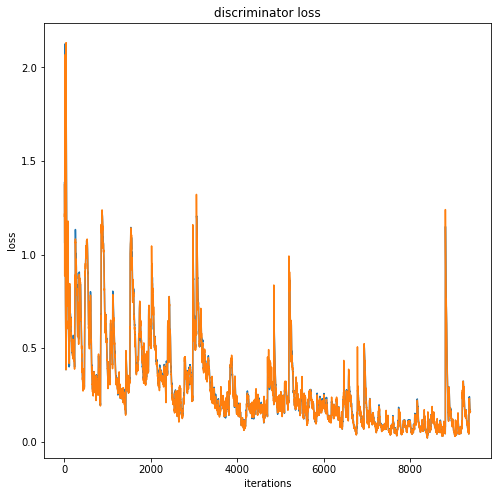

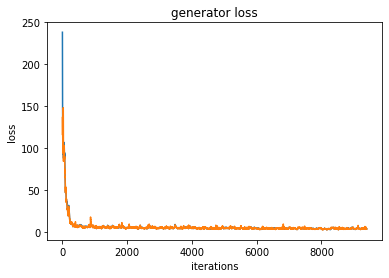

 95%|█████████▍| 9499/10000 [4:06:47<11:56,  1.43s/it]

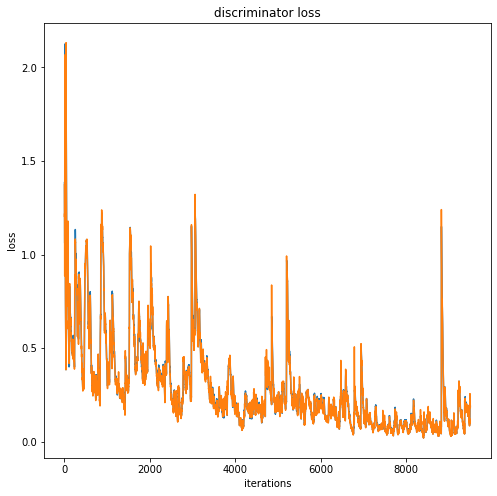

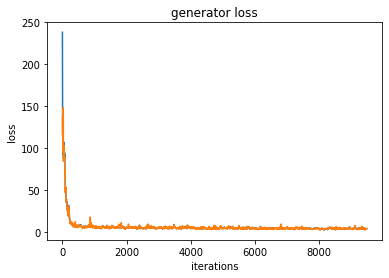

 96%|█████████▌| 9599/10000 [4:09:16<10:43,  1.60s/it]

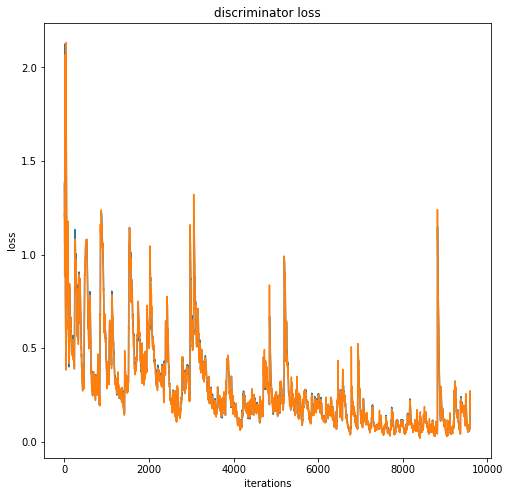

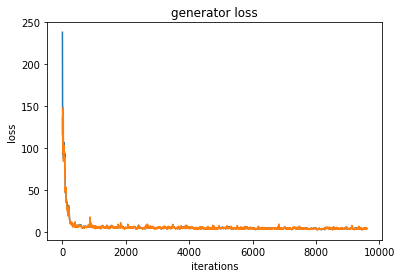

 97%|█████████▋| 9699/10000 [4:11:53<07:58,  1.59s/it]

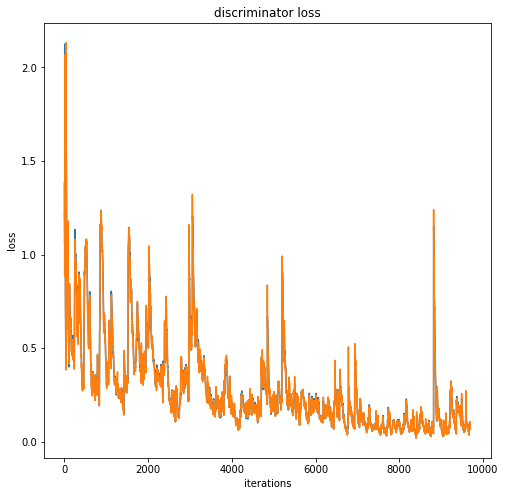

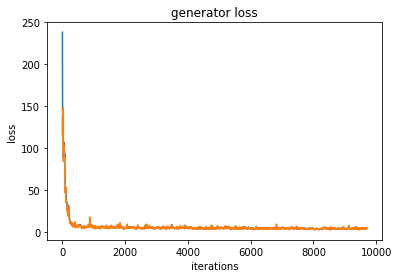

 98%|█████████▊| 9799/10000 [4:14:39<05:26,  1.62s/it]

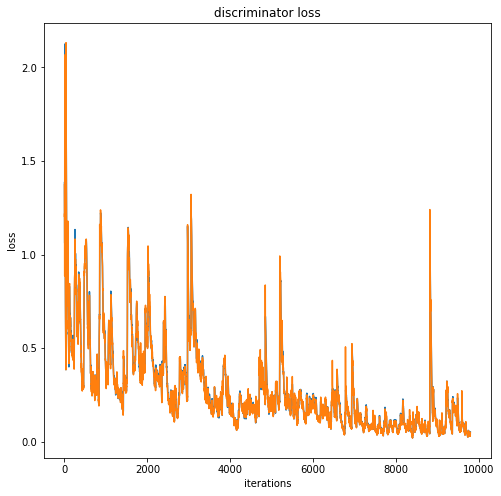

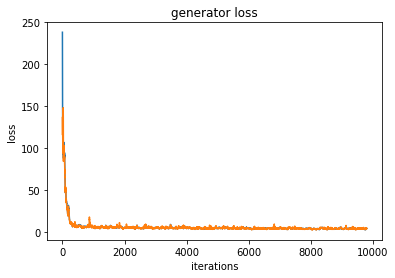

 99%|█████████▉| 9899/10000 [4:17:22<02:37,  1.56s/it]

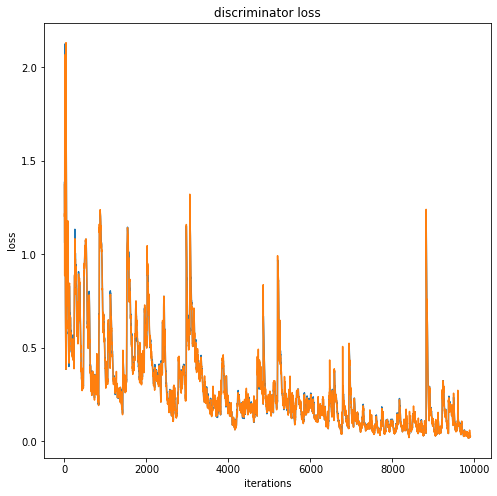

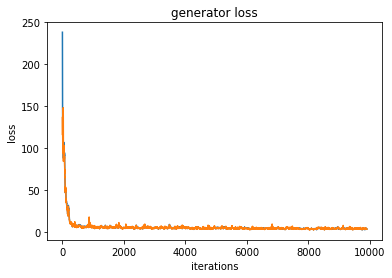

100%|█████████▉| 9999/10000 [4:19:56<00:01,  1.60s/it]

Iteration 10000/703023: dis loss = 0.0237, gen loss = 1.6354


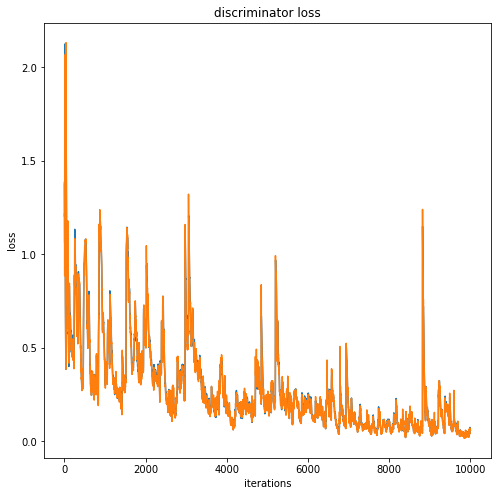

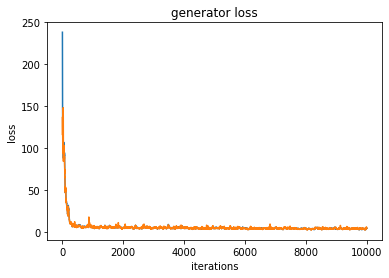

100%|██████████| 10000/10000 [4:19:58<00:00,  1.56s/it]


... Done!


  0%|          | 0/10000 [00:00<?, ?it/s]

Start training ...


  1%|          | 99/10000 [02:43<4:18:25,  1.57s/it]

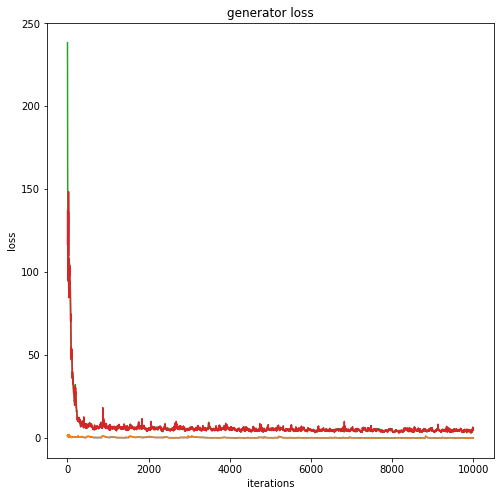

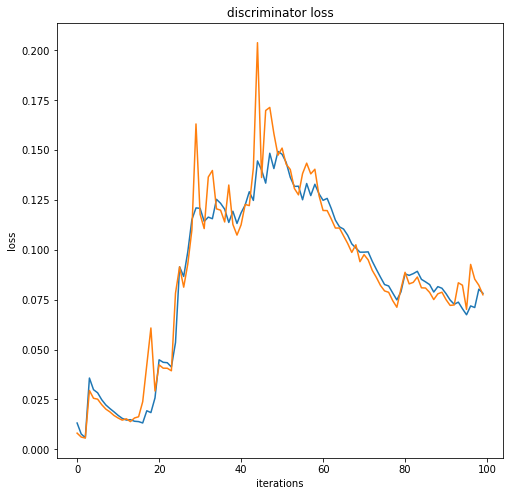

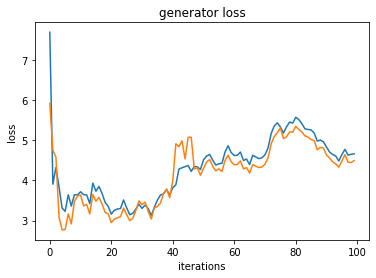

  2%|▏         | 199/10000 [08:04<4:41:28,  1.72s/it]  

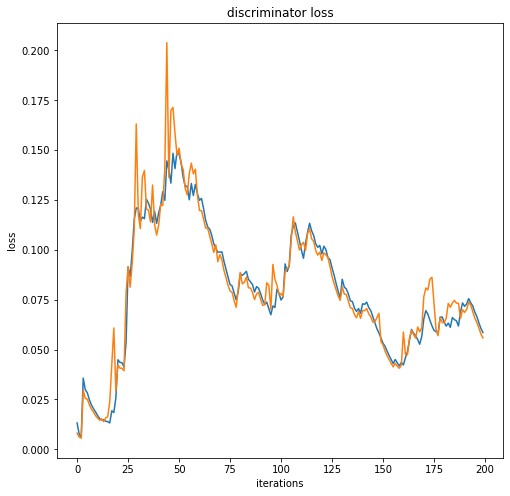

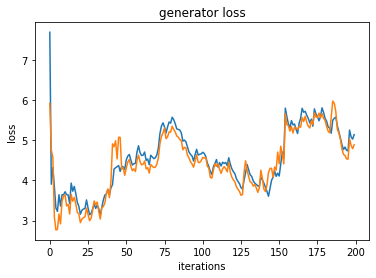

  3%|▎         | 299/10000 [11:00<4:43:03,  1.75s/it]

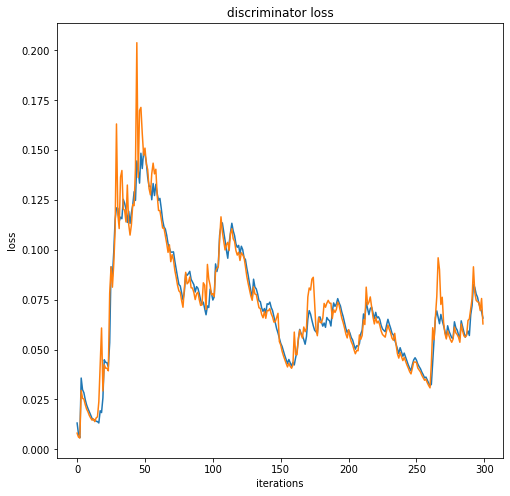

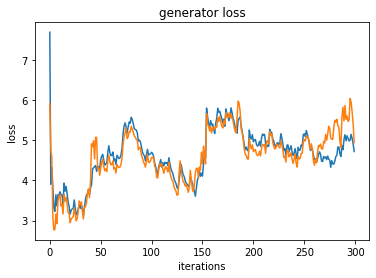

  4%|▍         | 399/10000 [13:52<3:59:41,  1.50s/it]

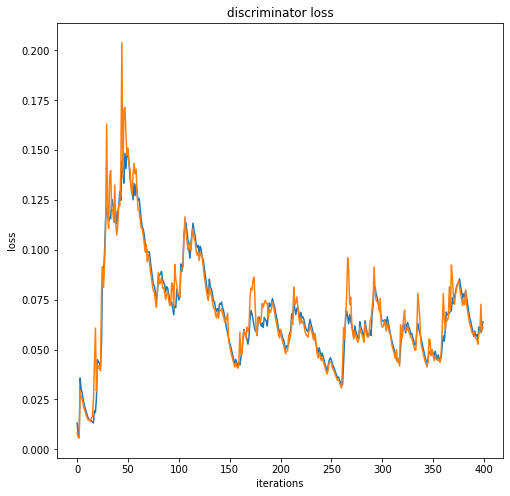

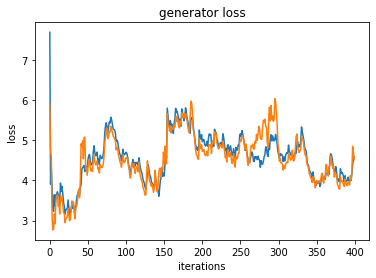

  5%|▍         | 499/10000 [16:21<3:53:16,  1.47s/it]

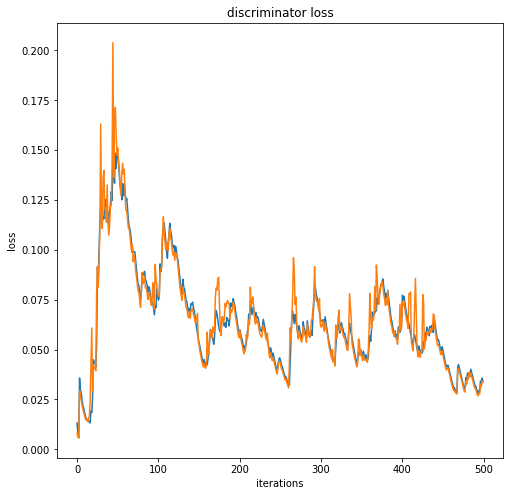

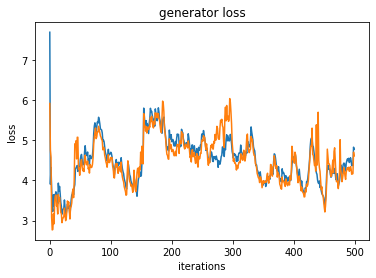

  6%|▌         | 599/10000 [18:50<3:54:01,  1.49s/it]

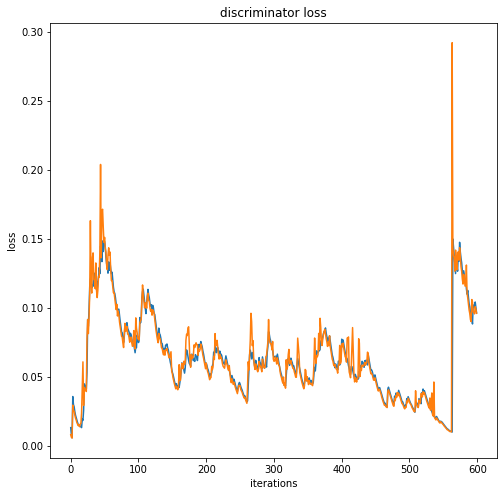

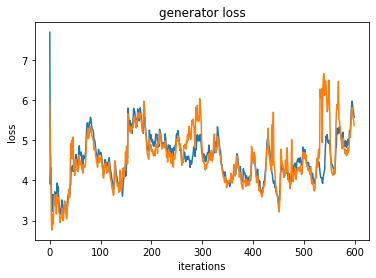

  7%|▋         | 699/10000 [21:19<4:06:01,  1.59s/it]

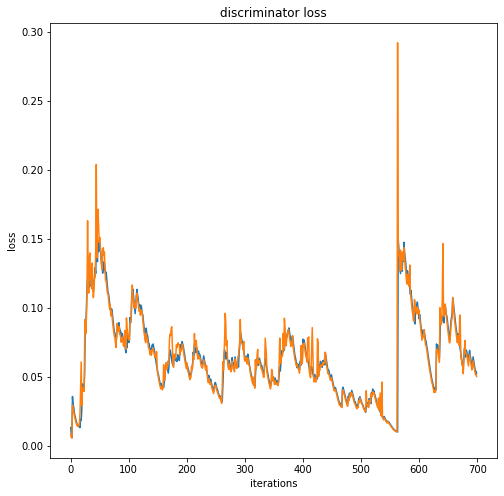

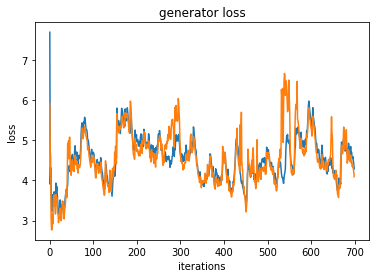

  8%|▊         | 799/10000 [24:06<4:17:00,  1.68s/it]

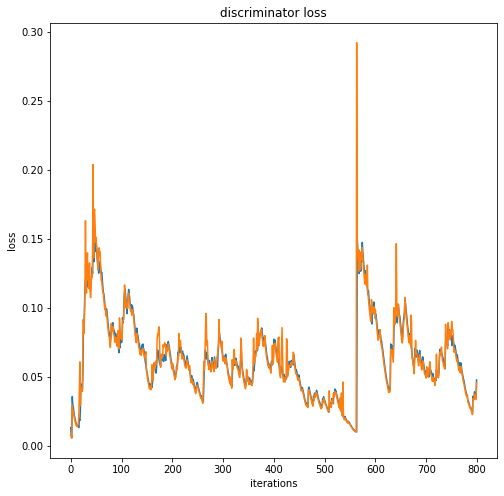

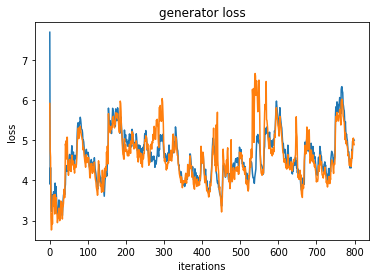

  9%|▉         | 899/10000 [26:55<4:08:40,  1.64s/it]

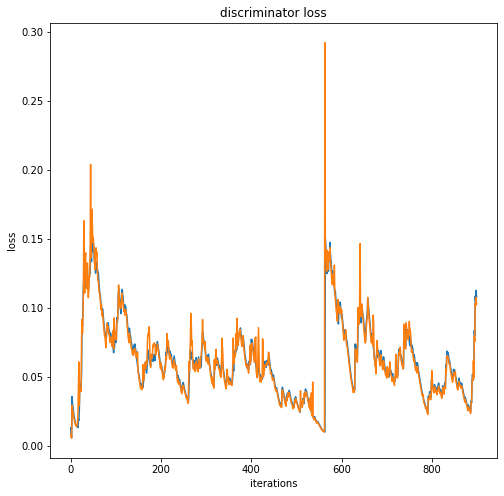

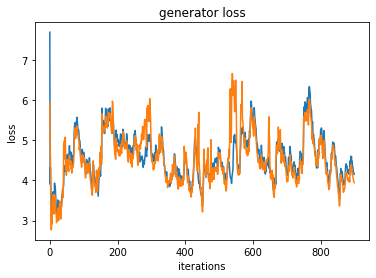

 10%|▉         | 999/10000 [29:34<3:46:59,  1.51s/it]

Iteration 1000/703023: dis loss = 0.0978, gen loss = 1.8848


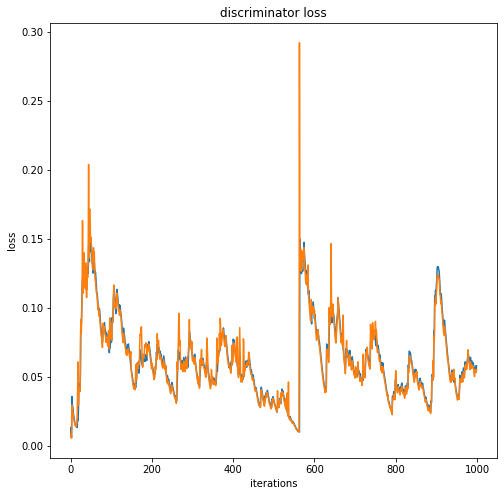

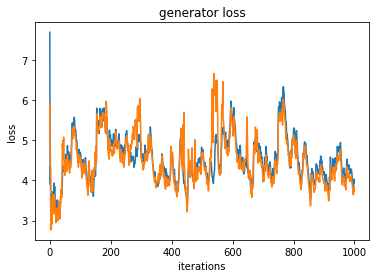

 11%|█         | 1099/10000 [32:14<4:02:59,  1.64s/it]

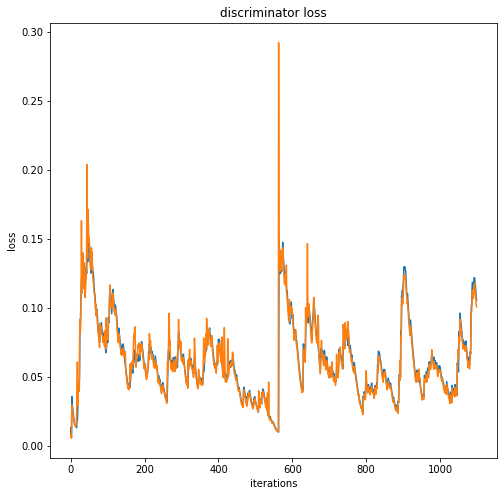

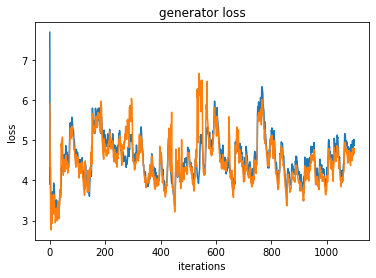

 12%|█▏        | 1199/10000 [35:02<4:05:17,  1.67s/it]

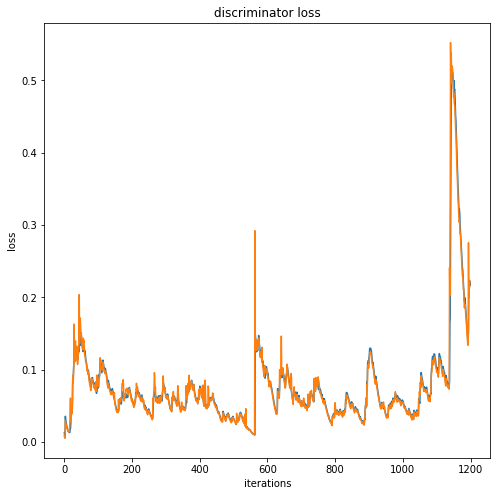

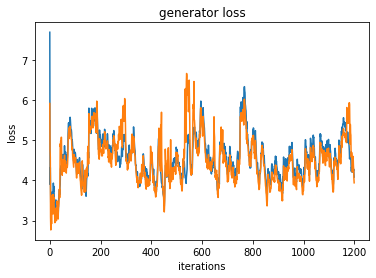

 13%|█▎        | 1299/10000 [37:45<3:47:55,  1.57s/it]

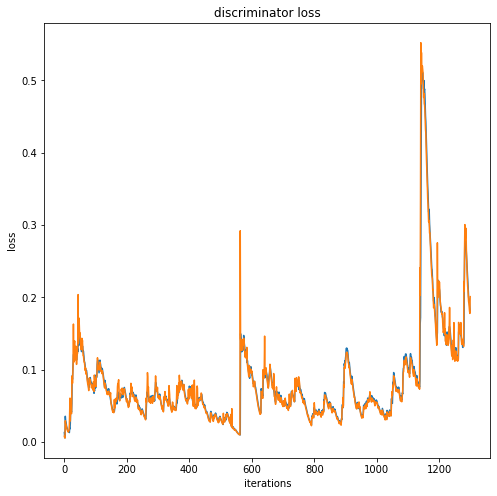

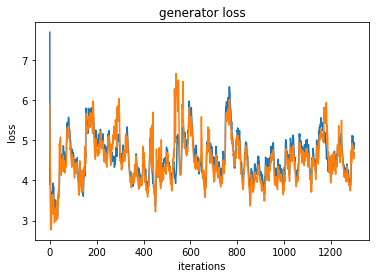

 14%|█▍        | 1399/10000 [40:23<4:03:55,  1.70s/it]

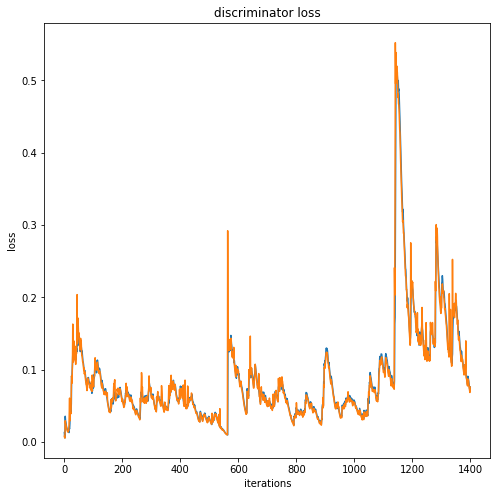

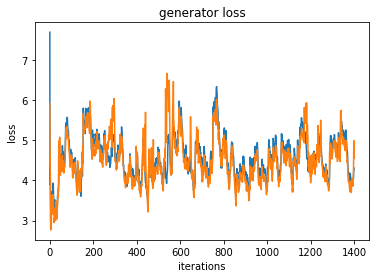

 15%|█▍        | 1499/10000 [42:52<3:30:36,  1.49s/it]

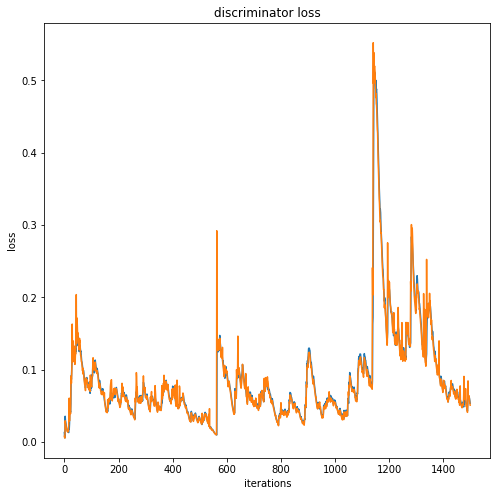

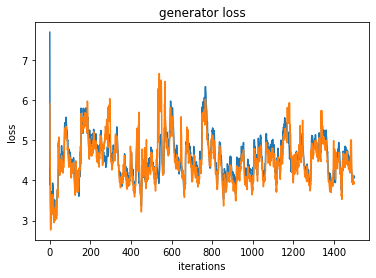

 16%|█▌        | 1599/10000 [45:11<3:11:07,  1.36s/it]

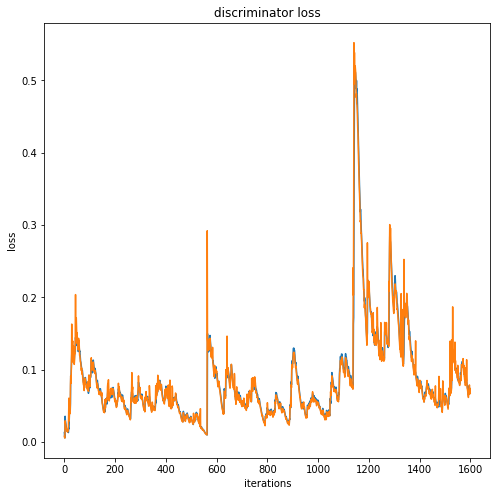

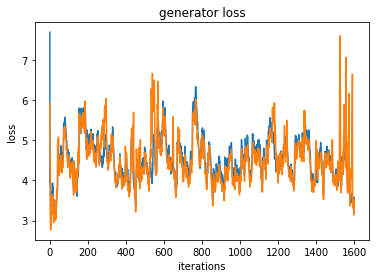

 17%|█▋        | 1699/10000 [47:35<3:32:27,  1.54s/it]

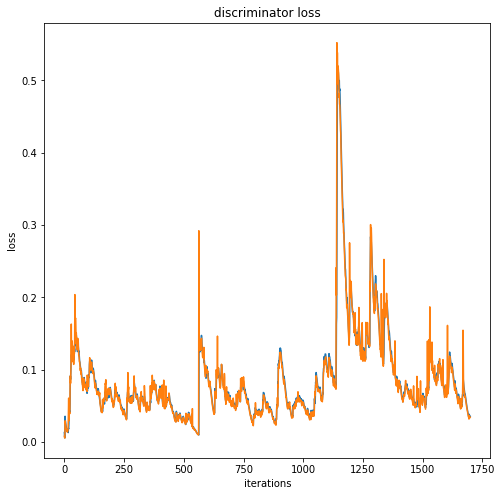

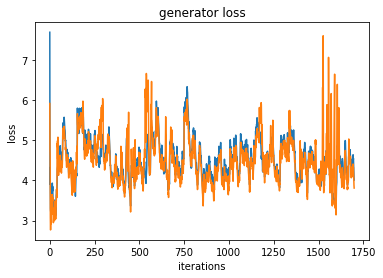

 18%|█▊        | 1799/10000 [50:07<3:24:36,  1.50s/it]

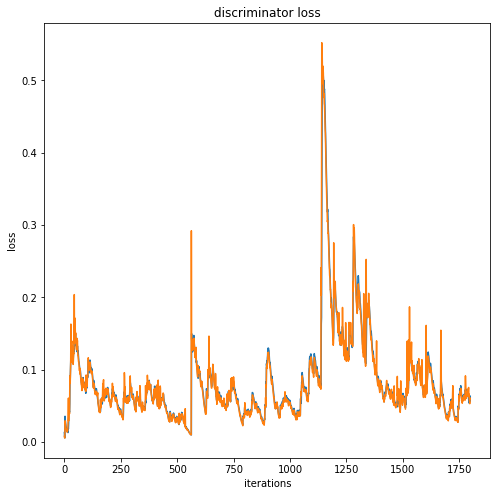

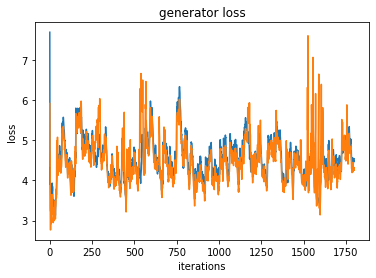

 19%|█▉        | 1899/10000 [52:41<3:33:12,  1.58s/it]

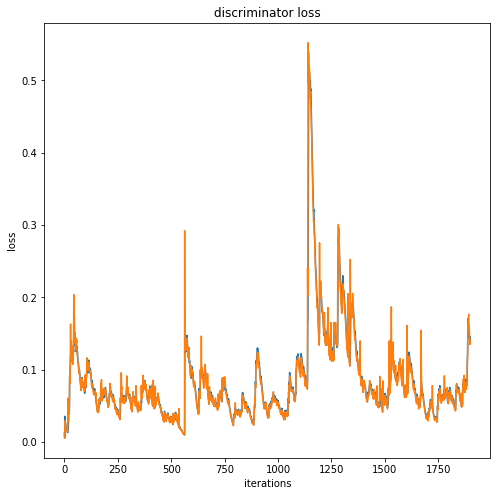

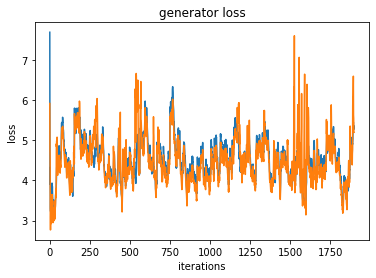

 20%|█▉        | 1999/10000 [55:16<3:27:47,  1.56s/it]

Iteration 2000/703023: dis loss = 0.0231, gen loss = 4.7246


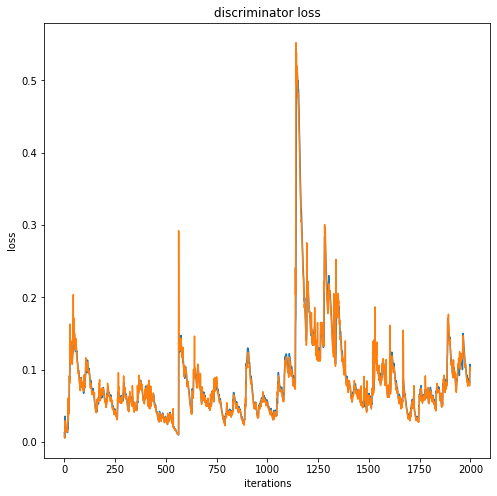

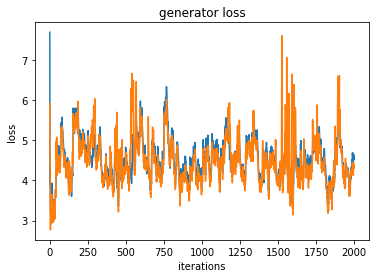

 21%|██        | 2099/10000 [57:48<3:14:26,  1.48s/it]

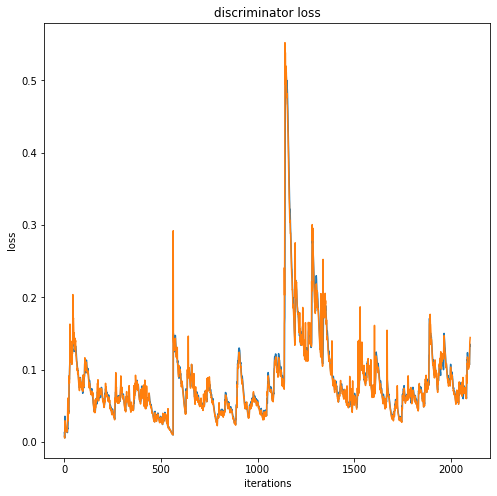

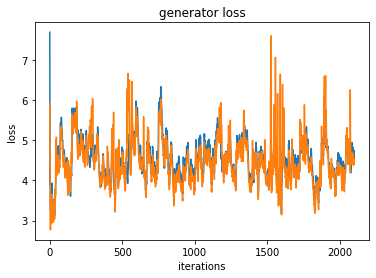

 22%|██▏       | 2199/10000 [1:00:21<3:32:14,  1.63s/it]

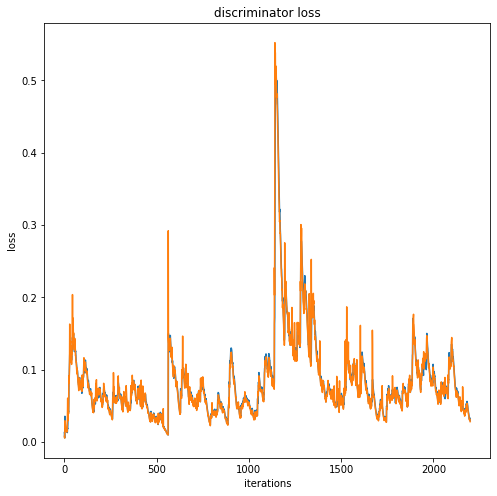

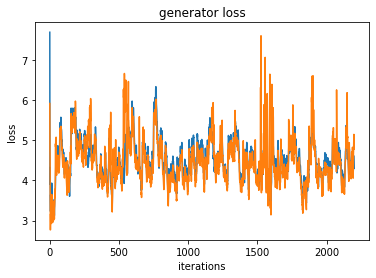

 23%|██▎       | 2299/10000 [1:02:50<2:56:32,  1.38s/it]

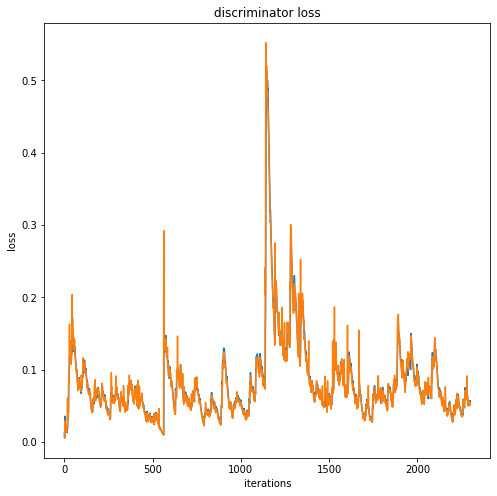

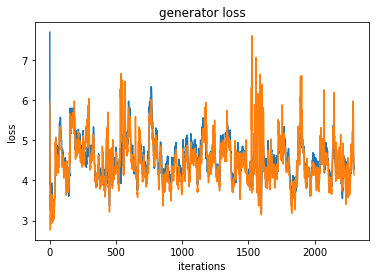

 24%|██▍       | 2399/10000 [1:05:15<3:11:10,  1.51s/it]

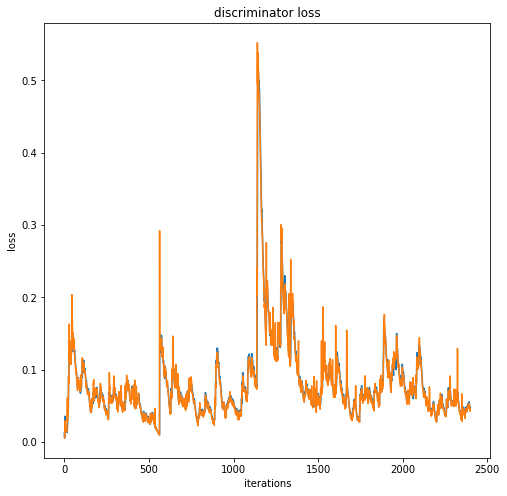

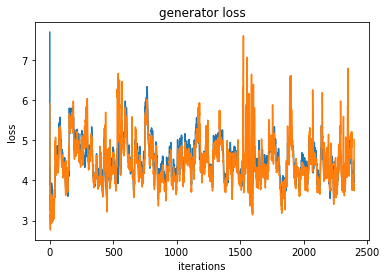

 25%|██▍       | 2499/10000 [1:07:43<3:02:34,  1.46s/it]

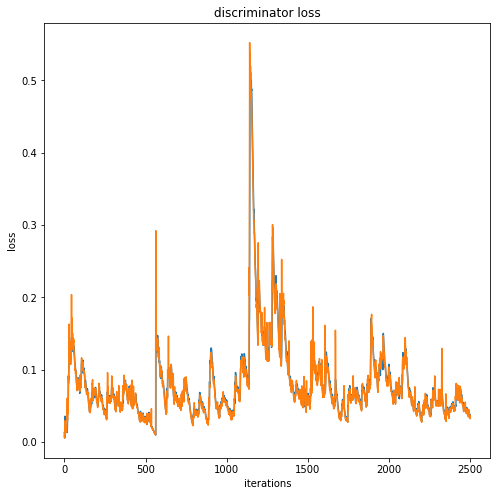

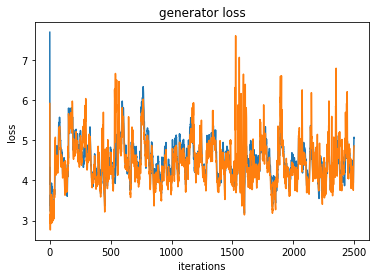

 26%|██▌       | 2599/10000 [1:10:12<3:03:11,  1.49s/it]

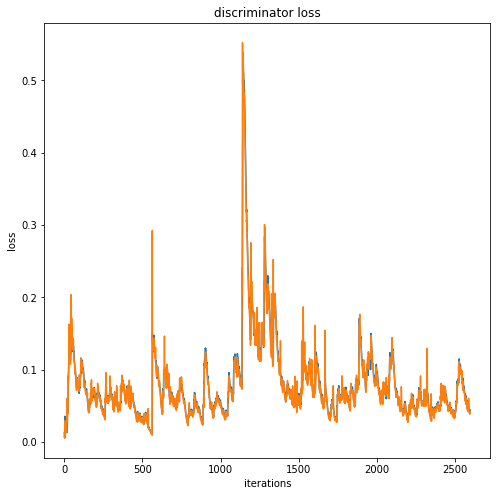

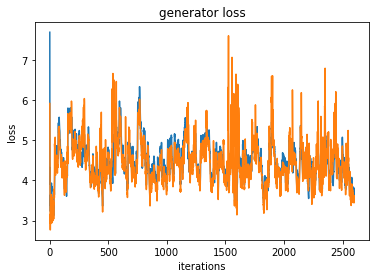

 27%|██▋       | 2699/10000 [1:12:46<3:12:15,  1.58s/it]

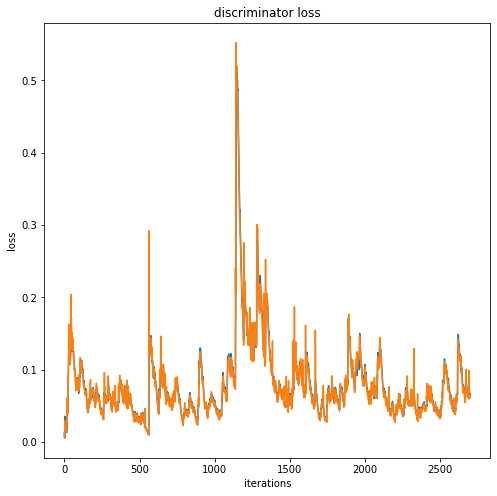

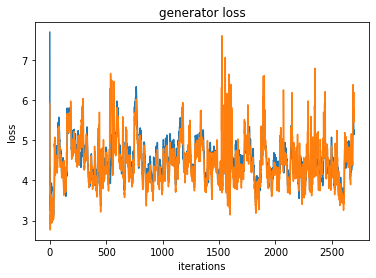

 28%|██▊       | 2799/10000 [1:15:16<2:54:47,  1.46s/it]

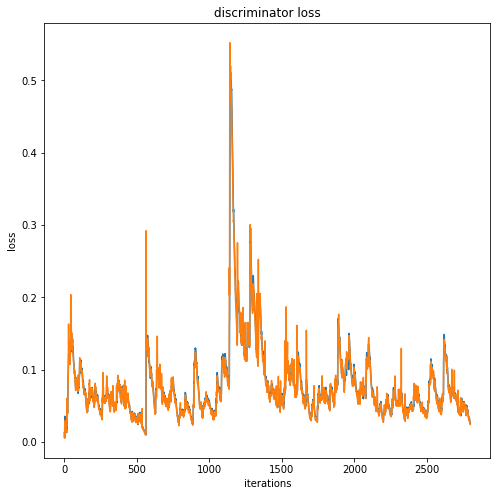

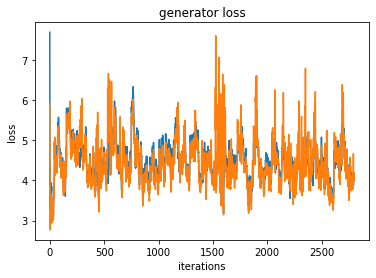

 29%|██▉       | 2899/10000 [1:17:51<3:10:39,  1.61s/it]

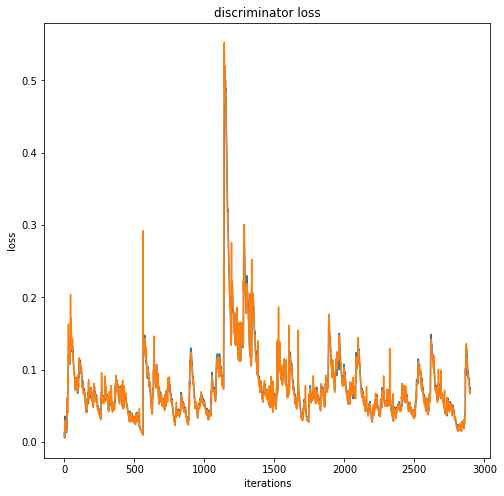

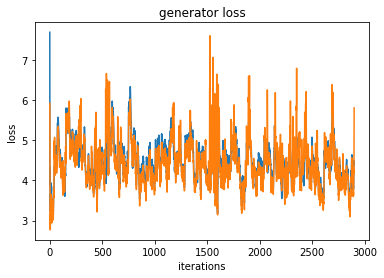

 30%|██▉       | 2999/10000 [1:20:17<2:42:40,  1.39s/it]

Iteration 3000/703023: dis loss = 0.2076, gen loss = 3.2459


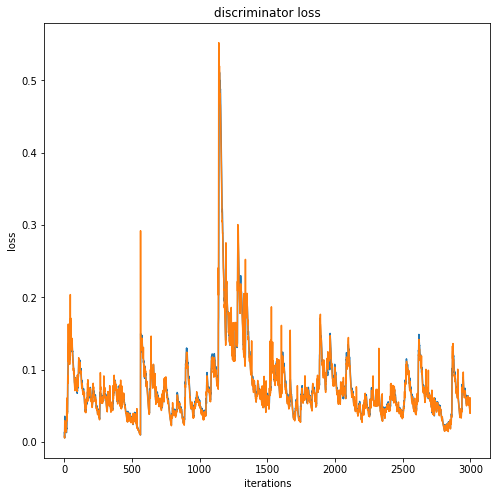

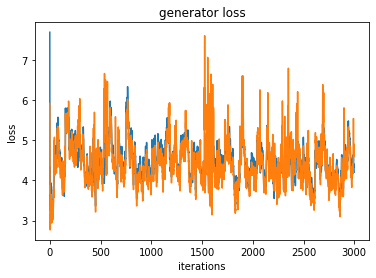

 31%|███       | 3099/10000 [1:22:42<2:46:39,  1.45s/it]

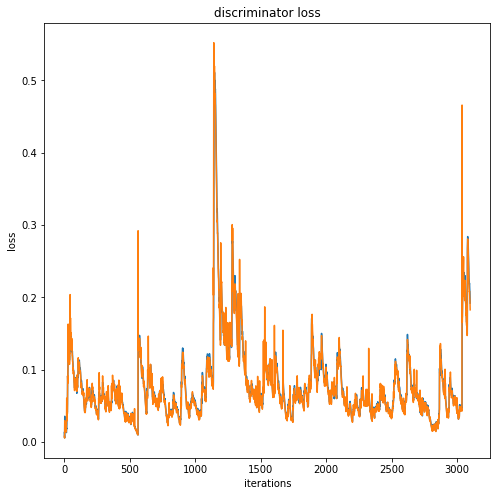

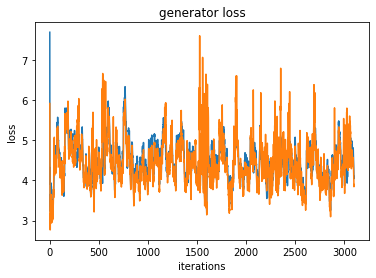

 32%|███▏      | 3199/10000 [1:25:09<2:52:40,  1.52s/it]

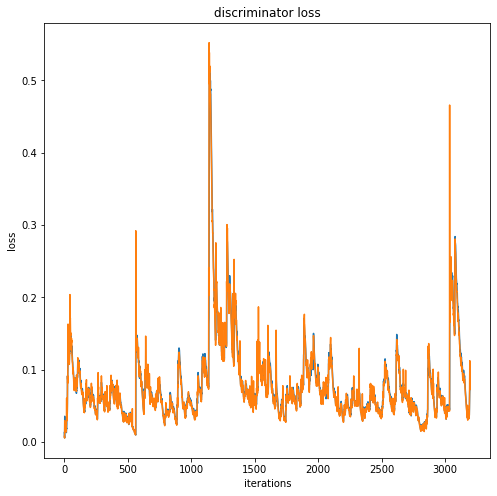

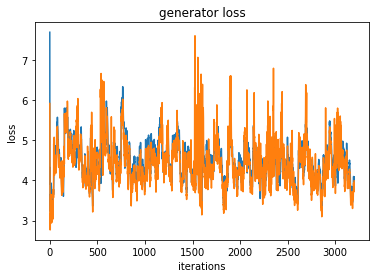

 33%|███▎      | 3299/10000 [1:27:40<2:51:11,  1.53s/it]

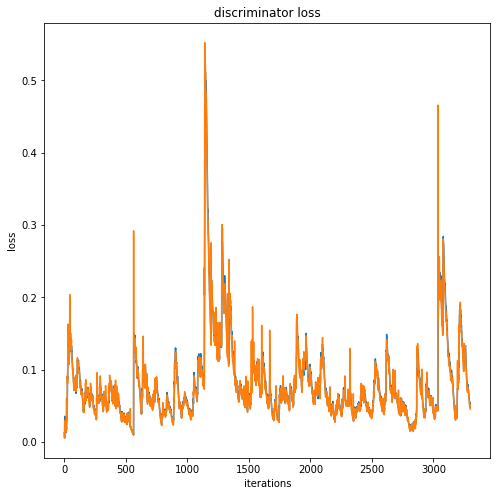

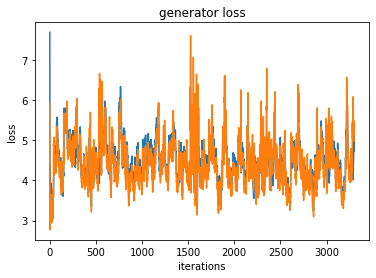

 34%|███▍      | 3399/10000 [1:30:10<2:43:43,  1.49s/it]

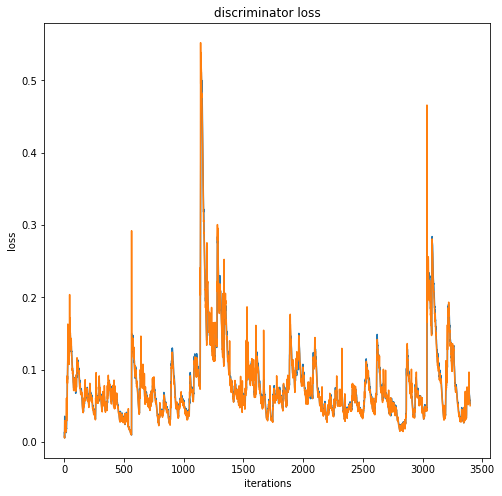

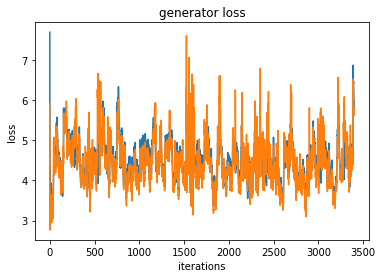

 35%|███▍      | 3499/10000 [1:32:30<2:36:02,  1.44s/it]

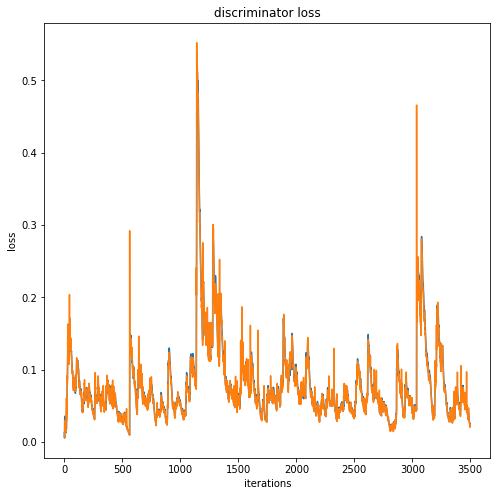

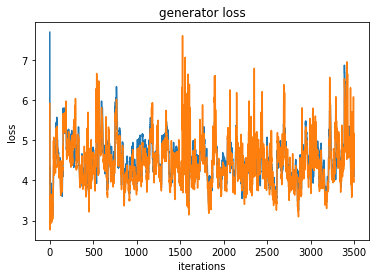

 36%|███▌      | 3599/10000 [1:34:58<2:41:06,  1.51s/it]

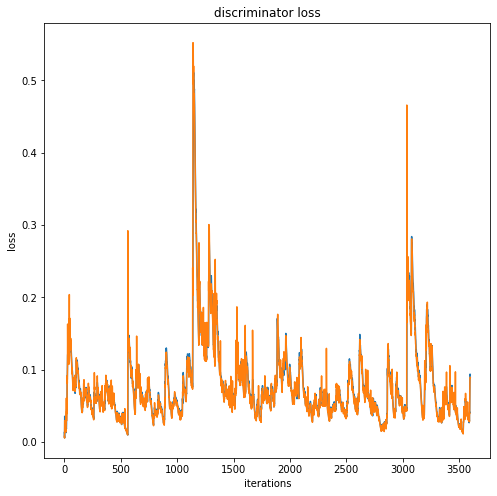

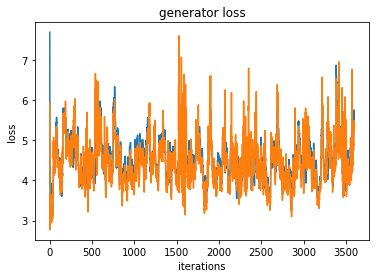

 37%|███▋      | 3699/10000 [1:37:29<2:34:26,  1.47s/it]

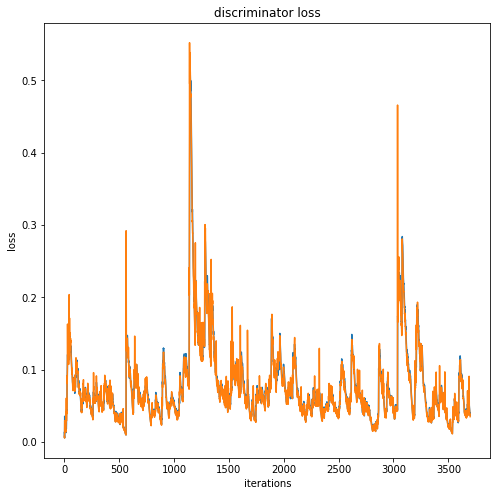

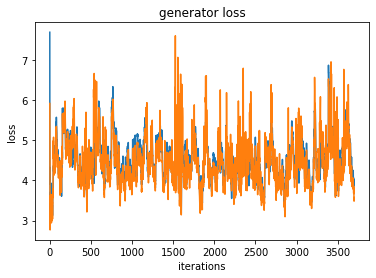

 38%|███▊      | 3799/10000 [1:40:03<2:36:04,  1.51s/it]

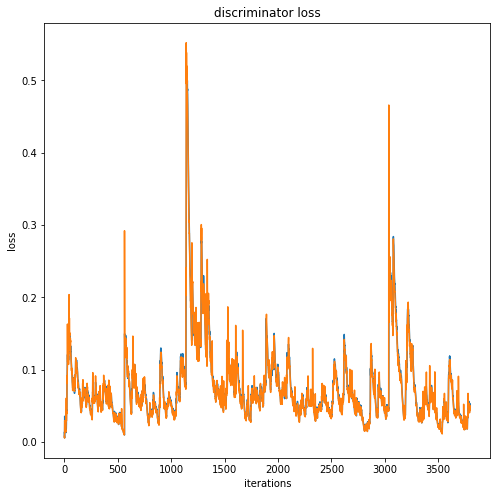

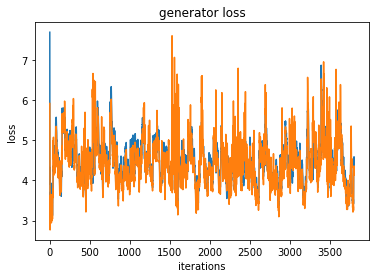

 39%|███▉      | 3899/10000 [1:42:41<2:44:39,  1.62s/it]

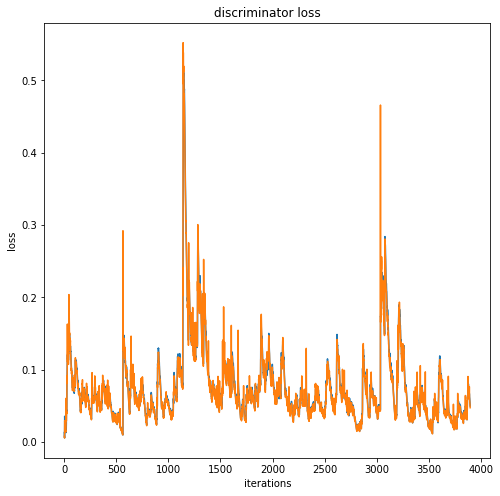

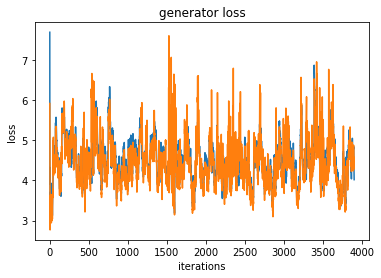

 40%|███▉      | 3999/10000 [1:45:18<2:30:17,  1.50s/it]

Iteration 4000/703023: dis loss = 0.0381, gen loss = 3.7119


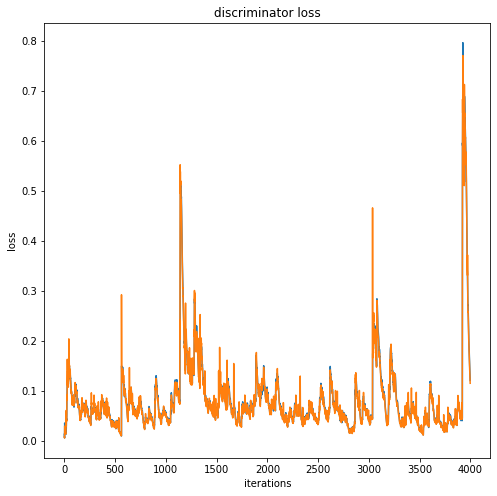

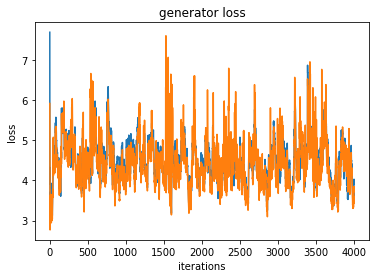

 41%|████      | 4099/10000 [1:47:51<2:33:50,  1.56s/it]

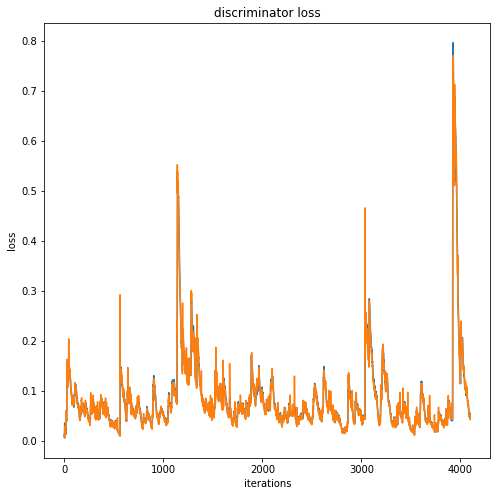

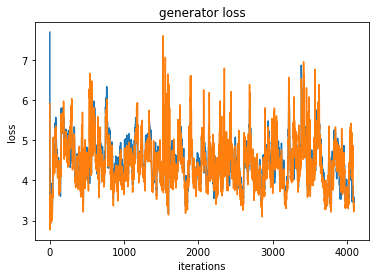

 42%|████▏     | 4199/10000 [1:50:26<2:23:05,  1.48s/it]

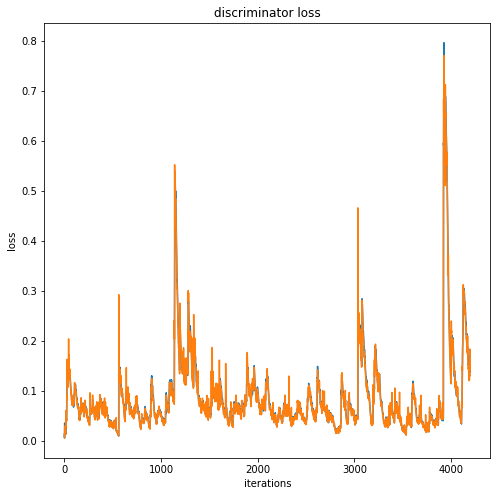

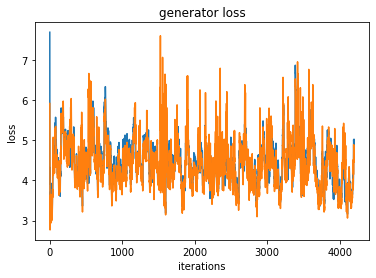

 43%|████▎     | 4299/10000 [1:52:56<2:27:37,  1.55s/it]

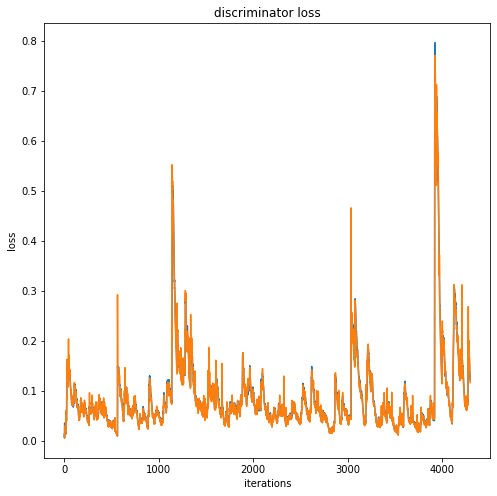

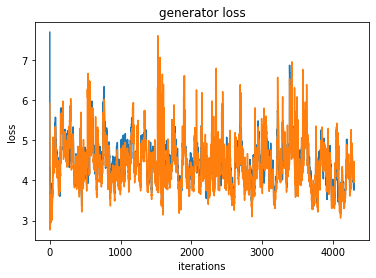

 44%|████▍     | 4399/10000 [1:55:35<2:12:05,  1.42s/it]

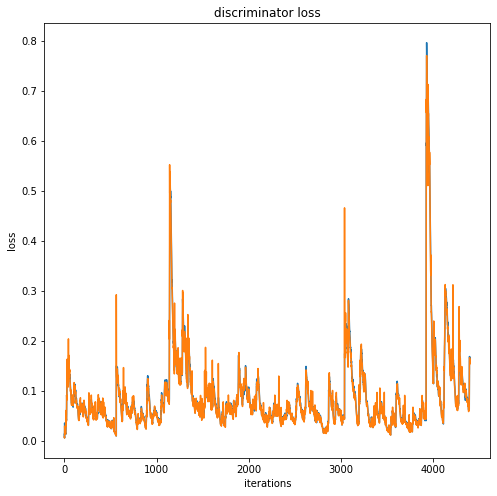

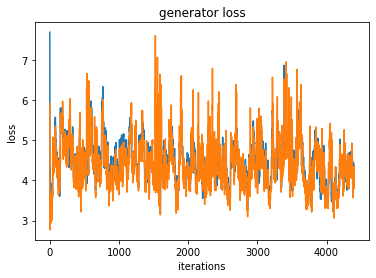

 45%|████▍     | 4499/10000 [1:57:57<2:17:21,  1.50s/it]

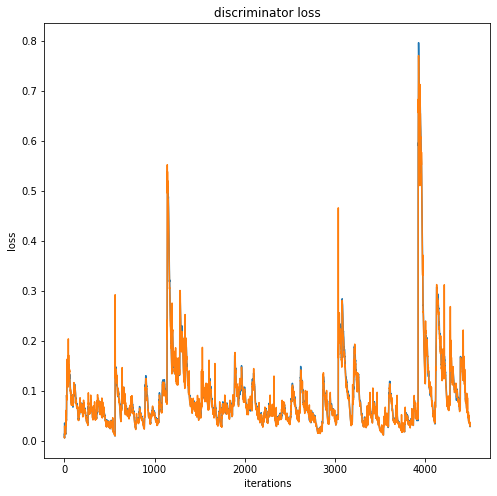

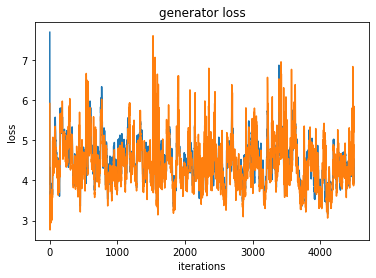

 46%|████▌     | 4599/10000 [2:00:25<2:15:22,  1.50s/it]

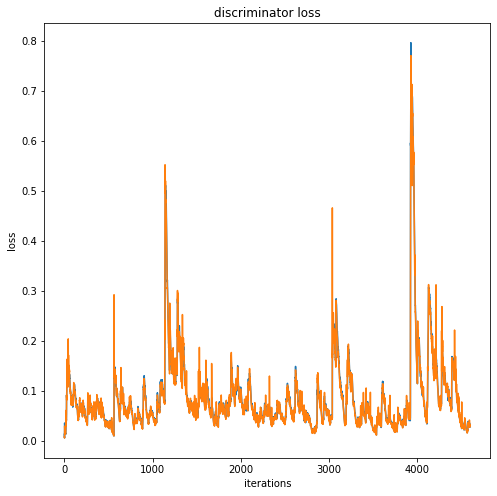

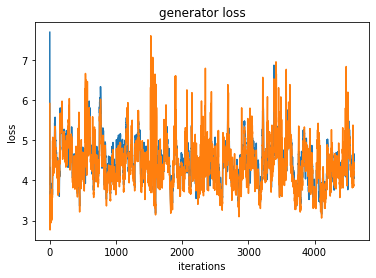

 47%|████▋     | 4699/10000 [2:02:54<2:09:19,  1.46s/it]

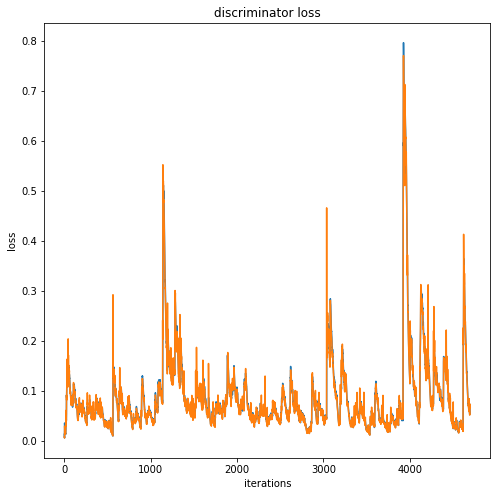

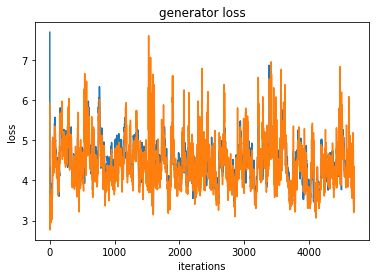

 48%|████▊     | 4799/10000 [2:05:30<2:21:06,  1.63s/it]

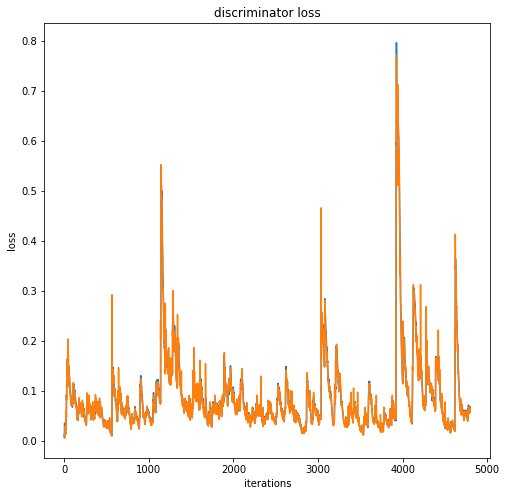

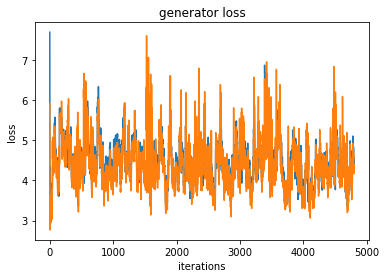

 49%|████▉     | 4899/10000 [2:08:06<2:03:50,  1.46s/it]

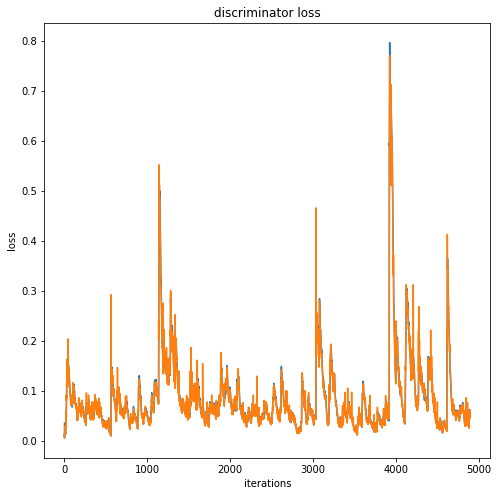

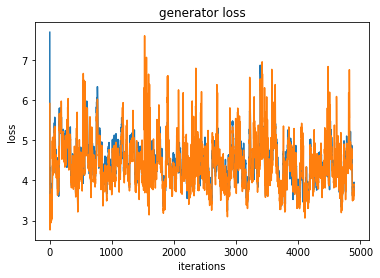

 50%|████▉     | 4999/10000 [2:10:37<2:10:30,  1.57s/it]

Iteration 5000/703023: dis loss = 0.0413, gen loss = 1.5934


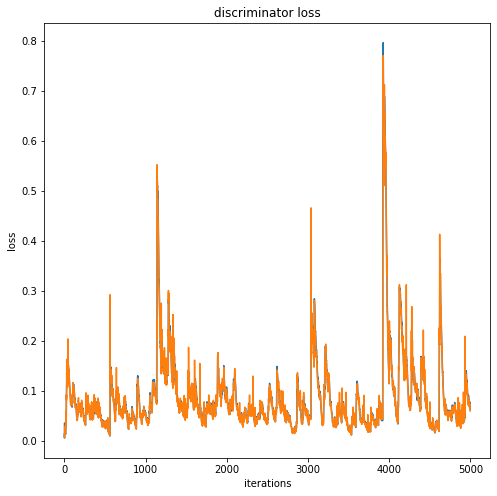

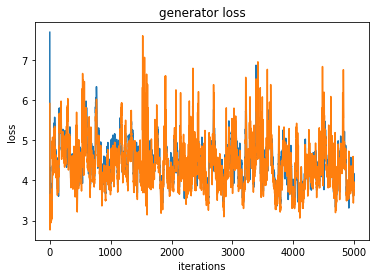

 51%|█████     | 5099/10000 [2:13:05<1:54:57,  1.41s/it]

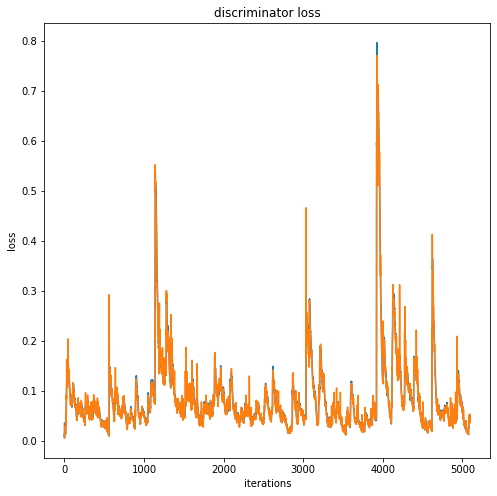

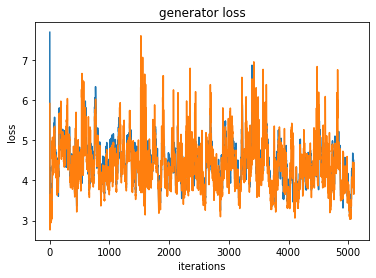

 52%|█████▏    | 5199/10000 [2:15:26<1:53:22,  1.42s/it]

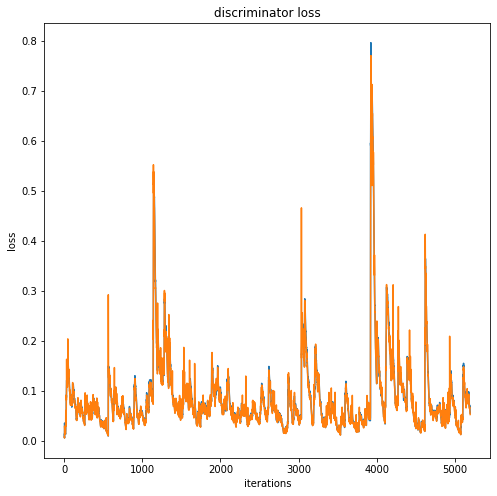

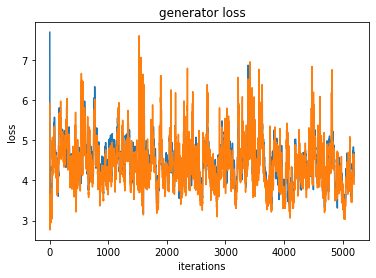

 53%|█████▎    | 5299/10000 [2:17:49<1:48:08,  1.38s/it]

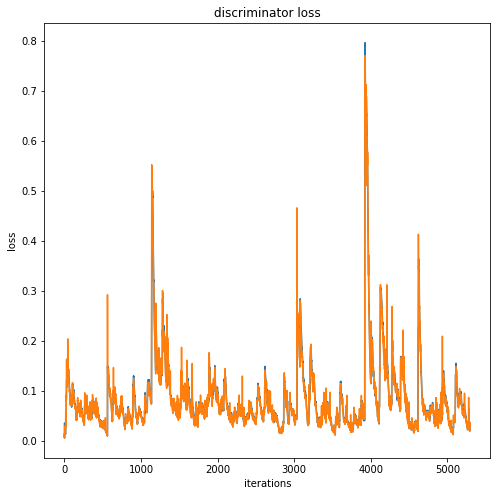

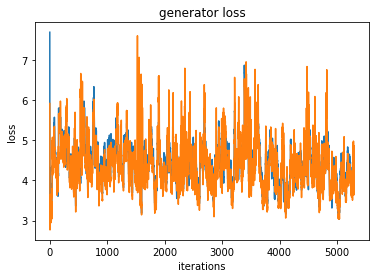

 54%|█████▍    | 5399/10000 [2:20:09<1:53:36,  1.48s/it]

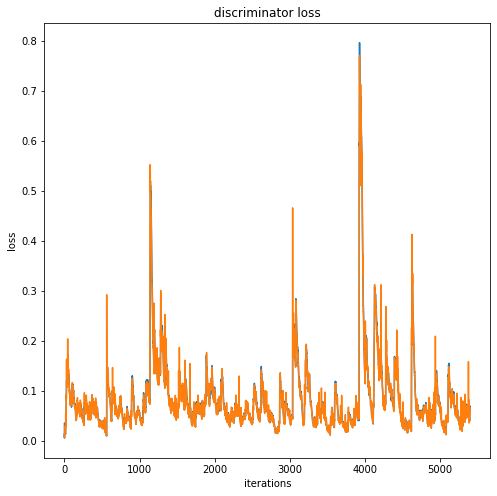

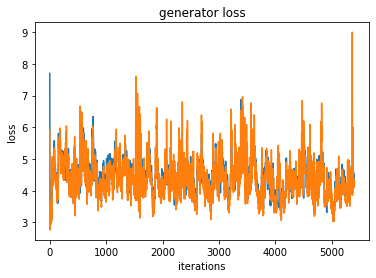

 55%|█████▍    | 5499/10000 [2:22:34<1:48:39,  1.45s/it]

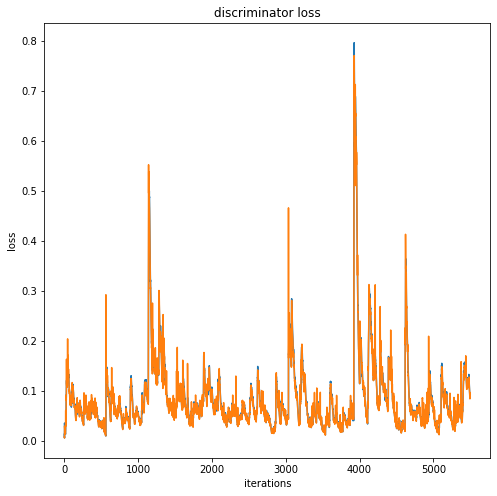

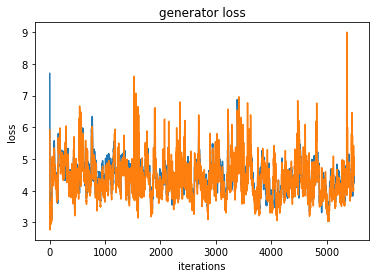

 56%|█████▌    | 5599/10000 [2:24:57<1:41:57,  1.39s/it]

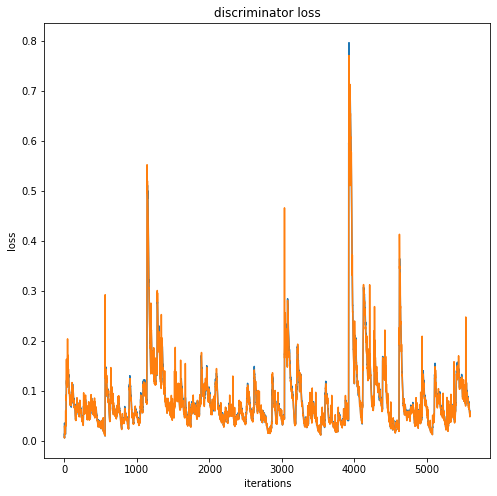

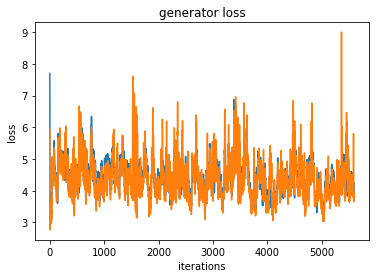

 57%|█████▋    | 5699/10000 [2:27:31<1:52:11,  1.57s/it]

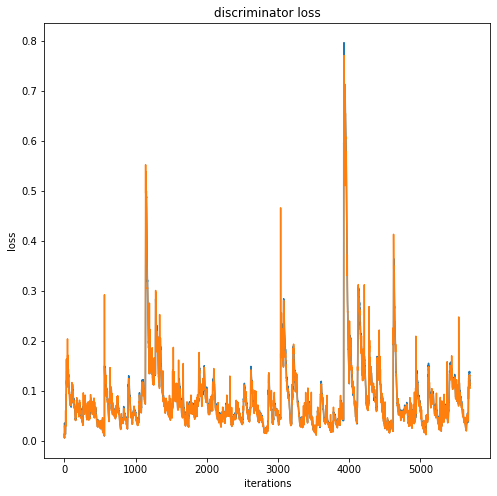

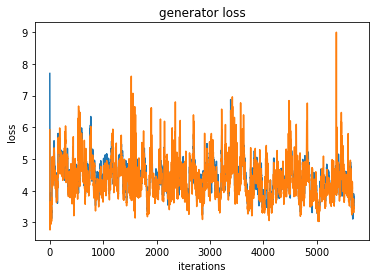

 58%|█████▊    | 5799/10000 [2:30:08<1:43:36,  1.48s/it]

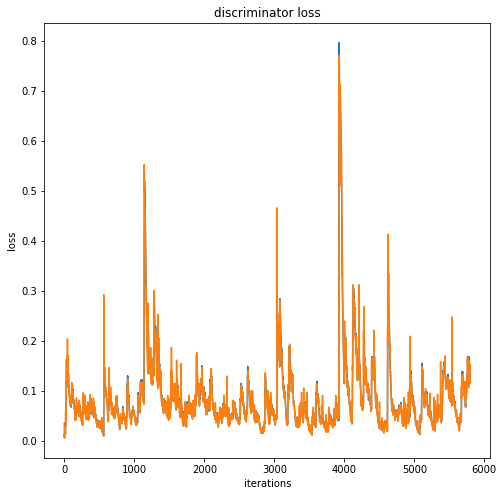

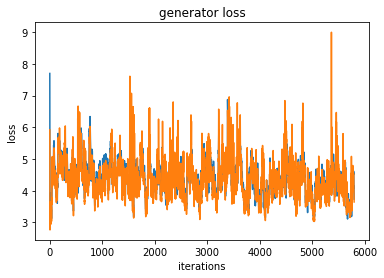

 59%|█████▉    | 5899/10000 [2:32:42<1:45:48,  1.55s/it]

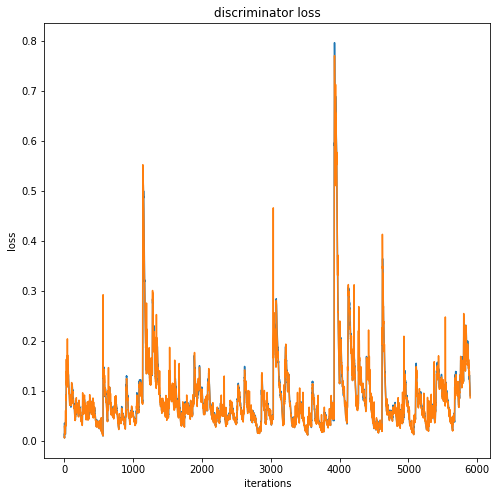

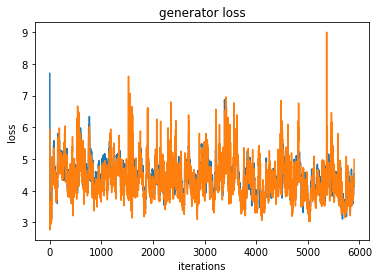

 60%|█████▉    | 5999/10000 [2:35:21<1:45:01,  1.57s/it]

Iteration 6000/703023: dis loss = 0.1085, gen loss = 1.8989


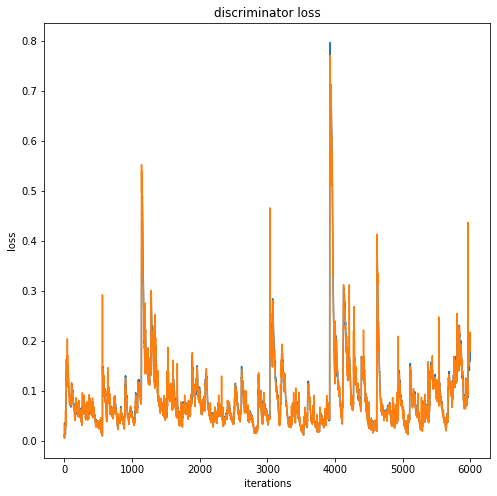

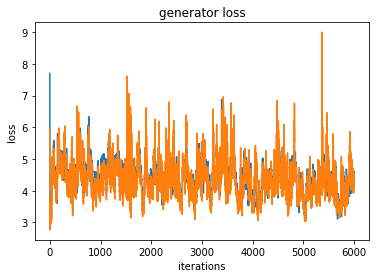

 61%|██████    | 6099/10000 [2:37:54<1:51:47,  1.72s/it]

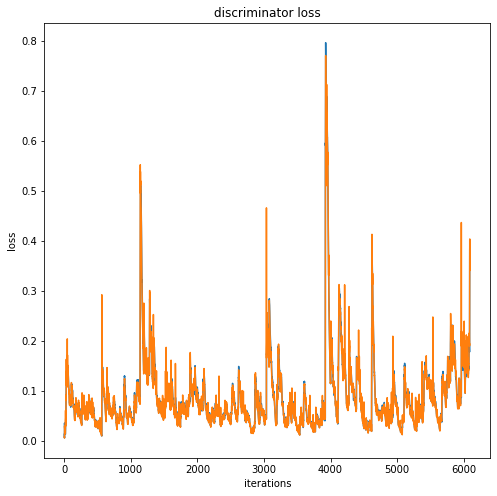

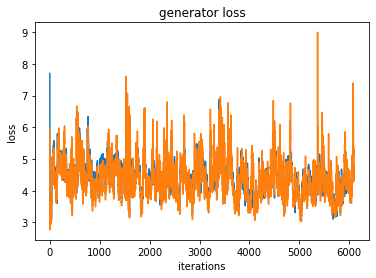

 62%|██████▏   | 6199/10000 [2:40:33<1:31:37,  1.45s/it]

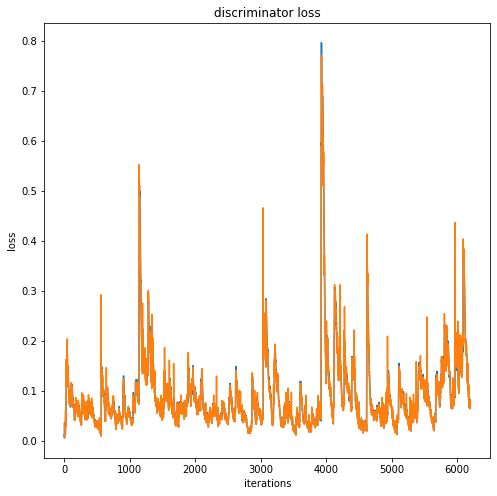

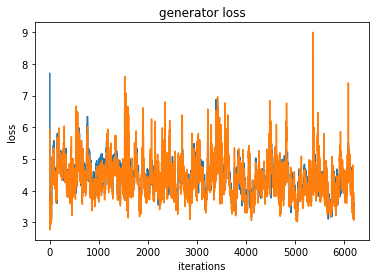

 63%|██████▎   | 6299/10000 [2:43:02<1:40:32,  1.63s/it]

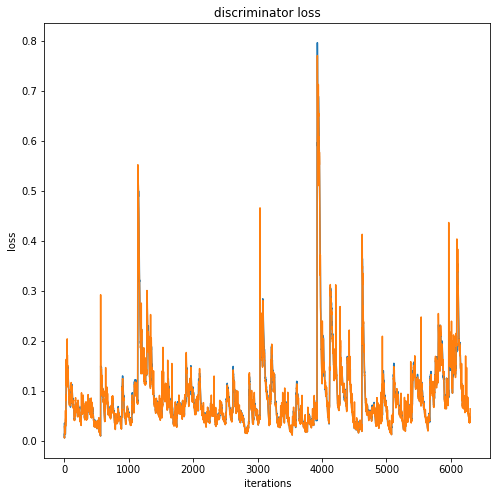

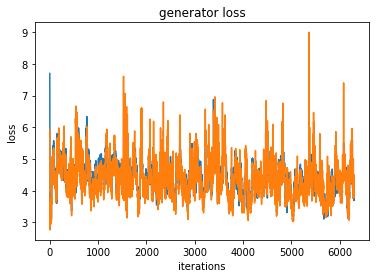

 64%|██████▍   | 6399/10000 [2:45:39<1:34:13,  1.57s/it]

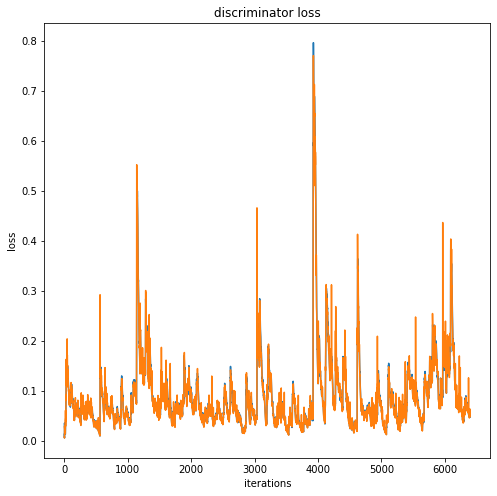

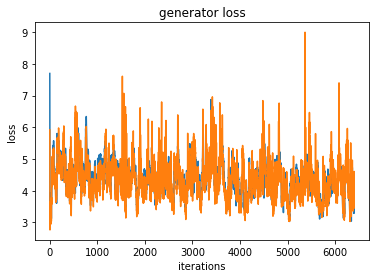

 65%|██████▍   | 6499/10000 [2:48:25<1:36:48,  1.66s/it]

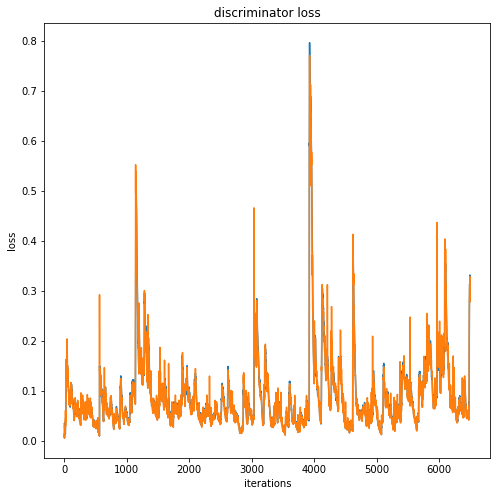

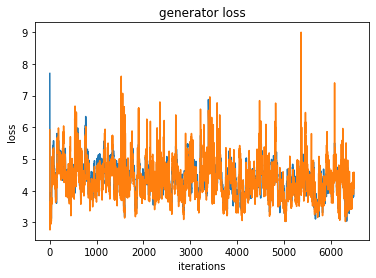

 66%|██████▌   | 6599/10000 [2:50:59<1:26:32,  1.53s/it]

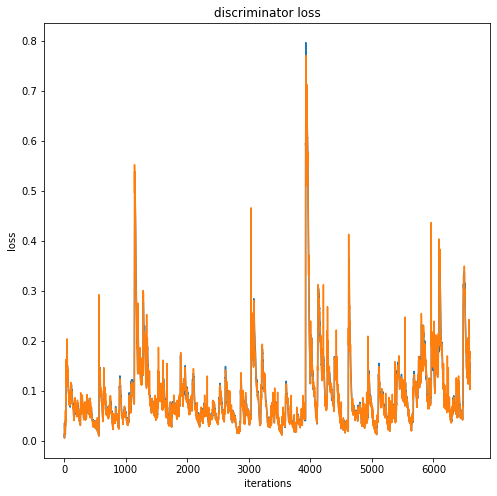

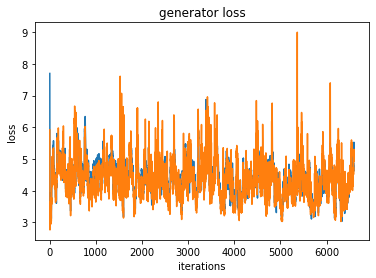

 67%|██████▋   | 6699/10000 [2:53:34<1:28:42,  1.61s/it]

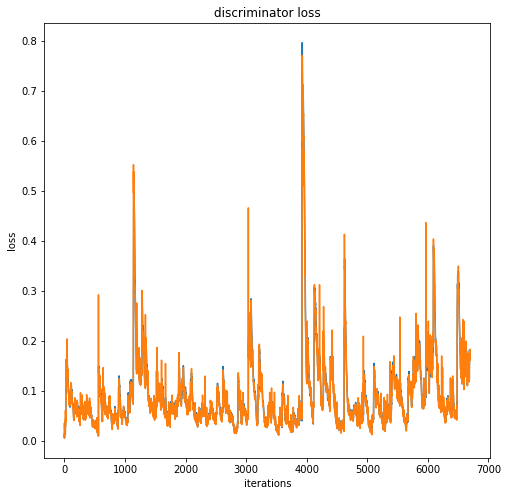

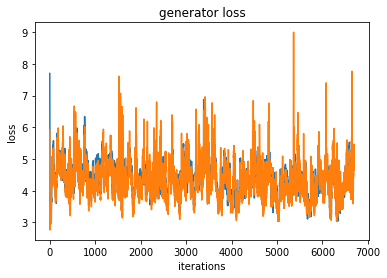

 68%|██████▊   | 6799/10000 [2:56:12<1:14:59,  1.41s/it]

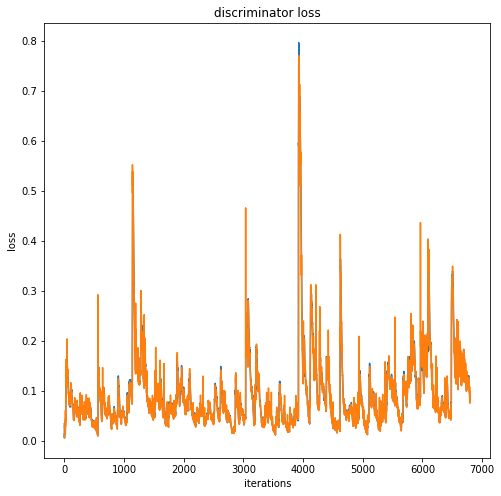

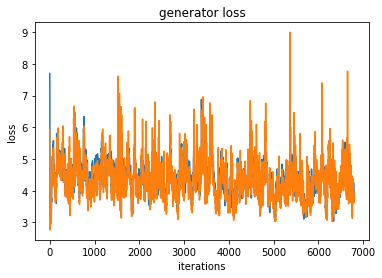

 69%|██████▉   | 6899/10000 [2:58:35<1:11:02,  1.37s/it]

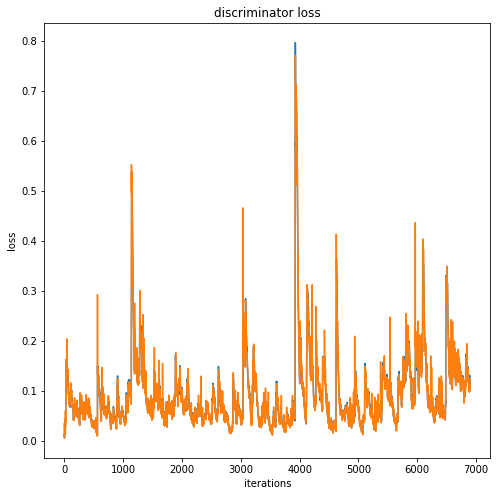

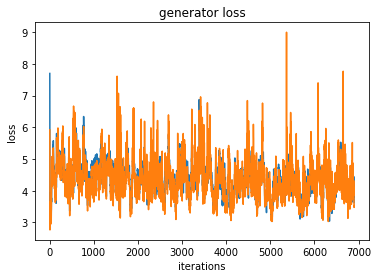

 70%|██████▉   | 6999/10000 [3:00:57<1:11:34,  1.43s/it]

Iteration 7000/703023: dis loss = 0.0085, gen loss = 6.1389


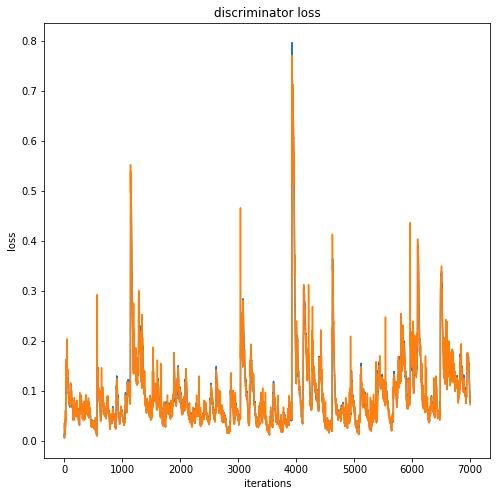

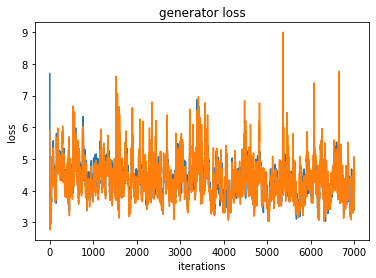

 71%|███████   | 7099/10000 [3:03:22<1:09:41,  1.44s/it]

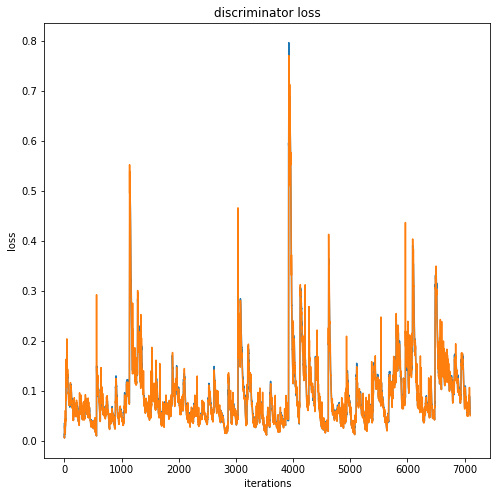

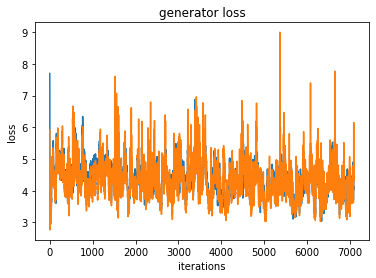

 72%|███████▏  | 7199/10000 [3:05:50<1:10:29,  1.51s/it]

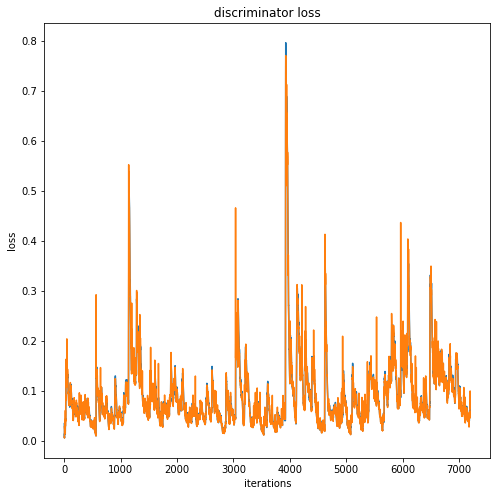

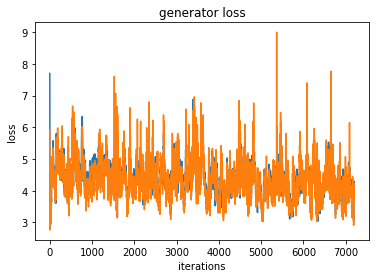

 73%|███████▎  | 7299/10000 [3:08:19<1:04:48,  1.44s/it]

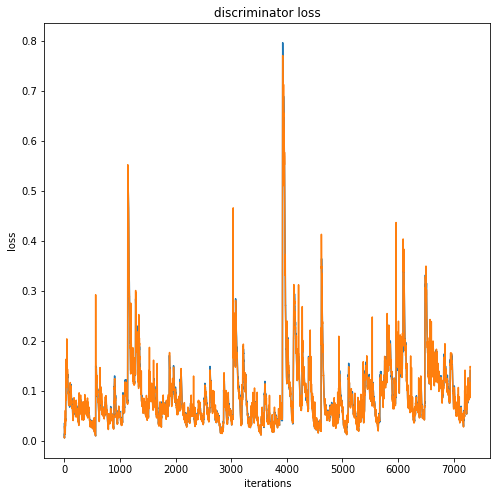

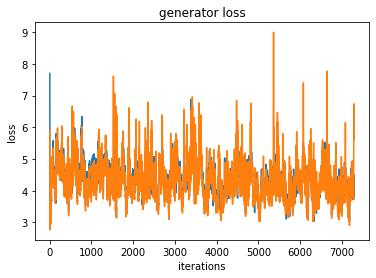

 74%|███████▍  | 7399/10000 [3:10:39<1:01:10,  1.41s/it]

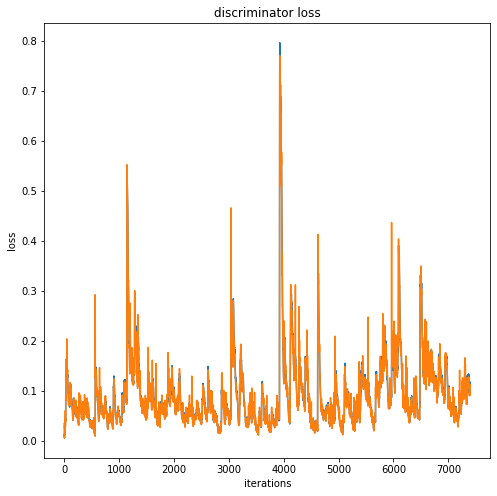

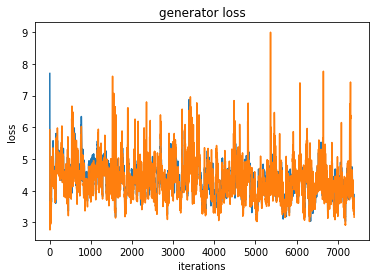

 75%|███████▍  | 7499/10000 [3:13:16<1:05:13,  1.56s/it]

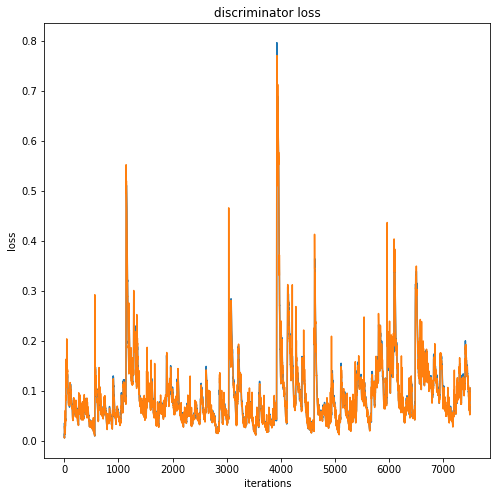

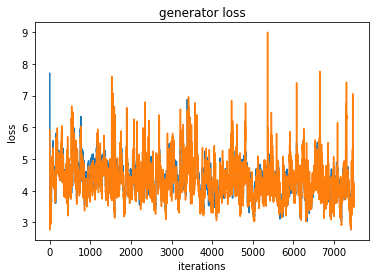

 76%|███████▌  | 7599/10000 [3:15:52<1:02:04,  1.55s/it]

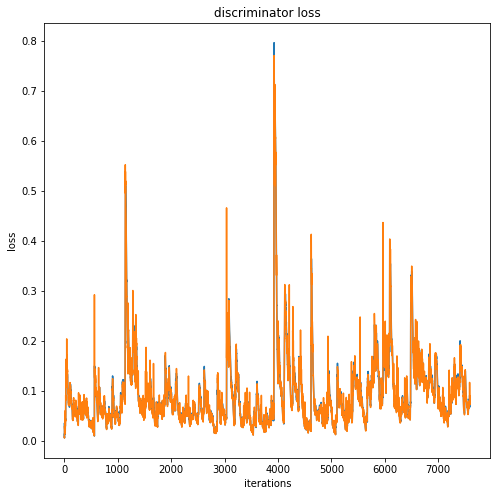

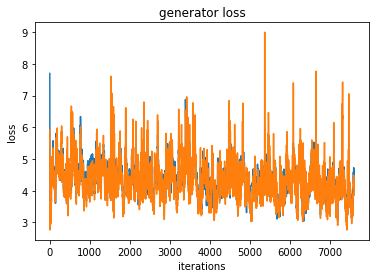

 77%|███████▋  | 7699/10000 [3:18:27<59:33,  1.55s/it]  

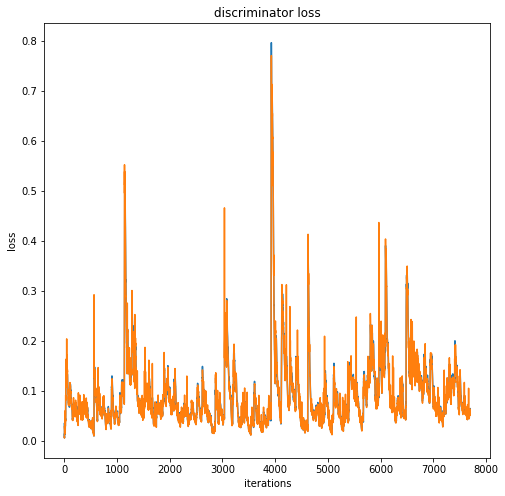

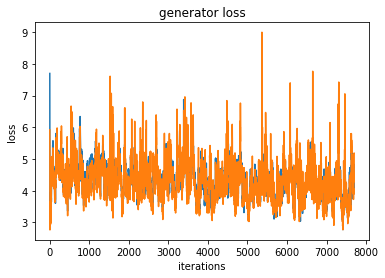

 78%|███████▊  | 7799/10000 [3:21:08<59:00,  1.61s/it]  

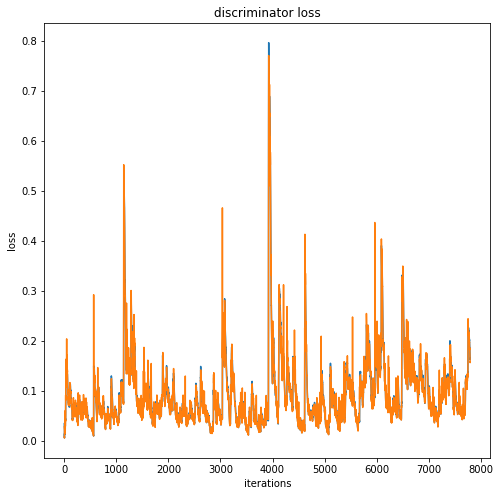

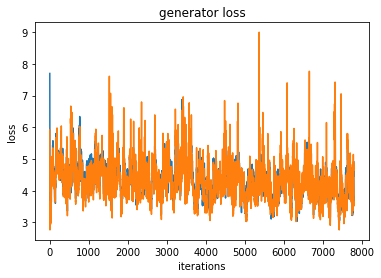

 79%|███████▉  | 7899/10000 [3:23:43<51:31,  1.47s/it]  

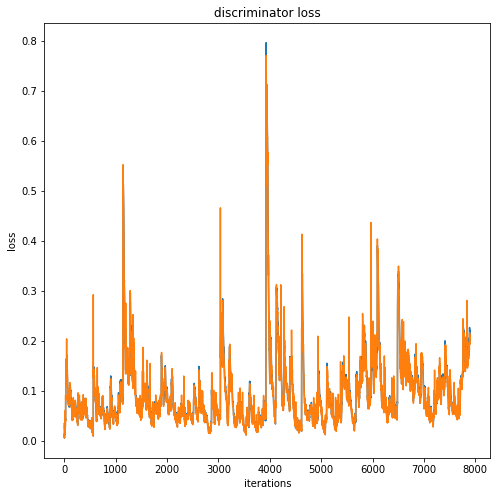

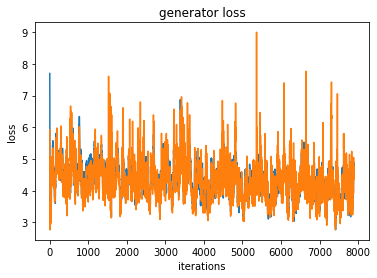

 80%|███████▉  | 7999/10000 [3:26:16<53:06,  1.59s/it]

Iteration 8000/703023: dis loss = 0.1366, gen loss = 4.6249


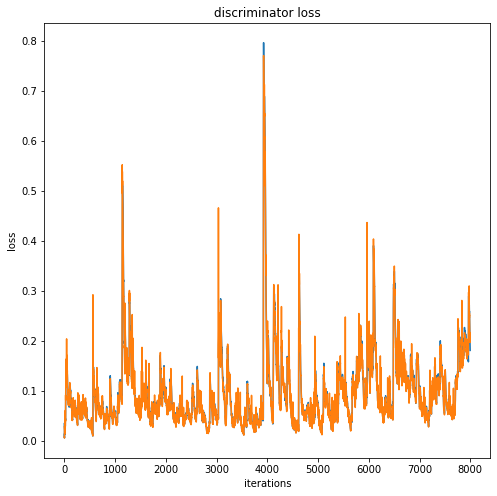

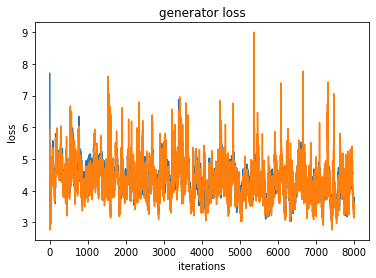

 81%|████████  | 8099/10000 [3:28:52<47:48,  1.51s/it]

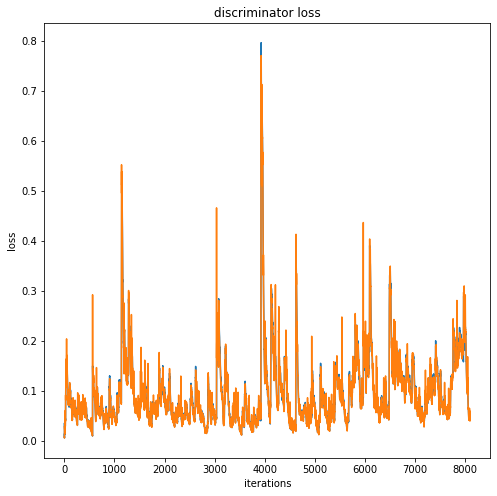

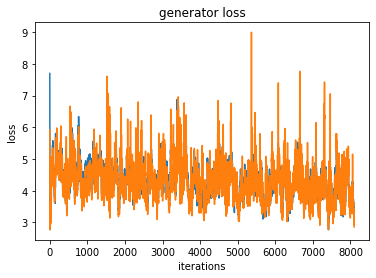

 82%|████████▏ | 8199/10000 [3:31:32<43:36,  1.45s/it]

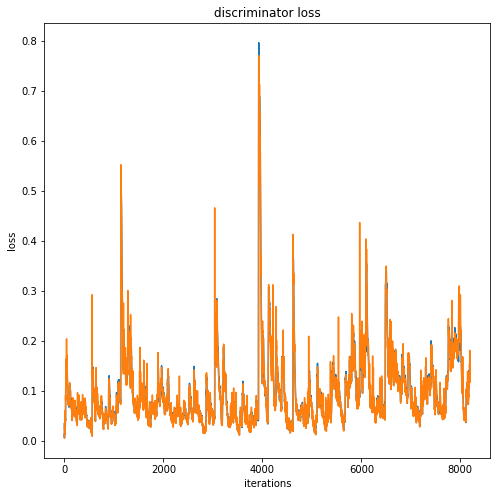

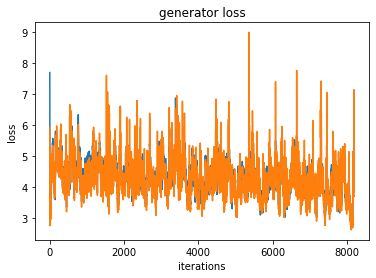

 83%|████████▎ | 8299/10000 [3:33:57<41:39,  1.47s/it]

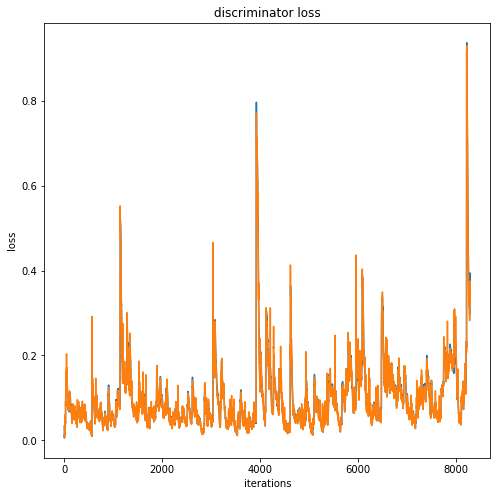

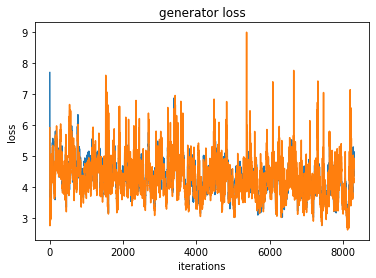

 84%|████████▍ | 8399/10000 [3:36:31<40:26,  1.52s/it]

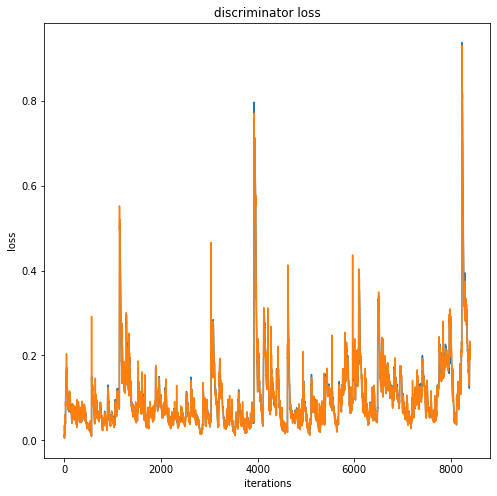

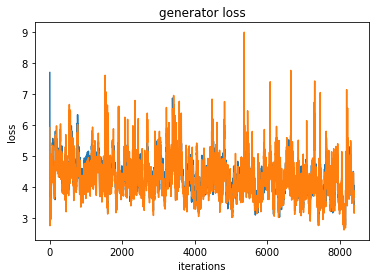

 85%|████████▍ | 8499/10000 [3:39:10<40:56,  1.64s/it]

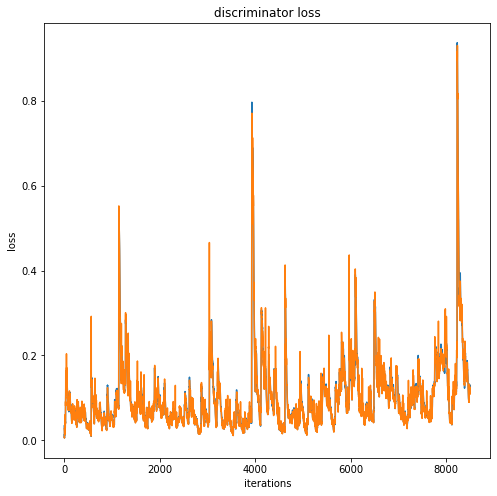

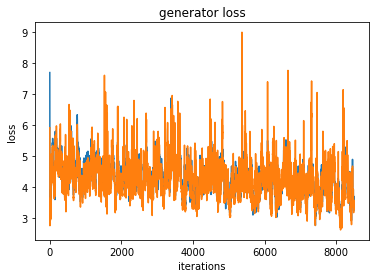

 86%|████████▌ | 8599/10000 [3:41:47<35:42,  1.53s/it]

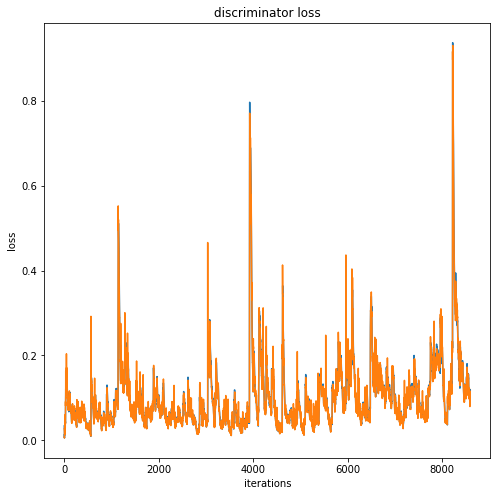

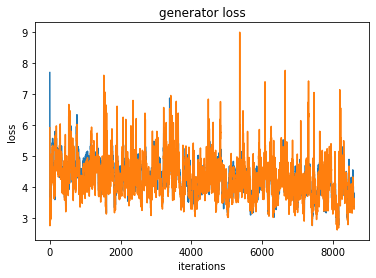

 87%|████████▋ | 8699/10000 [3:44:21<33:30,  1.55s/it]

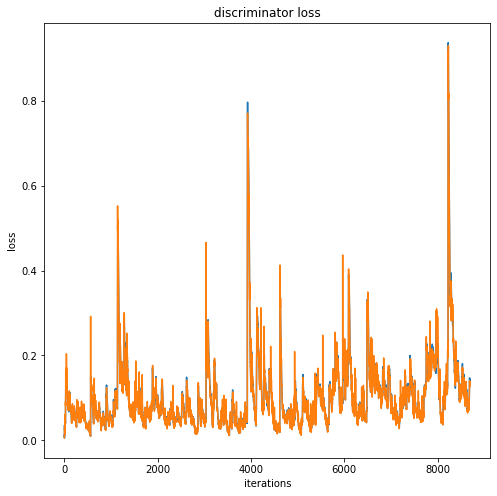

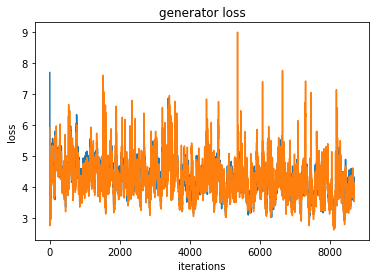

 88%|████████▊ | 8799/10000 [3:46:59<30:02,  1.50s/it]

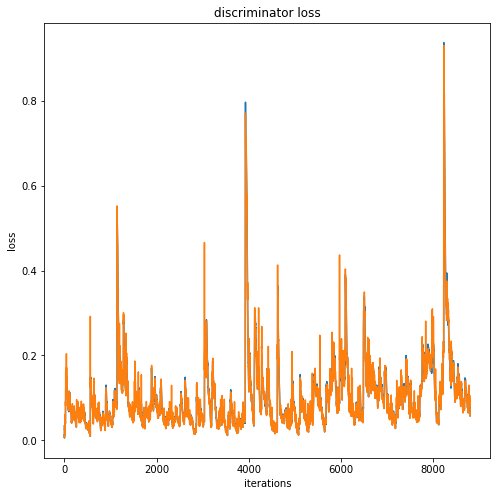

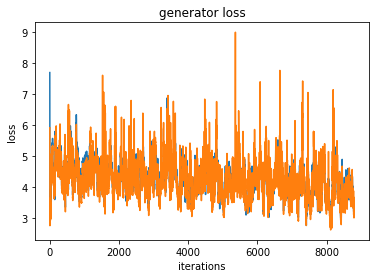

 89%|████████▉ | 8899/10000 [3:49:30<28:22,  1.55s/it]

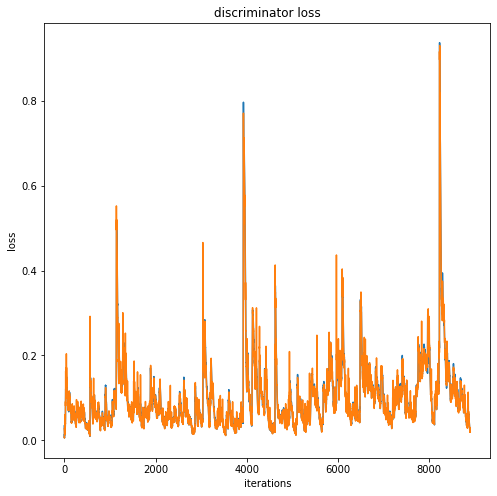

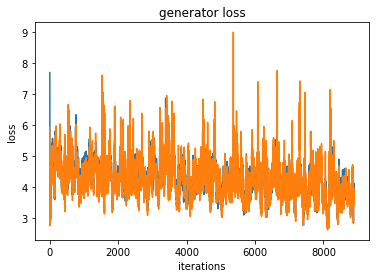

 90%|████████▉ | 8999/10000 [3:52:12<28:20,  1.70s/it]

Iteration 9000/703023: dis loss = 0.0581, gen loss = 5.2676


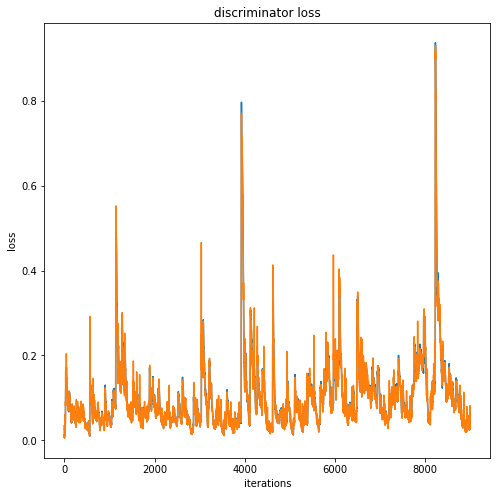

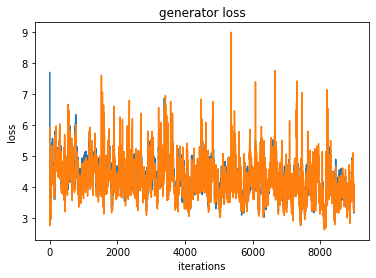

 91%|█████████ | 9099/10000 [3:54:50<21:19,  1.42s/it]

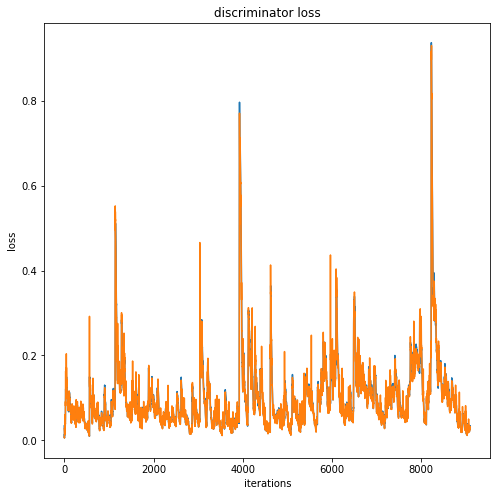

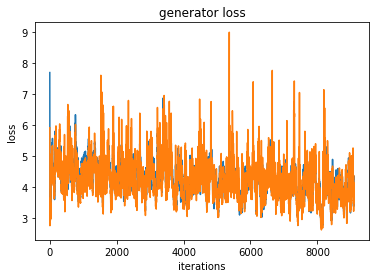

 92%|█████████▏| 9199/10000 [3:57:09<19:34,  1.47s/it]

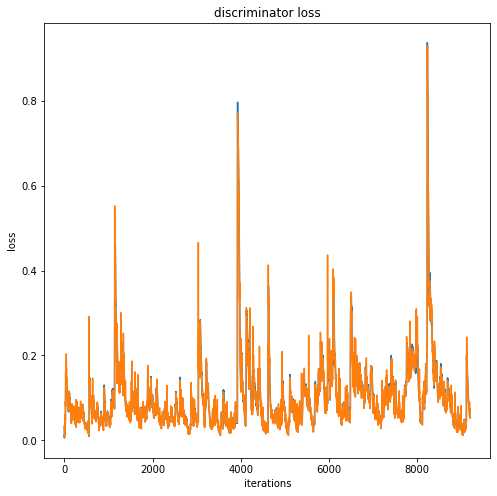

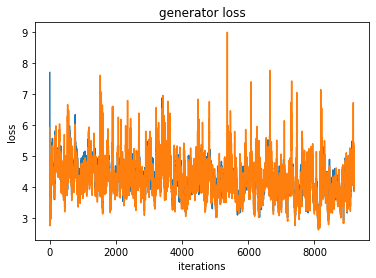

 93%|█████████▎| 9299/10000 [3:59:38<16:39,  1.43s/it]

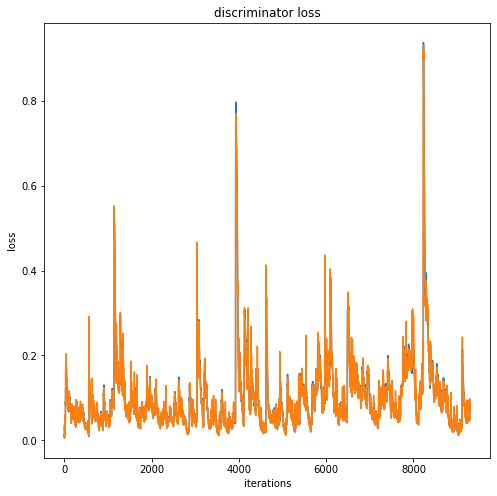

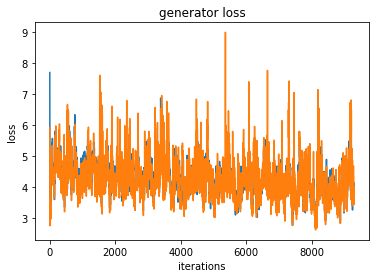

 94%|█████████▍| 9399/10000 [4:02:05<14:54,  1.49s/it]

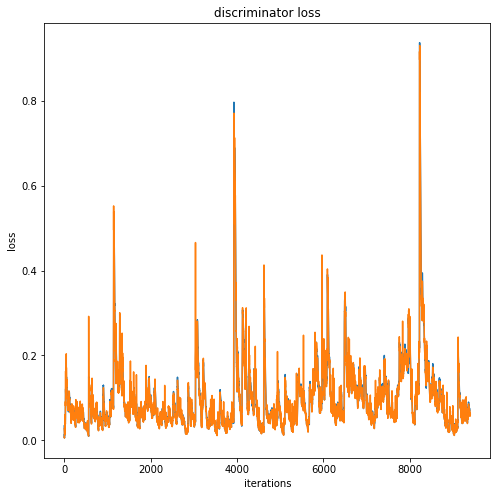

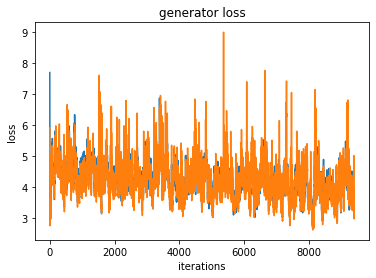

 95%|█████████▍| 9499/10000 [4:04:33<11:57,  1.43s/it]

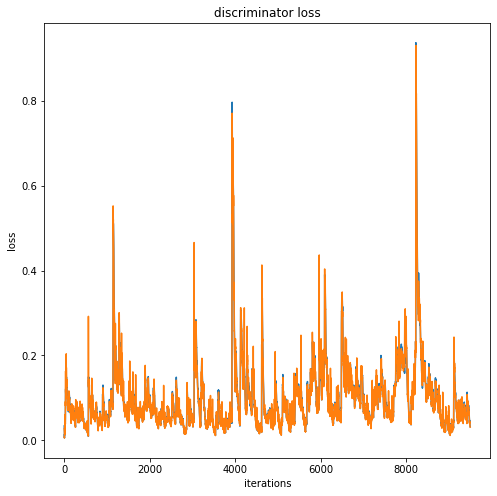

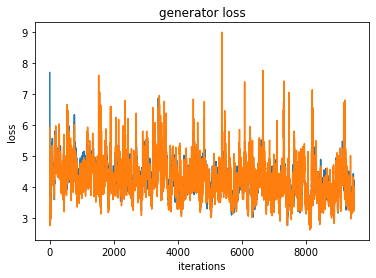

 96%|█████████▌| 9599/10000 [4:06:54<09:37,  1.44s/it]

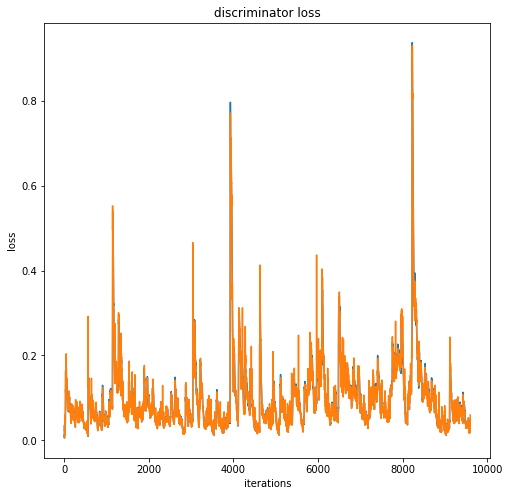

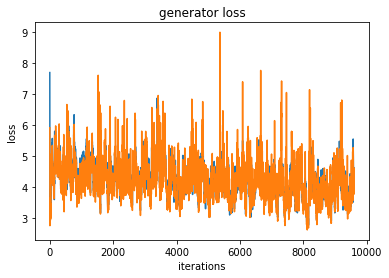

 97%|█████████▋| 9699/10000 [4:09:18<07:05,  1.41s/it]

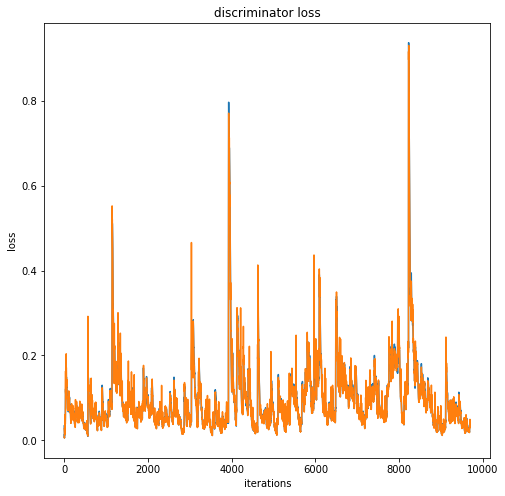

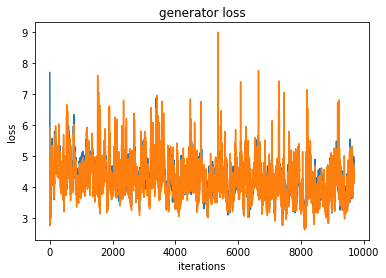

 98%|█████████▊| 9799/10000 [4:11:45<05:09,  1.54s/it]

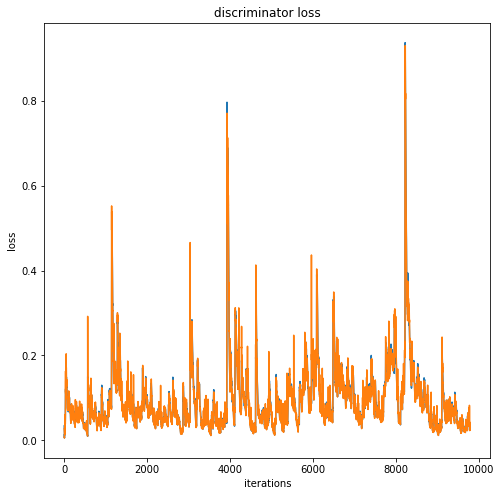

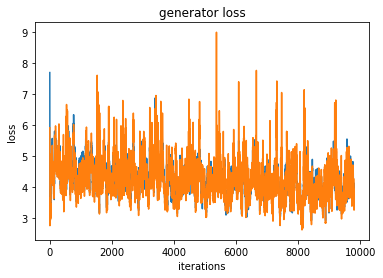

 99%|█████████▉| 9899/10000 [4:14:21<02:38,  1.57s/it]

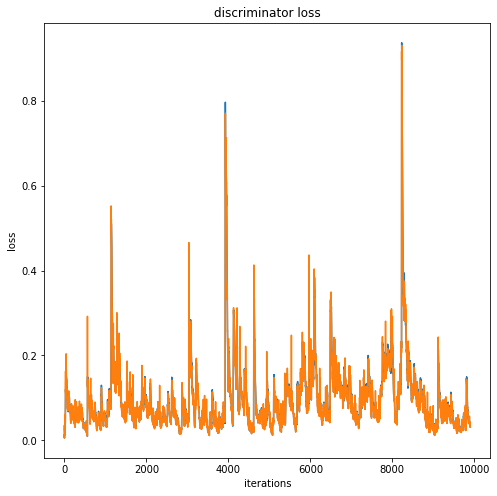

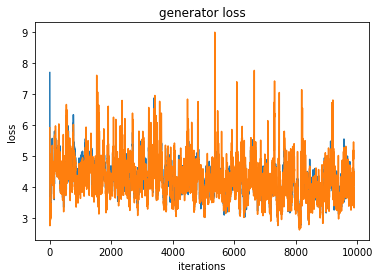

100%|█████████▉| 9999/10000 [4:16:57<00:01,  1.55s/it]

Iteration 10000/703023: dis loss = 0.0216, gen loss = 2.9088


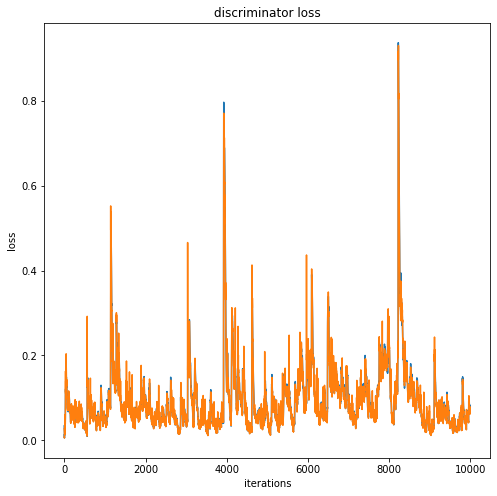

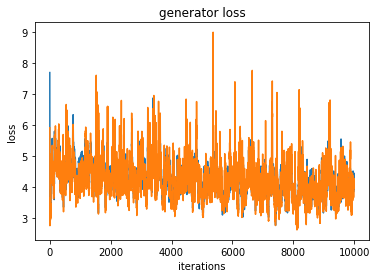

100%|██████████| 10000/10000 [4:16:59<00:00,  1.54s/it]


... Done!


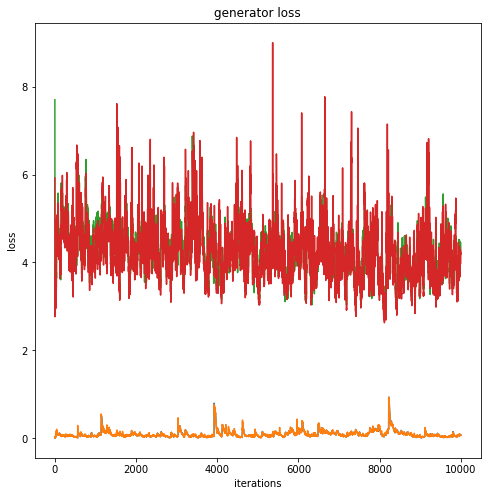

In [19]:
gan = GAN()
gan(train_dataloader)



## test result(two epochs)

In [25]:
target = torch.stack(torch.load("ganv2_target.pt"))
predicted = torch.stack(torch.load("ganv2_future.pt"))
availability = torch.stack(torch.load("ganv2_t_avail.pt"))
availability = availability.reshape(1000, 32, 50, 1)

print(predicted.shape)

loss2 = nn.MSELoss(reduction = 'mean')
print(loss2(target*availability, predicted*availability))

torch.Size([1000, 32, 50, 2])
tensor(1.9143)
